In [55]:
import numpy as np
import random
# import to do training
from tpg.trainer import Trainer
# import to run an agent (always needed)
from tpg.agent import Agent
# faster training
import multiprocessing as mp
# visual tools
from IPython.display import clear_output
import time
import matplotlib.pyplot as plt
# for writing
import csv
from datetime import date

In [56]:
class GridWorld_fig11:
    def __init__ (self, rows, cols, win_state, start_state):
        self.memory = []
        self.memory_position = 0
        self.memory_limit = 20
        self.rows = rows
        self.cols = cols
        self.start_state = start_state
        self.win_state = win_state
        self.current_state = self.start_state
        
    def sample_action (self):
        rand = random.uniform(0, 1)
        if (rand >= 0) and (rand < 0.25):
            return 0
        elif (rand >= 0.25) and (rand < 0.5):
            return 1
        elif (rand >= 0.5) and (rand < 0.75):
            return 2
        else:
            return 3
        
    def reset (self):
        self.current_state = self.start_state
        return self.current_state
        
    # just reset for now...
    def close (self):
        self.current_state = self.start_state
        return 1
    
    def check_win (self):
        if self.current_state == self.win_state:
            return True
        return False
    
    def step (self, action):
        # north
        if action == 0:
            next = (self.current_state[0] - 1, self.current_state[1])
        # south
        elif action == 1:
            next = (self.current_state[0] + 1, self.current_state[1])
        # east
        elif action == 2:
            next = (self.current_state[0], self.current_state[1] + 1)
        # west
        else:
            next = (self.current_state[0], self.current_state[1] - 1)

        terminate = False
        reward = 0
        # check if move is legal
        if (next[0] >= 0 and next[0] <= (self.rows-1)) and (next[1] >= 0 and next[1] <= (self.cols-1)):            
            illegal = 0
            if (next == (1, 2)) or (next == (1, 3)) or (next == (2, 2)) or (next == (2, 3)):
                illegal = 1
                    
            if (illegal == 0):
                self.current_state = next
                #reward -= 0.01
                reward += 0.01
            else:
                #reward -= 1
                reward += 0
        else:
            #reward -= 1
            reward += 0
            
        # punish repeat states within last 20 states
        if self.current_state in self.memory:
            #reward -= 1
            reward += 0
        
        if self.check_win():
            reward += 100
            terminate = True
        
        # add new state to memory
        if len(self.memory) <= self.memory_limit:
            (self.memory).append(self.current_state)
        # after memory is full, begin overriding it
        else:
            if self.memory_position < self.memory_limit:
                self.memory[self.memory_position] = self.current_state
                self.memory_position += 1
            else:
                self.memory_position = 0
                self.memory[self.memory_position] = self.current_state
        
        return self.current_state, reward, terminate

In [57]:
def runAgent(args):
    agent = args[0]
    envName = args[1]
    scoreList = args[2]
    numEpisodes = args[3] # number of times to repeat game
    numFrames = args[4] 
    gen = args[5]
    
    # skip if task already done by agent
    if agent.taskDone(envName):
        print('Agent #' + str(agent.agentNum) + ' can skip.')
        scoreList.append((agent.team.id, agent.team.outcomes))
        return
    
    env = GridWorld_fig11(5, 5, (0, 4), (4, 0))
    valActs = 4
    
    # create environment object from above
    scoreTotal = 0
    for ep in range(numEpisodes):
        state = env.reset()
        scoreEp = 0
        states = []
        step_map = np.zeros((10, 10))
        if numEpisodes > 1:
            for i in range(numFrames): # frame loop           
                # action selection
                act = agent.act(state)
                
                state, reward, isDone = env.step(act)
                # for heatmap
                step_map[state] = step_map[state] + 1
                states.append(state)
                #print('State: ' + str(state))
                scoreEp += reward
                
                # win
                if isDone:
                    print('win!')
                    print(states)
                    break
                    
            print('Agent #' + str(agent.agentNum) + 
              ' | Ep #' + str(ep) + ' | Score: ' + str(scoreEp))
            
        scoreTotal += scoreEp
    scoreTotal /= numEpisodes
    env.close()
    agent.reward(scoreTotal, envName)
    scoreList.append((agent.team.id, agent.team.outcomes))
    if isDone:
        return states
    else:
        return 0

In [58]:
# NOTES:
# pAtomic equal to 1 so teams are single nodes
    # starting off, teams don't reference teams
# if the maxTeamSize is set, we can try to maximize the use of actually useful learners.
    # this might help with the consistency of success...
trainer = Trainer(actions=4, teamPopSize=50, pActAtom=1.0, 
                  nRegisters=4, initMaxActProgSize=48, gap=0.5)

envName = 'fig11'
allScores = []
champions = []
for gen in range(500):
    scoreList = []

    agents = trainer.getAgents()

    agent_track = 0
    best_score = -200.0
    curr_champion = []
    for agent in agents:
        run = runAgent([agent, envName, scoreList, 10, 100, gen])
        if (scoreList[agent_track][1][envName] > best_score) and (run != 0):
            best_score = scoreList[agent_track][1][envName]
            curr_champion = run
            print(run)
        agent_track += 1

    champions.append(curr_champion)

    # apply scores, must do this when multiprocessing
    # because agents can't refer to trainer
    teams = trainer.applyScores(scoreList)

    trainer.evolve(tasks=[envName]) # go into next gen

    # an easier way to track stats than the above example
    scoreStats = trainer.fitnessStats

    allScores.append((scoreStats['min'], scoreStats['max'], scoreStats['average']))

    print('Gen: ' + str(gen))
    print('Results so far: ' + str(allScores))

print('Results:\nMin, Max, Avg')
for score in allScores:
    print(score[0],score[1],score[2])

Agent #0 | Ep #0 | Score: 0.04
Agent #0 | Ep #1 | Score: 0.04
Agent #0 | Ep #2 | Score: 0.04
Agent #0 | Ep #3 | Score: 0.04
Agent #0 | Ep #4 | Score: 0.04
Agent #0 | Ep #5 | Score: 0.04
Agent #0 | Ep #6 | Score: 0.04
Agent #0 | Ep #7 | Score: 0.04
Agent #0 | Ep #8 | Score: 0.04
Agent #0 | Ep #9 | Score: 0.04
Agent #1 | Ep #0 | Score: 1.0000000000000007
Agent #1 | Ep #1 | Score: 0.08
Agent #1 | Ep #2 | Score: 0
Agent #1 | Ep #3 | Score: 0
Agent #1 | Ep #4 | Score: 0
Agent #1 | Ep #5 | Score: 0
Agent #1 | Ep #6 | Score: 0
Agent #1 | Ep #7 | Score: 0
Agent #1 | Ep #8 | Score: 0
Agent #1 | Ep #9 | Score: 0
Agent #2 | Ep #0 | Score: 0.04
Agent #2 | Ep #1 | Score: 0.04
Agent #2 | Ep #2 | Score: 0.04
Agent #2 | Ep #3 | Score: 0.04
Agent #2 | Ep #4 | Score: 0.04
Agent #2 | Ep #5 | Score: 0.04
Agent #2 | Ep #6 | Score: 0.04
Agent #2 | Ep #7 | Score: 0.04
Agent #2 | Ep #8 | Score: 0.04
Agent #2 | Ep #9 | Score: 0.04
Agent #3 | Ep #0 | Score: 0
Agent #3 | Ep #1 | Score: 0
Agent #3 | Ep #2 | Score

Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
Agent #32 | Ep #0 | Score: 0.04
Agent #32 | Ep #1 | Score: 0.04
Agent #32 | Ep #2 | Score: 0.04
Agent #32 | Ep #3 | Score: 0.04
Agent #32 | Ep #4 | Score: 0.04
Agent #32 | Ep #5 | Score: 0.04
Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
Agent #33 | Ep #0 | Score: 0
Agent #33 | Ep #1 | Score: 0
Agent #33 | Ep #2 | Score: 0
Agent #33 | Ep #3 | Score: 0
Agent #33 | Ep #4 | Score: 0
Agent #33 | Ep #5 | Score: 0
Agent #33 | Ep #6 | Score: 0
Agent #33 | Ep #7 | Score: 0
Agent #33 | Ep #8 | Score: 0
Agent #33 | Ep #9 | Score: 0
Agent #34 | Ep #0 | Score: 0
Agent #34

Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #4

Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 0.05
Agent #39 | Ep #1 | Score: 0.05
Agent #39 | Ep #2 | Score: 0.05
Agent #39 | Ep #3 | Score: 0.05
Agent #39 | Ep #4 | Score: 0.05
Agent #39 | Ep #5 | Score: 0.05
Agent #39 | Ep #6 | Score: 0.05
Agent #39 | Ep #7 | Score: 0.05
Agent #39 | Ep #8 | Score: 0.05
Agent #39 | Ep #9 | Score: 0.05
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #4

Agent #39 | Ep #1 | Score: 0
Agent #39 | Ep #2 | Score: 0
Agent #39 | Ep #3 | Score: 0
Agent #39 | Ep #4 | Score: 0
Agent #39 | Ep #5 | Score: 0
Agent #39 | Ep #6 | Score: 0
Agent #39 | Ep #7 | Score: 0
Agent #39 | Ep #8 | Score: 0
Agent #39 | Ep #9 | Score: 0
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0
Agent #41 | Ep #1 | Score: 0
Agent #41 | Ep #2 | Score: 0
Agent #41 | Ep #3 | Score: 0
Agent #41 | Ep #4 | Score: 0
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | S

Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.04
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #4

Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
Agent #48 | Ep #0 | Score: 0
Agent #48 | Ep #1 | Score: 0
Agent #48 | Ep #2 | Score: 0
Agent #48 | Ep #3 | Score: 0
Agent #48 | Ep #4 | Score: 0
Agent #48 | Ep #5 | Score: 0
Agent #48 | Ep #6 | Score: 0
Agent #48 | Ep #7 | Score: 0
Agent #48 | Ep #8 | Score: 0
Agent #48 | Ep #9 | Score: 0
Agent #49 | Ep #0 | Score: 0.04
Agent #49 | Ep #1 | Score: 0.04
Agent #49 | Ep #2 | Score: 0.04
Agent #49 | Ep #3 | Score: 0.04
Agent #49 | Ep #4 | Score: 0.04
Agent #49 | Ep #5 | Score: 0.04
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 5
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), 

Agent #25 | Ep #5 | Score: 0
Agent #25 | Ep #6 | Score: 0
Agent #25 | Ep #7 | Score: 0
Agent #25 | Ep #8 | Score: 0
Agent #25 | Ep #9 | Score: 0
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Sco

Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3

Gen: 8
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007)]
Agent #0 can skip.
None
Agent #1 can skip.
None
Agent #2 can skip.
Agent #3 can skip.
Agent #4 can skip.
Agent #5 can skip.
Agent #6 can skip.
Agent #7 can skip.
Agent #8 can skip.
Agent #9 can skip.
Agent #10 can skip.
None
Agent #11 can skip.
Agent #12 can skip.
Agent #13 can skip.
Agent #14 can skip.
Agent #15 can skip.
Agent #16 can skip.
Agent #17 can skip.
Agent #18 can skip.
Agent #19 can skip.
Agent #20 can skip.
Agent #21 can skip.
Agent #22 can skip.
Agent #23 can skip.
Agent #24 can skip.
Agent #25 | Ep #0 | Score: 0.04
Agent #25 | Ep #1 | Sco

Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
Agent #30 | Ep #0 | Score: 0.04
Agent #3

Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0
Agent #31 | Ep #1 | Score: 0
Agent #31 | Ep #2 | Score: 0
Agent #31 | Ep #3 | Score: 0
Agent #31 | Ep #4 | Score: 0
Agent #31 | Ep #5 | Score: 0
Agent #31 | Ep #6 | Score: 0
Agent #31 | Ep #7 | Score: 0
Agent #31 | Ep #8 | Score: 0
Agent #31 | Ep #9 | Score: 0
Agent #32 | Ep #0 | Score: 0
Agent #32 | Ep #1 | Score: 0
Agent #32 | Ep #2 | Score: 0
Agent #32 | Ep #3 | Score: 0
Agent #32 | Ep #4 | Score: 0
Agent #32 | Ep #5 | Score: 0
Agent #32 | Ep #6 | Score: 0
Agent #32 | Ep #7 | Score: 0
Agent #32 | Ep #8 | Score: 0
Agent #32 | Ep #9 | Score: 0
Agent #33 | Ep #0 | Score: 0
Agent #33 | Ep #1 | Score: 0
Agent #33 | Ep #2 | Score: 0
Agent #33 | Ep #3 | Score: 0
Agent #33 | Ep #4 | Score: 0
Agent #33 | Ep #5 | Score: 0
Agent #33 | Ep #6 | Score: 0
Agent #33 | Ep #7 | Score: 0
Agent #33 | Ep #8 | Score: 0
Agent #33 | Ep #9 | Score: 0
Ag

Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.08
Agent #29 | Ep #2 | Score: 0
Agent #29 | Ep #3 | Score: 0
Agent #29 | Ep #4 | Score: 0
Agent #29 | Ep #5 | Score: 0
Agent #29 | Ep #6 | Score: 0
Agent #29 | Ep #7 | Score: 0
Agent #29 | Ep #8 | Score: 0
Agent #29 | Ep #9 | Score: 0
Agent #30 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4

Gen: 12
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993)]
Agent #0 can skip.
None
Agent #1 can skip.
None
Agent #2 can skip.
Agent #3 can skip.
Agent #4 can skip.
Agent #5 can skip.
Agent #6 can skip.
None
Agent #7 can skip.
Agent #8 can skip.
Agent #9 can skip.
Agent #10 can skip.
Agent #11 can skip.
Agent #12 can skip.
Agent #13 can skip.
Agent #14 can skip.
Agent #15 can skip.
Agent #16 can skip.
Agent #17 can skip.
Agent #1

Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.08
Agent #40 | Ep #3 | Score: 0.34000000000000014
Agent #40 | Ep #4 | Score: 0.09999999999999999
Agent #40 | Ep #5 | Score: 0.09999999999999999
Agent #40 | Ep #6 | Score: 0.23000000000000007
Agent #40 | Ep #7 | Score: 0.13999999999999999
Agent #40 | Ep #8 | Score: 0.10999999999999999
Agent #40 | Ep #9 | Score: 0.08
Agent #41 | Ep #0 | Score: 0
Agent #41 | Ep #1 | Score: 0
Agent #41 | Ep #2 | Score: 0.03
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | 

Agent #36 | Ep #0 | Score: 0.6000000000000003
Agent #36 | Ep #1 | Score: 0.6500000000000004
Agent #36 | Ep #2 | Score: 0.6100000000000003
Agent #36 | Ep #3 | Score: 0.6200000000000003
Agent #36 | Ep #4 | Score: 0.6000000000000003
Agent #36 | Ep #5 | Score: 0.5700000000000003
Agent #36 | Ep #6 | Score: 0.6500000000000004
Agent #36 | Ep #7 | Score: 0.5700000000000003
Agent #36 | Ep #8 | Score: 0.6400000000000003
Agent #36 | Ep #9 | Score: 0.5800000000000003
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.04
Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 0
Agent #38 | Ep #1 | Score: 0
Agent #38 | Ep #2 | Score: 0
Agent #38 | Ep #3 | Score: 0
Agent #38 | Ep #4 | Score: 0
Agent #38 | Ep #5 | Score: 0
Agent #38 | Ep #6 | Score: 0
Agent #38 | Ep #7

Agent #25 | Ep #3 | Score: 0
Agent #25 | Ep #4 | Score: 0
Agent #25 | Ep #5 | Score: 0
Agent #25 | Ep #6 | Score: 0
Agent #25 | Ep #7 | Score: 0
Agent #25 | Ep #8 | Score: 0
Agent #25 | Ep #9 | Score: 0
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3),

Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.04
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 0.04
Agent #45 | Ep #1 | Score: 0.04
Agent #45 | Ep #2 | Score: 0.04
Agent #45 | Ep #3 | Score: 0.04
Agent #45 | Ep #4 | Score: 0.04
Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3

Agent #35 | Ep #9 | Score: 0.04
Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.04
Agent #36 | Ep #2 | Score: 0.04
Agent #36 | Ep #3 | Score: 0.04
Agent #36 | Ep #4 | Score: 0.04
Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 100.08
win!
[(4

Agent #27 | Ep #3 | Score: 0.6900000000000004
Agent #27 | Ep #4 | Score: 0.7000000000000004
Agent #27 | Ep #5 | Score: 0.7000000000000004
Agent #27 | Ep #6 | Score: 0.6900000000000004
Agent #27 | Ep #7 | Score: 0.7000000000000004
Agent #27 | Ep #8 | Score: 0.7000000000000004
Agent #27 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 100.0

Agent #41 | Ep #2 | Score: 0
Agent #41 | Ep #3 | Score: 0
Agent #41 | Ep #4 | Score: 0
Agent #41 | Ep #5 | Score: 0
Agent #41 | Ep #6 | Score: 0
Agent #41 | Ep #7 | Score: 0
Agent #41 | Ep #8 | Score: 0
Agent #41 | Ep #9 | Score: 0
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.04
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04


Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #0 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #2 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #3 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #4 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #5 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #6 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #7 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #35 | Ep #8 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2

win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #3 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #25 | Ep #4 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #25 | Ep #5 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #25 | Ep #6 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #25 | Ep #8 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0

Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #40 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2

Gen: 20
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #4 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.08
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.9100000000000006
Agent #42 | Ep #2 | Score: 1.0000000000000007
Agent #42 | Ep #3 | Score: 1.0000000000000007
Agent #42 | Ep #4 | Score: 1.0000000000000007
Agent #42 | Ep #5 | Score: 1.0000000000000007
Agent #42 | Ep #6 | Score: 1.0000000000000007
Agent #42 | Ep #7 | Score: 1.0000000000000007
Agent #42 | Ep #8 | Score: 1.0000000000000007
Agent #42 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 

Agent #29 | Ep #4 | Score: 0.6400000000000003
Agent #29 | Ep #5 | Score: 0.6400000000000003
Agent #29 | Ep #6 | Score: 0.6700000000000004
Agent #29 | Ep #7 | Score: 0.6200000000000003
Agent #29 | Ep #8 | Score: 0.6600000000000004
Agent #29 | Ep #9 | Score: 0.6600000000000004
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)

Agent #46 | Ep #1 | Score: 0
Agent #46 | Ep #2 | Score: 0
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0.04
Agent #46 | Ep #7 | Score: 0.04
Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Score: 0.04
Agent #47 | Ep #0 | Score: 0.6200000000000003
Agent #47 | Ep #1 | Score: 0.5400000000000003
Agent #47 | Ep #2 | Score: 0.7000000000000004
Agent #47 | Ep #3 | Score: 0.6400000000000003
Agent #47 | Ep #4 | Score: 0.6800000000000004
Agent #47 | Ep #5 | Score: 0.6800000000000004
Agent #47 | Ep #6 | Score: 0.6500000000000004
Agent #47 | Ep #7 | Score: 0.7000000000000004
Agent #47 | Ep #8 | Score: 0.6400000000000003
Agent #47 | Ep #9 | Score: 0.6600000000000004
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.20000000000000004
Agent #48 | Ep #3 | Score: 0.48000000000000026
Agent #48 | Ep #4 | Score: 0.5200000000000002
Agent #48 | Ep #5 | Score: 0.48000000000000026
Agent #

Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #6 | Score: 100.08
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0

Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #0 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #3 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #4 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #5 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3

Agent #30 | Ep #3 | Score: 0.04
win!
[(3, 0), (3, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #5 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #6 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #7 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #8 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #9 | Score: 100.08
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04


win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0

Agent #29 | Ep #9 | Score: 0
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.060000000000000005
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 10

Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 2), (3, 3), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #0 | Score: 100.12
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 100.10000000000001
win!
[(4, 1), (4, 2), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #2 | Score: 100.14
Agen

Agent #34 | Ep #1 | Score: 0.04
Agent #34 | Ep #2 | Score: 0.8900000000000006
Agent #34 | Ep #3 | Score: 1.0000000000000007
Agent #34 | Ep #4 | Score: 1.0000000000000007
Agent #34 | Ep #5 | Score: 1.0000000000000007
Agent #34 | Ep #6 | Score: 1.0000000000000007
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.08
Agent #35 | Ep #2 | Score: 0
Agent #35 | Ep #3 | Score: 0
Agent #35 | Ep #4 | Score: 0
Agent #35 | Ep #5 | Score: 0
Agent #35 | Ep #6 | Score: 0
Agent #35 | Ep #7 | Score: 0
Agent #35 | Ep #8 | Score: 0
Agent #35 | Ep #9 | Score: 0
Agent #36 | Ep #0 | Score: 0.11999999999999998
Agent #36 | Ep #1 | Score: 0
Agent #36 | Ep #2 | Score: 0
Agent #36 | Ep #3 | Score: 0
Agent #36 | Ep #4 | Score: 0
Agent #36 | Ep #5 | Score: 0
Agent #36 | Ep #6 | Score: 0
Agent #36 | Ep #7 | Score: 0
Agent #36 | Ep #8 | Score: 0
Agent #36 | Ep #9 | Score

Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
Agent #49 | Ep #0 | Score: 0.060000000000000005
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #4 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #5 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #6 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3

Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 0
Agent #39 | Ep #1 | Score: 0
Agent #39 | Ep #2 | Score: 0
Agent #39 | Ep #3 | Score: 0
Agent #39 | Ep #4 | Score: 0
Agent #39 | Ep #5 | Score: 0
Agent #39 | Ep #6 | Score: 0
Agent #39 | Ep #7 | Score: 0
Agent #39 | Ep #8 | Score: 0
Agent #39 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.08
win!
[

Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
Agent #32 | Ep #0 | Score: 0.04
Agent #3

Agent #45 | Ep #5 | Score: 0
Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (

Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.05
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
Agent #32 | Ep #0 | Score: 0.04
Agent #32 | Ep #1 | Score: 0.04
Agent #32 | Ep #2 | Score: 0.04
Agent #32 | Ep #3 | Score: 0.04
Agent #32 | Ep #4 | Score: 0.04
Agent #32 | Ep #5 | Score: 0.04
Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0

Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0.37000000000000016
Agent #41 | Ep #1 | Score: 0.3200000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 100.10000000000001
Agent #41 | Ep #4 | Score: 0.37000000000000016
Agent #41 | Ep #5 | Score: 0.24000000000000007
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1),

Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #5 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #6 | Score: 100.08
win!
[(4, 1), (3, 1), (2

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #5 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #6 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #7 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3

Agent #29 | Ep #6 | Score: 0
Agent #29 | Ep #7 | Score: 0
Agent #29 | Ep #8 | Score: 0
Agent #29 | Ep #9 | Score: 0
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1)

Gen: 31
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.08
Agent #43 | Ep #2 | Score: 0.4000000000000002
Agent #43 | Ep #3 | Score: 0.3200000000000001
Agent #43 | Ep #4 | Score: 0.38000000000000017
Agent #43 | Ep #5 | Score: 0.4200000000000002
Agent #43 | Ep #6 | Score: 0.4100000000000002
Agent #43 | Ep #7 | Score: 0.2800000000000001
Agent #43 | Ep #8 | Score: 0.5200000000000002
Agent #43 | Ep #9 | Score: 0.2800000000000001
Agent #44 | Ep #0 | Score: 0.24000000000000007
Agent #44 | Ep #1 | Score: 0.24000000000000007
Agent #44 | Ep #2 | Score: 0.8200000000000005
Agent #44 | Ep #3 | Score: 1.00000000000000

Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0

Agent #27 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #6 | Score: 100.08
win!
[(3, 0), (2, 0), (1

Agent #43 | Ep #4 | Score: 0
Agent #43 | Ep #5 | Score: 0
Agent #43 | Ep #6 | Score: 0
Agent #43 | Ep #7 | Score: 0
Agent #43 | Ep #8 | Score: 0
Agent #43 | Ep #9 | Score: 0
Agent #44 | Ep #0 | Score: 0.25000000000000006
Agent #44 | Ep #1 | Score: 0.5500000000000003
Agent #44 | Ep #2 | Score: 1.0000000000000007
Agent #44 | Ep #3 | Score: 1.0000000000000007
Agent #44 | Ep #4 | Score: 1.0000000000000007
Agent #44 | Ep #5 | Score: 1.0000000000000007
Agent #44 | Ep #6 | Score: 1.0000000000000007
Agent #44 | Ep #7 | Score: 1.0000000000000007
Agent #44 | Ep #8 | Score: 1.0000000000000007
Agent #44 | Ep #9 | Score: 1.0000000000000007
Agent #45 | Ep #0 | Score: 0.9200000000000006
Agent #45 | Ep #1 | Score: 0.9600000000000006
Agent #45 | Ep #2 | Score: 0.9400000000000006
Agent #45 | Ep #3 | Score: 0.9100000000000006
Agent #45 | Ep #4 | Score: 0.9200000000000006
Agent #45 | Ep #5 | Score: 0.9500000000000006
Agent #45 | Ep #6 | Score: 0.9200000000000006
Agent #45 | Ep #7 | Score: 0.99000000000000

Agent #27 | Ep #1 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #6 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #7 | Score: 100.08
win!
[(3, 0), (2

Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0

Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #9 | Score: 100.08
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #

Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.11999999999999998
Agent #39 | Ep #2 | Score: 0.6000000000000003
Agent #39 | Ep #3 | Score: 0.48000000000000026
Agent #39 | Ep #4 | Score: 0.5000000000000002
Agent #39 | Ep #5 | Score: 0.6600000000000004
Agent #39 | Ep #6 | Score: 0.5200000000000002
Agent #39 | Ep #7 | Score: 0.5500000000000003
Agent #39 | Ep #8 | Score: 0.6900000000000004
Agent #39 | Ep #9 | Score: 0.5000000000000002
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #4

Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.11999999999999998
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0
Agent #30 | Ep #2 | Score: 0
Agent #30 | Ep #3 | Score: 0
Agent #30 | Ep #4 | Score: 0
Agent #30 | Ep #5 | Score: 0
Agent #30 | Ep #6 | Score: 0
Agent #30 | Ep #7 | Score: 0
Agent #30 | Ep #8 | Score: 0
Agent #30 | Ep #9 | Score: 0
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Sco

Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0

Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.48000000000000026
win!
[(4, 1), (4, 2), (4, 1), (4, 2), (4, 3), (4, 2), (4, 1), (4, 0), (3, 0), (3, 0), (3, 0), (2, 0), (2, 1), (2, 0), (2, 0), (2, 1), (2, 0), (2, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 1), (0, 2), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 0), (0, 1), (0, 0), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Age

Agent #25 | Ep #2 | Score: 0
Agent #25 | Ep #3 | Score: 0
Agent #25 | Ep #4 | Score: 0
Agent #25 | Ep #5 | Score: 0
Agent #25 | Ep #6 | Score: 0
Agent #25 | Ep #7 | Score: 0
Agent #25 | Ep #8 | Score: 0
Agent #25 | Ep #9 | Score: 0
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #26 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.08


Agent #40 | Ep #5 | Score: 0.3000000000000001
Agent #40 | Ep #6 | Score: 0.36000000000000015
Agent #40 | Ep #7 | Score: 0.34000000000000014
Agent #40 | Ep #8 | Score: 0.2900000000000001
Agent #40 | Ep #9 | Score: 0.3000000000000001
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #42 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0

Gen: 40
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.03
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 

win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 100.12
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #6 | Score: 100.12
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0

Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.060000000000000005
Agent #42 | Ep #2 | Score: 0.04
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 100.10000000000001
win!

Gen: 42
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0

Agent #49 | Ep #2 | Score: 0.04
Agent #49 | Ep #3 | Score: 0.04
Agent #49 | Ep #4 | Score: 0.04
Agent #49 | Ep #5 | Score: 0.04
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 43
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001

Agent #32 | Ep #1 | Score: 0.04
Agent #32 | Ep #2 | Score: 0.04
Agent #32 | Ep #3 | Score: 0.04
Agent #32 | Ep #4 | Score: 0.04
Agent #32 | Ep #5 | Score: 0.04
Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2

Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (3, 2), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0

Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.08
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #30 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3

Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #5 | Score: 100.08


Agent #33 | Ep #6 | Score: 0.04
Agent #33 | Ep #7 | Score: 0.04
Agent #33 | Ep #8 | Score: 0.04
Agent #33 | Ep #9 | Score: 0.04
Agent #34 | Ep #0 | Score: 0.6300000000000003
win!
[(4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 3), (3, 3), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 100.12
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #4 | Score: 100.08
win!
[(3, 0), (2, 

Agent #43 | Ep #4 | Score: 0
Agent #43 | Ep #5 | Score: 0
Agent #43 | Ep #6 | Score: 0
Agent #43 | Ep #7 | Score: 0
Agent #43 | Ep #8 | Score: 0
Agent #43 | Ep #9 | Score: 0
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #1 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 

Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0

Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #41 | Ep #2 | Score: 100.08
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #4

Agent #26 | Ep #9 | Score: 0.9200000000000006
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 

Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #5 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 100.08
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #44 | Ep #7 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #44 | Ep #8 | Score: 100.08


Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0
Agent #28 | Ep #2 | Score: 0
Agent #28 | Ep #3 | Score: 0
Agent #28 | Ep #4 | Score: 0
Agent #28 | Ep #5 | Score: 0
Agent #28 | Ep #6 | Score: 0
Agent #28 | Ep #7 | Score: 0
Agent #28 | Ep #8 | Score: 0
Agent #28 | Ep #9 | Score: 0.02
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4

Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
Agent #43 | Ep #0 | Score: 0.6900000000000004
Agent #43 | Ep #1 | Score: 0.7700000000000005
Agent #43 | Ep #2 | Score: 0.8300000000000005
Agent #43 | Ep #3 | Score: 0.7000000000000004
Agent #43 | Ep #4 | Score: 0.8200000000000005
Agent #43 | Ep #5 | Score: 0.8400000000000005
Agent #43 | Ep #6 | Score: 0.7700000000000005
Agent #43 | Ep #7 | Score: 0.8000000000000005
Agent #43 | Ep #8 | Score: 0.8200000000000005
Agent #43 | Ep #9 | Score: 0.8000000000000

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #8 | Score: 100.10000000000001
Agent #32 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.08
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4),

Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.18
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0

Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1

Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.6600000000000004
Agent #29 | Ep #1 | Score: 0.13999999999999999
win!
[(3, 0), (2, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.10000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1

win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 100.32000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 100.10000000000001
Agent #37 | Ep #5 | Score: 0.440

Agent #45 | Ep #1 | Score: 0.04
Agent #45 | Ep #2 | Score: 0.04
Agent #45 | Ep #3 | Score: 0.04
Agent #45 | Ep #4 | Score: 0.04
Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0.04
Agent #46 | Ep #7 | Score: 0.04
Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 0), (0, 0)

Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2

Agent #43 | Ep #4 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #43 | Ep #5 | Score: 100.08
Agent #43 | Ep #6 | Score: 0.08
Agent #43 | Ep #7 | Score: 0
Agent #43 | Ep #8 | Score: 0
Agent #43 | Ep #9 | Score: 0
win!
[(3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3),

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score: 100.14
win!
[(3, 0), (2, 0), (3

Agent #29 | Ep #3 | Score: 0.7000000000000004
Agent #29 | Ep #4 | Score: 0.7000000000000004
Agent #29 | Ep #5 | Score: 0.6900000000000004
Agent #29 | Ep #6 | Score: 0.7000000000000004
Agent #29 | Ep #7 | Score: 0.7000000000000004
Agent #29 | Ep #8 | Score: 0.6900000000000004
Agent #29 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]


Agent #38 | Ep #2 | Score: 0.20000000000000004
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 100.10000000000001
Agent #38 | Ep #4 | Score: 0.18000000000000002
win!
[(3, 0), (3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), 

Gen: 54
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

Agent #38 | Ep #3 | Score: 0.4000000000000002
Agent #38 | Ep #4 | Score: 0.3300000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 100.22
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #6 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2)

Gen: 55
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 0
Agent #35 | Ep #1 | Score: 0
Agent #35 | Ep #2 | Score: 0.8500000000000005
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 100.32000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep

Agent #44 | Ep #7 | Score: 0.49000000000000027
Agent #44 | Ep #8 | Score: 0.48000000000000026
Agent #44 | Ep #9 | Score: 0.49000000000000027
Agent #45 | Ep #0 | Score: 0.04
Agent #45 | Ep #1 | Score: 0.04
Agent #45 | Ep #2 | Score: 0.6900000000000004
Agent #45 | Ep #3 | Score: 0.7000000000000004
Agent #45 | Ep #4 | Score: 0.7000000000000004
Agent #45 | Ep #5 | Score: 0.6900000000000004
Agent #45 | Ep #6 | Score: 0.7000000000000004
Agent #45 | Ep #7 | Score: 0.7000000000000004
Agent #45 | Ep #8 | Score: 0.6900000000000004
Agent #45 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.08
win!
[(3, 0), (

Agent #26 | Ep #0 | Score: 0
Agent #26 | Ep #1 | Score: 0.11999999999999998
Agent #26 | Ep #2 | Score: 0.5800000000000003
Agent #26 | Ep #3 | Score: 0.5500000000000003
Agent #26 | Ep #4 | Score: 0.46000000000000024
Agent #26 | Ep #5 | Score: 0.5000000000000002
Agent #26 | Ep #6 | Score: 0.5300000000000002
Agent #26 | Ep #7 | Score: 0.5000000000000002
Agent #26 | Ep #8 | Score: 0.5200000000000002
Agent #26 | Ep #9 | Score: 0.5500000000000003
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #8 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (

Agent #39 | Ep #3 | Score: 0.5000000000000002
Agent #39 | Ep #4 | Score: 0.5800000000000003
Agent #39 | Ep #5 | Score: 0.5500000000000003
Agent #39 | Ep #6 | Score: 0.6200000000000003
Agent #39 | Ep #7 | Score: 0.6000000000000003
Agent #39 | Ep #8 | Score: 0.5700000000000003
Agent #39 | Ep #9 | Score: 0.5900000000000003
Agent #40 | Ep #0 | Score: 0.7000000000000004
Agent #40 | Ep #1 | Score: 0.6900000000000004
Agent #40 | Ep #2 | Score: 0.7000000000000004
Agent #40 | Ep #3 | Score: 0.7000000000000004
Agent #40 | Ep #4 | Score: 0.6900000000000004
Agent #40 | Ep #5 | Score: 0.7000000000000004
Agent #40 | Ep #6 | Score: 0.7000000000000004
Agent #40 | Ep #7 | Score: 0.6900000000000004
Agent #40 | Ep #8 | Score: 0.7000000000000004
Agent #40 | Ep #9 | Score: 0.7000000000000004
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 

Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.08
Agent #27 | Ep #3 | Score: 0
Agent #27 | Ep #4 | Score: 0
Agent #27 | Ep #5 | Score: 0
Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.060000000000000005
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0),

Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #43 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #4 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0

Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
Agent #33 | Ep #0 | Score: 0.13999999999999999
Agent #33 | Ep #1 | Score: 0.16
Agent #33 | Ep #2 | Score: 0.11999999999999998
Agent #33 | Ep #3 | Score: 0.11999999999999998
Agent #33 | Ep #4 | Score: 0.11999999999999998
Agent #33 | Ep #5 | Score: 0.16
Agent #33 | Ep #6 | Score: 0.060000000000000005
Agent #33 | Ep #7 | Score: 0.16
Agent #33 | Ep #8 | Score: 0.07
Agent #33 | Ep #9 | Score: 0.11999999999999998
Agent #34 | Ep #0 | Score: 0.7000000000000004
Agent #34 | Ep #1 | Score: 0.6900000000000004
Agent #34 | Ep #2 | Score: 0.7000000000000004
Agent #34 | Ep #3 | Score: 0.7000000000000004
Agent #34 | Ep #4 | Score: 0.6900000000000004
Agent #34 | Ep #5 | Score: 0.7000000000000004
Agent #34 | Ep #6 | Score: 0.7000000000000004
Agent #34 | Ep #7 | Score: 0.6900000000000004
Agent #34 | Ep #8 | Score: 0.7000000000000004
Agent #34 | Ep #9 | Score: 0.7000000000000004
Agent #35 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0

win!
[(3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #8 | Score: 100.2
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #9 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0,

Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #36 | Ep #5 | Score: 1.0000000000000007
Agent #36 | Ep #6 | Score: 1.0000000000000007
Agent #36 | Ep #7 | Score: 1.0000000000000007
Agent #36 | Ep #8 | Score: 1.0000000000000007
Agent #36 | Ep #9 | Score: 1.0000000000000007
Agent #37 | Ep #0 | Score: 0.7000000000000004
Agent #37 | Ep #1 | Score: 0.7000000000000004
Agent #37 | Ep #2 | Score: 0.6900000000000004
Agent #37 | Ep #3 | Score: 0.7000000000000004
Agent #37 | Ep #4 | Score: 0.7000000000000004
Agent #37 | Ep #5 | Score: 0.6900000000000004
Agent #37 | Ep #6 | Score: 0.7000000000000004
Agent #37 | Ep #7 | Score: 0.7000000000000004
Agent #37 | Ep #8 | Score: 0.6900000000000004
Agent #37 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), 

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #6 | Score: 100.12
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #7 | Score: 100.12
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

win!
[(3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #7 | Score: 100.16000000000001
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #8 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #9 | Score: 100.2
Agent

Agent #29 | Ep #1 | Score: 1.0000000000000007
Agent #29 | Ep #2 | Score: 0.9700000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.32000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0

Agent #47 | Ep #7 | Score: 0.7000000000000004
Agent #47 | Ep #8 | Score: 0.6900000000000004
Agent #47 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), 

Agent #28 | Ep #5 | Score: 0.16
Agent #28 | Ep #6 | Score: 0.13999999999999999
Agent #28 | Ep #7 | Score: 0.08
Agent #28 | Ep #8 | Score: 0.09999999999999999
Agent #28 | Ep #9 | Score: 0.11999999999999998
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.12
win!
[(3, 0), (

Agent #36 | Ep #0 | Score: 0
Agent #36 | Ep #1 | Score: 0
Agent #36 | Ep #2 | Score: 0
Agent #36 | Ep #3 | Score: 0.11999999999999998
Agent #36 | Ep #4 | Score: 0.7000000000000004
Agent #36 | Ep #5 | Score: 0.6600000000000004
Agent #36 | Ep #6 | Score: 0.6800000000000004
Agent #36 | Ep #7 | Score: 0.6600000000000004
Agent #36 | Ep #8 | Score: 0.7200000000000004
Agent #36 | Ep #9 | Score: 0.7200000000000004
Agent #37 | Ep #0 | Score: 0
Agent #37 | Ep #1 | Score: 0
Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0.24000000000000007
Agent #37 | Ep #4 | Score: 0
Agent #37 | Ep #5 | Score: 0
Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (0, 1), (

Agent #46 | Ep #2 | Score: 1.0000000000000007
Agent #46 | Ep #3 | Score: 1.0000000000000007
Agent #46 | Ep #4 | Score: 0.8800000000000006
Agent #46 | Ep #5 | Score: 0.6000000000000003
Agent #46 | Ep #6 | Score: 0.5800000000000003
Agent #46 | Ep #7 | Score: 0.5600000000000003
Agent #46 | Ep #8 | Score: 0.6000000000000003
Agent #46 | Ep #9 | Score: 0.5800000000000003
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #27 | Ep #2 | Score: 0.5600000000000003
Agent #27 | Ep #3 | Score: 0.4000000000000002
Agent #27 | Ep #4 | Score: 0.36000000000000015
Agent #27 | Ep #5 | Score: 0.4000000000000002
Agent #27 | Ep #6 | Score: 0.4000000000000002
Agent #27 | Ep #7 | Score: 0.38000000000000017
Agent #27 | Ep #8 | Score: 0.3900000000000002
Agent #27 | Ep #9 | Score: 0.38000000000000017
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0
Agent #29 | Ep #1 | Score: 0
Agent #29 | Ep #2 | Score: 0
Agent #29 | Ep #3 | Score: 0
Agent #29 | Ep #4 | Score: 0
Agent #29 | Ep #5 | Score: 0
Agent #29 | Ep #6 | Score: 0
Agent #29 | Ep #7 | Score: 0
Agent #29 | Ep #8 | Score: 0
Agent #29 | Ep #9 | Score: 0
Agent #30 | Ep #0 |

Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.14
win!
[(3, 0), (2, 0), (3, 0), (2

Agent #25 | Ep #1 | Score: 0.46000000000000024
Agent #25 | Ep #2 | Score: 0.49000000000000027
Agent #25 | Ep #3 | Score: 0.47000000000000025
Agent #25 | Ep #4 | Score: 0.47000000000000025
Agent #25 | Ep #5 | Score: 0.46000000000000024
Agent #25 | Ep #6 | Score: 0.48000000000000026
Agent #25 | Ep #7 | Score: 0.45000000000000023
Agent #25 | Ep #8 | Score: 0.47000000000000025
Agent #25 | Ep #9 | Score: 0.47000000000000025
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1),

win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 100.22
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #45 | Ep #8 | Score: 0.6200000000000003
Agent #45 | Ep #9 | Score: 0.5800000000000003
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0.04
Agent #46 | Ep #7 | Score: 0.04
Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Score: 0.04
Agent #47 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 3), (4, 2), (4, 1), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 2), (4, 1), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 2), (4, 1), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (3, 1), (3, 2)

Agent #25 | Ep #7 | Score: 0.09999999999999999
win!
[(3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #8 | Score: 100.10000000000001
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1),

Agent #31 | Ep #2 | Score: 0.34000000000000014
Agent #31 | Ep #3 | Score: 0.3200000000000001
Agent #31 | Ep #4 | Score: 0.45000000000000023
Agent #31 | Ep #5 | Score: 0.21000000000000005
Agent #31 | Ep #6 | Score: 0.5000000000000002
Agent #31 | Ep #7 | Score: 0.25000000000000006
Agent #31 | Ep #8 | Score: 0.3900000000000002
Agent #31 | Ep #9 | Score: 0.34000000000000014
Agent #32 | Ep #0 | Score: 0.04
Agent #32 | Ep #1 | Score: 0.04
Agent #32 | Ep #2 | Score: 0.04
Agent #32 | Ep #3 | Score: 0.04
Agent #32 | Ep #4 | Score: 0.04
Agent #32 | Ep #5 | Score: 0.04
Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
Agent #33 | Ep #0 | Score: 0.7000000000000004
Agent #33 | Ep #1 | Score: 0.6300000000000003
win!
[(4, 1), (3, 1), (2, 1), (3, 1), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.12

Agent #46 | Ep #1 | Score: 0.4400000000000002
Agent #46 | Ep #2 | Score: 0.6200000000000003
Agent #46 | Ep #3 | Score: 0.6000000000000003
Agent #46 | Ep #4 | Score: 0.46000000000000024
Agent #46 | Ep #5 | Score: 0.5500000000000003
Agent #46 | Ep #6 | Score: 0.45000000000000023
Agent #46 | Ep #7 | Score: 0.5700000000000003
Agent #46 | Ep #8 | Score: 0.5600000000000003
Agent #46 | Ep #9 | Score: 0.5500000000000003
Agent #47 | Ep #0 | Score: 0
Agent #47 | Ep #1 | Score: 0
Agent #47 | Ep #2 | Score: 0.23000000000000007
Agent #47 | Ep #3 | Score: 0.6600000000000004
Agent #47 | Ep #4 | Score: 0.6600000000000004
Agent #47 | Ep #5 | Score: 0.6700000000000004
Agent #47 | Ep #6 | Score: 0.6600000000000004
Agent #47 | Ep #7 | Score: 0.6600000000000004
Agent #47 | Ep #8 | Score: 0.6700000000000004
Agent #47 | Ep #9 | Score: 0.6600000000000004
Agent #48 | Ep #0 | Score: 0.2800000000000001
Agent #48 | Ep #1 | Score: 0.34000000000000014
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0

Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0
Agent #30 | Ep #2 | Score: 0
Agent #30 | Ep #3 | Score: 0
Agent #30 | Ep #4 | Score: 0
Agent #30 | Ep #5 | Score: 0
Agent #30 | Ep #6 | Score: 0
Agent #30 | Ep #7 | Score: 0
Agent #30 | Ep #8 | Score: 0
Agent #30 | Ep #9 | Score: 0
Agent #31 | Ep #0 | Score: 0
Agent #31 | Ep #1 | Score: 0.18000000000000002
Agent #31 | Ep #2 | Score: 0.4000000000000002
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0

Agent #42 | Ep #2 | Score: 0.7400000000000004
Agent #42 | Ep #3 | Score: 0.8000000000000005
Agent #42 | Ep #4 | Score: 0.6200000000000003
Agent #42 | Ep #5 | Score: 0.6400000000000003
Agent #42 | Ep #6 | Score: 0.5200000000000002
Agent #42 | Ep #7 | Score: 0.6800000000000004
Agent #42 | Ep #8 | Score: 0.6600000000000004
Agent #42 | Ep #9 | Score: 0.7400000000000004
Agent #43 | Ep #0 | Score: 0
Agent #43 | Ep #1 | Score: 0
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
Agent #44 | Ep #0 | Score: 1.0000000000000007
Agent #44 | Ep #1 | Score: 0.5800000000000003
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Ag

win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 100.12
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 100.10000000000001
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #7 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #9 | Score: 100.12
Agent #29 | Ep #0 | Score: 0.7000000000000004
Agent #29 | Ep #1 | Score: 0.7000000000000004
Agent #29 | Ep #2 | Score: 0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score:

win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score: 100.12
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

Agent #29 | Ep #2 | Score: 0.7300000000000004
Agent #29 | Ep #3 | Score: 0.6900000000000004
Agent #29 | Ep #4 | Score: 0.7000000000000004
Agent #29 | Ep #5 | Score: 0.7100000000000004
Agent #29 | Ep #6 | Score: 0.6900000000000004
Agent #29 | Ep #7 | Score: 0.7000000000000004
Agent #29 | Ep #8 | Score: 0.7100000000000004
Agent #29 | Ep #9 | Score: 0.6900000000000004
Agent #30 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 100.08
win!
[(4, 1), (3

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #9 | Score: 100.16000000000001
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #

Gen: 68
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

Agent #30 | Ep #3 | Score: 0.6600000000000004
Agent #30 | Ep #4 | Score: 0.6600000000000004
Agent #30 | Ep #5 | Score: 0.6700000000000004
Agent #30 | Ep #6 | Score: 0.6600000000000004
Agent #30 | Ep #7 | Score: 0.6600000000000004
Agent #30 | Ep #8 | Score: 0.6700000000000004
Agent #30 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.12
win!
[(3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 

Agent #40 | Ep #6 | Score: 0
Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.2800000000000001
Agent #41 | Ep #2 | Score: 0.16
Agent #41 | Ep #3 | Score: 0.20000000000000004
Agent #41 | Ep #4 | Score: 0.22000000000000006
Agent #41 | Ep #5 | Score: 0.20000000000000004
Agent #41 | Ep #6 | Score: 0.20000000000000004
Agent #41 | Ep #7 | Score: 0.20000000000000004
Agent #41 | Ep #8 | Score: 0.20000000000000004
Agent #41 | Ep #9 | Score: 0.18000000000000002
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1),

Agent #26 | Ep #0 | Score: 0.9100000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.28
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), 

Agent #32 | Ep #2 | Score: 0.6500000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 100.38000000000001
Agent #32 | Ep #4 | Score: 0.6500000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score:

Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0.02
Agent #45 | Ep #2 | Score: 0
Agent #45 | Ep #3 | Score: 0
Agent #45 | Ep #4 | Score: 0
Agent #45 | Ep #5 | Score: 0
Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0.04
Agent #46 | Ep #7 | Score: 0.04
Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Score: 0.04
Agent #47 | Ep #0 | Score: 0.26000000000000006
Agent #47 | Ep #1 | Score: 0.36000000000000015
Agent #47 | Ep #2 | Score: 0.16
Agent

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #7 | Score: 100.24000000000001
Agent #27 | Ep #8 | Score: 0.22000000000000006
Agent #27 | Ep #9 | Score: 1.0000000000000007
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0.22000000000000006
Agent #28 | Ep #2 | Score: 0.3200000000000001
Agent #28 | Ep #3 | Score: 0.36000000000000015
Agent #28 | Ep #4 | Score: 0.3200000000000001
Agent #28 | Ep #5 | Score: 0.3200000000000001
Agent #28 | Ep #6 | Score: 0.2800000000000001
Agent #28 | Ep #7 | Score: 0.4000000000000002
Agent #28 | Ep #8 | Score: 0.36000000000000015
Agent #28 | Ep #9 | Score: 0.4400000000000002
Agent #29 | Ep #0 | Score: 1.0000000000000007
Agent #29 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #8 | Score:

Agent #48 | Ep #7 | Score: 0.7000000000000004
Agent #48 | Ep #8 | Score: 0.7100000000000004
Agent #48 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #9 | Score: 100.30000000000001
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2)

Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.6200000000000003
Agent #42 | Ep #1 | Score: 0.5300000000000002
Agent #42 | 

Agent #49 | Ep #4 | Score: 0.34000000000000014
Agent #49 | Ep #5 | Score: 0.3300000000000001
Agent #49 | Ep #6 | Score: 0.3200000000000001
Agent #49 | Ep #7 | Score: 0.34000000000000014
Agent #49 | Ep #8 | Score: 0.3300000000000001
Agent #49 | Ep #9 | Score: 0.3200000000000001
Gen: 72
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0

Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0
Agent #29 | Ep #3 | Score: 0
Agent #29 | Ep #4 | Score: 0
Agent #29 | Ep #5 | Score: 0
Agent #29 | Ep #6 | Score: 0
Agent #29 | Ep #7 | Score: 0
Agent #29 | Ep #8 | Score: 0
Agent #29 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0,

Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0),

Agent #46 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.34
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), 

Agent #25 | Ep #0 | Score: 0.7100000000000004
win!
[(3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #1 | Score: 100.28
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), 

Agent #31 | Ep #0 | Score: 0.6600000000000004
Agent #31 | Ep #1 | Score: 0.6600000000000004
Agent #31 | Ep #2 | Score: 0.6700000000000004
Agent #31 | Ep #3 | Score: 0.6600000000000004
Agent #31 | Ep #4 | Score: 0.6600000000000004
Agent #31 | Ep #5 | Score: 0.6700000000000004
Agent #31 | Ep #6 | Score: 0.6600000000000004
Agent #31 | Ep #7 | Score: 0.6600000000000004
Agent #31 | Ep #8 | Score: 0.6700000000000004
Agent #31 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #9 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score:

Agent #44 | Ep #6 | Score: 0.7100000000000004
Agent #44 | Ep #7 | Score: 0.6900000000000004
Agent #44 | Ep #8 | Score: 0.7000000000000004
Agent #44 | Ep #9 | Score: 0.7100000000000004
Agent #45 | Ep #0 | Score: 0.04
Agent #45 | Ep #1 | Score: 0.04
Agent #45 | Ep #2 | Score: 0.04
Agent #45 | Ep #3 | Score: 0.04
Agent #45 | Ep #4 | Score: 0.04
Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #7 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #8 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #9 | Score: 100.2
Agent #42 | Ep

Agent #47 | Ep #9 | Score: 0.04
Agent #48 | Ep #0 | Score: 1.0000000000000007
Agent #48 | Ep #1 | Score: 1.0000000000000007
Agent #48 | Ep #2 | Score: 1.0000000000000007
Agent #48 | Ep #3 | Score: 1.0000000000000007
Agent #48 | Ep #4 | Score: 1.0000000000000007
Agent #48 | Ep #5 | Score: 1.0000000000000007
Agent #48 | Ep #6 | Score: 1.0000000000000007
Agent #48 | Ep #7 | Score: 1.0000000000000007
Agent #48 | Ep #8 | Score: 1.0000000000000007
Agent #48 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)

Agent #28 | Ep #0 | Score: 0.34000000000000014
Agent #28 | Ep #1 | Score: 0.34000000000000014
Agent #28 | Ep #2 | Score: 0.3200000000000001
Agent #28 | Ep #3 | Score: 0.34000000000000014
Agent #28 | Ep #4 | Score: 0.34000000000000014
Agent #28 | Ep #5 | Score: 0.3200000000000001
Agent #28 | Ep #6 | Score: 0.34000000000000014
Agent #28 | Ep #7 | Score: 0.34000000000000014
Agent #28 | Ep #8 | Score: 0.3200000000000001
Agent #28 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.08
w

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #6 | Score:

Agent #48 | Ep #5 | Score: 0
Agent #48 | Ep #6 | Score: 0
Agent #48 | Ep #7 | Score: 0
Agent #48 | Ep #8 | Score: 0
Agent #48 | Ep #9 | Score: 0
Agent #49 | Ep #0 | Score: 0.7100000000000004
Agent #49 | Ep #1 | Score: 0.6900000000000004
Agent #49 | Ep #2 | Score: 0.7000000000000004
Agent #49 | Ep #3 | Score: 0.7100000000000004
Agent #49 | Ep #4 | Score: 0.6900000000000004
Agent #49 | Ep #5 | Score: 0.7000000000000004
Agent #49 | Ep #6 | Score: 0.7100000000000004
Agent #49 | Ep #7 | Score: 0.6900000000000004
Agent #49 | Ep #8 | Score: 0.7000000000000004
Agent #49 | Ep #9 | Score: 0.7100000000000004
Gen: 76
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), 

Agent #28 | Ep #5 | Score: 0.7100000000000004
Agent #28 | Ep #6 | Score: 0.6900000000000004
Agent #28 | Ep #7 | Score: 0.7000000000000004
Agent #28 | Ep #8 | Score: 0.7100000000000004
Agent #28 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #9 | Score: 100.24000000000001
Agent #37 | Ep #0 | Score: 0.7100000000000004
Agent #37 | Ep #1 | Score: 0.6900000000000004
Agent #37 | Ep #2 | Score: 0.7000000000000004
Agent #37 | Ep #3 | Score: 0.7100000000000004
Agent #37 | Ep #4 | Score: 0.6900000000000004
Agent #37 | Ep #5 | Score: 0.7000000000000004
Agent #37 | Ep #6 | Score: 0.7100000000000004
Agent #37 | Ep #7 | Score: 0.6900000000000004
Agent #37 | Ep #8 | Score: 0.7000000000000004
Agent #37 | Ep #9 | Score: 0.7100000000000004
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #5 | Score:

Agent #34 | Ep #5 | Score: 0.6900000000000004
Agent #34 | Ep #6 | Score: 0.7000000000000004
Agent #34 | Ep #7 | Score: 0.7100000000000004
Agent #34 | Ep #8 | Score: 0.6900000000000004
Agent #34 | Ep #9 | Score: 0.7000000000000004
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.04
Agent #35 | Ep #2 | Score: 0.04
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #6 | Score:

Gen: 78
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

Agent #29 | Ep #7 | Score: 0.34000000000000014
Agent #29 | Ep #8 | Score: 0.3300000000000001
Agent #29 | Ep #9 | Score: 0.3200000000000001
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.16
Agent #31 | Ep #2 | Score: 0.23000000000000007
Agent #31 | Ep #3 | Score: 0.20000000000000004
Agent #31 | Ep #4 | Score: 0.20000000000000004
Agent #31 | Ep #5 | Score: 0.23000000000000007
Agent #31 | Ep #6 | Score: 0.22000000000000006
Agent #31 | Ep #7 | Score: 0.24000000000000007
Agent #31 | Ep #8 | Score: 0.23000000000000007
Agent #31 | Ep #9 | Score: 0.20000000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.26
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0,

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #7 | Score: 100.08
Agent #26 | Ep #8 | Score: 0.9800000000000006
Agent #26 | Ep #9 | Score: 1.0000000000000007
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.3000000000000001
Agent #27 | Ep

Agent #38 | Ep #3 | Score: 0.36000000000000015
Agent #38 | Ep #4 | Score: 0.38000000000000017
Agent #38 | Ep #5 | Score: 0.37000000000000016
Agent #38 | Ep #6 | Score: 0.36000000000000015
Agent #38 | Ep #7 | Score: 0.38000000000000017
Agent #38 | Ep #8 | Score: 0.37000000000000016
Agent #38 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

Agent #47 | Ep #2 | Score: 0.26000000000000006
Agent #47 | Ep #3 | Score: 0.3200000000000001
Agent #47 | Ep #4 | Score: 0.3300000000000001
Agent #47 | Ep #5 | Score: 0.3300000000000001
Agent #47 | Ep #6 | Score: 0.3200000000000001
Agent #47 | Ep #7 | Score: 0.3300000000000001
Agent #47 | Ep #8 | Score: 0.3300000000000001
Agent #47 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.24000000000

Agent #27 | Ep #2 | Score: 0.38000000000000017
Agent #27 | Ep #3 | Score: 0.38000000000000017
Agent #27 | Ep #4 | Score: 0.36000000000000015
Agent #27 | Ep #5 | Score: 0.38000000000000017
Agent #27 | Ep #6 | Score: 0.38000000000000017
Agent #27 | Ep #7 | Score: 0.36000000000000015
Agent #27 | Ep #8 | Score: 0.38000000000000017
Agent #27 | Ep #9 | Score: 0.38000000000000017
Agent #28 | Ep #0 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #6 | Score:

Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.04
Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 0.34000000000000014
Agent #38 | Ep #1 | Score: 0.3200000000000001
Agent #38 | Ep #2 | Score: 0.34000000000000014
Agent #38 | Ep #3 | Score: 0.34000000000000014
Agent #38 | Ep #4 | Score: 0.3200000000000001
Agent #38 | Ep #5 | Score: 0.34000000000000014
Agent #38 | Ep #6 | Score: 0.34000000000000014
Agent #38 | Ep #7 | Score: 0.3200000000000001
Agent #38 | Ep #8 | Score: 0.34000000000000014
Agent #38 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #9 | Score:

Gen: 81
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #5 | Score:

Agent #34 | Ep #6 | Score: 0
Agent #34 | Ep #7 | Score: 0
Agent #34 | Ep #8 | Score: 0
Agent #34 | Ep #9 | Score: 0
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #35 | Ep #2 | Score: 100.08
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #5 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #6 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2)

Agent #41 | Ep #5 | Score: 0
Agent #41 | Ep #6 | Score: 0
Agent #41 | Ep #7 | Score: 0
Agent #41 | Ep #8 | Score: 0
Agent #41 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0

Agent #25 | Ep #7 | Score: 0.34000000000000014
Agent #25 | Ep #8 | Score: 0.3300000000000001
Agent #25 | Ep #9 | Score: 0.3200000000000001
Agent #26 | Ep #0 | Score: 0.060000000000000005
Agent #26 | Ep #1 | Score: 0.13999999999999999
Agent #26 | Ep #2 | Score: 0.25000000000000006
Agent #26 | Ep #3 | Score: 0.20000000000000004
Agent #26 | Ep #4 | Score: 0.24000000000000007
Agent #26 | Ep #5 | Score: 0.20000000000000004
Agent #26 | Ep #6 | Score: 0.24000000000000007
Agent #26 | Ep #7 | Score: 0.24000000000000007
Agent #26 | Ep #8 | Score: 0.20000000000000004
Agent #26 | Ep #9 | Score: 0.20000000000000004
Agent #27 | Ep #0 | Score: 0.35000000000000014
Agent #27 | Ep #1 | Score: 0.11999999999999998
Agent #27 | Ep #2 | Score: 0
Agent #27 | Ep #3 | Score: 0
Agent #27 | Ep #4 | Score: 0
Agent #27 | Ep #5 | Score: 0
Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3

Agent #38 | Ep #1 | Score: 0.36000000000000015
Agent #38 | Ep #2 | Score: 0.38000000000000017
Agent #38 | Ep #3 | Score: 0.38000000000000017
Agent #38 | Ep #4 | Score: 0.36000000000000015
Agent #38 | Ep #5 | Score: 0.38000000000000017
Agent #38 | Ep #6 | Score: 0.38000000000000017
Agent #38 | Ep #7 | Score: 0.36000000000000015
Agent #38 | Ep #8 | Score: 0.38000000000000017
Agent #38 | Ep #9 | Score: 0.38000000000000017
Agent #39 | Ep #0 | Score: 0.6900000000000004
Agent #39 | Ep #1 | Score: 0.7000000000000004
Agent #39 | Ep #2 | Score: 0.7100000000000004
Agent #39 | Ep #3 | Score: 0.6900000000000004
Agent #39 | Ep #4 | Score: 0.7000000000000004
Agent #39 | Ep #5 | Score: 0.7100000000000004
Agent #39 | Ep #6 | Score: 0.6900000000000004
Agent #39 | Ep #7 | Score: 0.7000000000000004
Agent #39 | Ep #8 | Score: 0.7100000000000004
Agent #39 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep 

Agent #46 | Ep #2 | Score: 0.24000000000000007
Agent #46 | Ep #3 | Score: 0.2800000000000001
Agent #46 | Ep #4 | Score: 0.3100000000000001
Agent #46 | Ep #5 | Score: 0.24000000000000007
Agent #46 | Ep #6 | Score: 0.3200000000000001
Agent #46 | Ep #7 | Score: 0.2700000000000001
Agent #46 | Ep #8 | Score: 0.24000000000000007
Agent #46 | Ep #9 | Score: 0.3200000000000001
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2),

Agent #28 | Ep #2 | Score: 0.4000000000000002
Agent #28 | Ep #3 | Score: 0.4000000000000002
Agent #28 | Ep #4 | Score: 0.4100000000000002
Agent #28 | Ep #5 | Score: 0.38000000000000017
Agent #28 | Ep #6 | Score: 0.4200000000000002
Agent #28 | Ep #7 | Score: 0.3900000000000002
Agent #28 | Ep #8 | Score: 0.4000000000000002
Agent #28 | Ep #9 | Score: 0.4000000000000002
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.22

Agent #33 | Ep #3 | Score: 0.7100000000000004
Agent #33 | Ep #4 | Score: 0.6900000000000004
Agent #33 | Ep #5 | Score: 0.7000000000000004
Agent #33 | Ep #6 | Score: 0.7100000000000004
Agent #33 | Ep #7 | Score: 0.6900000000000004
Agent #33 | Ep #8 | Score: 0.7000000000000004
Agent #33 | Ep #9 | Score: 0.7100000000000004
Agent #34 | Ep #0 | Score: 0.24000000000000007
win!
[(3, 0), (3, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.14
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (

Agent #38 | Ep #3 | Score: 0.36000000000000015
Agent #38 | Ep #4 | Score: 0.38000000000000017
Agent #38 | Ep #5 | Score: 0.4100000000000002
Agent #38 | Ep #6 | Score: 0.6600000000000004
Agent #38 | Ep #7 | Score: 0.6600000000000004
Agent #38 | Ep #8 | Score: 0.6700000000000004
Agent #38 | Ep #9 | Score: 0.6600000000000004
Agent #39 | Ep #0 | Score: 0
Agent #39 | Ep #1 | Score: 0
Agent #39 | Ep #2 | Score: 0
Agent #39 | Ep #3 | Score: 0
Agent #39 | Ep #4 | Score: 0
Agent #39 | Ep #5 | Score: 0
Agent #39 | Ep #6 | Score: 0
Agent #39 | Ep #7 | Score: 0
Agent #39 | Ep #8 | Score: 0
Agent #39 | Ep #9 | Score: 0
Agent #40 | Ep #0 | Score: 0.6900000000000004
Agent #40 | Ep #1 | Score: 0.7000000000000004
Agent #40 | Ep #2 | Score: 0.7100000000000004
Agent #40 | Ep #3 | Score: 0.6900000000000004
Agent #40 | Ep #4 | Score: 0.7000000000000004
Agent #40 | Ep #5 | Score: 0.7100000000000004
Agent #40 | Ep #6 | Score: 0.6900000000000004
Agent #40 | Ep #7 | Score: 0.7000000000000004
Agent #40 | Ep #8 

win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 100.10000000000001
win!
[(3, 0), (2, 0), (3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #7 | Score: 100.10000000000001
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #8 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 

Agent #25 | Ep #0 | Score: 1.0000000000000007
Agent #25 | Ep #1 | Score: 1.0000000000000007
Agent #25 | Ep #2 | Score: 1.0000000000000007
Agent #25 | Ep #3 | Score: 0.9100000000000006
Agent #25 | Ep #4 | Score: 0.8000000000000005
Agent #25 | Ep #5 | Score: 0.7900000000000005
Agent #25 | Ep #6 | Score: 0.8100000000000005
Agent #25 | Ep #7 | Score: 0.8200000000000005
Agent #25 | Ep #8 | Score: 0.8100000000000005
Agent #25 | Ep #9 | Score: 0.8300000000000005
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1)

Agent #34 | Ep #2 | Score: 0.7000000000000004
Agent #34 | Ep #3 | Score: 0.7100000000000004
Agent #34 | Ep #4 | Score: 0.6900000000000004
Agent #34 | Ep #5 | Score: 0.7000000000000004
Agent #34 | Ep #6 | Score: 0.7100000000000004
Agent #34 | Ep #7 | Score: 0.6900000000000004
Agent #34 | Ep #8 | Score: 0.7000000000000004
Agent #34 | Ep #9 | Score: 0.7100000000000004
Agent #35 | Ep #0 | Score: 0.6400000000000003
Agent #35 | Ep #1 | Score: 0.5500000000000003
Agent #35 | Ep #2 | Score: 0.6600000000000004
Agent #35 | Ep #3 | Score: 0.6600000000000004
Agent #35 | Ep #4 | Score: 0.6700000000000004
Agent #35 | Ep #5 | Score: 0.6600000000000004
Agent #35 | Ep #6 | Score: 0.6600000000000004
Agent #35 | Ep #7 | Score: 0.6700000000000004
Agent #35 | Ep #8 | Score: 0.6600000000000004
Agent #35 | Ep #9 | Score: 0.6600000000000004
Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.04
Agent #36 | Ep #2 | Score: 0.04
Agent #36 | Ep #3 | Score: 0.04
Agent #36 | Ep #4 | Score: 0.04
Agent #36 | 

Agent #42 | Ep #9 | Score: 0.6600000000000004
Agent #43 | Ep #0 | Score: 0.9700000000000006
Agent #43 | Ep #1 | Score: 0.9600000000000006
Agent #43 | Ep #2 | Score: 0.9500000000000006
Agent #43 | Ep #3 | Score: 0.9700000000000006
Agent #43 | Ep #4 | Score: 0.9700000000000006
Agent #43 | Ep #5 | Score: 0.9900000000000007
Agent #43 | Ep #6 | Score: 0.9500000000000006
Agent #43 | Ep #7 | Score: 0.9900000000000007
Agent #43 | Ep #8 | Score: 0.9700000000000006
Agent #43 | Ep #9 | Score: 0.9700000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), 

Agent #26 | Ep #4 | Score: 0
Agent #26 | Ep #5 | Score: 0
Agent #26 | Ep #6 | Score: 0
Agent #26 | Ep #7 | Score: 0
Agent #26 | Ep #8 | Score: 0
Agent #26 | Ep #9 | Score: 0
Agent #27 | Ep #0 | Score: 0
Agent #27 | Ep #1 | Score: 0
Agent #27 | Ep #2 | Score: 0
Agent #27 | Ep #3 | Score: 0
Agent #27 | Ep #4 | Score: 0
Agent #27 | Ep #5 | Score: 0
Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #33 | Ep #3 | Score: 0.9800000000000006
Agent #33 | Ep #4 | Score: 0.7700000000000005
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #5 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #6 | Score:

Gen: 86
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

Agent #30 | Ep #7 | Score: 0.9800000000000006
Agent #30 | Ep #8 | Score: 0.9500000000000006
Agent #30 | Ep #9 | Score: 0.9800000000000006
win!
[(4, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #5 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (1, 1), 

Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0.2900000000000001
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (2, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), 

Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0

Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.13999999999999999
Agent #28 | Ep #1 | Score: 0.09999999999999999
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0
Agent #29 | Ep #1 | Score: 0
Agent #29 | Ep #2 | Score: 0
Agent #29 | Ep #3 | Score: 0
Agent #29 | Ep #4 | Score: 0
Agent #29 | Ep #5 | Score: 0
Agent #29 | Ep #6 | Score: 0
Agent #29 | Ep #7 | Score: 0
Agent #29 | Ep #8 | Score: 0
Agent #29 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0

Agent #35 | Ep #2 | Score: 1.0000000000000007
Agent #35 | Ep #3 | Score: 1.0000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000000000007
Agent #35 | Ep #9 | Score: 1.0000000000000007
Agent #36 | Ep #0 | Score: 0.8100000000000005
Agent #36 | Ep #1 | Score: 0.8900000000000006
Agent #36 | Ep #2 | Score: 0.8600000000000005
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score:

Gen: 88
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

Agent #29 | Ep #4 | Score: 0.7700000000000005
Agent #29 | Ep #5 | Score: 0.6900000000000004
Agent #29 | Ep #6 | Score: 0.7000000000000004
Agent #29 | Ep #7 | Score: 0.7100000000000004
Agent #29 | Ep #8 | Score: 0.6900000000000004
Agent #29 | Ep #9 | Score: 0.7000000000000004
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.4100000000000002
Agent #31 | Ep #2 | Score: 0.2800000000000001
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
Agent #32 | Ep #0 | Score: 0.8300000000000005
Agent #32 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
Agent #49 | Ep #0 | Score: 0.3300000000000001
Agent #49 | Ep #1 | Score: 0.2800000000000001
Agent #49 | Ep #2 | Score: 0.20000000000000004
Agent #49 | Ep #3 | Score: 0.17
Agent #49 | Ep #4 | Score: 0.18000000000000002
Agent #49 | Ep #5 | Score: 0.19000000000000003
Agent #49 | Ep #6 | Score: 0.12999999999999998
Agent #49 | Ep #7 | Score: 0.060000000000000005
Agent #49 | Ep #8 | Score: 0.11999999999999998
Agent #49 | Ep #9 | Score: 0.20000000000000004
Gen: 89
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.080000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #9 | Score: 100.42
win!
[(3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #5 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #6 | Score: 100.48
win!
[(3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #9 | Score: 100.44000000000001
Agent #45 | Ep #0 | Score: 0.16
Agent #45 | Ep #1 | Score: 0.09999999999999999
Agent #45 | Ep #2 | Score: 0.09999999999999999
Agent #45 | Ep #3 | Score: 0.13999999999999999
Agent #

Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.6700000000000004
Agent #31 | Ep #1 | Score: 0.6600000000000004
Agent #31 | Ep #2 | Score: 0.6600000000000004
Agent #31 | Ep #3 | Score: 0.6700000000000004
Agent #31 | Ep #4 | Score: 0.6600000000000004
Agent #31 | Ep #5 | Score: 0.6600000000000004
Agent #31 | Ep #6 | Score: 0.6700000000000004
Agent #31 | Ep #7 | Score: 0.6600000000000004
Agent #31 | Ep #8 | Score: 0.6600000000000004
Agent #31 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #38 | Ep #8 | Score: 0.8500000000000005
Agent #38 | Ep #9 | Score: 0.9500000000000006
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.3200000000000001
Agent #43 | Ep #2 | Score: 0.6700000000000004
Agent #43 | Ep #3 | Score: 0.6600000000000004
Agent #43 | Ep #4 | Score: 0.6600000000000004
Agent #43 | Ep #5 | Score: 0.6700000000000004
Agent #43 | Ep #6 | Score: 0.6600000000000004
Agent #43 | Ep #7 | Score: 0.6600000000000004
Agent #43 | Ep #8 | Score: 0.6700000000000004
Agent #43 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 

Gen: 91
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

Agent #29 | Ep #7 | Score: 0.37000000000000016
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #8 | Score: 100.10000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #9 | Score: 100.14
Agent #30 | Ep #0 | Score: 1.0000000000000007
Agent #30 | Ep #1 | Score: 1.0000000000000007
Agent #30 | Ep #2 | Score: 1.0000000000000007
Agent #30 | Ep #3 | Score: 1.0000000000000007
Agent #30 | Ep #4 | Score: 1.0000000000000007
Agent #30 | Ep #5 | Score: 1.0000000000000007
Agent #30 | Ep #6 | Score: 1.0000000000000007
Agent #30 | Ep #7 | Score: 1.0000000000000007
Agent #30 | Ep #8 | Score: 1.0000000000000007

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #41 | Ep #8 | Score: 0.34000000000000014
Agent #41 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (

Agent #46 | Ep #6 | Score: 0.7000000000000004
Agent #46 | Ep #7 | Score: 0.7100000000000004
Agent #46 | Ep #8 | Score: 0.6900000000000004
Agent #46 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1

Agent #25 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #2 | Score: 100.16000000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #3 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #25 | Ep #4 | Score: 100.2
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4),

Agent #32 | Ep #1 | Score: 0
Agent #32 | Ep #2 | Score: 0
Agent #32 | Ep #3 | Score: 0
Agent #32 | Ep #4 | Score: 0
Agent #32 | Ep #5 | Score: 0
Agent #32 | Ep #6 | Score: 0
Agent #32 | Ep #7 | Score: 0
Agent #32 | Ep #8 | Score: 0
Agent #32 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.32000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4

Agent #44 | Ep #1 | Score: 0.35000000000000014
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #2 | Score: 100.14
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #3 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #4 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #44 | Ep #5 | Score: 100.08
Agent #44 | Ep #6 | Score: 0.09
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2,

Gen: 93
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996)

Agent #29 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.42
win!
[(3, 

Agent #39 | Ep #6 | Score: 0.6900000000000004
Agent #39 | Ep #7 | Score: 0.7000000000000004
Agent #39 | Ep #8 | Score: 0.7100000000000004
Agent #39 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 100.08


win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #6 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.36
Agent #2

Agent #38 | Ep #5 | Score: 0
Agent #38 | Ep #6 | Score: 0
Agent #38 | Ep #7 | Score: 0
Agent #38 | Ep #8 | Score: 0
Agent #38 | Ep #9 | Score: 0
Agent #39 | Ep #0 | Score: 0.08
Agent #39 | Ep #1 | Score: 0.24000000000000007
Agent #39 | Ep #2 | Score: 0.22000000000000006
Agent #39 | Ep #3 | Score: 0.18000000000000002
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.08
Agent #39 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), 

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 100.38000000000001
Agent #43 | Ep #3 | Score: 0.37000000000000016
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #4 | Score: 100.26
win!
[(3, 0),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #5 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #6 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0)

Agent #39 | Ep #1 | Score: 0.08
Agent #39 | Ep #2 | Score: 0.060000000000000005
Agent #39 | Ep #3 | Score: 0.060000000000000005
Agent #39 | Ep #4 | Score: 0.08
Agent #39 | Ep #5 | Score: 0.060000000000000005
Agent #39 | Ep #6 | Score: 0.08
Agent #39 | Ep #7 | Score: 0.060000000000000005
Agent #39 | Ep #8 | Score: 0.08
Agent #39 | Ep #9 | Score: 0.060000000000000005
Agent #40 | Ep #0 | Score: 0.6900000000000004
Agent #40 | Ep #1 | Score: 0.7000000000000004
Agent #40 | Ep #2 | Score: 0.7100000000000004
Agent #40 | Ep #3 | Score: 0.6900000000000004
Agent #40 | Ep #4 | Score: 0.7000000000000004
Agent #40 | Ep #5 | Score: 0.7100000000000004
Agent #40 | Ep #6 | Score: 0.6900000000000004
Agent #40 | Ep #7 | Score: 0.7000000000000004
Agent #40 | Ep #8 | Score: 0.7100000000000004
Agent #40 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2)

Agent #49 | Ep #6 | Score: 0.9900000000000007
Agent #49 | Ep #7 | Score: 0.9800000000000006
Agent #49 | Ep #8 | Score: 0.9300000000000006
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 96
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.

Agent #27 | Ep #4 | Score: 0.4000000000000002
Agent #27 | Ep #5 | Score: 0.46000000000000024
Agent #27 | Ep #6 | Score: 0.4400000000000002
Agent #27 | Ep #7 | Score: 0.4000000000000002
Agent #27 | Ep #8 | Score: 0.5000000000000002
Agent #27 | Ep #9 | Score: 0.4000000000000002
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.09
Agent #28 | Ep #2 | Score: 0.36000000000000015
Agent #28 | Ep #3 | Score: 0.38000000000000017
Agent #28 | Ep #4 | Score: 0.37000000000000016
Agent #28 | Ep #5 | Score: 0.36000000000000015
Agent #28 | Ep #6 | Score: 0.38000000000000017
Agent #28 | Ep #7 | Score: 0.37000000000000016
Agent #28 | Ep #8 | Score: 0.36000000000000015
Agent #28 | Ep #9 | Score: 0.38000000000000017
Agent #29 | Ep #0 | Score: 0
Agent #29 | Ep #1 | Score: 0
Agent #29 | Ep #2 | Score: 0
Agent #29 | Ep #3 | Score: 0
Agent #29 | Ep #4 | Score: 0
Agent #29 | Ep #5 | Score: 0
Agent #29 | Ep #6 | Score: 0
Agent #29 | Ep #7 | Score: 0
Agent #29 | Ep #8 | Score: 0
Agent #29 | Ep #9 | Sc

Agent #38 | Ep #5 | Score: 0.37000000000000016
Agent #38 | Ep #6 | Score: 0.36000000000000015
Agent #38 | Ep #7 | Score: 0.38000000000000017
Agent #38 | Ep #8 | Score: 0.37000000000000016
Agent #38 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.32000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #5 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #6 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #9 | Score: 100.08
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0

Agent #34 | Ep #6 | Score: 0.09999999999999999
Agent #34 | Ep #7 | Score: 0.060000000000000005
Agent #34 | Ep #8 | Score: 0.08
Agent #34 | Ep #9 | Score: 0.08
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.04
Agent #35 | Ep #2 | Score: 0.6300000000000003
Agent #35 | Ep #3 | Score: 0.6600000000000004
Agent #35 | Ep #4 | Score: 0.6700000000000004
Agent #35 | Ep #5 | Score: 0.6600000000000004
Agent #35 | Ep #6 | Score: 0.6600000000000004
Agent #35 | Ep #7 | Score: 0.6700000000000004
Agent #35 | Ep #8 | Score: 0.6600000000000004
Agent #35 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.28
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

Agent #25 | Ep #1 | Score: 0.04
Agent #25 | Ep #2 | Score: 0.04
Agent #25 | Ep #3 | Score: 0.04
Agent #25 | Ep #4 | Score: 0.04
Agent #25 | Ep #5 | Score: 0.04
Agent #25 | Ep #6 | Score: 0.04
Agent #25 | Ep #7 | Score: 0.04
Agent #25 | Ep #8 | Score: 0.04
Agent #25 | Ep #9 | Score: 0.04
Agent #26 | Ep #0 | Score: 0.20000000000000004
Agent #26 | Ep #1 | Score: 0.26000000000000006
Agent #26 | Ep #2 | Score: 0.20000000000000004
Agent #26 | Ep #3 | Score: 0.18000000000000002
Agent #26 | Ep #4 | Score: 0.21000000000000005
Agent #26 | Ep #5 | Score: 0.24000000000000007
Agent #26 | Ep #6 | Score: 0.22000000000000006
Agent #26 | Ep #7 | Score: 0.24000000000000007
Agent #26 | Ep #8 | Score: 0.15
Agent #26 | Ep #9 | Score: 0.24000000000000007
Agent #27 | Ep #0 | Score: 0.7000000000000004
Agent #27 | Ep #1 | Score: 0.7100000000000004
Agent #27 | Ep #2 | Score: 0.6900000000000004
Agent #27 | Ep #3 | Score: 0.7000000000000004
Agent #27 | Ep #4 | Score: 0.7100000000000004
Agent #27 | Ep #5 | Score: 

Agent #33 | Ep #7 | Score: 0.04
Agent #33 | Ep #8 | Score: 0.04
Agent #33 | Ep #9 | Score: 0.04
Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.04
Agent #34 | Ep #2 | Score: 0.04
Agent #34 | Ep #3 | Score: 0.36000000000000015
Agent #34 | Ep #4 | Score: 0.6600000000000004
Agent #34 | Ep #5 | Score: 0.6700000000000004
Agent #34 | Ep #6 | Score: 0.6600000000000004
Agent #34 | Ep #7 | Score: 0.6600000000000004
Agent #34 | Ep #8 | Score: 0.6700000000000004
Agent #34 | Ep #9 | Score: 0.6600000000000004
Agent #35 | Ep #0 | Score: 0.4000000000000002
Agent #35 | Ep #1 | Score: 0.3200000000000001
Agent #35 | Ep #2 | Score: 0.4000000000000002
Agent #35 | Ep #3 | Score: 0.3200000000000001
Agent #35 | Ep #4 | Score: 0.3300000000000001
Agent #35 | Ep #5 | Score: 0.46000000000000024
Agent #35 | Ep #6 | Score: 0.38000000000000017
Agent #35 | Ep #7 | Score: 0.35000000000000014
Agent #35 | Ep #8 | Score: 0.4400000000000002
Agent #35 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (4, 0),

Agent #45 | Ep #3 | Score: 0.04
Agent #45 | Ep #4 | Score: 0.04
Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
Agent #46 | Ep #0 | Score: 0.6900000000000004
Agent #46 | Ep #1 | Score: 0.7000000000000004
Agent #46 | Ep #2 | Score: 0.7100000000000004
Agent #46 | Ep #3 | Score: 0.6900000000000004
Agent #46 | Ep #4 | Score: 0.7000000000000004
Agent #46 | Ep #5 | Score: 0.7100000000000004
Agent #46 | Ep #6 | Score: 0.6900000000000004
Agent #46 | Ep #7 | Score: 0.7000000000000004
Agent #46 | Ep #8 | Score: 0.7100000000000004
Agent #46 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2

Agent #29 | Ep #2 | Score: 0
Agent #29 | Ep #3 | Score: 0
Agent #29 | Ep #4 | Score: 0
Agent #29 | Ep #5 | Score: 0
Agent #29 | Ep #6 | Score: 0
Agent #29 | Ep #7 | Score: 0
Agent #29 | Ep #8 | Score: 0
Agent #29 | Ep #9 | Score: 0
Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0.4400000000000002
Agent #30 | Ep #2 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #7 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #8 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2

Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.32000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 100.30000000000001
Agent #27 | Ep #6 | Score: 0.9000000000000006
Agent #27 | Ep #7 | Score: 0.7600000000000005
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #31 | Ep #5 | Score: 0.7100000000000004
Agent #31 | Ep #6 | Score: 0.6900000000000004
Agent #31 | Ep #7 | Score: 0.7000000000000004
Agent #31 | Ep #8 | Score: 0.7100000000000004
Agent #31 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #9 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1)

Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 1.0000000000000007
Agent #46 | Ep #3 | Score: 1.0000000000000007
Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
Agent #47 | Ep #0 | Score: 0.09999999999999999
Agent #47 | Ep #1 | Score: 0.09999999999999999
Agent #47 | Ep #2 | Score: 0.09999999999999999
Agent #47 | Ep #3 | Score: 0.09999999999999999
Agent #47 | Ep #4 | Score: 0.09999999999999999
Agent #47 | Ep #5 | Score: 0.09999999999999999
Agent #47 | Ep #6 | Score: 0.09999999999999999
Agent #47 | Ep #7 | Score: 0.08
Agent #47 | Ep #8 |

Agent #27 | Ep #2 | Score: 0.6700000000000004
Agent #27 | Ep #3 | Score: 0.6600000000000004
Agent #27 | Ep #4 | Score: 0.6600000000000004
Agent #27 | Ep #5 | Score: 0.6700000000000004
Agent #27 | Ep #6 | Score: 0.6600000000000004
Agent #27 | Ep #7 | Score: 0.6600000000000004
Agent #27 | Ep #8 | Score: 0.6700000000000004
Agent #27 | Ep #9 | Score: 0.6600000000000004
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
Agent #28 | Ep #2 | Score: 1.0000000000000007
Agent #28 | Ep #3 | Score: 1.0000000000000007
Agent #28 | Ep #4 | Score: 1.0000000000000007
Agent #28 | Ep #5 | Score: 1.0000000000000007
Agent #28 | Ep #6 | Score: 1.0000000000000007
Agent #28 | Ep #7 | Score: 1.0000000000000007
Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
Agent #29 | Ep #0 | Score: 0.7000000000000004
Agent #29 | Ep #1 | Score: 0.7100000000000004
Agent #29 | Ep #2 | Score: 0.6900000000000004
Agent #29 | Ep #3 | Score: 0.70000

win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #4 | Score: 100.12
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 100.12
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #7 | Score: 100.08
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #8 | Score: 100.16000000000001
win!


Agent #44 | Ep #0 | Score: 0
Agent #44 | Ep #1 | Score: 0.26000000000000006
Agent #44 | Ep #2 | Score: 0.4200000000000002
Agent #44 | Ep #3 | Score: 0.4200000000000002
Agent #44 | Ep #4 | Score: 0.46000000000000024
Agent #44 | Ep #5 | Score: 0.4000000000000002
Agent #44 | Ep #6 | Score: 0.38000000000000017
Agent #44 | Ep #7 | Score: 0.4200000000000002
Agent #44 | Ep #8 | Score: 0.4000000000000002
Agent #44 | Ep #9 | Score: 0.4400000000000002
Agent #45 | Ep #0 | Score: 0.04
Agent #45 | Ep #1 | Score: 0.34000000000000014
Agent #45 | Ep #2 | Score: 0.21000000000000005
Agent #45 | Ep #3 | Score: 0.24000000000000007
Agent #45 | Ep #4 | Score: 0.24000000000000007
Agent #45 | Ep #5 | Score: 0.22000000000000006
Agent #45 | Ep #6 | Score: 0.22000000000000006
Agent #45 | Ep #7 | Score: 0.26000000000000006
Agent #45 | Ep #8 | Score: 0.21000000000000005
Agent #45 | Ep #9 | Score: 0.20000000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1

Agent #49 | Ep #9 | Score: 0.04
Gen: 102
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.0

Agent #29 | Ep #1 | Score: 0.7100000000000004
Agent #29 | Ep #2 | Score: 0.6900000000000004
Agent #29 | Ep #3 | Score: 0.7000000000000004
Agent #29 | Ep #4 | Score: 0.7100000000000004
Agent #29 | Ep #5 | Score: 0.6900000000000004
Agent #29 | Ep #6 | Score: 0.7000000000000004
Agent #29 | Ep #7 | Score: 0.7100000000000004
Agent #29 | Ep #8 | Score: 0.6900000000000004
Agent #29 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), 

Agent #36 | Ep #4 | Score: 0.04
Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.26
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #49 | Ep #5 | Score: 0.04
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 103
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001

Agent #27 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
win!
[(4, 1), (3

Agent #36 | Ep #2 | Score: 0
Agent #36 | Ep #3 | Score: 0.5000000000000002
Agent #36 | Ep #4 | Score: 0.6600000000000004
Agent #36 | Ep #5 | Score: 0.6700000000000004
Agent #36 | Ep #6 | Score: 0.6600000000000004
Agent #36 | Ep #7 | Score: 0.6600000000000004
Agent #36 | Ep #8 | Score: 0.6700000000000004
Agent #36 | Ep #9 | Score: 0.6600000000000004
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.04
Agent #37 | Ep #2 | Score: 0
Agent #37 | Ep #3 | Score: 0
Agent #37 | Ep #4 | Score: 0
Agent #37 | Ep #5 | Score: 0
Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
Agent #38 | Ep #0 | Score: 0.6400000000000003
Agent #38 | Ep #1 | Score: 0.6600000000000004
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2),

Agent #45 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #6 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #9 | Score: 100.14
Agent #46 | Ep #0 | Score: 0.9800000000000006
Agent #46 | Ep #1 | Score: 0.9600000000000006
Ag

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #9 | Score: 100.08
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0)

Agent #38 | Ep #1 | Score: 0.16
Agent #38 | Ep #2 | Score: 0.38000000000000017
Agent #38 | Ep #3 | Score: 0.37000000000000016
Agent #38 | Ep #4 | Score: 0.36000000000000015
Agent #38 | Ep #5 | Score: 0.38000000000000017
Agent #38 | Ep #6 | Score: 0.37000000000000016
Agent #38 | Ep #7 | Score: 0.36000000000000015
Agent #38 | Ep #8 | Score: 0.38000000000000017
Agent #38 | Ep #9 | Score: 0.37000000000000016
Agent #39 | Ep #0 | Score: 0
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.03
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 0.3200000000000001
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1)

Agent #27 | Ep #3 | Score: 0.8000000000000005
Agent #27 | Ep #4 | Score: 0.8300000000000005
Agent #27 | Ep #5 | Score: 0.7700000000000005
Agent #27 | Ep #6 | Score: 0.8200000000000005
Agent #27 | Ep #7 | Score: 0.8300000000000005
Agent #27 | Ep #8 | Score: 0.7900000000000005
Agent #27 | Ep #9 | Score: 0.8200000000000005
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 100.0

Agent #37 | Ep #1 | Score: 0.04
Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 0
Agent #38 | Ep #1 | Score: 0
Agent #38 | Ep #2 | Score: 0.22000000000000006
Agent #38 | Ep #3 | Score: 0.34000000000000014
Agent #38 | Ep #4 | Score: 0.3200000000000001
Agent #38 | Ep #5 | Score: 0.3200000000000001
Agent #38 | Ep #6 | Score: 0.36000000000000015
Agent #38 | Ep #7 | Score: 0.3200000000000001
Agent #38 | Ep #8 | Score: 0.38000000000000017
Agent #38 | Ep #9 | Score: 0.34000000000000014
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score

Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3)

Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (

Agent #33 | Ep #6 | Score: 0.6900000000000004
Agent #33 | Ep #7 | Score: 0.7000000000000004
Agent #33 | Ep #8 | Score: 0.7100000000000004
Agent #33 | Ep #9 | Score: 0.6900000000000004
Agent #34 | Ep #0 | Score: 0
Agent #34 | Ep #1 | Score: 0
Agent #34 | Ep #2 | Score: 0
Agent #34 | Ep #3 | Score: 0
Agent #34 | Ep #4 | Score: 0
Agent #34 | Ep #5 | Score: 0
Agent #34 | Ep #6 | Score: 0
Agent #34 | Ep #7 | Score: 0
Agent #34 | Ep #8 | Score: 0
Agent #34 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), 

Agent #42 | Ep #6 | Score: 0.20000000000000004
Agent #42 | Ep #7 | Score: 0.20000000000000004
Agent #42 | Ep #8 | Score: 0.2800000000000001
Agent #42 | Ep #9 | Score: 0.22000000000000006
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #5 | Score: 100.

Agent #25 | Ep #6 | Score: 0.9900000000000007
Agent #25 | Ep #7 | Score: 1.0000000000000007
Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 100.08


Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.26
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0

Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), 

Agent #44 | Ep #7 | Score: 0.7000000000000004
Agent #44 | Ep #8 | Score: 0.7100000000000004
Agent #44 | Ep #9 | Score: 0.6900000000000004
Agent #45 | Ep #0 | Score: 0.04
Agent #45 | Ep #1 | Score: 0.04
Agent #45 | Ep #2 | Score: 0.04
Agent #45 | Ep #3 | Score: 0.04
Agent #45 | Ep #4 | Score: 0.04
Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 0.9700000000000006
Agent #46 | Ep #3 | Score: 0.15
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0.04
Agent #46 | Ep #7 | Score: 0.04
Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3

Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 

Agent #35 | Ep #7 | Score: 0.8400000000000005
Agent #35 | Ep #8 | Score: 0.8900000000000006
Agent #35 | Ep #9 | Score: 0.8700000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), 

Agent #40 | Ep #4 | Score: 0.9900000000000007
Agent #40 | Ep #5 | Score: 0.8900000000000006
Agent #40 | Ep #6 | Score: 0.8500000000000005
Agent #40 | Ep #7 | Score: 0.9200000000000006
Agent #40 | Ep #8 | Score: 0.8500000000000005
Agent #40 | Ep #9 | Score: 0.8900000000000006
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #7 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0)

Gen: 109
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0
Agent #29 | Ep #1 | Score: 0
Agent #29 | Ep #2 | Score: 0
Agent #29 | Ep #3 | Score: 0
Agent #29 | Ep #4 | Score: 0
Agent #29 | Ep #5 | Score: 0
Agent #29 | Ep #6 | Score: 0
Agent #29 | Ep #7 | Score: 0
Agent #29 | Ep #8 | Score: 0
Agent #29 | Ep #9 | Score: 0
Agent #30 | Ep #0 | Score: 0.6900000000000004
Agent #30 | Ep #1 | Score: 0.7000000000000004
Agent #30 | Ep #2 | Score: 0.7100000000000004
Agent #30 | Ep #3 | Score: 0.6900000000000004
Agent #30 | Ep #4 | Score: 0.7000000000000004
Agent #30 | Ep #5 | Score: 0.9300000000000006
Agent #30 | Ep #6 | Score: 0.9800000000000006
Agent #30 | Ep #7 | Score: 0.9900000000000007
Agent #30 | Ep #8 | Score: 0.9800000000000006
Agent #30 | Ep #9 | Score: 0.9900000000000007
Agent #31 | Ep #0 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #49 | Ep #3 | Score: 0
Agent #49 | Ep #4 | Score: 0
Agent #49 | Ep #5 | Score: 0
Agent #49 | Ep #6 | Score: 0
Agent #49 | Ep #7 | Score: 0
Agent #49 | Ep #8 | Score: 0
Agent #49 | Ep #9 | Score: 0
Gen: 110
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.

Agent #32 | Ep #8 | Score: 0.6900000000000004
Agent #32 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 100.08
Agent #33 | Ep #5 | Score: 0.9800000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3

Agent #45 | Ep #4 | Score: 1.0000000000000007
Agent #45 | Ep #5 | Score: 1.0000000000000007
Agent #45 | Ep #6 | Score: 1.0000000000000007
Agent #45 | Ep #7 | Score: 1.0000000000000007
Agent #45 | Ep #8 | Score: 1.0000000000000007
Agent #45 | Ep #9 | Score: 1.0000000000000007
Agent #46 | Ep #0 | Score: 0
Agent #46 | Ep #1 | Score: 0.15
Agent #46 | Ep #2 | Score: 0.3200000000000001
Agent #46 | Ep #3 | Score: 0.34000000000000014
Agent #46 | Ep #4 | Score: 0.3300000000000001
Agent #46 | Ep #5 | Score: 0.3200000000000001
Agent #46 | Ep #6 | Score: 0.34000000000000014
Agent #46 | Ep #7 | Score: 0.3300000000000001
Agent #46 | Ep #8 | Score: 0.3200000000000001
Agent #46 | Ep #9 | Score: 0.34000000000000014
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agen

Agent #28 | Ep #7 | Score: 0.6900000000000004
Agent #28 | Ep #8 | Score: 0.7000000000000004
Agent #28 | Ep #9 | Score: 0.7100000000000004
Agent #29 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #8 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #9 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2

Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1

Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Score: 0.04
Agent #47 | Ep #0 | Score: 0.22000000000000006
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 100.18
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
Agent #48 | Ep #0 | Score: 1.0000000000000007
Age

Agent #29 | Ep #6 | Score: 0.7000000000000004
Agent #29 | Ep #7 | Score: 0.7100000000000004
Agent #29 | Ep #8 | Score: 0.6900000000000004
Agent #29 | Ep #9 | Score: 0.7000000000000004
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4

Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 

Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Scor

Agent #25 | Ep #1 | Score: 0
Agent #25 | Ep #2 | Score: 0
Agent #25 | Ep #3 | Score: 0
Agent #25 | Ep #4 | Score: 0
Agent #25 | Ep #5 | Score: 0
Agent #25 | Ep #6 | Score: 0
Agent #25 | Ep #7 | Score: 0
Agent #25 | Ep #8 | Score: 0
Agent #25 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.12
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

Agent #40 | Ep #4 | Score: 0
Agent #40 | Ep #5 | Score: 0
Agent #40 | Ep #6 | Score: 0
Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.26000000000000006
Agent #42 | Ep #2 | Score: 0.6600000000000004
Agent #42 | Ep #3 | Score: 0.6700000000000004
Agent #42 | Ep #4 | Score: 0.6600000000000004
Agent #42 | Ep #5 | Score: 0.6600000000000004
Agent #42 | Ep #6 | Score: 0.6700000000000004
Agent #42 | Ep #7 | Score: 0.6600000000000004
Agent #42 | Ep #8 | Score: 0.6600000000000004
Agent #42 | Ep #9 | Score: 0.6700000000000004
Agent #43 | Ep #0 | Score: 1.0000000000000007
Agent #43 | E

Agent #27 | Ep #9 | Score: 1.0000000000000007
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0.18000000000000002
Agent #28 | Ep #2 | Score: 0.34000000000000014
Agent #28 | Ep #3 | Score: 0.3300000000000001
Agent #28 | Ep #4 | Score: 0.3200000000000001
Agent #28 | Ep #5 | Score: 0.34000000000000014
Agent #28 | Ep #6 | Score: 0.3300000000000001
Agent #28 | Ep #7 | Score: 0.3200000000000001
Agent #28 | Ep #8 | Score: 0.34000000000000014
Agent #28 | Ep #9 | Score: 0.3300000000000001
Agent #29 | Ep #0 | Score: 0.22000000000000006
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #43 | Ep #0 | Score: 0
Agent #43 | Ep #1 | Score: 0.16
Agent #43 | Ep #2 | Score: 0.3200000000000001
Agent #43 | Ep #3 | Score: 0.34000000000000014
Agent #43 | Ep #4 | Score: 0.34000000000000014
Agent #43 | Ep #5 | Score: 0.3200000000000001
Agent #43 | Ep #6 | Score: 0.34000000000000014
Agent #43 | Ep #7 | Score: 0.34000000000000014
Agent #43 | Ep #8 | Score: 0.3200000000000001
Agent #43 | Ep #9 | Score: 0.34000000000000014
Agent #44 | Ep #0 | Score: 0.7100000000000004
Agent #44 | Ep #1 | Score: 0.6900000000000004
Agent #44 | Ep #2 | Score: 0.7000000000000004
Agent #44 | Ep #3 | Score: 0.7100000000000004
Agent #44 | Ep #4 | Score: 0.6900000000000004
Agent #44 | Ep #5 | Score: 0.7000000000000004
Agent #44 | Ep #6 | Score: 0.7100000000000004
Agent #44 | Ep #7 | Score: 0.6900000000000004
Agent #44 | Ep #8 | Score: 0.7000000000000004
Agent #44 | Ep #9 | Score: 0.7100000000000004
Agent #45 | Ep #0 | Score: 0.11999999999999998
Agent #45 | Ep #1 | Score: 0.08
Agent #45 | Ep #2 | Score: 

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.32000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3)

Agent #31 | Ep #8 | Score: 0.6600000000000004
Agent #31 | Ep #9 | Score: 0.6700000000000004
Agent #32 | Ep #0 | Score: 0.08
Agent #32 | Ep #1 | Score: 0.2800000000000001
Agent #32 | Ep #2 | Score: 0.3900000000000002
Agent #32 | Ep #3 | Score: 0.38000000000000017
Agent #32 | Ep #4 | Score: 0.4200000000000002
Agent #32 | Ep #5 | Score: 0.3900000000000002
Agent #32 | Ep #6 | Score: 0.4000000000000002
Agent #32 | Ep #7 | Score: 0.4000000000000002
Agent #32 | Ep #8 | Score: 0.3900000000000002
Agent #32 | Ep #9 | Score: 0.38000000000000017
Agent #33 | Ep #0 | Score: 0.20000000000000004
Agent #33 | Ep #1 | Score: 0.20000000000000004
Agent #33 | Ep #2 | Score: 0.11999999999999998
Agent #33 | Ep #3 | Score: 0.09999999999999999
Agent #33 | Ep #4 | Score: 0.11999999999999998
Agent #33 | Ep #5 | Score: 0.12999999999999998
Agent #33 | Ep #6 | Score: 0.11999999999999998
Agent #33 | Ep #7 | Score: 0.11999999999999998
Agent #33 | Ep #8 | Score: 0.10999999999999999
Agent #33 | Ep #9 | Score: 0.13999999

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #5 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #49 | Ep #0 | Score: 1.0000000000000007
Agent #49 | Ep #1 | Score: 1.0000000000000007
Agent #49 | Ep #2 | Score: 1.0000000000000007
Agent #49 | Ep #3 | Score: 0.9900000000000007
Agent #49 | Ep #4 | Score: 0.9800000000000006
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 0.9900000000000007
Agent #49 | Ep #7 | Score: 0.9800000000000006
Agent #49 | Ep #8 | Score: 0.8200000000000005
Agent #49 | Ep #9 | Score: 0.6100000000000003
Gen: 116
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 

Agent #26 | Ep #9 | Score: 0.6900000000000004
Agent #27 | Ep #0 | Score: 1.0000000000000007
Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 1.0000000000000007
Agent #27 | Ep #3 | Score: 1.0000000000000007
Agent #27 | Ep #4 | Score: 1.0000000000000007
Agent #27 | Ep #5 | Score: 1.0000000000000007
Agent #27 | Ep #6 | Score: 1.0000000000000007
Agent #27 | Ep #7 | Score: 1.0000000000000007
Agent #27 | Ep #8 | Score: 1.0000000000000007
Agent #27 | Ep #9 | Score: 1.0000000000000007
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0.13999999999999999
Agent #28 | Ep #2 | Score: 0.34000000000000014
Agent #28 | Ep #3 | Score: 0.37000000000000016
Agent #28 | Ep #4 | Score: 0.36000000000000015
Agent #28 | Ep #5 | Score: 0.4000000000000002
Agent #28 | Ep #6 | Score: 0.38000000000000017
Agent #28 | Ep #7 | Score: 0.38000000000000017
Agent #28 | Ep #8 | Score: 0.4000000000000002
Agent #28 | Ep #9 | Score: 0.4000000000000002
Agent #29 | Ep #0 | Score: 1.0000000000000007

Agent #32 | Ep #1 | Score: 1.0000000000000007
Agent #32 | Ep #2 | Score: 1.0000000000000007
Agent #32 | Ep #3 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 

Agent #39 | Ep #2 | Score: 0.7100000000000004
Agent #39 | Ep #3 | Score: 0.6900000000000004
Agent #39 | Ep #4 | Score: 0.7000000000000004
Agent #39 | Ep #5 | Score: 0.7100000000000004
Agent #39 | Ep #6 | Score: 0.6900000000000004
Agent #39 | Ep #7 | Score: 0.7000000000000004
Agent #39 | Ep #8 | Score: 0.7100000000000004
Agent #39 | Ep #9 | Score: 0.6900000000000004
Agent #40 | Ep #0 | Score: 0
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0.7100000000000004
Agent #41 | Ep #1 | Score: 0.6900000000000004
Agent #41 | Ep #2 | Score: 0.7000000000000004
Agent #41 | Ep #3 | Score: 0.7100000000000004
Agent #41 | Ep #4 | Score: 0.6900000000000004
Agent #41 | Ep #5 | Score: 0.7000000000000004
Agent #41 | Ep #6 | Score: 0.7100000000

Agent #47 | Ep #1 | Score: 0.3200000000000001
Agent #47 | Ep #2 | Score: 0.34000000000000014
Agent #47 | Ep #3 | Score: 0.2900000000000001
Agent #47 | Ep #4 | Score: 0.3200000000000001
Agent #47 | Ep #5 | Score: 0.34000000000000014
Agent #47 | Ep #6 | Score: 0.3300000000000001
Agent #47 | Ep #7 | Score: 0.3200000000000001
Agent #47 | Ep #8 | Score: 0.34000000000000014
Agent #47 | Ep #9 | Score: 0.3300000000000001
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.18000000000000002
Agent #48 | Ep #2 | Score: 0.19000000000000003
Agent #48 | Ep #3 | Score: 0.13999999999999999
Agent #48 | Ep #4 | Score: 0.20000000000000004
Agent #48 | Ep #5 | Score: 0.18000000000000002
Agent #48 | Ep #6 | Score: 0.20000000000000004
Agent #48 | Ep #7 | Score: 0.13999999999999999
Agent #48 | Ep #8 | Score: 0.21000000000000005
Agent #48 | Ep #9 | Score: 0.13999999999999999
Agent #49 | Ep #0 | Score: 0.08
Agent #49 | Ep #1 | Score: 0.08
Agent #49 | Ep #2 | Score: 0.16
Agent #49 | Ep #3 | Score: 0.260

Agent #28 | Ep #4 | Score: 1.0000000000000007
Agent #28 | Ep #5 | Score: 1.0000000000000007
Agent #28 | Ep #6 | Score: 1.0000000000000007
Agent #28 | Ep #7 | Score: 1.0000000000000007
Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
Agent #29 | Ep #0 | Score: 0.4100000000000002
Agent #29 | Ep #1 | Score: 0.38000000000000017
Agent #29 | Ep #2 | Score: 0.8500000000000005
Agent #29 | Ep #3 | Score: 1.0000000000000007
Agent #29 | Ep #4 | Score: 1.0000000000000007
Agent #29 | Ep #5 | Score: 1.0000000000000007
Agent #29 | Ep #6 | Score: 1.0000000000000007
Agent #29 | Ep #7 | Score: 1.0000000000000007
Agent #29 | Ep #8 | Score: 1.0000000000000007
Agent #29 | Ep #9 | Score: 1.0000000000000007
Agent #30 | Ep #0 | Score: 0.8500000000000005
Agent #30 | Ep #1 | Score: 0.8900000000000006
Agent #30 | Ep #2 | Score: 0.9300000000000006
Agent #30 | Ep #3 | Score: 1.0000000000000007
Agent #30 | Ep #4 | Score: 1.0000000000000007
Agent #30 | Ep #5 | Score: 1.0000

Agent #41 | Ep #2 | Score: 0.7000000000000004
Agent #41 | Ep #3 | Score: 0.7100000000000004
Agent #41 | Ep #4 | Score: 0.6900000000000004
Agent #41 | Ep #5 | Score: 0.7000000000000004
Agent #41 | Ep #6 | Score: 0.7100000000000004
Agent #41 | Ep #7 | Score: 0.6900000000000004
Agent #41 | Ep #8 | Score: 0.7000000000000004
Agent #41 | Ep #9 | Score: 0.7100000000000004
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.2
win!
[(3, 0), (4,

Agent #49 | Ep #5 | Score: 0.8900000000000006
Agent #49 | Ep #6 | Score: 0.8900000000000006
Agent #49 | Ep #7 | Score: 0.9500000000000006
Agent #49 | Ep #8 | Score: 0.8900000000000006
Agent #49 | Ep #9 | Score: 0.8900000000000006
Gen: 118
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0

Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0,

win!
[(3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 

Agent #38 | Ep #3 | Score: 0.5000000000000002
Agent #38 | Ep #4 | Score: 0.45000000000000023
Agent #38 | Ep #5 | Score: 0.5000000000000002
Agent #38 | Ep #6 | Score: 0.5200000000000002
Agent #38 | Ep #7 | Score: 0.5100000000000002
Agent #38 | Ep #8 | Score: 0.5000000000000002
Agent #38 | Ep #9 | Score: 0.5200000000000002
win!
[(3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), 

Agent #46 | Ep #6 | Score: 0.8300000000000005
Agent #46 | Ep #7 | Score: 0.8700000000000006
Agent #46 | Ep #8 | Score: 0.8700000000000006
Agent #46 | Ep #9 | Score: 0.8500000000000005
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #4 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0.16
Agent #30 | Ep #2 | Score: 0.3300000000000001
Agent #30 | Ep #3 | Score: 0.3200000000000001
Agent #30 | Ep #4 | Score: 0.34000000000000014
Agent #30 | Ep #5 | Score: 0.3300000000000001
Agent #30 | Ep #6 | Score: 0.3200000000000001
Agent #30 | Ep #7 | Score: 0.34000000000000014
Agent #30 | Ep #8 | Score: 0.3300000000000001
Agent #30 | Ep #9 | Score: 0.3200000000000001
Agent #31 | Ep #0 | Score: 0.22000000000000006
Agent #31 | Ep #1 | Score: 0.22000000000000006
Agent #31 | Ep #2 | Score: 0.22000000000000006
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
Agent #32 | Ep #0 | Score: 0.04
Agent #32 | Ep #1 | Score: 0.19000000000000003
Agent #32 | Ep #2 | Score: 0.34000000000000014
Agent #32 | Ep #3 | Score: 0.3200000000000001
Agent #32 | Ep #4 | Score: 0.340

Agent #37 | Ep #5 | Score: 0
Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1),

Agent #42 | Ep #3 | Score: 0.4300000000000002
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3

Agent #47 | Ep #9 | Score: 1.0000000000000007
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.24000000000001

Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.060000000000000005
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.14
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 100.14
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score:

Agent #38 | Ep #0 | Score: 0
Agent #38 | Ep #1 | Score: 0
Agent #38 | Ep #2 | Score: 0
Agent #38 | Ep #3 | Score: 0
Agent #38 | Ep #4 | Score: 0
Agent #38 | Ep #5 | Score: 0
Agent #38 | Ep #6 | Score: 0
Agent #38 | Ep #7 | Score: 0
Agent #38 | Ep #8 | Score: 0
Agent #38 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), 

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #7 | Score: 100.32000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #47 | Ep #6 | Score: 1.0000000000000007
Agent #47 | Ep #7 | Score: 1.0000000000000007
Agent #47 | Ep #8 | Score: 1.0000000000000007
Agent #47 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1)

Agent #26 | Ep #3 | Score: 0.7100000000000004
Agent #26 | Ep #4 | Score: 0.6900000000000004
Agent #26 | Ep #5 | Score: 0.7000000000000004
Agent #26 | Ep #6 | Score: 0.7100000000000004
Agent #26 | Ep #7 | Score: 0.6900000000000004
Agent #26 | Ep #8 | Score: 0.7000000000000004
Agent #26 | Ep #9 | Score: 0.7100000000000004
Agent #27 | Ep #0 | Score: 0.6900000000000004
Agent #27 | Ep #1 | Score: 0.7000000000000004
Agent #27 | Ep #2 | Score: 0.7100000000000004
Agent #27 | Ep #3 | Score: 0.6900000000000004
Agent #27 | Ep #4 | Score: 0.7000000000000004
Agent #27 | Ep #5 | Score: 0.7100000000000004
Agent #27 | Ep #6 | Score: 0.6900000000000004
Agent #27 | Ep #7 | Score: 0.7000000000000004
Agent #27 | Ep #8 | Score: 0.7100000000000004
Agent #27 | Ep #9 | Score: 0.6900000000000004
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0
Agent #28 | Ep #2 | Score: 0
Agent #28 | Ep #3 | Score: 0.19000000000000003
Agent #28 | Ep #4 | Score: 0.6600000000000004
Agent #28 | Ep #5 | Score: 0.660000000

Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1)

Agent #39 | Ep #7 | Score: 0.5300000000000002
Agent #39 | Ep #8 | Score: 0.5800000000000003
Agent #39 | Ep #9 | Score: 0.46000000000000024
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (2, 1), (2, 1), (3, 1), (3, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 3), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #5 | Score: 100.2
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 122
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.0800000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #32 | Ep #9 | Score: 0
Agent #33 | Ep #0 | Score: 1.0000000000000007
Agent #33 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.54
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #49 | Ep #3 | Score: 0.04
Agent #49 | Ep #4 | Score: 0.04
Agent #49 | Ep #5 | Score: 0.04
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 123
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 10

Agent #28 | Ep #7 | Score: 0.34000000000000014
Agent #28 | Ep #8 | Score: 0.3300000000000001
Agent #28 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.26
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1),

Agent #37 | Ep #5 | Score: 0
Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 1.0000000000000007
Agent #38 | Ep #3 | Score: 1.0000000000000007
Agent #38 | Ep #4 | Score: 1.0000000000000007
Agent #38 | Ep #5 | Score: 1.0000000000000007
Agent #38 | Ep #6 | Score: 1.0000000000000007
Agent #38 | Ep #7 | Score: 1.0000000000000007
Agent #38 | Ep #8 | Score: 1.0000000000000007
Agent #38 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | S

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #25 | Ep #1 | Score: 1.0000000000000007
Agent #25 | Ep #2 | Score: 1.0000000000000007
Agent #25 | Ep #3 | Score: 1.0000000000000007
Agent #25 | Ep #4 | Score: 1.0000000000000007
Agent #25 | Ep #5 | Score: 1.0000000000000007
Agent #25 | Ep #6 | Score: 1.0000000000000007
Agent #25 | Ep #7 | Score: 1.0000000000000007
Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 

Agent #29 | Ep #8 | Score: 1.0000000000000007
Agent #29 | Ep #9 | Score: 1.0000000000000007
Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0.09999999999999999
Agent #30 | Ep #2 | Score: 0.3300000000000001
Agent #30 | Ep #3 | Score: 0.3200000000000001
Agent #30 | Ep #4 | Score: 0.34000000000000014
Agent #30 | Ep #5 | Score: 0.3300000000000001
Agent #30 | Ep #6 | Score: 0.3200000000000001
Agent #30 | Ep #7 | Score: 0.34000000000000014
Agent #30 | Ep #8 | Score: 0.3300000000000001
Agent #30 | Ep #9 | Score: 0.3200000000000001
Agent #31 | Ep #0 | Score: 0.6900000000000004
Agent #31 | Ep #1 | Score: 0.7000000000000004
Agent #31 | Ep #2 | Score: 0.7100000000000004
Agent #31 | Ep #3 | Score: 0.6900000000000004
Agent #31 | Ep #4 | Score: 0.7000000000000004
Agent #31 | Ep #5 | Score: 0.7100000000000004
Agent #31 | Ep #6 | Score: 0.6900000000000004
Agent #31 | Ep #7 | Score: 0.7000000000000004
Agent #31 | Ep #8 | Score: 0.7100000000000004
Agent #31 | Ep #9 | Score: 0.6900000000000004
wi

Agent #38 | Ep #6 | Score: 0
Agent #38 | Ep #7 | Score: 0
Agent #38 | Ep #8 | Score: 0
Agent #38 | Ep #9 | Score: 0
Agent #39 | Ep #0 | Score: 1.0000000000000007
Agent #39 | Ep #1 | Score: 1.0000000000000007
Agent #39 | Ep #2 | Score: 1.0000000000000007
Agent #39 | Ep #3 | Score: 1.0000000000000007
Agent #39 | Ep #4 | Score: 1.0000000000000007
Agent #39 | Ep #5 | Score: 1.0000000000000007
Agent #39 | Ep #6 | Score: 1.0000000000000007
Agent #39 | Ep #7 | Score: 1.0000000000000007
Agent #39 | Ep #8 | Score: 1.0000000000000007
Agent #39 | Ep #9 | Score: 1.0000000000000007
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2

Agent #46 | Ep #9 | Score: 0.7100000000000004
Agent #47 | Ep #0 | Score: 0.6700000000000004
Agent #47 | Ep #1 | Score: 0.6300000000000003
Agent #47 | Ep #2 | Score: 0.7200000000000004
Agent #47 | Ep #3 | Score: 0.6500000000000004
Agent #47 | Ep #4 | Score: 0.6300000000000003
Agent #47 | Ep #5 | Score: 0.7300000000000004
Agent #47 | Ep #6 | Score: 0.6600000000000004
Agent #47 | Ep #7 | Score: 0.7100000000000004
Agent #47 | Ep #8 | Score: 0.6400000000000003
Agent #47 | Ep #9 | Score: 0.6400000000000003
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.32000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 

Agent #25 | Ep #4 | Score: 0.7900000000000005
Agent #25 | Ep #5 | Score: 0.8000000000000005
Agent #25 | Ep #6 | Score: 0.8500000000000005
Agent #25 | Ep #7 | Score: 0.7900000000000005
Agent #25 | Ep #8 | Score: 0.8200000000000005
Agent #25 | Ep #9 | Score: 0.7900000000000005
Agent #26 | Ep #0 | Score: 1.0000000000000007
Agent #26 | Ep #1 | Score: 1.0000000000000007
Agent #26 | Ep #2 | Score: 1.0000000000000007
Agent #26 | Ep #3 | Score: 1.0000000000000007
Agent #26 | Ep #4 | Score: 1.0000000000000007
Agent #26 | Ep #5 | Score: 1.0000000000000007
Agent #26 | Ep #6 | Score: 1.0000000000000007
Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0

Agent #33 | Ep #4 | Score: 0.9200000000000006
Agent #33 | Ep #5 | Score: 0.9500000000000006
Agent #33 | Ep #6 | Score: 0.9100000000000006
Agent #33 | Ep #7 | Score: 0.9300000000000006
Agent #33 | Ep #8 | Score: 0.9500000000000006
Agent #33 | Ep #9 | Score: 0.8800000000000006
Agent #34 | Ep #0 | Score: 0
Agent #34 | Ep #1 | Score: 0
Agent #34 | Ep #2 | Score: 0
Agent #34 | Ep #3 | Score: 0
Agent #34 | Ep #4 | Score: 0.01
Agent #34 | Ep #5 | Score: 0.02
Agent #34 | Ep #6 | Score: 0
Agent #34 | Ep #7 | Score: 0.02
Agent #34 | Ep #8 | Score: 0.01
Agent #34 | Ep #9 | Score: 0.02
Agent #35 | Ep #0 | Score: 0.4100000000000002
Agent #35 | Ep #1 | Score: 0.4000000000000002
Agent #35 | Ep #2 | Score: 0.34000000000000014
Agent #35 | Ep #3 | Score: 0.34000000000000014
Agent #35 | Ep #4 | Score: 0.3200000000000001
Agent #35 | Ep #5 | Score: 0.34000000000000014
Agent #35 | Ep #6 | Score: 0.34000000000000014
Agent #35 | Ep #7 | Score: 0.3200000000000001
Agent #35 | Ep #8 | Score: 0.34000000000000014


Agent #45 | Ep #9 | Score: 1.0000000000000007
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.02
Agent #46 | Ep #3 | Score: 0
Agent #46 | Ep #4 | Score: 0
Agent #46 | Ep #5 | Score: 0
Agent #46 | Ep #6 | Score: 0
Agent #46 | Ep #7 | Score: 0
Agent #46 | Ep #8 | Score: 0
Agent #46 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0)

Agent #25 | Ep #4 | Score: 0.04
Agent #25 | Ep #5 | Score: 0.04
Agent #25 | Ep #6 | Score: 0.04
Agent #25 | Ep #7 | Score: 0.04
Agent #25 | Ep #8 | Score: 0.04
Agent #25 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1)

Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2

Agent #37 | Ep #2 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 100.28
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), 

Agent #41 | Ep #4 | Score: 0
Agent #41 | Ep #5 | Score: 0
Agent #41 | Ep #6 | Score: 0
Agent #41 | Ep #7 | Score: 0
Agent #41 | Ep #8 | Score: 0
Agent #41 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.34
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score:

Agent #25 | Ep #4 | Score: 0.04
Agent #25 | Ep #5 | Score: 0.04
Agent #25 | Ep #6 | Score: 0.04
Agent #25 | Ep #7 | Score: 0.04
Agent #25 | Ep #8 | Score: 0.04
Agent #25 | Ep #9 | Score: 0.04
Agent #26 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (4, 4), (3, 4), (4, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 100.14
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #7 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3)

Agent #39 | Ep #3 | Score: 0.34000000000000014
Agent #39 | Ep #4 | Score: 0.3200000000000001
Agent #39 | Ep #5 | Score: 0.34000000000000014
Agent #39 | Ep #6 | Score: 0.34000000000000014
Agent #39 | Ep #7 | Score: 0.3200000000000001
Agent #39 | Ep #8 | Score: 0.34000000000000014
Agent #39 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #8 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #5 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

Agent #37 | Ep #8 | Score: 0.11999999999999998
Agent #37 | Ep #9 | Score: 0.17
Agent #38 | Ep #0 | Score: 0.5400000000000003
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 100.5
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
Agent #43 | Ep #0 | Score: 0.7100000000000004
Agent #43 | Ep #1 | Score: 0.6900000000000004
Agent #43 | Ep #2 | Score: 0.7000000000000004
Agent #43 | Ep #3 | Score: 0.7100000000000004
Agent #43 | Ep #4 | Score: 0.6900000000000004
Agent #43 | Ep #5 | Score: 0.7000000000000004
Agent #43 | Ep #6 | Score: 0.7100000000000004
Agent #43 | Ep #7 | Score: 0.6900000000000004
Agent #43 | Ep #8 | Score: 0.7000000000000004
Agent #43 | Ep #9 | Score: 0.7100000000000004
Agent #44 | Ep #0 | Score: 0
Agent #44 | Ep #1 | Score: 0
Agent #44 | Ep #2 | Score: 0
Agent #44 | Ep #3 | Score: 0
Agent #44 | Ep #4 | Score: 0
Agent #44 | Ep #5 | Score: 0
Agent #44 | Ep #6 | Score: 0
Agent #44 | Ep #7 | Score: 0
Agent #44 | Ep #8 | Score: 0
Agent #44 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 

Agent #26 | Ep #4 | Score: 1.0000000000000007
Agent #26 | Ep #5 | Score: 1.0000000000000007
Agent #26 | Ep #6 | Score: 1.0000000000000007
Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 

Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
Agent #37 | Ep #0 | Score: 0.24000000000000007
Agent #37 | Ep #1 | Score: 0.34000000000000014
Agent #37 | Ep #2 | Score: 0.45000000000000023
Agent #37 | Ep #3 | Score: 0.45000000000000023
Agent #37 | Ep #4 | Score: 0.46000000000000024
Agent #37 | Ep #5 | Score: 0.46000000000000024
Agent #37 | Ep #6 | Score: 0.45000000000000023
Agent #37 | Ep #7 | Score: 0.47000000000000025
Agent #37 | Ep #8 | Score: 0.46000000000000024
Agent #37 | Ep #9 | Score: 0.46000000000000024
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1

Agent #41 | Ep #9 | Score: 1.0000000000000007
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.18000000000000002
Agent #42 | Ep #4 | Score: 0.18000000000000002
Agent #42 | Ep #5 | Score: 0.08
Agent #42 | Ep #6 | Score: 0.11999999999999998
Agent #42 | Ep #7 | Score: 0.16
Agent #42 | Ep #8 | Score: 0.19000000000000003
Agent #42 | Ep #9 | Score: 0.13999999999999999
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (

Agent #26 | Ep #1 | Score: 1.0000000000000007
Agent #26 | Ep #2 | Score: 1.0000000000000007
Agent #26 | Ep #3 | Score: 1.0000000000000007
Agent #26 | Ep #4 | Score: 1.0000000000000007
Agent #26 | Ep #5 | Score: 1.0000000000000007
Agent #26 | Ep #6 | Score: 1.0000000000000007
Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #7 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #8 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #9 | Score: 100.58000000000001
Agent #45 | Ep #0 | Score: 0.38000000000000017
Agent #45 | Ep #1 | Score: 0.46000000000000024
Agent #45 | Ep #2 | Score: 0.6700000000000004
Agent #45 | Ep #3 | Score: 0.6600000000000004
Agent #45 | Ep #4 | Score: 0.6600000000000

Agent #31 | Ep #3 | Score: 1.0000000000000007
Agent #31 | Ep #4 | Score: 1.0000000000000007
Agent #31 | Ep #5 | Score: 1.0000000000000007
Agent #31 | Ep #6 | Score: 1.0000000000000007
Agent #31 | Ep #7 | Score: 1.0000000000000007
Agent #31 | Ep #8 | Score: 1.0000000000000007
Agent #31 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.2
win!
[(3, 0), (

Agent #36 | Ep #8 | Score: 0.37000000000000016
Agent #36 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (

Agent #46 | Ep #6 | Score: 0.6600000000000004
Agent #46 | Ep #7 | Score: 0.6700000000000004
Agent #46 | Ep #8 | Score: 0.6600000000000004
Agent #46 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #5 | Score: 100.08


Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.38000000000000017
Agent #26 | Ep #3 | Score: 0.37000000000000016
Agent #26 | Ep #4 | Score: 0.36000000000000015
Agent #26 | Ep #5 | Score: 0.38000000000000017
Agent #26 | Ep #6 | Score: 0.37000000000000016
Agent #26 | Ep #7 | Score: 0.36000000000000015
Agent #26 | Ep #8 | Score: 0.38000000000000017
Agent #26 | Ep #9 | Score: 0.37000000000000016
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0
Agent #28 | Ep #2 | Score: 0.12999999999999998
Agent #28 | Ep #3 | Score: 0.34000000000000014
Agent #28 | Ep #4 | Score: 0.3200000000000001
Agent #28 | Ep #5 | Score: 0.3200000000000

Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #25 | Ep #8 | Score: 0.7000000000000004
Agent #25 | Ep #9 | Score: 0.7100000000000004
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.09999999999999999
Agent #28 | Ep #1 | Score: 0.08
Agent #28 | Ep #2 | Score: 0.08
Agent #28 | Ep #3 | Score: 0.060000000000000005
Agent #28 | Ep #4 | Score: 0.08
Agent #28 | Ep #5 | Score: 0.08
Agent #28 | Ep #6 | Score: 0.08
Agent #28 | E

Agent #38 | Ep #5 | Score: 0.7100000000000004
Agent #38 | Ep #6 | Score: 0.6900000000000004
Agent #38 | Ep #7 | Score: 0.7000000000000004
Agent #38 | Ep #8 | Score: 0.7100000000000004
Agent #38 | Ep #9 | Score: 0.6900000000000004
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 1.0000000000000007
Agent #40 | Ep #3 | Score: 1.0000000000000007
Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4

Agent #26 | Ep #3 | Score: 0
Agent #26 | Ep #4 | Score: 0
Agent #26 | Ep #5 | Score: 0
Agent #26 | Ep #6 | Score: 0
Agent #26 | Ep #7 | Score: 0
Agent #26 | Ep #8 | Score: 0
Agent #26 | Ep #9 | Score: 0
Agent #27 | Ep #0 | Score: 0.9800000000000006
Agent #27 | Ep #1 | Score: 0.9800000000000006
Agent #27 | Ep #2 | Score: 0.9500000000000006
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2

Agent #36 | Ep #2 | Score: 0.02
Agent #36 | Ep #3 | Score: 0.21000000000000005
Agent #36 | Ep #4 | Score: 0.26000000000000006
Agent #36 | Ep #5 | Score: 0.2700000000000001
Agent #36 | Ep #6 | Score: 0.25000000000000006
Agent #36 | Ep #7 | Score: 0.26000000000000006
Agent #36 | Ep #8 | Score: 0.22000000000000006
Agent #36 | Ep #9 | Score: 0.25000000000000006
Agent #37 | Ep #0 | Score: 0.6900000000000004
Agent #37 | Ep #1 | Score: 0.7000000000000004
Agent #37 | Ep #2 | Score: 0.7100000000000004
Agent #37 | Ep #3 | Score: 0.6900000000000004
Agent #37 | Ep #4 | Score: 0.7000000000000004
Agent #37 | Ep #5 | Score: 0.7100000000000004
Agent #37 | Ep #6 | Score: 0.6900000000000004
Agent #37 | Ep #7 | Score: 0.7000000000000004
Agent #37 | Ep #8 | Score: 0.7100000000000004
Agent #37 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2)

Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
Agent #42 | Ep #0 | Score: 0.6400000000000003
Agent #42 | Ep #1 | Score: 0.7300000000000004
Agent #42 | Ep #2 | Score: 0.6500000000000004
Agent #42 | Ep #3 | Score: 0.7000000000000004
Agent #42 | Ep #4 | Score: 0.6700000000000004
Agent #42 | Ep #5 | Score: 0.6300000000000003
Agent #42 | Ep #6 | Score: 0.6800000000000004
Agent #42 | Ep #7 | Score: 0.6900000000000004
Agent #42 | Ep #8 | Score: 0.6800000000000004
Agent #42 | Ep #9 | Score: 0.6600000000000004
Agent #43 | Ep #0 | Score: 0.6900000000000004
Agent #43 | Ep #1 | Score: 0.7000000000000004
Agent #43 | Ep #2 | Score: 0.7100000000000004
Agent #43 | Ep #3 | Score: 0.6900000000000004
Agent #43 | Ep #4 | Score: 0.7000000000000004
Agent #43 | Ep #5 | Score: 0.7100000000000004
Agent #43 | Ep #6 | Score: 0.6900000000000004
Agent #43 | Ep #7 | Score: 0.7000000000000004
Agent #43 | Ep #8 | Score: 0.71000

Agent #48 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #5 | Score: 100.10000000000001
win!
[(3, 0), (3, 1)

Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
Agent #30 | Ep #0 | Score: 0.36000000000000015
Agent #30 | Ep #1 | Score: 0.4300000000000002
Agent #30 | Ep #2 | Score: 0.6600000000000004
Agent #30 | Ep #3 | Score: 0.6600000000000004
Agent #30 | Ep #4 | Score: 0.6700000000000004
Agent #30 | Ep #5 | Score: 0.6600000000000004
Agent #30 | Ep #6 | Score: 0.6600000000000004
Agent #30 | Ep #7 | Score: 0.6700000000000004
Agent #30 | Ep #8 | Score: 0.6600000000000004
Agent #30

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #7 | Score:

Agent #43 | Ep #4 | Score: 0.6900000000000004
Agent #43 | Ep #5 | Score: 0.7000000000000004
Agent #43 | Ep #6 | Score: 0.7100000000000004
Agent #43 | Ep #7 | Score: 0.6900000000000004
Agent #43 | Ep #8 | Score: 0.7000000000000004
Agent #43 | Ep #9 | Score: 0.7100000000000004
Agent #44 | Ep #0 | Score: 1.0000000000000007
Agent #44 | Ep #1 | Score: 0.8800000000000006
Agent #44 | Ep #2 | Score: 0.7100000000000004
Agent #44 | Ep #3 | Score: 0.6900000000000004
Agent #44 | Ep #4 | Score: 0.7000000000000004
Agent #44 | Ep #5 | Score: 0.7100000000000004
Agent #44 | Ep #6 | Score: 0.6900000000000004
Agent #44 | Ep #7 | Score: 0.7000000000000004
Agent #44 | Ep #8 | Score: 0.7100000000000004
Agent #44 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #28 | Ep #6 | Score: 0.8100000000000005
Agent #28 | Ep #7 | Score: 0.8200000000000005
Agent #28 | Ep #8 | Score: 0.8100000000000005
Agent #28 | Ep #9 | Score: 0.7900000000000005
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #5 | Score: 100.08


Agent #33 | Ep #8 | Score: 0.7000000000000004
Agent #33 | Ep #9 | Score: 0.7100000000000004
Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.07
Agent #34 | Ep #2 | Score: 0.6600000000000004
Agent #34 | Ep #3 | Score: 0.6600000000000004
Agent #34 | Ep #4 | Score: 0.6700000000000004
Agent #34 | Ep #5 | Score: 0.6600000000000004
Agent #34 | Ep #6 | Score: 0.6600000000000004
Agent #34 | Ep #7 | Score: 0.6700000000000004
Agent #34 | Ep #8 | Score: 0.6600000000000004
Agent #34 | Ep #9 | Score: 0.6600000000000004
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.04
Agent #35 | Ep #2 | Score: 0.04
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.04
Agent #36 | Ep #2 | Score: 0.04
Agent #36 | Ep #3 | Score: 0.04
Agent #36 | Ep #4 | Score: 0

Agent #43 | Ep #2 | Score: 1.0000000000000007
Agent #43 | Ep #3 | Score: 1.0000000000000007
Agent #43 | Ep #4 | Score: 1.0000000000000007
Agent #43 | Ep #5 | Score: 1.0000000000000007
Agent #43 | Ep #6 | Score: 1.0000000000000007
Agent #43 | Ep #7 | Score: 1.0000000000000007
Agent #43 | Ep #8 | Score: 1.0000000000000007
Agent #43 | Ep #9 | Score: 1.0000000000000007
Agent #44 | Ep #0 | Score: 0.5700000000000003
Agent #44 | Ep #1 | Score: 0.2800000000000001
Agent #44 | Ep #2 | Score: 0
Agent #44 | Ep #3 | Score: 0
Agent #44 | Ep #4 | Score: 0
Agent #44 | Ep #5 | Score: 0
Agent #44 | Ep #6 | Score: 0
Agent #44 | Ep #7 | Score: 0
Agent #44 | Ep #8 | Score: 0
Agent #44 | Ep #9 | Score: 0
Agent #45 | Ep #0 | Score: 1.0000000000000007
Agent #45 | Ep #1 | Score: 0.9400000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0

Agent #47 | Ep #1 | Score: 0.09999999999999999
Agent #47 | Ep #2 | Score: 0.060000000000000005
Agent #47 | Ep #3 | Score: 0.060000000000000005
Agent #47 | Ep #4 | Score: 0.060000000000000005
Agent #47 | Ep #5 | Score: 0.060000000000000005
Agent #47 | Ep #6 | Score: 0.060000000000000005
Agent #47 | Ep #7 | Score: 0.060000000000000005
Agent #47 | Ep #8 | Score: 0.060000000000000005
Agent #47 | Ep #9 | Score: 0.060000000000000005
Agent #48 | Ep #0 | Score: 0.36000000000000015
Agent #48 | Ep #1 | Score: 0.38000000000000017
Agent #48 | Ep #2 | Score: 0.38000000000000017
Agent #48 | Ep #3 | Score: 0.36000000000000015
Agent #48 | Ep #4 | Score: 0.38000000000000017
Agent #48 | Ep #5 | Score: 0.38000000000000017
Agent #48 | Ep #6 | Score: 0.36000000000000015
Agent #48 | Ep #7 | Score: 0.38000000000000017
Agent #48 | Ep #8 | Score: 0.38000000000000017
Agent #48 | Ep #9 | Score: 0.36000000000000015
Agent #49 | Ep #0 | Score: 0
Agent #49 | Ep #1 | Score: 0
Agent #49 | Ep #2 | Score: 0
Agent #49 | 

Agent #30 | Ep #8 | Score: 0.6900000000000004
Agent #30 | Ep #9 | Score: 0.7000000000000004
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.8200000000000005
Agent #31 | Ep #3 | Score: 0.9900000000000007
Agent #31 | Ep #4 | Score: 0.9900000000000007
Agent #31 | Ep #5 | Score: 0.9900000000000007
Agent #31 | Ep #6 | Score: 0.9900000000000007
Agent #31 | Ep #7 | Score: 0.9900000000000007
Agent #31 | Ep #8 | Score: 0.9900000000000007
Agent #31 | Ep #9 | Score: 0.9900000000000007
Agent #32 | Ep #0 | Score: 0.04
Agent #32 | Ep #1 | Score: 0.04
Agent #32 | Ep #2 | Score: 0.04
Agent #32 | Ep #3 | Score: 0.04
Agent #32 | Ep #4 | Score: 0.04
Agent #32 | Ep #5 | Score: 0.04
Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
Agent #33 | Ep #0 | Score: 0.47000000000000025
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0),

Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 100.26
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2),

Agent #43 | Ep #9 | Score: 0.7100000000000004
Agent #44 | Ep #0 | Score: 0.10999999999999999
Agent #44 | Ep #1 | Score: 0.21000000000000005
Agent #44 | Ep #2 | Score: 0.3200000000000001
Agent #44 | Ep #3 | Score: 0.16
Agent #44 | Ep #4 | Score: 0.060000000000000005
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.060000000000000005
Agent #44 | Ep #8 | Score: 0.060000000000000005
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 0.9900000000000007
Agent #45 | Ep #1 | Score: 0.7200000000000004
Agent #45 | Ep #2 | Score: 0.04
Agent #45 | Ep #3 | Score: 0.04
Agent #45 | Ep #4 | Score: 0.04
Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
Agent #46 | Ep #0 | Score: 0
Agent #46 | Ep #1 | Score: 0
Agent #46 | Ep #2 | Score: 0.3000000000000001
Agent #46 | Ep #3 | Score: 0.6600000000000004
Agent #46 | Ep #4 | Score: 0.670000000000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.26
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.2400000

Agent #38 | Ep #7 | Score: 0
Agent #38 | Ep #8 | Score: 0
Agent #38 | Ep #9 | Score: 0
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0
Agent #40 | Ep #3 | Score: 0
Agent #40 | Ep #4 | Score: 0
Agent #40 | Ep #5 | Score: 0
Agent #40 | Ep #6 | Score: 0
Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
Agent #41 | Ep #0 | Score: 0
Agent #41 | Ep #1 | Score: 0
Agent #41 | Ep #2 | Score: 0
Agent #41 | Ep #3 | Score: 0
Agent #41 | Ep #4 | Score: 0
Agent #41 | Ep #5 | Score: 0
Agent #41 | Ep #6 | Score: 0
Agent #41 | Ep #7 | Score: 0
Agent #41 | Ep #8 | Score: 0
Agent #41 | Ep #9 | Score: 0
Agent #

Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
Agent #48 | Ep #0 | Score: 0.8500000000000005
Agent #48 | Ep #1 | Score: 0.7900000000000005
Agent #48 | Ep #2 | Score: 0.8500000000000005
Agent #48 | Ep #3 | Score: 1.0000000000000007
Agent #48 | Ep #4 | Score: 1.0000000000000007
Agent #48 | Ep #5 | Score: 1.0000000000000007
Agent #48 | Ep #6 | Score: 1.0000000000000007
Agent #48 | Ep #7 | Score: 1.0000000000000007
Agent #48 | Ep #8 | Score: 1.0000000000000007
Agent #48 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.24000000000001
win!
[(3

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #9 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.10000000000001
win!

Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 1.0000000000000007
Agent #41 | Ep #1 | Score: 1.0000000000000007
Agent #41 | Ep #2 | Score: 1.0000000000000007
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | Ep #4 | Score: 1.0000000000000007
Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #32 | Ep #0 | Score: 0.04
Agent #32 | Ep #1 | Score: 0.04
Agent #32 | Ep #2 | Score: 0
Agent #32 | Ep #3 | Score: 0
Agent #32 | Ep #4 | Score: 0
Agent #32 | Ep #5 | Score: 0
Agent #32 | Ep #6 | Score: 0
Agent #32 | Ep #7 | Score: 0
Agent #32 | Ep #8 | Score: 0
Agent #32 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2

Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
Agent #49 | Ep #0 | Score: 0.04
Agent #49 | Ep #1 | Score: 0.04
Agent #49 | Ep #2 | Score: 0.04
Agent #49 | Ep #3 | Score: 0.04
Agent #49 | Ep #4 | Score: 0.04
Agent #49 | Ep #5 | Score: 0.04
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 143
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), 

Agent #31 | Ep #7 | Score: 0
Agent #31 | Ep #8 | Score: 0
Agent #31 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 100.08
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 

Agent #36 | Ep #4 | Score: 0.6600000000000004
Agent #36 | Ep #5 | Score: 0.6700000000000004
Agent #36 | Ep #6 | Score: 0.6600000000000004
Agent #36 | Ep #7 | Score: 0.6600000000000004
Agent #36 | Ep #8 | Score: 0.6700000000000004
Agent #36 | Ep #9 | Score: 0.6600000000000004
Agent #37 | Ep #0 | Score: 0
Agent #37 | Ep #1 | Score: 0
Agent #37 | Ep #2 | Score: 0
Agent #37 | Ep #3 | Score: 0
Agent #37 | Ep #4 | Score: 0
Agent #37 | Ep #5 | Score: 0
Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.12
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | 

Agent #42 | Ep #4 | Score: 0.9900000000000007
Agent #42 | Ep #5 | Score: 0.9900000000000007
Agent #42 | Ep #6 | Score: 0.9900000000000007
Agent #42 | Ep #7 | Score: 0.9900000000000007
Agent #42 | Ep #8 | Score: 0.9900000000000007
Agent #42 | Ep #9 | Score: 0.9900000000000007
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.04
Agent #43 | Ep #2 | Score: 0.20000000000000004
Agent #43 | Ep #3 | Score: 0.38000000000000017
Agent #43 | Ep #4 | Score: 0.37000000000000016
Agent #43 | Ep #5 | Score: 0.36000000000000015
Agent #43 | Ep #6 | Score: 0.38000000000000017
Agent #43 | Ep #7 | Score: 0.37000000000000016
Agent #43 | Ep #8 | Score: 0.36000000000000015
Agent #43 | Ep #9 | Score: 0.38000000000000017
Agent #44 | Ep #0 | Score: 0
Agent #44 | Ep #1 | Score: 0.16
Agent #44 | Ep #2 | Score: 0.38000000000000017
Agent #44 | Ep #3 | Score: 0.37000000000000016
Agent #44 | Ep #4 | Score: 0.36000000000000015
Agent #44 | Ep #5 | Score: 0.38000000000000017
Agent #44 | Ep #6 | Score: 0.370000

Agent #27 | Ep #0 | Score: 1.0000000000000007
Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 0.9600000000000006
Agent #27 | Ep #3 | Score: 0.8300000000000005
Agent #27 | Ep #4 | Score: 0.7900000000000005
Agent #27 | Ep #5 | Score: 0.8000000000000005
Agent #27 | Ep #6 | Score: 0.8300000000000005
Agent #27 | Ep #7 | Score: 0.7900000000000005
Agent #27 | Ep #8 | Score: 0.8200000000000005
Agent #27 | Ep #9 | Score: 0.8300000000000005
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
Agent #28 | Ep #2 | Score: 1.0000000000000007
Agent #28 | Ep #3 | Score: 1.0000000000000007
Agent #28 | Ep #4 | Score: 1.0000000000000007
Agent #28 | Ep #5 | Score: 1.0000000000000007
Agent #28 | Ep #6 | Score: 1.0000000000000007
Agent #28 | Ep #7 | Score: 1.0000000000000007
Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3

Agent #30 | Ep #7 | Score: 1.0000000000000007
Agent #30 | Ep #8 | Score: 1.0000000000000007
Agent #30 | Ep #9 | Score: 1.0000000000000007
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0
Agent #45 | Ep #2 | Score: 0
Agent #45 | Ep #3 | Score: 0
Agent #45 | Ep #4 | Score: 0
Agent #45 | Ep #5 | Score: 0
Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
Agent #46 | Ep #0 | Score: 0.38000000000000017
Agent #46 | Ep #1 | Score: 0.36000000000000015
Agent #46 | Ep #2 | Score: 0.38000000000000017
Agent #46 | Ep #3 | Score: 0.38000000000000017
Agent #46 | Ep #4 | Score: 0.36000000000000015
Agent #46 | Ep #5 | Score: 0.38000000000000017
Agent #46 | Ep #6 | Score: 0.38000000000000017
Agent #46 | Ep #7 | Score: 0.36000000000000015
Agent #46 | Ep #8 | Score: 0.38000000000000017
Agent #46 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (3

Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 145
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001,

Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0

Agent #41 | Ep #6 | Score: 0.8100000000000005
Agent #41 | Ep #7 | Score: 0.8300000000000005
Agent #41 | Ep #8 | Score: 0.8000000000000005
Agent #41 | Ep #9 | Score: 0.8300000000000005
Agent #42 | Ep #0 | Score: 0.6900000000000004
Agent #42 | Ep #1 | Score: 0.7000000000000004
Agent #42 | Ep #2 | Score: 0.7100000000000004
Agent #42 | Ep #3 | Score: 0.6900000000000004
Agent #42 | Ep #4 | Score: 0.7000000000000004
Agent #42 | Ep #5 | Score: 0.7100000000000004
Agent #42 | Ep #6 | Score: 0.6900000000000004
Agent #42 | Ep #7 | Score: 0.7000000000000004
Agent #42 | Ep #8 | Score: 0.7100000000000004
Agent #42 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0)

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #8 | Score: 100.26
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #9 | Score: 100.08
Agent #26 | Ep #0 | Score: 0.4200000000000002
Agent #26 | Ep #1 | Score: 0.4000000000000002
Agent #26 | Ep #2 | Score: 0.4000000000000002
Agent #26 | Ep #3 | Score: 0.4000000000000

Agent #34 | Ep #9 | Score: 0.8700000000000006
Agent #35 | Ep #0 | Score: 0.04
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.08
Agent #35 | Ep #2 | Score: 0.09999999999999999
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
Agent #36 | Ep #0 | Score: 0.36000000000000015
Agent #36 | Ep #1 | Score: 0.38000000000000017
Agent #36 | Ep #2 | Score: 0.38000000000000017
Agent #36 | Ep #3 | Sc

Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.6100000000000003
Agent #39 | Ep #2 | Score: 0.9900000000000007
Agent #39 | Ep #3 | Score: 0.9900000000000007
Agent #39 | Ep #4 | Score: 0.9900000000000007
Agent #39 | Ep #5 | Score: 0.9900000000000007
Agent #39 | Ep #6 | Score: 0.9900000000000007
Agent #39 | Ep #7 | Score: 0.9900000000000007
Agent #39 | Ep #8 | Score: 0.9900000000000007
Agent #39 | Ep #9 | Score: 0.9900000000000007
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.060000000000000005
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #6 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #31 | Ep #2 | Score: 0.6900000000000004
Agent #31 | Ep #3 | Score: 0.7000000000000004
Agent #31 | Ep #4 | Score: 0.7100000000000004
Agent #31 | Ep #5 | Score: 0.6900000000000004
Agent #31 | Ep #6 | Score: 0.7000000000000004
Agent #31 | Ep #7 | Score: 0.7100000000000004
Agent #31 | Ep #8 | Score: 0.6900000000000004
Agent #31 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3)

Agent #37 | Ep #4 | Score: 0.38000000000000017
Agent #37 | Ep #5 | Score: 0.36000000000000015
Agent #37 | Ep #6 | Score: 0.38000000000000017
Agent #37 | Ep #7 | Score: 0.38000000000000017
Agent #37 | Ep #8 | Score: 0.36000000000000015
Agent #37 | Ep #9 | Score: 0.38000000000000017
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.18000000000000002
Agent #38 | Ep #2 | Score: 0.37000000000000016
Agent #38 | Ep #3 | Score: 0.36000000000000015
Agent #38 | Ep #4 | Score: 0.38000000000000017
Agent #38 | Ep #5 | Score: 0.37000000000000016
Agent #38 | Ep #6 | Score: 0.36000000000000015
Agent #38 | Ep #7 | Score: 0.38000000000000017
Agent #38 | Ep #8 | Score: 0.37000000000000016
Agent #38 | Ep #9 | Score: 0.36000000000000015
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #9 | Score: 100.08
Gen: 148
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.0800

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.58000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #33 | Ep #9 | Score: 0.2700000000000001
Agent #34 | Ep #0 | Score: 0.2800000000000001
Agent #34 | Ep #1 | Score: 0.6400000000000003
Agent #34 | Ep #2 | Score: 0.3200000000000001
Agent #34 | Ep #3 | Score: 0
Agent #34 | Ep #4 | Score: 0
Agent #34 | Ep #5 | Score: 0
Agent #34 | Ep #6 | Score: 0
Agent #34 | Ep #7 | Score: 0
Agent #34 | Ep #8 | Score: 0
Agent #34 | Ep #9 | Score: 0
Agent #35 | Ep #0 | Score: 0.34000000000000014
Agent #35 | Ep #1 | Score: 0.3300000000000001
Agent #35 | Ep #2 | Score: 0.3200000000000001
Agent #35 | Ep #3 | Score: 0.34000000000000014
Agent #35 | Ep #4 | Score: 0.3300000000000001
Agent #35 | Ep #5 | Score: 0.3200000000000001
Agent #35 | Ep #6 | Score: 0.34000000000000014
Agent #35 | Ep #7 | Score: 0.3300000000000001
Agent #35 | Ep #8 | Score: 0.3200000000000001
Agent #35 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 | Score: 100.32000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #7 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4

Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 0.9500000000000006
Agent #47 | Ep #2 | Score: 0.8700000000000006
Agent #47 | Ep #3 | Score: 0.8900000000000006
Agent #47 | Ep #4 | Score: 0.7400000000000004
Agent #47 | Ep #5 | Score: 0.8600000000000005
Agent #47 | Ep #6 | Score: 0.3300000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), 

Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.6200000000000003
Agent #31 | Ep #4 | Score: 0.6600000000000004
Agent #31 | Ep #5 | Score: 0.6700000000000004
Agent #31 | Ep #6 | Score: 0.6600000000000004
Agent #31 | Ep #7 | Score: 0.6600000000000004
Agent #31 | Ep #8 | Score: 0.6700000000000004
Agent #31 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.38000000000001
Agent #32 | Ep #1 | Score: 0.98000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #9 | Score: 100.48
Agent #36 | Ep #0 | Score: 1.0000000000000007
Agent #36 | Ep #1 | Score: 1.0000000000000007
Agent #36 | Ep #2 | Score: 1.0000000000000007
Agent #36 | Ep #3 | Score: 1.0000000000000007
Agent #36 | Ep #4 | Score: 1.0000000000000007
Agent #36 | Ep #5 | Score: 1.0000000000000007
Agent #36 | Ep #6 | Score: 1.0000000000000007
Agent #36 | Ep #7 | Score: 1.0000000000000007
Agent #36 | Ep #

Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
Agent #41 | Ep #0 | Score: 1.0000000000000007
Agent #41 | Ep #1 | Score: 0.46000000000000024
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
Agent #43 | Ep #0 | Score: 0.2900000000000001
Agent #43 | Ep #1 | Score: 0.2800000000000001
Agent #43 | Ep #2 | Score: 0.2800000000000001
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 

Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 150
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0

Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
Agent #28 | Ep #0 | Score: 0.7000000000000004
Agent #28 | Ep #1 | Score: 0.7100000000000004
Agent #28 | Ep #2 | Score: 0.6900000000000004
Agent #28 | Ep #3 | Score: 0.7000000000000004
Agent #28 | Ep #4 | Score: 0.7100000000000004
Agent #28 | Ep #5 | Score: 0.6900000000000004
Agent #28 | Ep #6 | Score: 0.7000000000000004
Agent #28 | Ep #7 | Score: 0.7100000000000004
Agent #28 | Ep #8 | Score: 0.6900000000000004
Agent #28 | Ep #9 | Score: 0.7000000000000004
Agent #29 | Ep #0 | Score: 1.0000000000000007
Agent #29 | Ep #1 | Score: 1.0000000000000007
Agent #29 | Ep #2 | Score: 0.9800000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #9 | Score: 100.08
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #9 | Score: 100.08
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0

Gen: 151
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.60000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1)

Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.04
Agent #37 | Ep #2 | Score: 0.09999999999999999
Agent #37 | Ep #3 | Score: 0.3000000000000001
Agent #37 | Ep #4 | Score: 0.2800000000000001
Agent #37 | Ep #5 | Score: 0.3200000000000001
Agent #37 | Ep #6 | Score: 0.3300000000000001
Agent #37 | Ep #7 | Score: 0.2900000000000001
Agent #37 | Ep #8 | Score: 0.2700000000000001
Agent #37 | Ep #9 | Score: 0.3000000000000001
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 1.0000000000000007
Agent #38 | Ep #3 | Score: 1.0000000000000007
Agent #38 | Ep #4 | Score: 0.8100000000000005
Agent #38 | Ep #5 | Score: 0.7000000000000004
Agent #38 | Ep #6 | Score: 0.7100000000000004
Agent #38 | Ep #7 | Score: 0.6900000000000004
Agent #38 | Ep #8 | Score: 0.7000000000000004
Agent #38 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #25 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1),

Agent #33 | Ep #4 | Score: 0
Agent #33 | Ep #5 | Score: 0
Agent #33 | Ep #6 | Score: 0
Agent #33 | Ep #7 | Score: 0
Agent #33 | Ep #8 | Score: 0
Agent #33 | Ep #9 | Score: 0
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 0.5000000000000002
Agent #34 | Ep #2 | Score: 0.04
Agent #34 | Ep #3 | Score: 0.04
Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 0.7100000000000004
Agent #35 | Ep #1 | Score: 0.6900000000000004
Agent #35 | Ep #2 | Score: 0.7000000000000004
Agent #35 | Ep #3 | Score: 0.7100000000000004
Agent #35 | Ep #4 | Score: 0.6900000000000004
Agent #35 | Ep #5 | Score: 0.7000000000000004
Agent #35 | Ep #6 | Score: 0.7100000000000004
Agent #35 | Ep #7 | Score: 0.6900000000000004
Agent #35 | Ep #8 | Score: 0.7000000000000004
Agent #35 | Ep #9 | Score: 0.7100000000000004
Agent #36 | Ep #0 

Agent #46 | Ep #3 | Score: 1.0000000000000007
Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 100.10000000000001
win!
[(3, 0), (3, 0), (2, 0), 

Agent #34 | Ep #8 | Score: 0.9000000000000006
Agent #34 | Ep #9 | Score: 0.8700000000000006
Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
Agent #35 | Ep #2 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 100.5
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2

Agent #39 | Ep #8 | Score: 0.8600000000000005
Agent #39 | Ep #9 | Score: 0.8200000000000005
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 1.0000000000000007
Agent #40 | Ep #3 | Score: 1.0000000000000007
Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Ag

Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
Agent #26 | Ep #0 | Score: 1.0000000000000007
Agent #26 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score:

Agent #30 | Ep #6 | Score: 1.0000000000000007
Agent #30 | Ep #7 | Score: 1.0000000000000007
Agent #30 | Ep #8 | Score: 1.0000000000000007
Agent #30 | Ep #9 | Score: 1.0000000000000007
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0

Agent #38 | Ep #2 | Score: 1.0000000000000007
Agent #38 | Ep #3 | Score: 1.0000000000000007
Agent #38 | Ep #4 | Score: 1.0000000000000007
Agent #38 | Ep #5 | Score: 1.0000000000000007
Agent #38 | Ep #6 | Score: 1.0000000000000007
Agent #38 | Ep #7 | Score: 1.0000000000000007
Agent #38 | Ep #8 | Score: 1.0000000000000007
Agent #38 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #8 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #49 | Ep #8 | Score: 0.3200000000000001
Agent #49 | Ep #9 | Score: 0.34000000000000014
Gen: 155
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997)

Agent #32 | Ep #5 | Score: 0.35000000000000014
Agent #32 | Ep #6 | Score: 0.35000000000000014
Agent #32 | Ep #7 | Score: 0.36000000000000015
Agent #32 | Ep #8 | Score: 0.35000000000000014
Agent #32 | Ep #9 | Score: 0.35000000000000014
Agent #33 | Ep #0 | Score: 0.04
Agent #33 | Ep #1 | Score: 0.04
Agent #33 | Ep #2 | Score: 0.04
Agent #33 | Ep #3 | Score: 0.04
Agent #33 | Ep #4 | Score: 0.04
Agent #33 | Ep #5 | Score: 0.04
Agent #33 | Ep #6 | Score: 0.04
Agent #33 | Ep #7 | Score: 0.04
Agent #33 | Ep #8 | Score: 0.04
Agent #33 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1),

Agent #41 | Ep #7 | Score: 0.38000000000000017
Agent #41 | Ep #8 | Score: 0.37000000000000016
Agent #41 | Ep #9 | Score: 0.36000000000000015
Agent #42 | Ep #0 | Score: 0
Agent #42 | Ep #1 | Score: 0.07
Agent #42 | Ep #2 | Score: 0.4400000000000002
Agent #42 | Ep #3 | Score: 0.5400000000000003
Agent #42 | Ep #4 | Score: 0.5300000000000002
Agent #42 | Ep #5 | Score: 0.5400000000000003
Agent #42 | Ep #6 | Score: 0.5400000000000003
Agent #42 | Ep #7 | Score: 0.5500000000000003
Agent #42 | Ep #8 | Score: 0.5600000000000003
Agent #42 | Ep #9 | Score: 0.5600000000000003
Agent #43 | Ep #0 | Score: 1.0000000000000007
Agent #43 | Ep #1 | Score: 1.0000000000000007
Agent #43 | Ep #2 | Score: 1.0000000000000007
Agent #43 | Ep #3 | Score: 0.8600000000000005
Agent #43 | Ep #4 | Score: 0.9100000000000006
Agent #43 | Ep #5 | Score: 0.8500000000000005
Agent #43 | Ep #6 | Score: 0.8800000000000006
Agent #43 | Ep #7 | Score: 0.8700000000000006
Agent #43 | Ep #8 | Score: 0.8900000000000006
Agent #43 | Ep #

Gen: 156
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 1.0000000000000007
Agent #29 | Ep #1 | Score: 1.0000000000000007
Agent #29 | Ep #2 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 

Agent #39 | Ep #4 | Score: 0.9800000000000006
Agent #39 | Ep #5 | Score: 1.0000000000000007
Agent #39 | Ep #6 | Score: 1.0000000000000007
Agent #39 | Ep #7 | Score: 0.9300000000000006
Agent #39 | Ep #8 | Score: 0.9500000000000006
Agent #39 | Ep #9 | Score: 0.9900000000000007
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 1.0000000000000007
Agent #40 | Ep #3 | Score: 1.0000000000000007
Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Gen: 157
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.24000000000001
Agent #29 | Ep #2 | Score: 0.9900000000000007
Agent #29 | Ep #3 | Score: 0.7700000000000005
Agent #29 | Ep #4 | Score: 0.7000000000000004
Agent #29 | Ep #5 | Score: 0.7100000000000004
Agent #29 | Ep #6 | Score: 0.6900000000000004
Agent #29 | Ep #7 | Score: 0.7000000000000004
Agent #29 | Ep #8 | Score: 0.7100000000000004
Agent #29 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3

Agent #33 | Ep #1 | Score: 0.38000000000000017
Agent #33 | Ep #2 | Score: 0.5700000000000003
Agent #33 | Ep #3 | Score: 0.5200000000000002
Agent #33 | Ep #4 | Score: 0.5800000000000003
Agent #33 | Ep #5 | Score: 0.5300000000000002
Agent #33 | Ep #6 | Score: 0.5600000000000003
Agent #33 | Ep #7 | Score: 0.5400000000000003
Agent #33 | Ep #8 | Score: 0.5500000000000003
Agent #33 | Ep #9 | Score: 0.5400000000000003
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #8 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #48 | Ep #4 | Score: 0.6600000000000004
Agent #48 | Ep #5 | Score: 0.6700000000000004
Agent #48 | Ep #6 | Score: 0.6600000000000004
Agent #48 | Ep #7 | Score: 0.6600000000000004
Agent #48 | Ep #8 | Score: 0.6700000000000004
Agent #48 | Ep #9 | Score: 0.6600000000000004
Agent #49 | Ep #0 | Score: 0
Agent #49 | Ep #1 | Score: 0
Agent #49 | Ep #2 | Score: 0
Agent #49 | Ep #3 | Score: 0
Agent #49 | Ep #4 | Score: 0
Agent #49 | Ep #5 | Score: 0
Agent #49 | Ep #6 | Score: 0
Agent #49 | Ep #7 | Score: 0
Agent #49 | Ep #8 | Score: 0
Agent #49 | Ep #9 | Score: 0
Gen: 158
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.2483200000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #37 | Ep #2 | Score: 1.0000000000000007
Agent #37 | Ep #3 | Score: 1.0000000000000007
Agent #37 | Ep #4 | Score: 0.9500000000000006
Agent #37 | Ep #5 | Score: 1.0000000000000007
Agent #37 | Ep #6 | Score: 1.0000000000000007
Agent #37 | Ep #7 | Score: 0.9800000000000006
Agent #37 | Ep #8 | Score: 1.0000000000000007
Agent #37 | Ep #9 | Score: 1.0000000000000007
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0
Agent #38 | Ep #3 | Score: 0
Agent #38 | Ep #4 | Score: 0
Agent #38 | Ep #5 | Score: 0
Agent #38 | Ep #6 | Score: 0
Agent #38 | Ep #7 | Score: 0
Agent #38 | Ep #8 | Score: 0
Agent #38 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 0)

Agent #47 | Ep #2 | Score: 0.38000000000000017
Agent #47 | Ep #3 | Score: 0.36000000000000015
Agent #47 | Ep #4 | Score: 0.38000000000000017
Agent #47 | Ep #5 | Score: 0.38000000000000017
Agent #47 | Ep #6 | Score: 0.36000000000000015
Agent #47 | Ep #7 | Score: 0.38000000000000017
Agent #47 | Ep #8 | Score: 0.38000000000000017
Agent #47 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2

Agent #26 | Ep #1 | Score: 0
Agent #26 | Ep #2 | Score: 0.2700000000000001
Agent #26 | Ep #3 | Score: 0.3200000000000001
Agent #26 | Ep #4 | Score: 0.34000000000000014
Agent #26 | Ep #5 | Score: 0.3300000000000001
Agent #26 | Ep #6 | Score: 0.3200000000000001
Agent #26 | Ep #7 | Score: 0.34000000000000014
Agent #26 | Ep #8 | Score: 0.3300000000000001
Agent #26 | Ep #9 | Score: 0.3200000000000001
Agent #27 | Ep #0 | Score: 0.060000000000000005
Agent #27 | Ep #1 | Score: 0.08
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.08
Agent #27 | Ep #4 | Score: 0.060000000000000005
Agent #27 | Ep #5 | Score: 0.08
Agent #27 | Ep #6 | Score: 0.08
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score

Agent #35 | Ep #7 | Score: 0.09999999999999999
Agent #35 | Ep #8 | Score: 0.11999999999999998
Agent #35 | Ep #9 | Score: 0.09999999999999999
Agent #36 | Ep #0 | Score: 1.0000000000000007
Agent #36 | Ep #1 | Score: 1.0000000000000007
Agent #36 | Ep #2 | Score: 1.0000000000000007
Agent #36 | Ep #3 | Score: 0.9800000000000006
Agent #36 | Ep #4 | Score: 1.0000000000000007
Agent #36 | Ep #5 | Score: 0.9800000000000006
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (

Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0

Agent #47 | Ep #7 | Score: 0.6600000000000004
Agent #47 | Ep #8 | Score: 0.6600000000000004
Agent #47 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), 

Agent #26 | Ep #9 | Score: 0.36000000000000015
Agent #27 | Ep #0 | Score: 0.6900000000000004
Agent #27 | Ep #1 | Score: 0.7000000000000004
Agent #27 | Ep #2 | Score: 0.7100000000000004
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2

Agent #35 | Ep #6 | Score: 0.7000000000000004
Agent #35 | Ep #7 | Score: 0.7100000000000004
Agent #35 | Ep #8 | Score: 0.6900000000000004
Agent #35 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1

Agent #43 | Ep #3 | Score: 0
Agent #43 | Ep #4 | Score: 0
Agent #43 | Ep #5 | Score: 0
Agent #43 | Ep #6 | Score: 0
Agent #43 | Ep #7 | Score: 0
Agent #43 | Ep #8 | Score: 0
Agent #43 | Ep #9 | Score: 0
Agent #44 | Ep #0 | Score: 1.0000000000000007
Agent #44 | Ep #1 | Score: 1.0000000000000007
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 0.38000000000000017
Agent #45 | Ep #1 | Score: 0.38000000000000017
Agent #45 | Ep #2 | Score: 0.36000000000000015
Agent #45 | Ep #3 | Score: 0.38000000000000017
Agent #45 | Ep #4 | Score: 0.38000000000000017
Agent #45 | Ep #5 | Score: 0.36000000000000015
Agent #45 | Ep #6 | Score: 0.38000000000000017
Agent #45 | Ep #7 | Score: 0.38000000000000017
Agent #45 | Ep #8 | Score: 0.36000000000000015
Agent #45 | Ep #9 | Score:

Gen: 161
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #28 | Ep #5 | Score: 0
Agent #28 | Ep #6 | Score: 0
Agent #28 | Ep #7 | Score: 0
Agent #28 | Ep #8 | Score: 0
Agent #28 | Ep #9 | Score: 0
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #8 | Score: 100.68
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #42 | Ep #1 | Score: 0.22000000000000006
Agent #42 | Ep #2 | Score: 0.35000000000000014
Agent #42 | Ep #3 | Score: 0.36000000000000015
Agent #42 | Ep #4 | Score: 0.38000000000000017
Agent #42 | Ep #5 | Score: 0.3300000000000001
Agent #42 | Ep #6 | Score: 0.35000000000000014
Agent #42 | Ep #7 | Score: 0.38000000000000017
Agent #42 | Ep #8 | Score: 0.34000000000000014
Agent #42 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3

Agent #46 | Ep #5 | Score: 0.38000000000000017
Agent #46 | Ep #6 | Score: 0.38000000000000017
Agent #46 | Ep #7 | Score: 0.36000000000000015
Agent #46 | Ep #8 | Score: 0.38000000000000017
Agent #46 | Ep #9 | Score: 0.38000000000000017
Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 0.9000000000000006
Agent #47 | Ep #2 | Score: 0.7100000000000004
Agent #47 | Ep #3 | Score: 0.6900000000000004
Agent #47 | Ep #4 | Score: 0.7000000000000004
Agent #47 | Ep #5 | Score: 0.7100000000000004
Agent #47 | Ep #6 | Score: 0.6900000000000004
Agent #47 | Ep #7 | Score: 0.7000000000000004
Agent #47 | Ep #8 | Score: 0.7100000000000004
Agent #47 | Ep #9 | Score: 0.6900000000000004
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 3), (4, 4), (4, 3), (4, 2), (4, 3), (4, 2), (4, 1), (4, 2), (3, 2), (3, 2), (3, 3), (3, 3), (3, 3), (3, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 |

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #39 | Ep #6 | Score: 0.9900000000000007
Agent #39 | Ep #7 | Score: 1.0000000000000007
Agent #39 | Ep #8 | Score: 1.0000000000000007
Agent #39 | Ep #9 | Score: 1.0000000000000007
Agent #40 | Ep #0 | Score: 0
Agent #40 | Ep #1 | Score: 0.13999999999999999
Agent #40 | Ep #2 | Score: 0.34000000000000014
Agent #40 | Ep #3 | Score: 0.3300000000000001
Agent #40 | Ep #4 | Score: 0.3200000000000001
Agent #40 | Ep #5 | Score: 0.34000000000000014
Agent #40 | Ep #6 | Score: 0.3300000000000001
Agent #40 | Ep #7 | Score: 0.3200000000000001
Agent #40 | Ep #8 | Score: 0.34000000000000014
Agent #40 | Ep #9 | Score: 0.3300000000000001
Agent #41 | Ep #0 | Score: 0.4200000000000002
Agent #41 | Ep #1 | Score: 0.3900000000000002
Agent #41 | Ep #2 | Score: 0.6700000000000004
Agent #41 | Ep #3 | Score: 0.6600000000000004
Agent #41 | Ep #4 | Score: 0.6600000000000004
Agent #41 | Ep #5 | Score: 0.6700000000000004
Agent #41 | Ep #6 | Score: 0.6600000000000004
Agent #41 | Ep #7 | Score: 0.6600000000000004
A

Agent #49 | Ep #1 | Score: 1.0000000000000007
Agent #49 | Ep #2 | Score: 1.0000000000000007
Agent #49 | Ep #3 | Score: 1.0000000000000007
Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 163
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0,

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #42 | Ep #2 | Score: 0.6900000000000004
Agent #42 | Ep #3 | Score: 0.7000000000000004
Agent #42 | Ep #4 | Score: 0.7100000000000004
Agent #42 | Ep #5 | Score: 0.6900000000000004
Agent #42 | Ep #6 | Score: 0.7000000000000004
Agent #42 | Ep #7 | Score: 0.7100000000000004
Agent #42 | Ep #8 | Score: 0.6900000000000004
Agent #42 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #9 | Score: 100.22
Agent #28 | Ep #0 | Score: 0.13999999999999999
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 3), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 100.16000000000001
Agent #28 | Ep #2 | Score: 0.21000000000000005
Agent #28 | Ep

Agent #32 | Ep #2 | Score: 0
Agent #32 | Ep #3 | Score: 0
Agent #32 | Ep #4 | Score: 0
Agent #32 | Ep #5 | Score: 0
Agent #32 | Ep #6 | Score: 0
Agent #32 | Ep #7 | Score: 0
Agent #32 | Ep #8 | Score: 0
Agent #32 | Ep #9 | Score: 0
Agent #33 | Ep #0 | Score: 0
Agent #33 | Ep #1 | Score: 0.01
Agent #33 | Ep #2 | Score: 0.9100000000000006
Agent #33 | Ep #3 | Score: 0.9900000000000007
Agent #33 | Ep #4 | Score: 0.9900000000000007
Agent #33 | Ep #5 | Score: 0.9900000000000007
Agent #33 | Ep #6 | Score: 0.9900000000000007
Agent #33 | Ep #7 | Score: 0.9900000000000007
Agent #33 | Ep #8 | Score: 0.9900000000000007
Agent #33 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0),

Agent #26 | Ep #3 | Score: 0.7100000000000004
Agent #26 | Ep #4 | Score: 0.6900000000000004
Agent #26 | Ep #5 | Score: 0.7000000000000004
Agent #26 | Ep #6 | Score: 0.7100000000000004
Agent #26 | Ep #7 | Score: 0.6900000000000004
Agent #26 | Ep #8 | Score: 0.7000000000000004
Agent #26 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), 

Agent #41 | Ep #1 | Score: 1.0000000000000007
Agent #41 | Ep #2 | Score: 1.0000000000000007
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | Ep #4 | Score: 1.0000000000000007
Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
Agent #42 | Ep #0 | Score: 1.0000000000000007
Agent #42 | Ep #1 | Score: 1.0000000000000007
Agent #42 | Ep #2 | Score: 0.9700000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 100.34
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3

Gen: 166
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #9 | Score: 100.54
Agent #29 | Ep #0 | Score: 0.02
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
Agent #30 | Ep #

Agent #32 | Ep #4 | Score: 1.0000000000000007
Agent #32 | Ep #5 | Score: 1.0000000000000007
Agent #32 | Ep #6 | Score: 1.0000000000000007
Agent #32 | Ep #7 | Score: 1.0000000000000007
Agent #32 | Ep #8 | Score: 1.0000000000000007
Agent #32 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0)

Agent #39 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.56
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 

Agent #44 | Ep #5 | Score: 1.0000000000000007
Agent #44 | Ep #6 | Score: 1.0000000000000007
Agent #44 | Ep #7 | Score: 1.0000000000000007
Agent #44 | Ep #8 | Score: 1.0000000000000007
Agent #44 | Ep #9 | Score: 1.0000000000000007
Agent #45 | Ep #0 | Score: 1.0000000000000007
Agent #45 | Ep #1 | Score: 0.9900000000000007
Agent #45 | Ep #2 | Score: 0.6900000000000004
Agent #45 | Ep #3 | Score: 0.7000000000000004
Agent #45 | Ep #4 | Score: 0.7100000000000004
Agent #45 | Ep #5 | Score: 0.6900000000000004
Agent #45 | Ep #6 | Score: 0.7000000000000004
Agent #45 | Ep #7 | Score: 0.7100000000000004
Agent #45 | Ep #8 | Score: 0.6900000000000004
Agent #45 | Ep #9 | Score: 0.7000000000000004
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0.04
Agent #46 | Ep #7 | Score: 0.04
Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Sc

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #31 | Ep #1 | Score: 0.9100000000000006
Agent #31 | Ep #2 | Score: 0.23000000000000007
Agent #31 | Ep #3 | Score: 0.23000000000000007
Agent #31 | Ep #4 | Score: 0.23000000000000007
Agent #31 | Ep #5 | Score: 0.23000000000000007
Agent #31 | Ep #6 | Score: 0.23000000000000007
Agent #31 | Ep #7 | Score: 0.23000000000000007
Agent #31 | Ep #8 | Score: 0.23000000000000007
Agent #31 | Ep #9 | Score: 0.23000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.22
win!
[(3, 0), (4, 0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1

Agent #42 | Ep #1 | Score: 0.19000000000000003
Agent #42 | Ep #2 | Score: 0.3200000000000001
Agent #42 | Ep #3 | Score: 0.34000000000000014
Agent #42 | Ep #4 | Score: 0.3300000000000001
Agent #42 | Ep #5 | Score: 0.3200000000000001
Agent #42 | Ep #6 | Score: 0.34000000000000014
Agent #42 | Ep #7 | Score: 0.3300000000000001
Agent #42 | Ep #8 | Score: 0.3200000000000001
Agent #42 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 

Agent #47 | Ep #0 | Score: 0
Agent #47 | Ep #1 | Score: 0.09
Agent #47 | Ep #2 | Score: 0.3200000000000001
Agent #47 | Ep #3 | Score: 0.34000000000000014
Agent #47 | Ep #4 | Score: 0.3300000000000001
Agent #47 | Ep #5 | Score: 0.3200000000000001
Agent #47 | Ep #6 | Score: 0.34000000000000014
Agent #47 | Ep #7 | Score: 0.3300000000000001
Agent #47 | Ep #8 | Score: 0.3200000000000001
Agent #47 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

Agent #27 | Ep #8 | Score: 0.7000000000000004
Agent #27 | Ep #9 | Score: 0.7100000000000004
Agent #28 | Ep #0 | Score: 0.2800000000000001
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 100.26
win!
[(4, 1), (3, 1), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.08
wi

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #41 | Ep #8 | Score: 0.24000000000000007
Agent #41 | Ep #9 | Score: 0.24000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 

Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1

[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #5 | Score: 100.48
Agent #34 | Ep #6 | Score: 0.7700000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #25 | Ep #7 | Score: 0.6900000000000004
Agent #25 | Ep #8 | Score: 0.7000000000000004
Agent #25 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2

Agent #30 | Ep #2 | Score: 0.16
Agent #30 | Ep #3 | Score: 0.13999999999999999
Agent #30 | Ep #4 | Score: 0.16
Agent #30 | Ep #5 | Score: 0.3200000000000001
Agent #30 | Ep #6 | Score: 0.3200000000000001
Agent #30 | Ep #7 | Score: 0.34000000000000014
Agent #30 | Ep #8 | Score: 0.34000000000000014
Agent #30 | Ep #9 | Score: 0.3200000000000001
Agent #31 | Ep #0 | Score: 0
Agent #31 | Ep #1 | Score: 0
Agent #31 | Ep #2 | Score: 0.5400000000000003
Agent #31 | Ep #3 | Score: 0.6700000000000004
Agent #31 | Ep #4 | Score: 0.6600000000000004
Agent #31 | Ep #5 | Score: 0.6600000000000004
Agent #31 | Ep #6 | Score: 0.6700000000000004
Agent #31 | Ep #7 | Score: 0.6600000000000004
Agent #31 | Ep #8 | Score: 0.6600000000000004
Agent #31 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (

Agent #38 | Ep #1 | Score: 0.060000000000000005
Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.48
Agent #39 | Ep #1 | Score: 0.6500000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #9 | Score: 100.66000000000001
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2,

Agent #45 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #4

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #9 | Score: 100.48
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3

Agent #29 | Ep #3 | Score: 0.3200000000000001
Agent #29 | Ep #4 | Score: 0.34000000000000014
Agent #29 | Ep #5 | Score: 0.3300000000000001
Agent #29 | Ep #6 | Score: 0.3200000000000001
Agent #29 | Ep #7 | Score: 0.34000000000000014
Agent #29 | Ep #8 | Score: 0.3300000000000001
Agent #29 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4

Agent #33 | Ep #2 | Score: 0.04
Agent #33 | Ep #3 | Score: 0.04
Agent #33 | Ep #4 | Score: 0.04
Agent #33 | Ep #5 | Score: 0.04
Agent #33 | Ep #6 | Score: 0.04
Agent #33 | Ep #7 | Score: 0.04
Agent #33 | Ep #8 | Score: 0.04
Agent #33 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 

Agent #38 | Ep #4 | Score: 0.38000000000000017
Agent #38 | Ep #5 | Score: 0.36000000000000015
Agent #38 | Ep #6 | Score: 0.36000000000000015
Agent #38 | Ep #7 | Score: 0.38000000000000017
Agent #38 | Ep #8 | Score: 0.36000000000000015
Agent #38 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), 

Agent #46 | Ep #7 | Score: 0.7100000000000004
Agent #46 | Ep #8 | Score: 0.6900000000000004
Agent #46 | Ep #9 | Score: 0.7000000000000004
Agent #47 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (4, 4), (3, 4), (4, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 100.14
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), 

Agent #25 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score

Agent #30 | Ep #6 | Score: 0.8300000000000005
Agent #30 | Ep #7 | Score: 0.8600000000000005
Agent #30 | Ep #8 | Score: 0.8100000000000005
Agent #30 | Ep #9 | Score: 0.8600000000000005
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #5 | Score: 100.08


Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #6 | Score: 100.48
Agent #48 | Ep #7 | Score: 0.6500000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 

Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 0.24000000000000007
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0

Agent #33 | Ep #1 | Score: 0.15
Agent #33 | Ep #2 | Score: 0.3200000000000001
Agent #33 | Ep #3 | Score: 0.34000000000000014
Agent #33 | Ep #4 | Score: 0.3300000000000001
Agent #33 | Ep #5 | Score: 0.3200000000000001
Agent #33 | Ep #6 | Score: 0.34000000000000014
Agent #33 | Ep #7 | Score: 0.3300000000000001
Agent #33 | Ep #8 | Score: 0.3200000000000001
Agent #33 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), 

Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #9 | Score: 100.14
Agent #47 | Ep #0 | Score: 0
Agent #47 | Ep #1 | Score: 0
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.26
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), 

win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score: 100.24000000000001
win!
[(3

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 100.16000000000001


Agent #49 | Ep #9 | Score: 0
Gen: 175
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.0800

win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.18
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #

Agent #33 | Ep #1 | Score: 0
Agent #33 | Ep #2 | Score: 0
Agent #33 | Ep #3 | Score: 0
Agent #33 | Ep #4 | Score: 0
Agent #33 | Ep #5 | Score: 0
Agent #33 | Ep #6 | Score: 0
Agent #33 | Ep #7 | Score: 0
Agent #33 | Ep #8 | Score: 0
Agent #33 | Ep #9 | Score: 0
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 1.0000000000000007
Agent #34 | Ep #2 | Score: 1.0000000000000007
Agent #34 | Ep #3 | Score: 1.0000000000000007
Agent #34 | Ep #4 | Score: 1.0000000000000007
Agent #34 | Ep #5 | Score: 1.0000000000000007
Agent #34 | Ep #6 | Score: 1.0000000000000007
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.08
win!
[(

Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
Agent #43 | Ep #0 | Score: 0.13999999999999999
Agent #43 | Ep #1 | Score: 0.11999999999999998
Agent #43 | Ep #2 | Score: 0.3200000000000001
Agent #43 | Ep #3 | Score: 0.4200000000000002
Agent #43 | Ep #4 | Score: 0.4000000000000002
Agent #43 | Ep #5 | Score: 0.4400000000000002
Agent #43 | Ep #6 | Score: 0.38000000000000017
Agent #43 | Ep #7 | Score: 0.46000000000000024
Agent #43 | Ep #8 | Score: 0.36000000000000015
Agent #43 | Ep #9 | Score: 0.47000000000000025
Agent #44 | Ep #0 | Score: 1.0000000000000007
Agent #44 | Ep #1 | Score: 0.7100000000000004
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | 

Gen: 176
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #2 | Score: 0.5400000000000003
Agent #29 | Ep #3 | Score: 0.6600000000000004
Agent #29 | Ep #4 | Score: 0.6700000000000004
Agent #29 | Ep #5 | Score: 0.6600000000000004
Agent #29 | Ep #6 | Score: 0.6600000000000004
Agent #29 | Ep #7 | Score: 0.6700000000000004
Agent #29 | Ep #8 | Score: 0.6600000000000004
Agent #29 | Ep #9 | Score: 0.6600000000000004
Agent #30 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 100.08
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #9 | Score: 100.48
Agent #37 | Ep #0 | Score: 0.16
Agent #37 | Ep #1 | Score: 0.11999999999999998
Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0.24000000000000007
Agent #37 | Ep #4 | Score: 0.38000000000000017
Agent #37 | Ep #5 | Score: 0.36000000000000015
Agent #37 | Ep #6 | Score: 0.38000000000000017
Agent #37 | Ep #7 | Score: 0.38000000

win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #5 | Score: 100.2
w

Agent #25 | Ep #9 | Score: 0.49000000000000027
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3,

Agent #31 | Ep #6 | Score: 0.6600000000000004
Agent #31 | Ep #7 | Score: 0.6700000000000004
Agent #31 | Ep #8 | Score: 0.6600000000000004
Agent #31 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #9 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #43 | Ep #6 | Score: 0.34000000000000014
Agent #43 | Ep #7 | Score: 0.3200000000000001
Agent #43 | Ep #8 | Score: 0.34000000000000014
Agent #43 | Ep #9 | Score: 0.34000000000000014
Agent #44 | Ep #0 | Score: 1.0000000000000007
Agent #44 | Ep #1 | Score: 1.0000000000000007
Agent #44 | Ep #2 | Score: 0.8600000000000005
Agent #44 | Ep #3 | Score: 0.5900000000000003
Agent #44 | Ep #4 | Score: 0.5500000000000003
Agent #44 | Ep #5 | Score: 0.5600000000000003
Agent #44 | Ep #6 | Score: 0.5800000000000003
Agent #44 | Ep #7 | Score: 0.5700000000000003
Agent #44 | Ep #8 | Score: 0.5300000000000002
Agent #44 | Ep #9 | Score: 0.5500000000000003
Agent #45 | Ep #0 | Score: 0.26000000000000006
win!
[(3, 0), (3, 1), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #45 | Ep #2 | Score: 100.08
win!
[(4, 

Agent #26 | Ep #9 | Score: 1.0000000000000007
Agent #27 | Ep #0 | Score: 0
Agent #27 | Ep #1 | Score: 0
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.18000000000000002
Agent #27 | Ep #4 | Score: 0.22000000000000006
Agent #27 | Ep #5 | Score: 0.16
Agent #27 | Ep #6 | Score: 0.08
Agent #27 | Ep #7 | Score: 0.11999999999999998
Agent #27 | Ep #8 | Score: 0.22000000000000006
Agent #27 | Ep #9 | Score: 0.060000000000000005
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #32 | Ep #0 | Score: 1.0000000000000007
Agent #32 | Ep #1 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #9 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #46 | Ep #4 | Score: 0.6600000000000004
Agent #46 | Ep #5 | Score: 0.6700000000000004
Agent #46 | Ep #6 | Score: 0.6600000000000004
Agent #46 | Ep #7 | Score: 0.6600000000000004
Agent #46 | Ep #8 | Score: 0.6700000000000004
Agent #46 | Ep #9 | Score: 0.6600000000000004
Agent #47 | Ep #0 | Score: 0
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
Agent #49 | Ep #0 | Score: 1.0000000000000007
Agent #49 | Ep #1 | Score: 1.000000000000

Agent #29 | Ep #3 | Score: 0.4400000000000002
Agent #29 | Ep #4 | Score: 0.38000000000000017
Agent #29 | Ep #5 | Score: 0.49000000000000027
Agent #29 | Ep #6 | Score: 0.36000000000000015
Agent #29 | Ep #7 | Score: 0.4400000000000002
Agent #29 | Ep #8 | Score: 0.37000000000000016
Agent #29 | Ep #9 | Score: 0.46000000000000024
Agent #30 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.5
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1)

Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 0
Agent #35 | Ep #1 | Score: 0
Agent #35 | Ep #2 | Score: 0.04
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.24

Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0.5300000000000002
Agent #45 | Ep #2 | Score: 0.9900000000000007
Agent #45 | Ep #3 | Score: 0.9900000000000007
Agent #45 | Ep #4 | Score: 0.9900000000000007
Agent #45 | Ep #5 | Score: 0.9900000000000007
Agent #45 | Ep #6 | Score: 0.9900000000000007
Agent #45 | Ep #7 | Score: 0.9900000000000007
Agent #45 | Ep #8 | Score: 0.9900000000000007
Agent #45 | Ep #9 | Score: 0.9900000000000007
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1,

Agent #26 | Ep #7 | Score: 0.38000000000000017
Agent #26 | Ep #8 | Score: 0.37000000000000016
Agent #26 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #36 | Ep #1 | Score: 0.4300000000000002
Agent #36 | Ep #2 | Score: 0.9900000000000007
Agent #36 | Ep #3 | Score: 0.9900000000000007
Agent #36 | Ep #4 | Score: 0.9900000000000007
Agent #36 | Ep #5 | Score: 0.9900000000000007
Agent #36 | Ep #6 | Score: 0.9900000000000007
Agent #36 | Ep #7 | Score: 0.9900000000000007
Agent #36 | Ep #8 | Score: 0.9900000000000007
Agent #36 | Ep #9 | Score: 0.9900000000000007
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.04
Agent #37 | Ep #2 | Score: 0.16
Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 0.5800000000000003
Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep

Agent #42 | Ep #2 | Score: 0.9800000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #6 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 100.48
Agent #27 | Ep #5 | Score: 0.7700000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
Agent #37 | Ep #0 | Score: 0.3200000000000001
Agent #37 | Ep #1 | Score: 0.34000000000000014
Agent #37 | Ep #2 | Score: 0.37000000000000016
Agent #37 | Ep #3 | Score: 0.36000000000000015
Agent #37 | Ep #4 | Score: 0.38000000000000017
Agent #37 | Ep #5 | Score: 0.38000000000000017
Agent #37 | Ep #6 | Score: 0.34000000000000014
Agent #37 | Ep #7 | Score: 0.34000000000000014
Agent #37 | Ep #8 | Score: 0.34000000000000014
Agent #37 | Ep #9 | Score: 0.3200000000000001
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.8900000000000006
Agent #38 | Ep #2 | Score: 1.0000000000000007
Agent #38 | Ep #3 | Score: 1.0000000000000007
Agent #38 | Ep #4 | Score: 1.0000000000000007
Agent #38 | Ep #5 | Score: 1.0000000000000007
Agent #38 | Ep #6 | Score: 1.0000000000000007
Agent #38 | Ep #7 | Score: 1.0000000000000007
Agent #38 | Ep #8 | Score: 1.0000000000000007
Agent #38 | Ep #9 | Score: 1.0000000

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #7 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #9 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3),

Agent #47 | Ep #9 | Score: 0.8300000000000005
Agent #48 | Ep #0 | Score: 0.36000000000000015
Agent #48 | Ep #1 | Score: 0.4200000000000002
Agent #48 | Ep #2 | Score: 0.34000000000000014
Agent #48 | Ep #3 | Score: 0.3200000000000001
Agent #48 | Ep #4 | Score: 0.34000000000000014
Agent #48 | Ep #5 | Score: 0.34000000000000014
Agent #48 | Ep #6 | Score: 0.3200000000000001
Agent #48 | Ep #7 | Score: 0.34000000000000014
Agent #48 | Ep #8 | Score: 0.34000000000000014
Agent #48 | Ep #9 | Score: 0.3200000000000001
Agent #49 | Ep #0 | Score: 0.38000000000000017
Agent #49 | Ep #1 | Score: 0.38000000000000017
Agent #49 | Ep #2 | Score: 0.3300000000000001
Agent #49 | Ep #3 | Score: 0.34000000000000014
Agent #49 | Ep #4 | Score: 0.34000000000000014
Agent #49 | Ep #5 | Score: 0.3200000000000001
Agent #49 | Ep #6 | Score: 0.34000000000000014
Agent #49 | Ep #7 | Score: 0.34000000000000014
Agent #49 | Ep #8 | Score: 0.3200000000000001
Agent #49 | Ep #9 | Score: 0.34000000000000014
Gen: 182
Results so f

Agent #27 | Ep #0 | Score: 1.0000000000000007
Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2

Agent #31 | Ep #5 | Score: 0.7100000000000004
Agent #31 | Ep #6 | Score: 0.6900000000000004
Agent #31 | Ep #7 | Score: 0.7000000000000004
Agent #31 | Ep #8 | Score: 0.7100000000000004
Agent #31 | Ep #9 | Score: 0.6900000000000004
Agent #32 | Ep #0 | Score: 0
Agent #32 | Ep #1 | Score: 0
Agent #32 | Ep #2 | Score: 0
Agent #32 | Ep #3 | Score: 0
Agent #32 | Ep #4 | Score: 0
Agent #32 | Ep #5 | Score: 0
Agent #32 | Ep #6 | Score: 0
Agent #32 | Ep #7 | Score: 0
Agent #32 | Ep #8 | Score: 0
Agent #32 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #34 | Ep #6 | Score: 0.7000000000000004
Agent #34 | Ep #7 | Score: 0.7100000000000004
Agent #34 | Ep #8 | Score: 0.6900000000000004
Agent #34 | Ep #9 | Score: 0.7000000000000004
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.16
Agent #35 | Ep #2 | Score: 0.37000000000000016
Agent #35 | Ep #3 | Score: 0.36000000000000015
Agent #35 | Ep #4 | Score: 0.38000000000000017
Agent #35 | Ep #5 | Score: 0.37000000000000016
Agent #35 | Ep #6 | Score: 0.36000000000000015
Agent #35 | Ep #7 | Score: 0.38000000000000017
Agent #35 | Ep #8 | Score: 0.37000000000000016
Agent #35 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0

Agent #41 | Ep #7 | Score: 0.6700000000000004
Agent #41 | Ep #8 | Score: 0.6600000000000004
Agent #41 | Ep #9 | Score: 0.6600000000000004
Agent #42 | Ep #0 | Score: 0.38000000000000017
Agent #42 | Ep #1 | Score: 0.38000000000000017
Agent #42 | Ep #2 | Score: 0.35000000000000014
Agent #42 | Ep #3 | Score: 0.34000000000000014
Agent #42 | Ep #4 | Score: 0.34000000000000014
Agent #42 | Ep #5 | Score: 0.3200000000000001
Agent #42 | Ep #6 | Score: 0.34000000000000014
Agent #42 | Ep #7 | Score: 0.34000000000000014
Agent #42 | Ep #8 | Score: 0.3200000000000001
Agent #42 | Ep #9 | Score: 0.34000000000000014
Agent #43 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 

Agent #46 | Ep #7 | Score: 0.45000000000000023
Agent #46 | Ep #8 | Score: 0.45000000000000023
Agent #46 | Ep #9 | Score: 0.48000000000000026
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.34
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.24000000000001
Agent #47 | Ep #2 | Score: 0.23000000000000007
Agent #47 | Ep #3 | Score: 1.0000000000000007
Ag

Agent #29 | Ep #3 | Score: 0.36000000000000015
Agent #29 | Ep #4 | Score: 0.38000000000000017
Agent #29 | Ep #5 | Score: 0.37000000000000016
Agent #29 | Ep #6 | Score: 0.36000000000000015
Agent #29 | Ep #7 | Score: 0.38000000000000017
Agent #29 | Ep #8 | Score: 0.37000000000000016
Agent #29 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1,

Agent #43 | Ep #7 | Score: 0.6600000000000004
Agent #43 | Ep #8 | Score: 0.6700000000000004
Agent #43 | Ep #9 | Score: 0.6600000000000004
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.28
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.09999999999999999
Agent #27 | Ep #2 | Score: 0.16
Agent #27 | Ep #3 | Score: 0.13999999999999999
Agent #27 | Ep #4 | Score: 0.16
Agent #27 | Ep #5 | Score: 0.13999999999999999
Agent #27 | Ep #6 | Score: 0.17
Agent #27 | Ep #7 | Score: 0.11999999999999998
Agent #27 | Ep #8 | Score: 0.13999999999999999
Agent #27 | Ep #9 | Score: 0.17
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0,

Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
Agent #37 | Ep #0 | Score: 0
Agent #37 | Ep #1 | Score: 0
Agent #37 | Ep #2 | Score: 0.24000000000000007
Agent #37 | Ep #3 | Score: 0.6700000000000004
Agent #37 | Ep #4 | Score: 0.5000000000000002
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (

Agent #45 | Ep #0 | Score: 1.0000000000000007
Agent #45 | Ep #1 | Score: 1.0000000000000007
Agent #45 | Ep #2 | Score: 1.0000000000000007
Agent #45 | Ep #3 | Score: 1.0000000000000007
Agent #45 | Ep #4 | Score: 1.0000000000000007
Agent #45 | Ep #5 | Score: 1.0000000000000007
Agent #45 | Ep #6 | Score: 1.0000000000000007
Agent #45 | Ep #7 | Score: 1.0000000000000007
Agent #45 | Ep #8 | Score: 1.0000000000000007
Agent #45 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100

Agent #26 | Ep #6 | Score: 0.7100000000000004
Agent #26 | Ep #7 | Score: 0.6900000000000004
Agent #26 | Ep #8 | Score: 0.7000000000000004
Agent #26 | Ep #9 | Score: 0.7100000000000004
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.2700000000000001
Agent #27 | Ep #2 | Score: 0.6600000000000004
Agent #27 | Ep #3 | Score: 0.6600000000000004
Agent #27 | Ep #4 | Score: 0.6700000000000004
Agent #27 | Ep #5 | Score: 0.6600000000000004
Agent #27 | Ep #6 | Score: 0.6600000000000004
Agent #27 | Ep #7 | Score: 0.6700000000000004
Agent #27 | Ep #8 | Score: 0.6600000000000004
Agent #27 | Ep #9 | Score: 0.6600000000000004
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 

Agent #34 | Ep #8 | Score: 0.36000000000000015
Agent #34 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (

Agent #40 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), 

Agent #25 | Ep #3 | Score: 0.9900000000000007
Agent #25 | Ep #4 | Score: 0.9900000000000007
Agent #25 | Ep #5 | Score: 0.9900000000000007
Agent #25 | Ep #6 | Score: 0.9900000000000007
Agent #25 | Ep #7 | Score: 0.9900000000000007
Agent #25 | Ep #8 | Score: 0.9900000000000007
Agent #25 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #7 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #8 | Score: 100.54
win!
[(3, 0), (4, 0), (3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #7 | Score: 100.56
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
Agent #48 | Ep #0 | Score: 0.3200000000000001
Agent #48 | Ep #1 | Score: 0.34000000000000014
Agent #48 | Ep #2 | Score: 0.34000000000000014
Agent #48 | Ep #3 | Score: 0.3200000000000001
Agent #48 | Ep #4 | Score: 0.35000000000000014
Agent #48 | Ep #5 | Score: 0.34000000000000014
Agent #48 | Ep #6 | Score: 0.3200000000000001
Agent #48 | Ep #7 | Score: 0.34000000000000014
Agent #48 | Ep #8 | Score: 0.34000000000000014
Agent #48 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]


Agent #25 | Ep #5 | Score: 1.0000000000000007
Agent #25 | Ep #6 | Score: 1.0000000000000007
Agent #25 | Ep #7 | Score: 1.0000000000000007
Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
Agent #26 | Ep #0 | Score: 1.0000000000000007
Agent #26 | Ep #1 | Score: 1.0000000000000007
Agent #26 | Ep #2 | Score: 1.0000000000000007
Agent #26 | Ep #3 | Score: 1.0000000000000007
Agent #26 | Ep #4 | Score: 1.0000000000000007
Agent #26 | Ep #5 | Score: 1.0000000000000007
Agent #26 | Ep #6 | Score: 1.0000000000000007
Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
Agent #27 | Ep #0 | Score: 0
Agent #27 | Ep #1 | Score: 0
Agent #27 | Ep #2 | Score: 0
Agent #27 | Ep #3 | Score: 0
Agent #27 | Ep #4 | Score: 0
Agent #27 | Ep #5 | Score: 0
Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
Agent #28 | Ep #0 | 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #9 | Score:

Agent #43 | Ep #1 | Score: 0.04
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
Agent #44 | Ep #0 | Score: 0
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #2 | S

Agent #25 | Ep #8 | Score: 0.4200000000000002
Agent #25 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (

Agent #30 | Ep #4 | Score: 0.23000000000000007
Agent #30 | Ep #5 | Score: 0.20000000000000004
Agent #30 | Ep #6 | Score: 0.24000000000000007
Agent #30 | Ep #7 | Score: 0.23000000000000007
Agent #30 | Ep #8 | Score: 0.20000000000000004
Agent #30 | Ep #9 | Score: 0.24000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #7 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #8 | Score: 100.24000000000

Gen: 189
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #29 | Ep #2 | Score: 100.08
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1

Agent #33 | Ep #1 | Score: 0.9800000000000006
Agent #33 | Ep #2 | Score: 0.9900000000000007
Agent #33 | Ep #3 | Score: 0.9800000000000006
Agent #33 | Ep #4 | Score: 0.9900000000000007
Agent #33 | Ep #5 | Score: 0.9800000000000006
Agent #33 | Ep #6 | Score: 0.9900000000000007
Agent #33 | Ep #7 | Score: 0.9800000000000006
Agent #33 | Ep #8 | Score: 0.9900000000000007
Agent #33 | Ep #9 | Score: 0.9800000000000006
Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.04
Agent #34 | Ep #2 | Score: 0.04
Agent #34 | Ep #3 | Score: 0.04
Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
Agent #35 | Ep #2 | Score: 0.060000000000000005
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.0

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 100.2
Agent #39 | Ep #3 | Score: 1.0000000000000007
Agent #39 | Ep #4 | Score: 0.9900000000000007
Agent #39 | Ep #5 | Score: 0.9900000000000007
Agent #39 | Ep #6 | Score: 0.9900000000000007
Agent #39 | Ep #7 | Score: 0.9900000000000007
Agent #39 | Ep #8 | Score: 0.9900000000000007
Agent #39 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #7 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #8 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0,

Agent #49 | Ep #3 | Score: 1.0000000000000007
Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 190
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #33 | Ep #2 | Score: 0.8600000000000005
Agent #33 | Ep #3 | Score: 0.8700000000000006
Agent #33 | Ep #4 | Score: 0.8300000000000005
Agent #33 | Ep #5 | Score: 0.8600000000000005
Agent #33 | Ep #6 | Score: 0.8500000000000005
Agent #33 | Ep #7 | Score: 0.8600000000000005
Agent #33 | Ep #8 | Score: 0.8300000000000005
Agent #33 | Ep #9 | Score: 0.8600000000000005
Agent #34 | Ep #0 | Score: 0
Agent #34 | Ep #1 | Score: 0
Agent #34 | Ep #2 | Score: 0.04
Agent #34 | Ep #3 | Score: 0.04
Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), 

Agent #41 | Ep #3 | Score: 0.37000000000000016
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 100.12
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.14
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #3 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Gen: 191
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.24000000000

Agent #33 | Ep #0 | Score: 0
Agent #33 | Ep #1 | Score: 0.26000000000000006
Agent #33 | Ep #2 | Score: 0.6700000000000004
Agent #33 | Ep #3 | Score: 0.6600000000000004
Agent #33 | Ep #4 | Score: 0.6600000000000004
Agent #33 | Ep #5 | Score: 0.6700000000000004
Agent #33 | Ep #6 | Score: 0.6600000000000004
Agent #33 | Ep #7 | Score: 0.6600000000000004
Agent #33 | Ep #8 | Score: 0.6700000000000004
Agent #33 | Ep #9 | Score: 0.6600000000000004
Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.08
Agent #34 | Ep #2 | Score: 0.04
Agent #34 | Ep #3 | Score: 0.04
Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.18000000000000002
Agent #35 | Ep #2 | Score: 0.38000000000000017
Agent #35 | Ep #3 | Score: 0.37000000000000016
Agent #35 | Ep #4 | Score: 0.5000000000000002
Agent #35 | Ep #5

Agent #40 | Ep #3 | Score: 0
Agent #40 | Ep #4 | Score: 0
Agent #40 | Ep #5 | Score: 0
Agent #40 | Ep #6 | Score: 0
Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
Agent #41 | Ep #0 | Score: 1.0000000000000007
Agent #41 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0,

Agent #49 | Ep #3 | Score: 1.0000000000000007
Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 192
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0

Agent #27 | Ep #3 | Score: 0.8300000000000005
Agent #27 | Ep #4 | Score: 0.8700000000000006
Agent #27 | Ep #5 | Score: 0.8300000000000005
Agent #27 | Ep #6 | Score: 0.8700000000000006
Agent #27 | Ep #7 | Score: 0.8300000000000005
Agent #27 | Ep #8 | Score: 0.8500000000000005
Agent #27 | Ep #9 | Score: 0.8700000000000006
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 

Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.58000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1)

Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.96000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), 

Agent #44 | Ep #6 | Score: 0.13999999999999999
Agent #44 | Ep #7 | Score: 0.20000000000000004
Agent #44 | Ep #8 | Score: 0.20000000000000004
Agent #44 | Ep #9 | Score: 0.20000000000000004
Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0
Agent #45 | Ep #2 | Score: 0
Agent #45 | Ep #3 | Score: 0
Agent #45 | Ep #4 | Score: 0
Agent #45 | Ep #5 | Score: 0
Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 1.0000000000000007
Agent #46 | Ep #3 | Score: 0.7700000000000005
Agent #46 | Ep #4 | Score: 0.6900000000000004
Agent #46 | Ep #5 | Score: 0.7000000000000004
Agent #46 | Ep #6 | Score: 0.7100000000000004
Agent #46 | Ep #7 | Score: 0.6900000000000004
Agent #46 | Ep #8 | Score: 0.7000000000000004
Agent #46 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), 

Agent #26 | Ep #0 | Score: 0
Agent #26 | Ep #1 | Score: 0.16
Agent #26 | Ep #2 | Score: 0.3300000000000001
Agent #26 | Ep #3 | Score: 0.38000000000000017
Agent #26 | Ep #4 | Score: 0.34000000000000014
Agent #26 | Ep #5 | Score: 0.3300000000000001
Agent #26 | Ep #6 | Score: 0.3200000000000001
Agent #26 | Ep #7 | Score: 0.34000000000000014
Agent #26 | Ep #8 | Score: 0.3300000000000001
Agent #26 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2

Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
Agent #32 | Ep #0 | Score: 0.3000000000000001
Agent #32 | Ep #1 | Score: 0.26000000000000006
Agent #32 | Ep #2 | Score: 0.13999999999999999
Agent #32 | Ep #3 | Score: 0.16
Agent #32 | Ep #4 | Score: 0.16
Agent #32 | Ep #5 | Score: 0.16
Agent #32 | Ep #6 | Score: 0.13999999999999999
Agent #32 | Ep #7 | Score: 0.17
Agent #32 | Ep #8 | Score: 0.12999999999999998
Agent #32 | Ep #9 | Score: 0.18000000000000002
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (

Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 

Agent #46 | Ep #5 | Score: 0.9000000000000006
Agent #46 | Ep #6 | Score: 0.9100000000000006
Agent #46 | Ep #7 | Score: 0.8500000000000005
Agent #46 | Ep #8 | Score: 0.9000000000000006
Agent #46 | Ep #9 | Score: 0.8700000000000006
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 

Agent #25 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #6 | Score: 100.08
wi

Agent #34 | Ep #3 | Score: 0.04
Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.8700000000000006
Agent #35 | Ep #2 | Score: 1.0000000000000007
Agent #35 | Ep #3 | Score: 1.0000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000000000007
Agent #35 | Ep #9 | Score: 1.0000000000000007
Agent #36 | Ep #0 | Score: 0
Agent #36 | Ep #1 | Score: 0
Agent #36 | Ep #2 | Score: 0
Agent #36 | Ep #3 | Score: 0
Agent #36 | Ep #4 | Score: 0
Agent #36 | Ep #5 | Score: 0
Agent #36 | Ep #6 | Score: 0
Agent #36 | Ep #7 | Score: 0
Agent #36 | Ep #8 | Score: 0
Agent #36 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #9 | Score: 100.08
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #26 | Ep #9 | Score: 0.6600000000000004
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.11999999999999998
Agent #27 | Ep #2 | Score: 0.13999999999999999
Agent #27 | Ep #3 | Score: 0.16
Agent #27 | Ep #4 | Score: 0.12999999999999998
Agent #27 | Ep #5 | Score: 0.16
Agent #27 | Ep #6 | Score: 0.16
Agent #27 | Ep #7 | Score: 0.16
Agent #27 | Ep #8 | Score: 0.13999999999999999
Agent #27 | Ep #9 | Score: 0.16
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #28 | Ep #2 | Score: 100.08
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0,

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #6 | Score: 100.14
Agent #33 | Ep #7 | Score: 0.9800000000000006
Agent #33 | Ep #8 | Score: 1.0000000000000007
Agent #33 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (

Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 1.0000000000000007
Agent #38 | Ep #3 | Score: 1.0000000000000007
Agent #38 | Ep #4 | Score: 1.0000000000000007
Agent #38 | Ep #5 | Score: 1.0000000000000007
Agent #38 | Ep #6 | Score: 1.0000000000000007
Agent #38 | Ep #7 | Score: 1.0000000000000007
Agent #38 | Ep #8 | Score: 1.0000000000000007
Agent #38 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score:

Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
Agent #28 | Ep #0 | Score: 0.38000000000000017
Agent #28 | Ep #1 | Score: 0.38000000000000017
Agent #28 | Ep #2 | Score: 0.6500000000000004
Agent #28 | Ep #3 | Score: 0.6700000000000004
Agent #28 | Ep #4 | Score: 0.6600000000000004
Agent #28 | Ep #5 | Score: 0.6600000000000004
Agent #28 | Ep #6 | Score: 0.6700000000000004
Agent #28 | Ep #7 | Score: 0.6600000000000004
Agent #28 | Ep #8 | Score: 0.6600000000000004
Agent #28 | Ep #9 | Score: 0.6700000000000004
Agent #29 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]

Agent #38 | Ep #3 | Score: 0.38000000000000017
Agent #38 | Ep #4 | Score: 0.36000000000000015
Agent #38 | Ep #5 | Score: 0.38000000000000017
Agent #38 | Ep #6 | Score: 0.38000000000000017
Agent #38 | Ep #7 | Score: 0.36000000000000015
Agent #38 | Ep #8 | Score: 0.38000000000000017
Agent #38 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0)

Agent #49 | Ep #4 | Score: 0.04
Agent #49 | Ep #5 | Score: 0.04
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 197
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999

Agent #26 | Ep #8 | Score: 0.6000000000000003
Agent #26 | Ep #9 | Score: 0.5600000000000003
Agent #27 | Ep #0 | Score: 0
Agent #27 | Ep #1 | Score: 0
Agent #27 | Ep #2 | Score: 0
Agent #27 | Ep #3 | Score: 0
Agent #27 | Ep #4 | Score: 0
Agent #27 | Ep #5 | Score: 0
Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 

Agent #39 | Ep #1 | Score: 0.36000000000000015
Agent #39 | Ep #2 | Score: 0.6700000000000004
Agent #39 | Ep #3 | Score: 0.6600000000000004
Agent #39 | Ep #4 | Score: 0.6600000000000004
Agent #39 | Ep #5 | Score: 0.6700000000000004
Agent #39 | Ep #6 | Score: 0.6600000000000004
Agent #39 | Ep #7 | Score: 0.6600000000000004
Agent #39 | Ep #8 | Score: 0.6700000000000004
Agent #39 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.3800

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #5 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #29 | Ep #7 | Score: 0.6700000000000004
Agent #29 | Ep #8 | Score: 0.6600000000000004
Agent #29 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 

Agent #33 | Ep #5 | Score: 0.7100000000000004
Agent #33 | Ep #6 | Score: 0.6900000000000004
Agent #33 | Ep #7 | Score: 0.7000000000000004
Agent #33 | Ep #8 | Score: 0.7100000000000004
Agent #33 | Ep #9 | Score: 0.6900000000000004
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 1.0000000000000007
Agent #34 | Ep #2 | Score: 1.0000000000000007
Agent #34 | Ep #3 | Score: 1.0000000000000007
Agent #34 | Ep #4 | Score: 1.0000000000000007
Agent #34 | Ep #5 | Score: 1.0000000000000007
Agent #34 | Ep #6 | Score: 1.0000000000000007
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), 

Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #1 | Score: 100.08
Agent #38 | Ep #2 | Score: 0.24000000000000007
Agent #38 | Ep #3 | Score: 0.9900000000000007
Agent #38 | Ep #4 | Score: 0.8700000000000006
Agent #38 | Ep #5 | Score: 0.6700000000000004
Agent #38 | Ep #6 | Score: 0.7200000000000004
Agent #38 | Ep #7 | Score: 0.7100000000000004
Agent #38 | Ep #8 | Score: 0.7700000000000005
Agent #38 | Ep #9 | Score: 0.7300000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0

Agent #43 | Ep #2 | Score: 0.9900000000000007
Agent #43 | Ep #3 | Score: 0.9900000000000007
Agent #43 | Ep #4 | Score: 0.9900000000000007
Agent #43 | Ep #5 | Score: 0.9900000000000007
Agent #43 | Ep #6 | Score: 0.9900000000000007
Agent #43 | Ep #7 | Score: 0.9900000000000007
Agent #43 | Ep #8 | Score: 0.9900000000000007
Agent #43 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1)

Agent #25 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2

Agent #29 | Ep #3 | Score: 0.9800000000000006
Agent #29 | Ep #4 | Score: 0.8900000000000006
Agent #29 | Ep #5 | Score: 0.7000000000000004
Agent #29 | Ep #6 | Score: 0.7100000000000004
Agent #29 | Ep #7 | Score: 0.6900000000000004
Agent #29 | Ep #8 | Score: 0.7000000000000004
Agent #29 | Ep #9 | Score: 0.7100000000000004
Agent #30 | Ep #0 | Score: 1.0000000000000007
Agent #30 | Ep #1 | Score: 1.0000000000000007
Agent #30 | Ep #2 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 100.32000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #9 | Score: 100.66000000000001
Agent #34 | Ep #0 | Score: 0.34000000000000014
Agent #34 | Ep #1 | Score: 0.3200000000000001
Agent #34 | Ep #2 | Score: 0.34000000000000014
Agent #34 | Ep #3 | Score: 0.34000000000000014
Agent #34 | Ep #4 | Score: 0.320000000000

Agent #41 | Ep #4 | Score: 0.7000000000000004
Agent #41 | Ep #5 | Score: 0.7100000000000004
Agent #41 | Ep #6 | Score: 0.6900000000000004
Agent #41 | Ep #7 | Score: 0.7000000000000004
Agent #41 | Ep #8 | Score: 0.7100000000000004
Agent #41 | Ep #9 | Score: 0.6900000000000004
Agent #42 | Ep #0 | Score: 0.5200000000000002
Agent #42 | Ep #1 | Score: 0.38000000000000017
Agent #42 | Ep #2 | Score: 0.3200000000000001
Agent #42 | Ep #3 | Score: 0.34000000000000014
Agent #42 | Ep #4 | Score: 0.34000000000000014
Agent #42 | Ep #5 | Score: 0.3200000000000001
Agent #42 | Ep #6 | Score: 0.34000000000000014
Agent #42 | Ep #7 | Score: 0.34000000000000014
Agent #42 | Ep #8 | Score: 0.3200000000000001
Agent #42 | Ep #9 | Score: 0.34000000000000014
Agent #43 | Ep #0 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #49 | Ep #4 | Score: 0.6900000000000004
Agent #49 | Ep #5 | Score: 0.7000000000000004
Agent #49 | Ep #6 | Score: 0.7100000000000004
Agent #49 | Ep #7 | Score: 0.6900000000000004
Agent #49 | Ep #8 | Score: 0.7000000000000004
Agent #49 | Ep #9 | Score: 0.7100000000000004
Gen: 200
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2)

Agent #37 | Ep #6 | Score: 0.7000000000000004
Agent #37 | Ep #7 | Score: 0.7100000000000004
Agent #37 | Ep #8 | Score: 0.6900000000000004
Agent #37 | Ep #9 | Score: 0.7000000000000004
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 1.0000000000000007
Agent #38 | Ep #3 | Score: 1.0000000000000007
Agent #38 | Ep #4 | Score: 1.0000000000000007
Agent #38 | Ep #5 | Score: 1.0000000000000007
Agent #38 | Ep #6 | Score: 1.0000000000000007
Agent #38 | Ep #7 | Score: 1.0000000000000007
Agent #38 | Ep #8 | Score: 1.0000000000000007
Agent #38 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2)

Agent #42 | Ep #5 | Score: 1.0000000000000007
Agent #42 | Ep #6 | Score: 1.0000000000000007
Agent #42 | Ep #7 | Score: 1.0000000000000007
Agent #42 | Ep #8 | Score: 1.0000000000000007
Agent #42 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (

Agent #48 | Ep #7 | Score: 1.0000000000000007
Agent #48 | Ep #8 | Score: 1.0000000000000007
Agent #48 | Ep #9 | Score: 1.0000000000000007
Agent #49 | Ep #0 | Score: 0
Agent #49 | Ep #1 | Score: 0
Agent #49 | Ep #2 | Score: 0
Agent #49 | Ep #3 | Score: 0
Agent #49 | Ep #4 | Score: 0
Agent #49 | Ep #5 | Score: 0
Agent #49 | Ep #6 | Score: 0
Agent #49 | Ep #7 | Score: 0
Agent #49 | Ep #8 | Score: 0
Agent #49 | Ep #9 | Score: 0
Gen: 201
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000

Agent #26 | Ep #3 | Score: 0.46000000000000024
Agent #26 | Ep #4 | Score: 0.48000000000000026
Agent #26 | Ep #5 | Score: 0.47000000000000025
Agent #26 | Ep #6 | Score: 0.45000000000000023
Agent #26 | Ep #7 | Score: 0.49000000000000027
Agent #26 | Ep #8 | Score: 0.48000000000000026
Agent #26 | Ep #9 | Score: 0.48000000000000026
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (

Agent #30 | Ep #7 | Score: 0.36000000000000015
Agent #30 | Ep #8 | Score: 0.38000000000000017
Agent #30 | Ep #9 | Score: 0.37000000000000016
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 3), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #2 | Score: 100.14
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 100.2
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #31 | Ep #4 | Score: 100.24000000000001
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (4

Agent #37 | Ep #6 | Score: 0.6700000000000004
Agent #37 | Ep #7 | Score: 0.6600000000000004
Agent #37 | Ep #8 | Score: 0.6600000000000004
Agent #37 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 100.08


Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 1.0000000000000007
Agent #46 | Ep #3 | Score: 1.0000000000000007
Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
Agent #47 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #7 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #27 | Ep #8 | Score: 0.37000000000000016
Agent #27 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), 

Agent #31 | Ep #8 | Score: 1.0000000000000007
Agent #31 | Ep #9 | Score: 1.0000000000000007
Agent #32 | Ep #0 | Score: 0.7100000000000004
Agent #32 | Ep #1 | Score: 0.9700000000000006
Agent #32 | Ep #2 | Score: 1.0000000000000007
Agent #32 | Ep #3 | Score: 1.0000000000000007
Agent #32 | Ep #4 | Score: 1.0000000000000007
Agent #32 | Ep #5 | Score: 1.0000000000000007
Agent #32 | Ep #6 | Score: 1.0000000000000007
Agent #32 | Ep #7 | Score: 1.0000000000000007
Agent #32 | Ep #8 | Score: 1.0000000000000007
Agent #32 | Ep #9 | Score: 1.0000000000000007
Agent #33 | Ep #0 | Score: 0.04
Agent #33 | Ep #1 | Score: 0.05
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #45 | Ep #6 | Score: 0.6600000000000004
Agent #45 | Ep #7 | Score: 0.6600000000000004
Agent #45 | Ep #8 | Score: 0.6700000000000004
Agent #45 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.56
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2

Agent #48 | Ep #7 | Score: 0.6600000000000004
Agent #48 | Ep #8 | Score: 0.6700000000000004
Agent #48 | Ep #9 | Score: 0.6600000000000004
Agent #49 | Ep #0 | Score: 1.0000000000000007
Agent #49 | Ep #1 | Score: 0.4400000000000002
Agent #49 | Ep #2 | Score: 0.9900000000000007
Agent #49 | Ep #3 | Score: 1.0000000000000007
Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 203
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 

Agent #25 | Ep #9 | Score: 0.04
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep

Agent #29 | Ep #8 | Score: 0.38000000000000017
Agent #29 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 

Agent #33 | Ep #6 | Score: 0.38000000000000017
Agent #33 | Ep #7 | Score: 0.45000000000000023
Agent #33 | Ep #8 | Score: 0.37000000000000016
Agent #33 | Ep #9 | Score: 0.4400000000000002
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #5 | Score: 100.

Agent #41 | Ep #2 | Score: 0.9800000000000006
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | Ep #4 | Score: 1.0000000000000007
Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
Agent #42 | Ep #0 | Score: 0.3000000000000001
Agent #42 | Ep #1 | Score: 0.3300000000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0

Gen: 204
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #5 | Score:

Agent #34 | Ep #1 | Score: 0.7100000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 

Agent #38 | Ep #7 | Score: 0.8300000000000005
Agent #38 | Ep #8 | Score: 0.8700000000000006
Agent #38 | Ep #9 | Score: 0.8300000000000005
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.2700000000000001
Agent #40 | Ep #4 | Score: 0.36000000000000015
Agent #40 | Ep #5 | Score: 0.38000000000000017
Agent #40 | Ep #6 | Score: 0.37000000000000016
Agent #40 | Ep #7 | Score: 0.36000000000000015
Agent #40 | Ep #8 | Score: 0.38000000000000017
Agent #40 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), 

Agent #45 | Ep #5 | Score: 0.23000000000000007
Agent #45 | Ep #6 | Score: 0.22000000000000006
Agent #45 | Ep #7 | Score: 0.22000000000000006
Agent #45 | Ep #8 | Score: 0.22000000000000006
Agent #45 | Ep #9 | Score: 0.24000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 

Agent #27 | Ep #4 | Score: 0.5400000000000003
Agent #27 | Ep #5 | Score: 0.5400000000000003
Agent #27 | Ep #6 | Score: 0.5400000000000003
Agent #27 | Ep #7 | Score: 0.5400000000000003
Agent #27 | Ep #8 | Score: 0.5400000000000003
Agent #27 | Ep #9 | Score: 0.5400000000000003
Agent #28 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4)

Agent #37 | Ep #8 | Score: 0.36000000000000015
Agent #37 | Ep #9 | Score: 0.38000000000000017
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 0.11999999999999998
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 1.0000000000000007
Agent #39 | Ep #1 | Score: 1.0000000000000007
Agent #39 | Ep #2 | Score: 1.0000000000000007
Agent #39 | Ep #3 | Score: 1.0000000000000007
Agent #39 | Ep #4 | Score: 1.0000000000000007
Agent #39 | Ep #5 | Score: 1.0000000000000007
Agent #39 | Ep #6 | Score: 1.0000000000000007
Agent #39 | Ep #7 | Score: 1.0000000000000007
Agent #39 | Ep #8 | Score: 1.0000000000000007
Agent #39 | Ep #9 | Score: 1.0000000000000007
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.00000000

Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 206
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001,

Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #34 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.5
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1

Agent #46 | Ep #1 | Score: 0.34000000000000014
Agent #46 | Ep #2 | Score: 0.35000000000000014
Agent #46 | Ep #3 | Score: 0.3200000000000001
Agent #46 | Ep #4 | Score: 0.34000000000000014
Agent #46 | Ep #5 | Score: 0.34000000000000014
Agent #46 | Ep #6 | Score: 0.3200000000000001
Agent #46 | Ep #7 | Score: 0.34000000000000014
Agent #46 | Ep #8 | Score: 0.34000000000000014
Agent #46 | Ep #9 | Score: 0.3200000000000001
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.18000000000000002
Agent #47 | Ep #2 | Score: 0.38000000000000017
Agent #47 | Ep #3 | Score: 0.37000000000000016
Agent #47 | Ep #4 | Score: 0.36000000000000015
Agent #47 | Ep #5 | Score: 0.38000000000000017
Agent #47 | Ep #6 | Score: 0.37000000000000016
Agent #47 | Ep #7 | Score: 0.36000000000000015
Agent #47 | Ep #8 | Score: 0.38000000000000017
Agent #47 | Ep #9 | Score: 0.37000000000000016
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.

Agent #26 | Ep #6 | Score: 0.34000000000000014
Agent #26 | Ep #7 | Score: 0.3300000000000001
Agent #26 | Ep #8 | Score: 0.3200000000000001
Agent #26 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), 

Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #6 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2)

Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.3000000000000001
Agent #47 | Ep #2 | Score: 0.08
Agent #47 | Ep #3 | Score: 0
Agent #47 | Ep #4 | Score: 0
Agent #47 | Ep #5 | Score: 0
Agent #47 | Ep #6 | Score: 0
Agent #47 | Ep #7 | Score: 0
Agent #47 | Ep #8 | Score: 0
Agent #47 | Ep #9 | Score: 0
Agent #48 | Ep #0 | Score: 0.7100000000000004
Agent #48 | Ep #1 | Score: 0.9800000000000006
Agent #48 | Ep #2 | Score: 0.9800000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0,

Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0
Agent #29 | Ep #1 | Score: 0.11999999999999998
Agent #29 | Ep #2 | Score: 0.3300000000000001
Agent #29 | Ep #3 | Score: 0.3200000000000001
Agent #29 | Ep #4 | Score: 0.34000000000000014
Agent #29 | Ep #5 | Score: 0.3300000000000001
Agent #29 | Ep #6 | Score: 0.3200000000000001
Agent #29 | Ep #7 | Score: 0.34000000000000014
Agent #29 | Ep #8 | Score: 0.3300000000000001
Agent #29 | Ep #9 | Score: 0.3200000000000001
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 

Agent #37 | Ep #8 | Score: 0.38000000000000017
Agent #37 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 

Agent #42 | Ep #2 | Score: 0.11999999999999998
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
Agent #43 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #43 | Ep #1 | Score: 100.08
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
A

Agent #25 | Ep #1 | Score: 1.0000000000000007
Agent #25 | Ep #2 | Score: 1.0000000000000007
Agent #25 | Ep #3 | Score: 1.0000000000000007
Agent #25 | Ep #4 | Score: 0.9800000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #5 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2

Agent #33 | Ep #1 | Score: 1.0000000000000007
Agent #33 | Ep #2 | Score: 1.0000000000000007
Agent #33 | Ep #3 | Score: 1.0000000000000007
Agent #33 | Ep #4 | Score: 1.0000000000000007
Agent #33 | Ep #5 | Score: 1.0000000000000007
Agent #33 | Ep #6 | Score: 1.0000000000000007
Agent #33 | Ep #7 | Score: 1.0000000000000007
Agent #33 | Ep #8 | Score: 1.0000000000000007
Agent #33 | Ep #9 | Score: 1.0000000000000007
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 1.0000000000000007
Agent #34 | Ep #2 | Score: 1.0000000000000007
Agent #34 | Ep #3 | Score: 1.0000000000000007
Agent #34 | Ep #4 | Score: 1.0000000000000007
Agent #34 | Ep #5 | Score: 1.0000000000000007
Agent #34 | Ep #6 | Score: 1.0000000000000007
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 

Agent #40 | Ep #9 | Score: 0.36000000000000015
Agent #41 | Ep #0 | Score: 0.13999999999999999
Agent #41 | Ep #1 | Score: 0.11999999999999998
Agent #41 | Ep #2 | Score: 0.11999999999999998
Agent #41 | Ep #3 | Score: 0.11999999999999998
Agent #41 | Ep #4 | Score: 0.12999999999999998
Agent #41 | Ep #5 | Score: 0.10999999999999999
Agent #41 | Ep #6 | Score: 0.09999999999999999
Agent #41 | Ep #7 | Score: 0.11999999999999998
Agent #41 | Ep #8 | Score: 0.09999999999999999
Agent #41 | Ep #9 | Score: 0.11999999999999998
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | E

Agent #46 | Ep #3 | Score: 0.3200000000000001
Agent #46 | Ep #4 | Score: 0.34000000000000014
Agent #46 | Ep #5 | Score: 0.3300000000000001
Agent #46 | Ep #6 | Score: 0.3200000000000001
Agent #46 | Ep #7 | Score: 0.34000000000000014
Agent #46 | Ep #8 | Score: 0.3300000000000001
Agent #46 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 

Agent #25 | Ep #2 | Score: 0.47000000000000025
Agent #25 | Ep #3 | Score: 0.45000000000000023
win!
[(4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #4 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), 

Agent #32 | Ep #3 | Score: 0.9900000000000007
Agent #32 | Ep #4 | Score: 0.9900000000000007
Agent #32 | Ep #5 | Score: 0.9900000000000007
Agent #32 | Ep #6 | Score: 0.9900000000000007
Agent #32 | Ep #7 | Score: 0.9900000000000007
Agent #32 | Ep #8 | Score: 0.9900000000000007
Agent #32 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.22
win!
[(3, 0), (

Agent #42 | Ep #5 | Score: 1.0000000000000007
Agent #42 | Ep #6 | Score: 1.0000000000000007
Agent #42 | Ep #7 | Score: 1.0000000000000007
Agent #42 | Ep #8 | Score: 1.0000000000000007
Agent #42 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 

Agent #47 | Ep #6 | Score: 1.0000000000000007
Agent #47 | Ep #7 | Score: 1.0000000000000007
Agent #47 | Ep #8 | Score: 1.0000000000000007
Agent #47 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.16000000000001
win!
[(3, 0), (3, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #9 | Score:

Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
Agent #32 | Ep #0 | Score: 0.7900000000000005
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.34
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #7 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #8 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #9 | Score: 100.14
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #

Agent #46 | Ep #5 | Score: 0.37000000000000016
Agent #46 | Ep #6 | Score: 0.36000000000000015
Agent #46 | Ep #7 | Score: 0.38000000000000017
Agent #46 | Ep #8 | Score: 0.37000000000000016
Agent #46 | Ep #9 | Score: 0.36000000000000015
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.26
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1),

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #45 | Ep #4 | Score: 0.38000000000000017
Agent #45 | Ep #5 | Score: 0.37000000000000016
Agent #45 | Ep #6 | Score: 0.36000000000000015
Agent #45 | Ep #7 | Score: 0.38000000000000017
Agent #45 | Ep #8 | Score: 0.37000000000000016
Agent #45 | Ep #9 | Score: 0.36000000000000015
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.46000000000000024
Agent #46 | Ep #4 | Score: 0.6700000000000004
Agent #46 | Ep #5 | Score: 0.6600000000000004
Agent #46 | Ep #6 | Score: 0.6600000000000004
Agent #46 | Ep #7 | Score: 0.6700000000000004
Agent #46 | Ep #8 | Score: 0.6600000000000004
Agent #46 | Ep #9 | Score: 0.6600000000000004
Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 1.0000000000000007
Agent #47 | Ep #2 | Score: 1.0000000000000007
Agent #47 | Ep #3 | Score: 0.8600000000000005
Agent #47 | Ep #4 | Score: 0.9100000000000006
Agent #47 | Ep #5 | Score: 0.8500000000000005
Agent #47 | Ep #6 | Sco

Agent #27 | Ep #1 | Score: 0
Agent #27 | Ep #2 | Score: 0.3200000000000001
Agent #27 | Ep #3 | Score: 0.5400000000000003
Agent #27 | Ep #4 | Score: 0.5400000000000003
Agent #27 | Ep #5 | Score: 0.5400000000000003
Agent #27 | Ep #6 | Score: 0.5400000000000003
Agent #27 | Ep #7 | Score: 0.5400000000000003
Agent #27 | Ep #8 | Score: 0.5400000000000003
Agent #27 | Ep #9 | Score: 0.5400000000000003
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.09
Agent #29 | Ep #2 | Score: 0.36000000000000015
Agent #29 | Ep #3 | Score: 0.38000000000000017
Agent #29 | Ep #4 | Score: 0.37000000000000016
Agent #29 | Ep #5 | Score: 0.36000000000000015
Agent #29 | Ep #6 | Score: 0.38

Agent #35 | Ep #0 | Score: 0
Agent #35 | Ep #1 | Score: 0
Agent #35 | Ep #2 | Score: 0.060000000000000005
Agent #35 | Ep #3 | Score: 0.13999999999999999
Agent #35 | Ep #4 | Score: 0.13999999999999999
Agent #35 | Ep #5 | Score: 0.18000000000000002
Agent #35 | Ep #6 | Score: 0.11999999999999998
Agent #35 | Ep #7 | Score: 0.18000000000000002
Agent #35 | Ep #8 | Score: 0.16
Agent #35 | Ep #9 | Score: 0.16
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2

Agent #41 | Ep #2 | Score: 0.9800000000000006
Agent #41 | Ep #3 | Score: 0.9800000000000006
Agent #41 | Ep #4 | Score: 0.9900000000000007
Agent #41 | Ep #5 | Score: 0.9800000000000006
Agent #41 | Ep #6 | Score: 0.9900000000000007
Agent #41 | Ep #7 | Score: 0.9800000000000006
Agent #41 | Ep #8 | Score: 0.9800000000000006
Agent #41 | Ep #9 | Score: 0.9900000000000007
Agent #42 | Ep #0 | Score: 0.09999999999999999
Agent #42 | Ep #1 | Score: 0.08
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.03
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
Agent #43 | Ep #0 | Score: 1.0000000000000007
Agent #43 | Ep #1 | Score: 1.0000000000000007
Agent #43 | Ep #2 | Score: 1.0000000000000007
Agent #43 | Ep #3 | Score: 1.0000000000000007
Agent #43 | Ep #4 | Score: 1.0000000000000007
Agent #43 | Ep #5 | Score: 1.0000000000000007
Agent #43 | Ep #6 | S

Agent #25 | Ep #8 | Score: 0.15
Agent #25 | Ep #9 | Score: 0.16
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1)

Agent #33 | Ep #2 | Score: 0.3300000000000001
Agent #33 | Ep #3 | Score: 0.3200000000000001
Agent #33 | Ep #4 | Score: 0.34000000000000014
Agent #33 | Ep #5 | Score: 0.3300000000000001
Agent #33 | Ep #6 | Score: 0.3200000000000001
Agent #33 | Ep #7 | Score: 0.34000000000000014
Agent #33 | Ep #8 | Score: 0.3300000000000001
Agent #33 | Ep #9 | Score: 0.3200000000000001
Agent #34 | Ep #0 | Score: 0
Agent #34 | Ep #1 | Score: 0
Agent #34 | Ep #2 | Score: 0.20000000000000004
Agent #34 | Ep #3 | Score: 0.24000000000000007
Agent #34 | Ep #4 | Score: 0.23000000000000007
Agent #34 | Ep #5 | Score: 0.20000000000000004
Agent #34 | Ep #6 | Score: 0.22000000000000006
Agent #34 | Ep #7 | Score: 0.24000000000000007
Agent #34 | Ep #8 | Score: 0.20000000000000004
Agent #34 | Ep #9 | Score: 0.24000000000000007
Agent #35 | Ep #0 | Score: 0.38000000000000017
Agent #35 | Ep #1 | Score: 0.38000000000000017
Agent #35 | Ep #2 | Score: 0.36000000000000015
Agent #35 | Ep #3 | Score: 0.38000000000000017
Agent #3

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #7 | Score: 100.14
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #8 | Score: 100.12
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0

Agent #25 | Ep #1 | Score: 1.0000000000000007
Agent #25 | Ep #2 | Score: 0.9000000000000006
Agent #25 | Ep #3 | Score: 0.7100000000000004
Agent #25 | Ep #4 | Score: 0.6900000000000004
Agent #25 | Ep #5 | Score: 0.7000000000000004
Agent #25 | Ep #6 | Score: 0.7100000000000004
Agent #25 | Ep #7 | Score: 0.6900000000000004
Agent #25 | Ep #8 | Score: 0.7000000000000004
Agent #25 | Ep #9 | Score: 0.7100000000000004
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.21000000000000005
Agent #26 | Ep #2 | Score: 0.36000000000000015
Agent #26 | Ep #3 | Score: 0.38000000000000017
Agent #26 | Ep #4 | Score: 0.37000000000000016
Agent #26 | Ep #5 | Score: 0.36000000000000015
Agent #26 | Ep #6 | Score: 0.38000000000000017
Agent #26 | Ep #7 | Score: 0.37000000000000016
Agent #26 | Ep #8 | Score: 0.36000000000000015
Agent #26 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1

Agent #31 | Ep #8 | Score: 0.6600000000000004
Agent #31 | Ep #9 | Score: 0.6600000000000004
Agent #32 | Ep #0 | Score: 0.060000000000000005
Agent #32 | Ep #1 | Score: 0.04
Agent #32 | Ep #2 | Score: 0
Agent #32 | Ep #3 | Score: 0
Agent #32 | Ep #4 | Score: 0
Agent #32 | Ep #5 | Score: 0
Agent #32 | Ep #6 | Score: 0
Agent #32 | Ep #7 | Score: 0
Agent #32 | Ep #8 | Score: 0
Agent #32 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #39 | Ep #9 | Score: 1.0000000000000007
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.78
Agent #40 | Ep #3 | Score: 0.3100000000000001
Agent #40 | Ep #4 | Score: 0.9800000000000006
Agent #40 | Ep #5 | Score: 0.7800000000000005
Agent #40 | Ep #6 | Score: 0

Agent #49 | Ep #1 | Score: 0.36000000000000015
Agent #49 | Ep #2 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1)

Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
Agent #28 | Ep #2 | Score: 1.0000000000000007
Agent #28 | Ep #3 | Score: 1.0000000000000007
Agent #28 | Ep #4 | Score: 1.0000000000000007
Agent #28 | Ep #5 | Score: 1.0000000000000007
Agent #28 | Ep #6 | Score: 1.0000000000000007
Agent #28 | Ep #7 | Score: 1.0000000000000007
Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #8 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #43 | Ep #8 | Score: 0.6600000000000004
Agent #43 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3)

Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #30 | Ep #6 | Score: 0.36000000000000015
Agent #30 | Ep #7 | Score: 0.38000000000000017
Agent #30 | Ep #8 | Score: 0.37000000000000016
Agent #30 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #5 | Score: 100

Agent #39 | Ep #0 | Score: 0
Agent #39 | Ep #1 | Score: 0.07
Agent #39 | Ep #2 | Score: 0.3200000000000001
Agent #39 | Ep #3 | Score: 0.34000000000000014
Agent #39 | Ep #4 | Score: 0.3300000000000001
Agent #39 | Ep #5 | Score: 0.3200000000000001
Agent #39 | Ep #6 | Score: 0.34000000000000014
Agent #39 | Ep #7 | Score: 0.3300000000000001
Agent #39 | Ep #8 | Score: 0.3200000000000001
Agent #39 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.08
Agent #27 | Ep #4 | Score: 0.09999999999999999
Agent #27 | Ep #5 | Score: 0.060000000000000005
Agent #27 | Ep #6 | Score: 0.11999999999999998
Agent #27 | Ep #7 | Score: 0.11999999999999998
Agent #27 | Ep #8 | Score: 0.09999999999999999
Agent #27 | Ep #9 | Score: 0.08
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3)

Agent #30 | Ep #2 | Score: 1.0000000000000007
Agent #30 | Ep #3 | Score: 1.0000000000000007
Agent #30 | Ep #4 | Score: 1.0000000000000007
Agent #30 | Ep #5 | Score: 1.0000000000000007
Agent #30 | Ep #6 | Score: 1.0000000000000007
Agent #30 | Ep #7 | Score: 1.0000000000000007
Agent #30 | Ep #8 | Score: 1.0000000000000007
Agent #30 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0

Agent #42 | Ep #5 | Score: 0
Agent #42 | Ep #6 | Score: 0
Agent #42 | Ep #7 | Score: 0
Agent #42 | Ep #8 | Score: 0
Agent #42 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2)

win!
[(4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 100.10000000000001
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1),

Agent #25 | Ep #1 | Score: 1.0000000000000007
Agent #25 | Ep #2 | Score: 1.0000000000000007
Agent #25 | Ep #3 | Score: 1.0000000000000007
Agent #25 | Ep #4 | Score: 1.0000000000000007
Agent #25 | Ep #5 | Score: 1.0000000000000007
Agent #25 | Ep #6 | Score: 1.0000000000000007
Agent #25 | Ep #7 | Score: 1.0000000000000007
Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #6 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #7 | Score: 100.14
Agent #30 | Ep #8 | Score: 0.9800000000000006
Agent #30 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.18
win!
[(3, 0), (3, 1)

Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #8 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #33 | Ep #1 | Score: 0.17
Agent #33 | Ep #2 | Score: 0.2800000000000001
Agent #33 | Ep #3 | Score: 0.09999999999999999
Agent #33 | Ep #4 | Score: 0.13999999999999999
Agent #33 | Ep #5 | Score: 0.08
Agent #33 | Ep #6 | Score: 0.16
Agent #33 | Ep #7 | Score: 0.08
Agent #33 | Ep #8 | Score: 0.13999999999999999
Agent #33 | Ep #9 | Score: 0
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.38000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1

Agent #38 | Ep #2 | Score: 0.22000000000000006
Agent #38 | Ep #3 | Score: 1.0000000000000007
Agent #38 | Ep #4 | Score: 1.0000000000000007
Agent #38 | Ep #5 | Score: 1.0000000000000007
Agent #38 | Ep #6 | Score: 1.0000000000000007
Agent #38 | Ep #7 | Score: 1.0000000000000007
Agent #38 | Ep #8 | Score: 1.0000000000000007
Agent #38 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (4, 0

Agent #42 | Ep #6 | Score: 0.2700000000000001
Agent #42 | Ep #7 | Score: 0.2900000000000001
Agent #42 | Ep #8 | Score: 0.3000000000000001
Agent #42 | Ep #9 | Score: 0.3000000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1),

Gen: 221
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1)

Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
Agent #46 | Ep #0 | Score: 0
Agent #46 | Ep #1 | Score: 0.060000000000000005
Agent #46 | Ep #2 | Score: 0.3300000000000001
Agent #46 | Ep #3 | Score: 0.3200000000000001
Agent #46 | Ep #4 | Score: 0.34000000000000014
Agent #46 | Ep #5 | Score: 0.3300000000000001
Agent #46 | Ep #6 | Score: 0.3200000000000001
Agent #46 | Ep #7 | Score: 0.34000000000000014
Agent #46 | Ep #8 | Score: 0.3300000000000001
Agent #46 | Ep #9 | Score: 0.3200000000000001
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
Agent #48 | Ep #0 | Score: 1.0000000000000007
Agent #48 | Ep #1 | Score: 

Agent #25 | Ep #9 | Score: 0.37000000000000016
Agent #26 | Ep #0 | Score: 0
Agent #26 | Ep #1 | Score: 0.11999999999999998
Agent #26 | Ep #2 | Score: 0.34000000000000014
Agent #26 | Ep #3 | Score: 0.3200000000000001
Agent #26 | Ep #4 | Score: 0.34000000000000014
Agent #26 | Ep #5 | Score: 0.3300000000000001
Agent #26 | Ep #6 | Score: 0.3200000000000001
Agent #26 | Ep #7 | Score: 0.34000000000000014
Agent #26 | Ep #8 | Score: 0.3300000000000001
Agent #26 | Ep #9 | Score: 0.3200000000000001
Agent #27 | Ep #0 | Score: 1.0000000000000007
Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 1.0000000000000007
Agent #27 | Ep #3 | Score: 1.0000000000000007
Agent #27 | Ep #4 | Score: 1.0000000000000007
Agent #27 | Ep #5 | Score: 1.0000000000000007
Agent #27 | Ep #6 | Score: 1.0000000000000007
Agent #27 | Ep #7 | Score: 1.0000000000000007
Agent #27 | Ep #8 | Score: 1.0000000000000007
Agent #27 | Ep #9 | Score: 1.0000000000000007
Agent #28 | Ep #0 | Score: 0.04
win!
[(4, 1), 

Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0,

Agent #38 | Ep #6 | Score: 0.6900000000000004
Agent #38 | Ep #7 | Score: 0.7000000000000004
Agent #38 | Ep #8 | Score: 0.7100000000000004
Agent #38 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1)

Agent #44 | Ep #0 | Score: 0
Agent #44 | Ep #1 | Score: 0.19000000000000003
Agent #44 | Ep #2 | Score: 0.3200000000000001
Agent #44 | Ep #3 | Score: 0.34000000000000014
Agent #44 | Ep #4 | Score: 0.3300000000000001
Agent #44 | Ep #5 | Score: 0.3200000000000001
Agent #44 | Ep #6 | Score: 0.34000000000000014
Agent #44 | Ep #7 | Score: 0.3300000000000001
Agent #44 | Ep #8 | Score: 0.3200000000000001
Agent #44 | Ep #9 | Score: 0.34000000000000014
Agent #45 | Ep #0 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (

Gen: 223
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.19000000000000003
Agent #29 | Ep #5 | Score: 0.36000000000000015
Agent #29 | Ep #6 | Score: 0.36000000000000015
Agent #29 | Ep #7 | Score: 0.3100000000000001
Agent #29 | Ep #8 | Score: 0.36000000000000015
Agent #29 | Ep #9 | Score: 0.36000000000000015
Agent #30 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0,

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3,

Agent #42 | Ep #4 | Score: 1.0000000000000007
Agent #42 | Ep #5 | Score: 1.0000000000000007
Agent #42 | Ep #6 | Score: 1.0000000000000007
Agent #42 | Ep #7 | Score: 1.0000000000000007
Agent #42 | Ep #8 | Score: 1.0000000000000007
Agent #42 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1)

Agent #46 | Ep #7 | Score: 0.7000000000000004
Agent #46 | Ep #8 | Score: 0.7100000000000004
Agent #46 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 

Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0.2700000000000001
Agent #30 | Ep #2 | Score: 0.34000000000000014
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0
Agent #31 | Ep #1 | Score: 0
Agent #31 | Ep #2 | Score: 0
Agent #31 | Ep #3 | Score: 0.24000000000000007
Agent #31 | Ep #4 | Score: 0.3200000000000001
Agent #31 | Ep #5 | Score: 0.34000000000000014
Agent #31 | Ep #6 | Score: 0.34000000000000014
Agent #31 | Ep #7 | Score: 0.3200000000000001
Agent #31 | Ep #8 | Score: 0.34000000000000014
Agent #31 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.2
win!
[(3,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #5 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #41 | Ep #3 | Score: 0.34000000000000014
Agent #41 | Ep #4 | Score: 0.3200000000000001
Agent #41 | Ep #5 | Score: 0.34000000000000014
Agent #41 | Ep #6 | Score: 0.34000000000000014
Agent #41 | Ep #7 | Score: 0.3200000000000001
Agent #41 | Ep #8 | Score: 0.34000000000000014
Agent #41 | Ep #9 | Score: 0.34000000000000014
Agent #42 | Ep #0 | Score: 0
Agent #42 | Ep #1 | Score: 0.3100000000000001
Agent #42 | Ep #2 | Score: 0.6600000000000004
Agent #42 | Ep #3 | Score: 0.6600000000000004
Agent #42 | Ep #4 | Score: 0.6700000000000004
Agent #42 | Ep #5 | Score: 0.6600000000000004
Agent #42 | Ep #6 | Score: 0.6600000000000004
Agent #42 | Ep #7 | Score: 0.6700000000000004
Agent #42 | Ep #8 | Score: 0.6600000000000004
Agent #42 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), 

Agent #13 can skip.
Agent #14 can skip.
Agent #15 can skip.
Agent #16 can skip.
Agent #17 can skip.
Agent #18 can skip.
Agent #19 can skip.
Agent #20 can skip.
None
Agent #21 can skip.
Agent #22 can skip.
Agent #23 can skip.
Agent #24 can skip.
Agent #25 | Ep #0 | Score: 1.0000000000000007
Agent #25 | Ep #1 | Score: 1.0000000000000007
Agent #25 | Ep #2 | Score: 1.0000000000000007
Agent #25 | Ep #3 | Score: 1.0000000000000007
Agent #25 | Ep #4 | Score: 1.0000000000000007
Agent #25 | Ep #5 | Score: 1.0000000000000007
Agent #25 | Ep #6 | Score: 1.0000000000000007
Agent #25 | Ep #7 | Score: 1.0000000000000007
Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
Agent #26 | Ep #0 | Score: 0.36000000000000015
Agent #26 | Ep #1 | Score: 0.38000000000000017
Agent #26 | Ep #2 | Score: 0.4100000000000002
Agent #26 | Ep #3 | Score: 0.4000000000000002
Agent #26 | Ep #4 | Score: 0.38000000000000017
Agent #26 | Ep #5 | Score: 0.38000000000000017
Agent #26 | Ep 

Agent #32 | Ep #7 | Score: 0.18000000000000002
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2,

Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.04
Agent #36 | Ep #2 | Score: 0.04
Agent #36 | Ep #3 | Score: 0.04
Agent #36 | Ep #4 | Score: 0.04
Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
Agent #37 | Ep #0 | Score: 1.0000000000000007
Agent #37 | Ep #1 | Score: 1.0000000000000007
Agent #37 | Ep #2 | Score: 1.0000000000000007
Agent #37 | Ep #3 | Score: 1.0000000000000007
Agent #37 | Ep #4 | Score: 1.0000000000000007
Agent #37 | Ep #5 | Score: 1.0000000000000007
Agent #37 | Ep #6 | Score: 1.0000000000000007
Agent #37 | Ep #7 | Score: 1.0000000000000007
Agent #37 | Ep #8 | Score: 1.0000000000000007
Agent #37 | Ep #9 | Score: 1.0000000000000007
Agent #38 | Ep #0 | Score: 0.36000000000000015
Agent #38 | Ep #1 | Score: 0.38000000000000017
Agent #38 | Ep #2 | Score: 0.34000000000000014
Agent #38 | Ep #3 | Score: 0.3200000000000001
Agent #38 | Ep #4 | Score: 0.3400

Agent #42 | Ep #8 | Score: 0.6700000000000004
Agent #42 | Ep #9 | Score: 0.6600000000000004
Agent #43 | Ep #0 | Score: 1.0000000000000007
Agent #43 | Ep #1 | Score: 1.0000000000000007
Agent #43 | Ep #2 | Score: 1.0000000000000007
Agent #43 | Ep #3 | Score: 1.0000000000000007
Agent #43 | Ep #4 | Score: 1.0000000000000007
Agent #43 | Ep #5 | Score: 1.0000000000000007
Agent #43 | Ep #6 | Score: 1.0000000000000007
Agent #43 | Ep #7 | Score: 1.0000000000000007
Agent #43 | Ep #8 | Score: 1.0000000000000007
Agent #43 | Ep #9 | Score: 1.0000000000000007
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.3000000000000001
Agent #44 | Ep #3 | Score: 0.34000000000000014
Agent #44 | Ep #4 | Score: 0.34000000000000014
Agent #44 | Ep #5 | Score: 0.3200000000000001
Agent #44 | Ep #6 | Score: 0.34000000000000014
Agent #44 | Ep #7 | Score: 0.34000000000000014
Agent #44 | Ep #8 | Score: 0.3200000000000001
Agent #44 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0

Agent #49 | Ep #9 | Score: 0.4400000000000002
Gen: 226
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997

Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0

Agent #34 | Ep #1 | Score: 0.38000000000000017
Agent #34 | Ep #2 | Score: 0.5500000000000003
Agent #34 | Ep #3 | Score: 0.6600000000000004
Agent #34 | Ep #4 | Score: 0.6600000000000004
Agent #34 | Ep #5 | Score: 0.6700000000000004
Agent #34 | Ep #6 | Score: 0.6600000000000004
Agent #34 | Ep #7 | Score: 0.6600000000000004
Agent #34 | Ep #8 | Score: 0.6700000000000004
Agent #34 | Ep #9 | Score: 0.6600000000000004
Agent #35 | Ep #0 | Score: 0.3200000000000001
Agent #35 | Ep #1 | Score: 0.3900000000000002
Agent #35 | Ep #2 | Score: 0.6600000000000004
Agent #35 | Ep #3 | Score: 0.6600000000000004
Agent #35 | Ep #4 | Score: 0.6700000000000004
Agent #35 | Ep #5 | Score: 0.6600000000000004
Agent #35 | Ep #6 | Score: 0.6600000000000004
Agent #35 | Ep #7 | Score: 0.6700000000000004
Agent #35 | Ep #8 | Score: 0.6600000000000004
Agent #35 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1),

Agent #41 | Ep #6 | Score: 0.38000000000000017
Agent #41 | Ep #7 | Score: 0.37000000000000016
Agent #41 | Ep #8 | Score: 0.36000000000000015
Agent #41 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 100

Agent #25 | Ep #4 | Score: 0.9800000000000006
Agent #25 | Ep #5 | Score: 1.0000000000000007
Agent #25 | Ep #6 | Score: 0.9400000000000006
Agent #25 | Ep #7 | Score: 1.0000000000000007
Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 0.9800000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #9 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.04
Agent #34 | Ep #2 | Score: 0.04
Agent #34 | Ep #3 | Score: 0.04
Agent #34 | Ep #4 | Score: 0.22000000000000006
Agent #34 | Ep #5 | Score: 0.10999999999999999
Agent #34 | Ep #6 | Score: 0.12999999999999998
Agent #34 | Ep #7 | Score: 0.16
Agent #34 | Ep #8 | Score: 0.13999999999999999
Agent #34 | Ep #9 | Score: 0.11999999999999998
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Sco

Agent #38 | Ep #8 | Score: 0.8600000000000005
Agent #38 | Ep #9 | Score: 0.8400000000000005
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #7 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.24000000000001
Agent #48 | Ep #3 | Score: 0.7100000000000004
Agent #48 | Ep #4 | Score: 0.6900000000000004
Agent #48 | Ep #5 | Score: 0.7000000000000004
Agent #48 | Ep #6 | Score: 0.7100000000000004
Agent #48 | Ep #7 | Score: 0.6900000000000004
Agent #48 | Ep #8 | Score: 0.7000000000000004
Agent #48 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 

Agent #25 | Ep #7 | Score: 1.0000000000000007
Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 

Agent #29 | Ep #4 | Score: 0.48000000000000026
Agent #29 | Ep #5 | Score: 0.38000000000000017
Agent #29 | Ep #6 | Score: 0.4400000000000002
Agent #29 | Ep #7 | Score: 0.4300000000000002
Agent #29 | Ep #8 | Score: 0.49000000000000027
Agent #29 | Ep #9 | Score: 0.4200000000000002
Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0
Agent #30 | Ep #2 | Score: 0
Agent #30 | Ep #3 | Score: 0
Agent #30 | Ep #4 | Score: 0
Agent #30 | Ep #5 | Score: 0
Agent #30 | Ep #6 | Score: 0
Agent #30 | Ep #7 | Score: 0
Agent #30 | Ep #8 | Score: 0
Agent #30 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #9 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #46 | Ep #5 | Score: 0.7000000000000004
Agent #46 | Ep #6 | Score: 0.7100000000000004
Agent #46 | Ep #7 | Score: 0.6900000000000004
Agent #46 | Ep #8 | Score: 0.7000000000000004
Agent #46 | Ep #9 | Score: 0.7100000000000004
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.48
Agent #30 | Ep #2 | Score: 0.7600000000000005
Agent #30 | Ep #3 | Score: 0.6900000000000004
Agent #30 | Ep #4 | Score: 0.7000000000000004
Agent #30 | Ep #5 | Score: 0.7100000000000004
Agent #30 | Ep #6 | Score: 0.6900000000000004
Agent #30 | Ep #7 | Score: 0.7000000000000004
Agent #30 | Ep #8 | Score: 0.7100000000000004
Agent #30 | Ep

Agent #39 | Ep #5 | Score: 0.6400000000000003
Agent #39 | Ep #6 | Score: 0.6400000000000003
Agent #39 | Ep #7 | Score: 0.6400000000000003
Agent #39 | Ep #8 | Score: 0.6400000000000003
Agent #39 | Ep #9 | Score: 0.6400000000000003
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score:

Agent #27 | Ep #3 | Score: 0.9900000000000007
Agent #27 | Ep #4 | Score: 0.7900000000000005
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2)

Agent #33 | Ep #9 | Score: 0.38000000000000017
Agent #34 | Ep #0 | Score: 0.060000000000000005
Agent #34 | Ep #1 | Score: 0.3300000000000001
Agent #34 | Ep #2 | Score: 0.5000000000000002
Agent #34 | Ep #3 | Score: 0.5600000000000003
Agent #34 | Ep #4 | Score: 0.5500000000000003
Agent #34 | Ep #5 | Score: 0.5600000000000003
Agent #34 | Ep #6 | Score: 0.5400000000000003
Agent #34 | Ep #7 | Score: 0.5700000000000003
Agent #34 | Ep #8 | Score: 0.5600000000000003
Agent #34 | Ep #9 | Score: 0.5400000000000003
Agent #35 | Ep #0 | Score: 0
Agent #35 | Ep #1 | Score: 0.2900000000000001
Agent #35 | Ep #2 | Score: 0.9900000000000007
Agent #35 | Ep #3 | Score: 0.9900000000000007
Agent #35 | Ep #4 | Score: 0.9900000000000007
Agent #35 | Ep #5 | Score: 0.9900000000000007
Agent #35 | Ep #6 | Score: 0.9900000000000007
Agent #35 | Ep #7 | Score: 0.9900000000000007
Agent #35 | Ep #8 | Score: 0.9900000000000007
Agent #35 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1

Agent #41 | Ep #8 | Score: 0.24000000000000007
Agent #41 | Ep #9 | Score: 0.22000000000000006
Agent #42 | Ep #0 | Score: 0.060000000000000005
Agent #42 | Ep #1 | Score: 0.22000000000000006
Agent #42 | Ep #2 | Score: 0.3900000000000002
Agent #42 | Ep #3 | Score: 0.37000000000000016
Agent #42 | Ep #4 | Score: 0.4200000000000002
Agent #42 | Ep #5 | Score: 0.3900000000000002
Agent #42 | Ep #6 | Score: 0.4100000000000002
Agent #42 | Ep #7 | Score: 0.4400000000000002
Agent #42 | Ep #8 | Score: 0.4200000000000002
Agent #42 | Ep #9 | Score: 0.4200000000000002
Agent #43 | Ep #0 | Score: 1.0000000000000007
Agent #43 | Ep #1 | Score: 1.0000000000000007
Agent #43 | Ep #2 | Score: 1.0000000000000007
Agent #43 | Ep #3 | Score: 1.0000000000000007
Agent #43 | Ep #4 | Score: 1.0000000000000007
Agent #43 | Ep #5 | Score: 1.0000000000000007
Agent #43 | Ep #6 | Score: 1.0000000000000007
Agent #43 | Ep #7 | Score: 1.0000000000000007
Agent #43 | Ep #8 | Score: 1.0000000000000007
Agent #43 | Ep #9 | Score: 1

Gen: 231
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #2 | Score: 0.6600000000000004
Agent #29 | Ep #3 | Score: 0.6700000000000004
Agent #29 | Ep #4 | Score: 0.6600000000000004
Agent #29 | Ep #5 | Score: 0.6600000000000004
Agent #29 | Ep #6 | Score: 0.6700000000000004
Agent #29 | Ep #7 | Score: 0.6600000000000004
Agent #29 | Ep #8 | Score: 0.6600000000000004
Agent #29 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #9 | Score: 100.48
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.04
Agent #37 | Ep #2 | Score: 0
Agent #37 | Ep #3 | Score: 0
Agent #37 | Ep #4 | Score: 0
Agent #37 | Ep #5 | Score: 0
Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2

Agent #47 | Ep #3 | Score: 0.46000000000000024
Agent #47 | Ep #4 | Score: 0.4400000000000002
Agent #47 | Ep #5 | Score: 0.4400000000000002
Agent #47 | Ep #6 | Score: 0.4400000000000002
Agent #47 | Ep #7 | Score: 0.48000000000000026
Agent #47 | Ep #8 | Score: 0.4400000000000002
Agent #47 | Ep #9 | Score: 0.4400000000000002
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.54
win!
[(3, 0)

Agent #25 | Ep #6 | Score: 1.0000000000000007
Agent #25 | Ep #7 | Score: 1.0000000000000007
Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 100.08


Agent #31 | Ep #9 | Score: 0.36000000000000015
Agent #32 | Ep #0 | Score: 0.04
Agent #32 | Ep #1 | Score: 0.13999999999999999
Agent #32 | Ep #2 | Score: 0.38000000000000017
Agent #32 | Ep #3 | Score: 0.36000000000000015
Agent #32 | Ep #4 | Score: 0.38000000000000017
Agent #32 | Ep #5 | Score: 0.38000000000000017
Agent #32 | Ep #6 | Score: 0.36000000000000015
Agent #32 | Ep #7 | Score: 0.38000000000000017
Agent #32 | Ep #8 | Score: 0.38000000000000017
Agent #32 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 

Agent #36 | Ep #2 | Score: 1.0000000000000007
Agent #36 | Ep #3 | Score: 1.0000000000000007
Agent #36 | Ep #4 | Score: 1.0000000000000007
Agent #36 | Ep #5 | Score: 1.0000000000000007
Agent #36 | Ep #6 | Score: 1.0000000000000007
Agent #36 | Ep #7 | Score: 1.0000000000000007
Agent #36 | Ep #8 | Score: 1.0000000000000007
Agent #36 | Ep #9 | Score: 1.0000000000000007
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.34000000000000014
Agent #37 | Ep #2 | Score: 0.4100000000000002
Agent #37 | Ep #3 | Score: 0.4000000000000002
Agent #37 | Ep #4 | Score: 0.38000000000000017
Agent #37 | Ep #5 | Score: 0.4100000000000002
Agent #37 | Ep #6 | Score: 0.4200000000000002
Agent #37 | Ep #7 | Score: 0.38000000000000017
Agent #37 | Ep #8 | Score: 0.4000000000000002
Agent #37 | Ep #9 | Score: 0.4000000000000002
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (

Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.5000000000000002
Agent #42 | Ep #5 | Score: 1.0000000000000007
Agent #42 | Ep #6 | Score: 1.0000000000000007
Agent #42 | Ep #7 | Score: 1.0000000000000007
Agent #42 | Ep #8 | Score: 1.0000000000000007
Agent #42 | Ep #9 | Score: 1.0000000000000007
Agent #43 | Ep #0 | Score: 0
Agent #43 | Ep #1 | Score: 0.04
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100

Agent #25 | Ep #7 | Score: 0
Agent #25 | Ep #8 | Score: 0
Agent #25 | Ep #9 | Score: 0
Agent #26 | Ep #0 | Score: 0.36000000000000015
Agent #26 | Ep #1 | Score: 0.4200000000000002
Agent #26 | Ep #2 | Score: 0.34000000000000014
Agent #26 | Ep #3 | Score: 0.3200000000000001
Agent #26 | Ep #4 | Score: 0.34000000000000014
Agent #26 | Ep #5 | Score: 0.34000000000000014
Agent #26 | Ep #6 | Score: 0.3200000000000001
Agent #26 | Ep #7 | Score: 0.34000000000000014
Agent #26 | Ep #8 | Score: 0.34000000000000014
Agent #26 | Ep #9 | Score: 0.3200000000000001
Agent #27 | Ep #0 | Score: 1.0000000000000007
Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 1.0000000000000007
Agent #27 | Ep #3 | Score: 1.0000000000000007
Agent #27 | Ep #4 | Score: 1.0000000000000007
Agent #27 | Ep #5 | Score: 1.0000000000000007
Agent #27 | Ep #6 | Score: 1.0000000000000007
Agent #27 | Ep #7 | Score: 1.0000000000000007
Agent #27 | Ep #8 | Score: 1.0000000000000007
Agent #27 | Ep #9 | Score: 1.0000

Agent #34 | Ep #3 | Score: 0.04
Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.060000000000000005
Agent #34 | Ep #6 | Score: 0
Agent #34 | Ep #7 | Score: 0
Agent #34 | Ep #8 | Score: 0
Agent #34 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #7 | Score: 100.24000000000001
Agent #43 | Ep #8 | Score: 0.8600000000000005
Agent #43 | Ep #9 | Score: 0.8200000000000005
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.5600000000000003
Agent #44 | Ep #2 | Score: 0.45000000000000023
Agent #44 | Ep #3 | Score: 0.45000000000000023
Agent #44 | Ep #4 | Score: 0.45000000000000023
Agent #44 | Ep #5 | Score: 0.46000000000000024
Agent #44 | Ep #6 | Score: 0.46000000000000024
Agent #44 | Ep #7 | Score: 0.4200000000000002
Agent #44 | Ep #8 | Score: 0.46000000000000024
Agent #44 | Ep #9 | Score: 0.45000000000000023
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #6 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #7 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #6 | Score: 100.22
Agent #27 | Ep #7 | Score: 1.0000000000000007
Agent #27 | Ep #8 | Score: 1.0000000000000007
Agent #27 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), 

Agent #32 | Ep #9 | Score: 1.0000000000000007
Agent #33 | Ep #0 | Score: 0.04
Agent #33 | Ep #1 | Score: 0.6000000000000003
Agent #33 | Ep #2 | Score: 0.2800000000000001
Agent #33 | Ep #3 | Score: 0.26000000000000006
Agent #33 | Ep #4 | Score: 0.2900000000000001
Agent #33 | Ep #5 | Score: 0.2900000000000001
Agent #33 | Ep #6 | Score: 0.2900000000000001
Agent #33 | Ep #7 | Score: 0.2800000000000001
Agent #33 | Ep #8 | Score: 0.3000000000000001
Agent #33 | Ep #9 | Score: 0.3000000000000001
Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.060000000000000005
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4

Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 0
Agent #38 | Ep #1 | Score: 0.15
Agent #38 | Ep #2 | Score: 0.3200000000000001
Agent #38 | Ep #3 | Score: 0.34000000000000014
Agent #38 | Ep #4 | Score: 0.3300000000000001
Agent #38 | Ep #5 | Score: 0.3200000000000001
Agent #38 | Ep #6 | Score: 0.34000000000000014
Agent #38 | Ep #7 | Score: 0.3300000000000001
Agent #38 | Ep #8 | Score: 0.3200000000000001
Agent #38 | Ep #9 | Score: 0.34000000000000014
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.09999999999999999
Agent #39 | Ep #2 | Score: 0.13999999999999999
Agent #39 | Ep #3 | Score: 0.16
Agent #39 | Ep #4 | Score: 0.13999999999999999
Agent #39 | Ep #5 | Score: 0.16
Agent #39 | Ep #6 | Score: 0.13999999999999999
Agent #39 | Ep #7 | Score: 0.17
Agent #39 | Ep #8 | Score: 0.11999999999999998
Agent #39 | Ep #9 | Score: 0.16
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1),

Agent #46 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #9 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0)

Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 0.9800000000000006
Agent #35 | Ep #1 | Score: 0.9900000000000007
Agent #35 | Ep #2 | Score: 0.9800000000000006
Agent #35 | Ep #3 | Score: 0.9900000000000007
Agent #35 | Ep #4 | Score: 0.9800000000000006
Agent #35 | Ep #5 | Score: 0.9900000000000007
Agent #35 | Ep #6 | Score: 0.9800000000000006
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 0.9800000000000006
Agent #35 | Ep #9 | Score: 1.0000000000000007
Agent #36 | Ep #0 | Score: 1.0000000000000007
Agent #36 | Ep #1 | Score: 1.0000000000000007
Agent #36 | Ep #2 | Score: 1.0000000000000007
Agent #36 | Ep #3 | Score: 1.0000000000000007
Agent #36 | Ep #4 | Score: 1.0000000000000007
Agent #36 | Ep #5 | Score: 1.0000000000000007
Agent #36 | Ep #6 | Score: 1.0000000000000007
Agent #36 | Ep #7 | Score: 1.0000000000000007
Agent #36 | Ep #8 | Score: 1.0000000000000007
Agent #36 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3

Agent #43 | Ep #0 | Score: 1.0000000000000007
Agent #43 | Ep #1 | Score: 1.0000000000000007
Agent #43 | Ep #2 | Score: 1.0000000000000007
Agent #43 | Ep #3 | Score: 1.0000000000000007
Agent #43 | Ep #4 | Score: 1.0000000000000007
Agent #43 | Ep #5 | Score: 1.0000000000000007
Agent #43 | Ep #6 | Score: 1.0000000000000007
Agent #43 | Ep #7 | Score: 1.0000000000000007
Agent #43 | Ep #8 | Score: 1.0000000000000007
Agent #43 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 100

Gen: 236
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (4, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 100.2
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #29 |

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #37 | Ep #3 | Score: 0.9800000000000006
Agent #37 | Ep #4 | Score: 1.0000000000000007
Agent #37 | Ep #5 | Score: 1.0000000000000007
Agent #37 | Ep #6 | Score: 1.0000000000000007
Agent #37 | Ep #7 | Score: 1.0000000000000007
Agent #37 | Ep #8 | Score: 1.0000000000000007
Agent #37 | Ep #9 | Score: 1.0000000000000007
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 1.0000000000000007
Agent #38 | Ep #3 | Score: 1.0000000000000007
Agent #38 | Ep #4 | Score: 1.0000000000000007
Agent #38 | Ep #5 | Score: 1.0000000000000007
Agent #38 | Ep #6 | Score: 1.0000000000000007
Agent #38 | Ep #7 | Score: 1.0000000000000007
Agent #38 | Ep #8 | Score: 1.0000000000000007
Agent #38 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 100.56
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
Agent #47 | Ep #0 | Score: 0
Agent #47 | Ep #1 | Score: 0
Agent #47 | Ep #2 | Score: 0
Agent #47 | Ep #3 | Score: 0
Agent #47 | Ep #4 | Score: 0
Agent #47 | Ep #5 | Score: 0
Agent #47 | Ep #6 | Score: 0
Agent #47 | Ep #7 | Score: 0
Agent #47 | Ep #8 | Score: 0
Agent #47 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent

Agent #26 | Ep #1 | Score: 0
Agent #26 | Ep #2 | Score: 0.12999999999999998
Agent #26 | Ep #3 | Score: 0.36000000000000015
Agent #26 | Ep #4 | Score: 0.36000000000000015
Agent #26 | Ep #5 | Score: 0.38000000000000017
Agent #26 | Ep #6 | Score: 0.36000000000000015
Agent #26 | Ep #7 | Score: 0.36000000000000015
Agent #26 | Ep #8 | Score: 0.38000000000000017
Agent #26 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1

Agent #30 | Ep #1 | Score: 0
Agent #30 | Ep #2 | Score: 0.060000000000000005
Agent #30 | Ep #3 | Score: 0.11999999999999998
Agent #30 | Ep #4 | Score: 0.18000000000000002
Agent #30 | Ep #5 | Score: 0.13999999999999999
Agent #30 | Ep #6 | Score: 0.16
Agent #30 | Ep #7 | Score: 0.13999999999999999
Agent #30 | Ep #8 | Score: 0.13999999999999999
Agent #30 | Ep #9 | Score: 0.16
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.4400000000000002
Agent #31 | Ep #3 | Score: 0.6700000000000004
Agent #31 | Ep #4 | Score: 0.6600000000000004
Agent #31 | Ep #5 | Score: 0.6600000000000004
Agent #31 | Ep #6 | Score: 0.6700000000000004
Agent #31 | Ep #7 | Score: 0.6600000000000004
Agent #31 | Ep #8 | Score: 0.6600000000000004
Agent #31 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0

Agent #39 | Ep #6 | Score: 0
Agent #39 | Ep #7 | Score: 0
Agent #39 | Ep #8 | Score: 0
Agent #39 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1)

Agent #42 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 100.22
win!
[(3, 

Agent #48 | Ep #0 | Score: 1.0000000000000007
Agent #48 | Ep #1 | Score: 1.0000000000000007
Agent #48 | Ep #2 | Score: 1.0000000000000007
Agent #48 | Ep #3 | Score: 1.0000000000000007
Agent #48 | Ep #4 | Score: 1.0000000000000007
Agent #48 | Ep #5 | Score: 1.0000000000000007
Agent #48 | Ep #6 | Score: 1.0000000000000007
Agent #48 | Ep #7 | Score: 1.0000000000000007
Agent #48 | Ep #8 | Score: 1.0000000000000007
Agent #48 | Ep #9 | Score: 1.0000000000000007
Agent #49 | Ep #0 | Score: 0
Agent #49 | Ep #1 | Score: 0
Agent #49 | Ep #2 | Score: 0
Agent #49 | Ep #3 | Score: 0
Agent #49 | Ep #4 | Score: 0
Agent #49 | Ep #5 | Score: 0
Agent #49 | Ep #6 | Score: 0
Agent #49 | Ep #7 | Score: 0
Agent #49 | Ep #8 | Score: 0
Agent #49 | Ep #9 | Score: 0
Gen: 238
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.04615999999

Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0)

Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0
Agent #30 | Ep #2 | Score: 0.060000000000000005
Agent #30 | Ep #3 | Score: 0.18000000000000002
Agent #30 | Ep #4 | Score: 0.11999999999999998
Agent #30 | Ep #5 | Score: 0.16
Agent #30 | Ep #6 | Score: 0.16
Agent #30 | Ep #7 | Score: 0.11999999999999998
Agent #30 | Ep #8 | Score: 0.18000000000000002
Agent #30 | Ep #9 | Score: 0.11999999999999998
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2

Agent #39 | Ep #0 | Score: 1.0000000000000007
Agent #39 | Ep #1 | Score: 1.0000000000000007
Agent #39 | Ep #2 | Score: 1.0000000000000007
Agent #39 | Ep #3 | Score: 1.0000000000000007
Agent #39 | Ep #4 | Score: 1.0000000000000007
Agent #39 | Ep #5 | Score: 1.0000000000000007
Agent #39 | Ep #6 | Score: 1.0000000000000007
Agent #39 | Ep #7 | Score: 1.0000000000000007
Agent #39 | Ep #8 | Score: 1.0000000000000007
Agent #39 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.14
win!
[(3, 0), (3

Agent #47 | Ep #7 | Score: 0
Agent #47 | Ep #8 | Score: 0
Agent #47 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0,

Agent #26 | Ep #5 | Score: 0.9900000000000007
Agent #26 | Ep #6 | Score: 0.9900000000000007
Agent #26 | Ep #7 | Score: 0.9900000000000007
Agent #26 | Ep #8 | Score: 0.9900000000000007
Agent #26 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #7 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 1.0000000000000007
Agent #39 | Ep #1 | Score: 1.0000000000000007
Agent #39 | Ep #2 | Score: 0.9700000000000006
Agent #39 | Ep #3 | Score: 0.8500000000000005
Agent #39 | Ep #4 | Score: 0.8800000000000006
Agent #39 | Ep #5 | Score: 0.8900000000000006
Agent #39 | Ep #6 | Score: 0.8500000000000005
Agent #39 | Ep #7 | Score: 0.9000000000000006
Agent #39 | Ep #8 | Score: 0.8700000000000006
Agent #39 | Ep #9 | Score: 0.8700000000000006
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.18000000000000002
Agent #40 | Ep #2 | Score: 0.9900000000000007
Agent #40 | Ep #3 | Score: 0.9900000000000007
Agent #40 | Ep #4 | Score: 0.9900000000000007
Agent #40 | Ep #5 | Score: 0.9900000000000007
Agent #40 | Ep #6 | S

Agent #47 | Ep #5 | Score: 0.5600000000000003
Agent #47 | Ep #6 | Score: 0.5400000000000003
Agent #47 | Ep #7 | Score: 0.5500000000000003
Agent #47 | Ep #8 | Score: 0.5400000000000003
Agent #47 | Ep #9 | Score: 0.5400000000000003
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), 

Agent #27 | Ep #9 | Score: 1.0000000000000007
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #36 | Ep #8 | Score: 0.11999999999999998
Agent #36 | Ep #9 | Score: 0.09999999999999999
Agent #37 | Ep #0 | Score: 0.4000000000000002
Agent #37 | Ep #1 | Score: 0.38000000000000017
Agent #37 | Ep #2 | Score: 0.6600000000000004
Agent #37 | Ep #3 | Score: 0.6600000000000004
Agent #37 | Ep #4 | Score: 0.6600000000000004
Agent #37 | Ep #5 | Score: 0.6700000000000004
Agent #37 | Ep #6 | Score: 0.6600000000000004
Agent #37 | Ep #7 | Score: 0.6600000000000004
Agent #37 | Ep #8 | Score: 0.6700000000000004
Agent #37 | Ep #9 | Score: 0.6600000000000004
Agent #38 | Ep #0 | Score: 0
Agent #38 | Ep #1 | Score: 0
Agent #38 | Ep #2 | Score: 0
Agent #38 | Ep #3 | Score: 0
Agent #38 | Ep #4 | Score: 0
Agent #38 | Ep #5 | Score: 0
Agent #38 | Ep #6 | Score: 0
Agent #38 | Ep #7 | Score: 0
Agent #38 | Ep #8 | Score: 0
Agent #38 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1

Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1)

Agent #47 | Ep #7 | Score: 1.0000000000000007
Agent #47 | Ep #8 | Score: 1.0000000000000007
Agent #47 | Ep #9 | Score: 1.0000000000000007
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]


Agent #26 | Ep #9 | Score: 0.22000000000000006
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 100.10000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2),

Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
Agent #32 | Ep #0 | Score: 0.7100000000000004
Agent #32 | Ep #1 | Score: 0.6900000000000004
Agent #32 | Ep #2 | Score: 0.7700000000000005
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #9 | Score: 100.08
Agent #45 | Ep #0 | Score: 1.0000000000000007
Ag

Agent #27 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 

Agent #32 | Ep #1 | Score: 1.0000000000000007
Agent #32 | Ep #2 | Score: 1.0000000000000007
Agent #32 | Ep #3 | Score: 1.0000000000000007
Agent #32 | Ep #4 | Score: 1.0000000000000007
Agent #32 | Ep #5 | Score: 1.0000000000000007
Agent #32 | Ep #6 | Score: 1.0000000000000007
Agent #32 | Ep #7 | Score: 1.0000000000000007
Agent #32 | Ep #8 | Score: 1.0000000000000007
Agent #32 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.12
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #9 | Score: 100.48
Agent #40 | Ep #0 | Score: 0.11999999999999998
Agent #40 | Ep #1 | Score: 0.060000000000000005
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0.04
A

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #32 | Ep #8 | Score: 0.6900000000000004
Agent #32 | Ep #9 | Score: 0.7000000000000004
Agent #33 | Ep #0 | Score: 0.04
Agent #33 | Ep #1 | Score: 0.04
Agent #33 | Ep #2 | Score: 0.04
Agent #33 | Ep #3 | Score: 0.36000000000000015
Agent #33 | Ep #4 | Score: 0.6600000000000004
Agent #33 | Ep #5 | Score: 0.6700000000000004
Agent #33 | Ep #6 | Score: 0.6600000000000004
Agent #33 | Ep #7 | Score: 0.6600000000000004
Agent #33 | Ep #8 | Score: 0.6700000000000004
Agent #33 | Ep #9 | Score: 0.6600000000000004
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 1.0000000000000007
Agent #34 | Ep #2 | Score: 1.0000000000000007
Agent #34 | Ep #3 | Score: 1.0000000000000007
Agent #34 | Ep #4 | Score: 1.0000000000000007
Agent #34 | Ep #5 | Score: 1.0000000000000007
Agent #34 | Ep #6 | Score: 1.0000000000000007
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #44 | Ep #6 | Score: 1.0000000000000007
Agent #44 | Ep #7 | Score: 1.0000000000000007
Agent #44 | Ep #8 | Score: 1.0000000000000007
Agent #44 | Ep #9 | Score: 1.0000000000000007
Agent #45 | Ep #0 | Score: 0.04
Agent #45 | Ep #1 | Score: 0.08
Agent #45 | Ep #2 | Score: 0
Agent #45 | Ep #3 | Score: 0
Agent #45 | Ep #4 | Score: 0
Agent #45 | Ep #5 | Score: 0
Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
Agent #46 | Ep #0 | Score: 0
Agent #46 | Ep #1 | Score: 0
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0.04
Agent #46 | Ep #7 | Score: 0.04
Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Score: 0.04
Agent #47 | Ep #0 | Score: 0
Agent #47 | Ep #1 | Score: 0.3900000000000002
Agent #47 | Ep #2 | Score: 0.9900000000000007
Agent #47 | Ep #3 | Score: 0.9900000000000007
Agent #47 | Ep #4 | Score: 0.9900000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score:

Agent #31 | Ep #3 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 100.54
Agent #31 | Ep #5 | Score: 0.5900000000000003
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (4, 3), (3, 3), (4, 3), (3, 3), (4, 3), (3, 3), (4, 3), (3, 3), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #3 | Score: 100.26
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #4 | Score: 100.2
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (4, 3), (3, 3), (4, 3), (3, 3), (4, 3), (3, 3), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #5 | Score: 100.24000000000001
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3),

Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #8 | Score: 100.32000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #9 | Score: 100.24000000000001
Agent #26 | Ep #0 | Score: 1.000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #34 | Ep #7 | Score: 0.38000000000000017
Agent #34 | Ep #8 | Score: 0.4100000000000002
Agent #34 | Ep #9 | Score: 0.4000000000000002
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1),

Agent #39 | Ep #4 | Score: 0.6400000000000003
Agent #39 | Ep #5 | Score: 0.6500000000000004
Agent #39 | Ep #6 | Score: 0.6400000000000003
Agent #39 | Ep #7 | Score: 0.6700000000000004
Agent #39 | Ep #8 | Score: 0.6600000000000004
Agent #39 | Ep #9 | Score: 0.6800000000000004
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 1.0000000000000007
Agent #40 | Ep #3 | Score: 1.0000000000000007
Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Ag

Agent #47 | Ep #7 | Score: 1.0000000000000007
Agent #47 | Ep #8 | Score: 1.0000000000000007
Agent #47 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.26
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 

Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.26000000000000006
Agent #28 | Ep #3 | Score: 0
Agent #28 | Ep #4 | Score: 0
Agent #28 | Ep #5 | Score: 0
Agent #28 | Ep #6 | Score: 0
Agent #28 | Ep #7 | Score: 0
Agent #28 | Ep #8 | Score: 0
Agent #28 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), 

Agent #35 | Ep #1 | Score: 0.04
Agent #35 | Ep #2 | Score: 0.04
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100

Agent #38 | Ep #4 | Score: 1.0000000000000007
Agent #38 | Ep #5 | Score: 1.0000000000000007
Agent #38 | Ep #6 | Score: 1.0000000000000007
Agent #38 | Ep #7 | Score: 1.0000000000000007
Agent #38 | Ep #8 | Score: 1.0000000000000007
Agent #38 | Ep #9 | Score: 1.0000000000000007
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.18
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2)

Agent #46 | Ep #3 | Score: 0
Agent #46 | Ep #4 | Score: 0
Agent #46 | Ep #5 | Score: 0
Agent #46 | Ep #6 | Score: 0
Agent #46 | Ep #7 | Score: 0
Agent #46 | Ep #8 | Score: 0
Agent #46 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep 

Gen: 247
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.24000000000000007
Agent #31 | Ep #4 | Score: 0.36000000000000015
Agent #31 | Ep #5 | Score: 0.38000000000000017
Agent #31 | Ep #6 | Score: 0.38000000000000017
Agent #31 | Ep #7 | Score: 0.36000000000000015
Agent #31 | Ep #8 | Score: 0.38000000000000017
Agent #31 | Ep #9 | Score: 0.38000000000000017

Agent #41 | Ep #1 | Score: 1.0000000000000007
Agent #41 | Ep #2 | Score: 1.0000000000000007
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | Ep #4 | Score: 1.0000000000000007
Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), 

Agent #47 | Ep #4 | Score: 0.13999999999999999
Agent #47 | Ep #5 | Score: 0.13999999999999999
Agent #47 | Ep #6 | Score: 0.17
Agent #47 | Ep #7 | Score: 0.11999999999999998
Agent #47 | Ep #8 | Score: 0.17
Agent #47 | Ep #9 | Score: 0.15
Agent #48 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #1 | Score: 100.08
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #9 | Score: 100.24000000000001
Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0
Agent #30 | Ep #2 | Score: 0
Agent #30 | Ep #3 | Score: 0
Agent #30 | Ep #4 | Score: 0
Agent #30 | Ep #5 | Score: 0
Agent #30 | Ep #6 | Score: 0
Agent #30 | Ep #7 | Score: 0
Agent #30 | Ep #8 | Score: 0
Agent #30 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #5 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #9 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3)

win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #6 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #7 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #8 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #9 | Score: 100.16000000000001
Agent #36 | Ep #0 | Scor

Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.38000000000000017
Agent #40 | Ep #4 | Score: 0.6600000000000004
Agent #40 | Ep #5 | Score: 0.6700000000000004
Agent #40 | Ep #6 | Score: 0.6600000000000004
Agent #40 | Ep #7 | Score: 0.6600000000000004
Agent #40 | Ep #8 | Score: 0.6700000000000004
Agent #40 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1),

Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.09999999999999999
Agent #44 | Ep #2 | Score: 0.37000000000000016
Agent #44 | Ep #3 | Score: 0.36000000000000015
Agent #44 | Ep #4 | Score: 0.38000000000000017
Agent #44 | Ep #5 | Score: 0.37000000000000016
Agent #44 | Ep #6 | Score: 0.36000000000000015
Agent #44 | Ep #7 | Score: 0.38000000000000017
Agent #44 | Ep #8 | Score: 0.37000000000000016
Agent #44 | Ep #9 | Score: 0.36000000000000015
Agent #45 | Ep #0 | Score: 0.04
Agent #45 | Ep #1 | Score: 0.04
Agent #45 | Ep #2 | Score: 0
Agent #45 | Ep #3 | Score: 0
Agent #45 | Ep #4 | Score: 0
Agent #45 | Ep #5 | Score: 0
Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
Agent #46 | Ep #0 | Score: 0.08
Agent #46 | Ep #1 | Score: 0.060000000000000005
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0.04
Agent #46

Agent #25 | Ep #3 | Score: 1.0000000000000007
Agent #25 | Ep #4 | Score: 1.0000000000000007
Agent #25 | Ep #5 | Score: 1.0000000000000007
Agent #25 | Ep #6 | Score: 1.0000000000000007
Agent #25 | Ep #7 | Score: 1.0000000000000007
Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
Agent #26 | Ep #0 | Score: 1.0000000000000007
Agent #26 | Ep #1 | Score: 1.0000000000000007
Agent #26 | Ep #2 | Score: 1.0000000000000007
Agent #26 | Ep #3 | Score: 1.0000000000000007
Agent #26 | Ep #4 | Score: 1.0000000000000007
Agent #26 | Ep #5 | Score: 1.0000000000000007
Agent #26 | Ep #6 | Score: 1.0000000000000007
Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #32 | Ep #3 | Score: 0.04
Agent #32 | Ep #4 | Score: 0.04
Agent #32 | Ep #5 | Score: 0.04
Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.16000000000001
win!
[(3

Agent #40 | Ep #2 | Score: 0.36000000000000015
Agent #40 | Ep #3 | Score: 0.38000000000000017
Agent #40 | Ep #4 | Score: 0.37000000000000016
Agent #40 | Ep #5 | Score: 0.36000000000000015
Agent #40 | Ep #6 | Score: 0.38000000000000017
Agent #40 | Ep #7 | Score: 0.37000000000000016
Agent #40 | Ep #8 | Score: 0.36000000000000015
Agent #40 | Ep #9 | Score: 0.38000000000000017
Agent #41 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (4, 4), (3

Gen: 251
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #28 | Ep #7 | Score: 0.18000000000000002
Agent #28 | Ep #8 | Score: 0.12999999999999998
Agent #28 | Ep #9 | Score: 0.16
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), 

Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
Agent #35 | Ep #2 | Score: 1.0000000000000007
Agent #35 | Ep #3 | Score: 1.0000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000000000007
Agent #35 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 100

Agent #46 | Ep #7 | Score: 0.17
Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Score: 0.04
Agent #47 | Ep #0 | Score: 0.3000000000000001
win!
[(4, 1), (4, 2), (4, 3), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #1 | Score: 100.14
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #2 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #47 | Ep #3 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 

Gen: 252
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #27 | Ep #8 | Score: 0.38000000000000017
Agent #27 | Ep #9 | Score: 0.37000000000000016
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.18000000000000002
Agent #28 | Ep #2 | Score: 0.37000000000000016
Agent #28 | Ep #3 | Score: 0.36000000000000015
Agent #28 | Ep #4 | Score: 0.38000000000000017
Agent #28 | Ep #5 | Score: 0.37000000000000016
Agent #28 | Ep #6 | Score: 0.36000000000000015
Agent #28 | Ep #7 | Score: 0.38000000000000017
Agent #28 | Ep #8 | Score: 0.37000000000000016
Agent #28 | Ep #9 | Score: 0.36000000000000015
Agent #29 | Ep #0 | Score: 0.3200000000000001
Agent #29 | Ep #1 | Score: 0.45000000000000023
Agent #29 | Ep #2 | Score: 0.6600000000000004
Agent #29 | Ep #3 | Score: 0.6600000000000004
Agent #29 | Ep #4 | Score: 0.6700000000000004
Agent #29 | Ep #5 | Score: 0.6600000000000004
Agent #29 | Ep #6 | Score: 0.6600000000000004
Agent #29 | Ep #7 | Score: 0.6700000000000004
Agent #29 | Ep #8 | Score: 0.6600000000000004
Agent #29 | Ep #9 | Score: 0.6600000

Agent #37 | Ep #6 | Score: 0.8500000000000005
Agent #37 | Ep #7 | Score: 0.8400000000000005
Agent #37 | Ep #8 | Score: 0.8300000000000005
Agent #37 | Ep #9 | Score: 0.8600000000000005
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 1.0000000000000007
Agent #38 | Ep #3 | Score: 1.0000000000000007
Agent #38 | Ep #4 | Score: 1.0000000000000007
Agent #38 | Ep #5 | Score: 1.0000000000000007
Agent #38 | Ep #6 | Score: 1.0000000000000007
Agent #38 | Ep #7 | Score: 1.0000000000000007
Agent #38 | Ep #8 | Score: 1.0000000000000007
Agent #38 | Ep #9 | Score: 1.0000000000000007
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #25 | Ep #7 | Score: 0.04
Agent #25 | Ep #8 | Score: 0.04
Agent #25 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3)

Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.060000000000000005
Agent #41 | Ep #2 | Score: 0.26000000000000006
Agent #41 | Ep #3 | Score: 0
Agent #41 | Ep #4 | Score: 0
Agent #41 | Ep #5 | Score: 0
Agent #41 | Ep #6 | Score: 0
Agent #41 | Ep #7 | Score: 0
Agent #41 | Ep #8 | Score: 0
Agent #41 | Ep #9 | Score: 0
Agent #42 | Ep #0 | Score: 1.0000000000000007
Agent #42 | Ep #1 | Score: 1.0000000000000007
Agent #42 | Ep #2 | Score: 1.0000000000000007
Agent #42 | Ep #3 | Score: 1.0000000000000007
Agent #42 | Ep #4 | Score: 1.0000000000000007
Agent #42 | Ep #5 | Score: 1.0000000000000007
Agent #42 | Ep #6 | Score: 1.0000000000000007
Agent #42 | Ep #7 | Score: 1.0000000000000007
Agent #42 | Ep #8 | Score: 1.0000000000000007
Agent #42 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 

Agent #47 | Ep #8 | Score: 0
Agent #47 | Ep #9 | Score: 0
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
Agent #49 | Ep #0 | Score: 0.060000000000000005
Agent #49 | Ep #1 | Score: 0.08
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 100.08
Agent #49 | Ep #3 | Score: 0.04
Agent #49 | Ep #4 | Score: 0.04
Agent #49 | Ep #5 | Score: 0.04
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 254
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000

Agent #25 | Ep #4 | Score: 0.36000000000000015
Agent #25 | Ep #5 | Score: 0.38000000000000017
Agent #25 | Ep #6 | Score: 0.37000000000000016
Agent #25 | Ep #7 | Score: 0.36000000000000015
Agent #25 | Ep #8 | Score: 0.38000000000000017
Agent #25 | Ep #9 | Score: 0.37000000000000016
Agent #26 | Ep #0 | Score: 0
Agent #26 | Ep #1 | Score: 0
Agent #26 | Ep #2 | Score: 0
Agent #26 | Ep #3 | Score: 0
Agent #26 | Ep #4 | Score: 0
Agent #26 | Ep #5 | Score: 0
Agent #26 | Ep #6 | Score: 0
Agent #26 | Ep #7 | Score: 0
Agent #26 | Ep #8 | Score: 0
Agent #26 | Ep #9 | Score: 0
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.7000000000000004
Agent #27 | Ep #3 | Score: 0.7000000000000004
Agent #27 | Ep #4 | Score: 0.6800000000000004
Agent #27 | Ep #5 | Score: 0.7000000000000004
Agent #27 | Ep #6 | Score: 0.7000000000000004
Agent #27 | Ep #7 | Score: 0.6800000000000004
Agent #27 | Ep #8 | Score: 0.7000000000000004
Agent #27 | Ep #9 | Score: 0.7000000000000

Agent #39 | Ep #1 | Score: 0.02
Agent #39 | Ep #2 | Score: 0
Agent #39 | Ep #3 | Score: 0
Agent #39 | Ep #4 | Score: 0
Agent #39 | Ep #5 | Score: 0
Agent #39 | Ep #6 | Score: 0
Agent #39 | Ep #7 | Score: 0
Agent #39 | Ep #8 | Score: 0
Agent #39 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 100.08
win!
[(3

Agent #44 | Ep #4 | Score: 1.0000000000000007
Agent #44 | Ep #5 | Score: 1.0000000000000007
Agent #44 | Ep #6 | Score: 1.0000000000000007
Agent #44 | Ep #7 | Score: 1.0000000000000007
Agent #44 | Ep #8 | Score: 1.0000000000000007
Agent #44 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1)

Agent #49 | Ep #1 | Score: 0.04
Agent #49 | Ep #2 | Score: 0.04
Agent #49 | Ep #3 | Score: 0
Agent #49 | Ep #4 | Score: 0
Agent #49 | Ep #5 | Score: 0
Agent #49 | Ep #6 | Score: 0
Agent #49 | Ep #7 | Score: 0
Agent #49 | Ep #8 | Score: 0
Agent #49 | Ep #9 | Score: 0
Gen: 255
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08

Agent #26 | Ep #1 | Score: 0.35000000000000014
Agent #26 | Ep #2 | Score: 0.34000000000000014
Agent #26 | Ep #3 | Score: 0.5200000000000002
Agent #26 | Ep #4 | Score: 0.6700000000000004
Agent #26 | Ep #5 | Score: 0.6600000000000004
Agent #26 | Ep #6 | Score: 0.6600000000000004
Agent #26 | Ep #7 | Score: 0.6700000000000004
Agent #26 | Ep #8 | Score: 0.6600000000000004
Agent #26 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #9 | Score: 100.08
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0

Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2),

Agent #46 | Ep #8 | Score: 0.37000000000000016
Agent #46 | Ep #9 | Score: 0.36000000000000015
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #0 | Score: 100.32000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #1 | Score: 100.34
Agent #25 | Ep #2 | Score: 0.7200000000000004
Agent #25 | Ep #3 | Score: 0.6900000000000004
Agent #25 | Ep #4 | Score: 0.7000000000000004
Ag

Agent #34 | Ep #1 | Score: 0.20000000000000004
Agent #34 | Ep #2 | Score: 0.37000000000000016
Agent #34 | Ep #3 | Score: 0.36000000000000015
Agent #34 | Ep #4 | Score: 0.38000000000000017
Agent #34 | Ep #5 | Score: 0.37000000000000016
Agent #34 | Ep #6 | Score: 0.36000000000000015
Agent #34 | Ep #7 | Score: 0.38000000000000017
Agent #34 | Ep #8 | Score: 0.37000000000000016
Agent #34 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 

Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0
Agent #41 | Ep #5 | Score: 0
Agent #41 | Ep #6 | Score: 0
Agent #41 | Ep #7 | Score: 0
Agent #41 | Ep #8 | Score: 0
Agent #41 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Gen: 257
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

win!
[(4, 1), (4, 1), (4, 1), (4, 1), (4, 1), (4, 1), (4, 1), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 100.16000000000001
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4)

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #4 | Score: 100.12
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #7 | Score: 100.08
Agent #36 | Ep #8 | Score: 0.9900000000000007
Agent #36 | Ep #9 | Score: 1.0000000000000007
Agent #37 | Ep #0 | Score: 0.060000000000000005
Agent #37 | Ep #1 | Score: 0.060000000000000005
Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.060000000000000

Agent #43 | Ep #6 | Score: 0.36000000000000015
Agent #43 | Ep #7 | Score: 0.38000000000000017
Agent #43 | Ep #8 | Score: 0.37000000000000016
Agent #43 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.56
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1)

Gen: 258
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #27 | Ep #8 | Score: 0.8400000000000005
Agent #27 | Ep #9 | Score: 0.8700000000000006
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.3300000000000001
Agent #28 | Ep #2 | Score: 0.5200000000000002
Agent #28 | Ep #3 | Score: 0.5800000000000003
Agent #28 | Ep #4 | Score: 0.5500000000000003
Agent #28 | Ep #5 | Score: 0.5400000000000003
Agent #28 | Ep #6 | Score: 0.5800000000000003
Agent #28 | Ep #7 | Score: 0.5300000000000002
Agent #28 | Ep #8 | Score: 0.5600000000000003
Agent #28 | Ep #9 | Score: 0.5400000000000003
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.24000000000001
Agent #35 | Ep #3 | Score: 0.7700000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 

Agent #39 | Ep #1 | Score: 0.19000000000000003
Agent #39 | Ep #2 | Score: 0.3300000000000001
Agent #39 | Ep #3 | Score: 0.3200000000000001
Agent #39 | Ep #4 | Score: 0.34000000000000014
Agent #39 | Ep #5 | Score: 0.3300000000000001
Agent #39 | Ep #6 | Score: 0.3200000000000001
Agent #39 | Ep #7 | Score: 0.34000000000000014
Agent #39 | Ep #8 | Score: 0.3300000000000001
Agent #39 | Ep #9 | Score: 0.3200000000000001
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (

Agent #45 | Ep #9 | Score: 0.7700000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | E

Agent #25 | Ep #5 | Score: 0.8900000000000006
Agent #25 | Ep #6 | Score: 0.8500000000000005
Agent #25 | Ep #7 | Score: 0.9000000000000006
Agent #25 | Ep #8 | Score: 0.8700000000000006
Agent #25 | Ep #9 | Score: 0.8700000000000006
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.2800000000000001
Agent #26 | Ep #3 | Score: 0.37000000000000016
Agent #26 | Ep #4 | Score: 0.36000000000000015
Agent #26 | Ep #5 | Score: 0.38000000000000017
Agent #26 | Ep #6 | Score: 0.37000000000000016
Agent #26 | Ep #7 | Score: 0.36000000000000015
Agent #26 | Ep #8 | Score: 0.38000000000000017
Agent #26 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #9 | Score: 100.66000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1

Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.04
Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #46 | Ep #6 | Score: 0.3200000000000001
Agent #46 | Ep #7 | Score: 0.34000000000000014
Agent #46 | Ep #8 | Score: 0.34000000000000014
Agent #46 | Ep #9 | Score: 0.3200000000000001
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.4200000000000002
Agent #47 | Ep #2 | Score: 0.9900000000000007
Agent #47 | Ep #3 | Score: 0.9900000000000007
Agent #47 | Ep #4 | Score: 0.9900000000000007
Agent #47 | Ep #5 | Score: 0.9900000000000007
Agent #47 | Ep #6 | Score: 0.9900000000000007
Agent #47 | Ep #7 | Score: 0.9900000000000007
Agent #47 | Ep #8 | Score: 0.9900000000000007
Agent #47 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.60000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #44 | Ep #3 | Score: 0.36000000000000015
Agent #44 | Ep #4 | Score: 0.38000000000000017
Agent #44 | Ep #5 | Score: 0.37000000000000016
Agent #44 | Ep #6 | Score: 0.36000000000000015
Agent #44 | Ep #7 | Score: 0.38000000000000017
Agent #44 | Ep #8 | Score: 0.37000000000000016
Agent #44 | Ep #9 | Score: 0.36000000000000015
Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0.10999999999999999
Agent #45 | Ep #2 | Score: 0.3300000000000001
Agent #45 | Ep #3 | Score: 0.38000000000000017
Agent #45 | Ep #4 | Score: 0.37000000000000016
Agent #45 | Ep #5 | Score: 0.36000000000000015
Agent #45 | Ep #6 | Score: 0.38000000000000017
Agent #45 | Ep #7 | Score: 0.37000000000000016
Agent #45 | Ep #8 | Score: 0.36000000000000015
Agent #45 | Ep #9 | Score: 0.38000000000000017
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0

Gen: 261
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Ag

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score:

Agent #37 | Ep #0 | Score: 0
Agent #37 | Ep #1 | Score: 0.16
Agent #37 | Ep #2 | Score: 0.3300000000000001
Agent #37 | Ep #3 | Score: 0.34000000000000014
Agent #37 | Ep #4 | Score: 0.37000000000000016
Agent #37 | Ep #5 | Score: 0.35000000000000014
Agent #37 | Ep #6 | Score: 0.4000000000000002
Agent #37 | Ep #7 | Score: 0.34000000000000014
Agent #37 | Ep #8 | Score: 0.35000000000000014
Agent #37 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2),

Agent #45 | Ep #8 | Score: 0.13999999999999999
Agent #45 | Ep #9 | Score: 0.16
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0,

Gen: 262
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #28 | Ep #2 | Score: 0.060000000000000005
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.060000000000000005
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.060000000000000005
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.060000000000000005
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.24000000000001


win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1

Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 263
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #32 | Ep #5 | Score: 0.6600000000000004
Agent #32 | Ep #6 | Score: 0.6600000000000004
Agent #32 | Ep #7 | Score: 0.6700000000000004
Agent #32 | Ep #8 | Score: 0.6600000000000004
Agent #32 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), 

Agent #36 | Ep #7 | Score: 0.8900000000000006
Agent #36 | Ep #8 | Score: 0.8600000000000005
Agent #36 | Ep #9 | Score: 0.9100000000000006
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), 

Agent #44 | Ep #6 | Score: 0
Agent #44 | Ep #7 | Score: 0.02
Agent #44 | Ep #8 | Score: 0
Agent #44 | Ep #9 | Score: 0.01
Agent #45 | Ep #0 | Score: 1.0000000000000007
Agent #45 | Ep #1 | Score: 0.7600000000000005
Agent #45 | Ep #2 | Score: 0.7100000000000004
Agent #45 | Ep #3 | Score: 0.6900000000000004
Agent #45 | Ep #4 | Score: 0.7000000000000004
Agent #45 | Ep #5 | Score: 0.7100000000000004
Agent #45 | Ep #6 | Score: 0.6900000000000004
Agent #45 | Ep #7 | Score: 0.7000000000000004
Agent #45 | Ep #8 | Score: 0.7100000000000004
Agent #45 | Ep #9 | Score: 0.6900000000000004
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 0.9700000000000006
Agent #46 | Ep #3 | Score: 0.8600000000000005
Agent #46 | Ep #4 | Score: 0.9100000000000006
Agent #46 | Ep #5 | Score: 0.8500000000000005
Agent #46 | Ep #6 | Score: 0.8800000000000006
Agent #46 | Ep #7 | Score: 0.8900000000000006
Agent #46 | Ep #8 | Score: 0.8700000000000006
Agen

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #35 | Ep #5 | Score: 0.4400000000000002
Agent #35 | Ep #6 | Score: 0.48000000000000026
Agent #35 | Ep #7 | Score: 0.46000000000000024
Agent #35 | Ep #8 | Score: 0.46000000000000024
Agent #35 | Ep #9 | Score: 0.46000000000000024
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.52000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 

Agent #39 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #31 | Ep #1 | Score: 1.0000000000000007
Agent #31 | Ep #2 | Score: 1.0000000000000007
Agent #31 | Ep #3 | Score: 1.0000000000000007
Agent #31 | Ep #4 | Score: 1.0000000000000007
Agent #31 | Ep #5 | Score: 1.0000000000000007
Agent #31 | Ep #6 | Score: 1.0000000000000007
Agent #31 | Ep #7 | Score: 1.0000000000000007
Agent #31 | Ep #8 | Score: 1.0000000000000007
Agent #31 | Ep #9 | Score: 1.0000000000000007
Agent #32 | Ep #0 | Score: 1.0000000000000007
Agent #32 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.4
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
A

Agent #43 | Ep #7 | Score: 0.17
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3),

Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #31 | Ep #3 | Score: 0.6600000000000004
Agent #31 | Ep #4 | Score: 0.6600000000000004
Agent #31 | Ep #5 | Score: 0.6700000000000004
Agent #31 | Ep #6 | Score: 0.6600000000000004
Agent #31 | Ep #7 | Score: 0.6600000000000004
Agent #31 | Ep #8 | Score: 0.6700000000000004
Agent #31 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 

Agent #34 | Ep #6 | Score: 1.0000000000000007
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
Agent #35 | Ep #0 | Score: 0.060000000000000005
Agent #35 | Ep #1 | Score: 0.17
Agent #35 | Ep #2 | Score: 0.36000000000000015
Agent #35 | Ep #3 | Score: 0.38000000000000017
Agent #35 | Ep #4 | Score: 0.37000000000000016
Agent #35 | Ep #5 | Score: 0.36000000000000015
Agent #35 | Ep #6 | Score: 0.38000000000000017
Agent #35 | Ep #7 | Score: 0.37000000000000016
Agent #35 | Ep #8 | Score: 0.36000000000000015
Agent #35 | Ep #9 | Score: 0.38000000000000017
Agent #36 | Ep #0 | Score: 1.0000000000000007
Agent #36 | Ep #1 | Score: 1.0000000000000007
Agent #36 | Ep #2 | Score: 0.9900000000000007
Agent #36 | Ep #3 | Score: 0.7000000000000004
Agent #36 | Ep #4 | Score: 0.7100000000000004
Agent #36 | Ep #5 | Score: 0.6900000000000004
Agent #36 | Ep #6 | Score: 0.7000000000000004
Agent #36 | Ep #7 | Score: 0.710000000

Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (

Agent #44 | Ep #6 | Score: 0.7800000000000005
Agent #44 | Ep #7 | Score: 0.6900000000000004
Agent #44 | Ep #8 | Score: 0.7800000000000005
Agent #44 | Ep #9 | Score: 0.7100000000000004
Agent #45 | Ep #0 | Score: 0.04
Agent #45 | Ep #1 | Score: 0.04
Agent #45 | Ep #2 | Score: 0
Agent #45 | Ep #3 | Score: 0
Agent #45 | Ep #4 | Score: 0
Agent #45 | Ep #5 | Score: 0
Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0

Agent #26 | Ep #5 | Score: 0
Agent #26 | Ep #6 | Score: 0
Agent #26 | Ep #7 | Score: 0
Agent #26 | Ep #8 | Score: 0
Agent #26 | Ep #9 | Score: 0
Agent #27 | Ep #0 | Score: 0.34000000000000014
Agent #27 | Ep #1 | Score: 0.3200000000000001
Agent #27 | Ep #2 | Score: 0.4100000000000002
Agent #27 | Ep #3 | Score: 0.5400000000000003
Agent #27 | Ep #4 | Score: 0.5500000000000003
Agent #27 | Ep #5 | Score: 0.5500000000000003
Agent #27 | Ep #6 | Score: 0.5000000000000002
Agent #27 | Ep #7 | Score: 0.5600000000000003
Agent #27 | Ep #8 | Score: 0.5400000000000003
Agent #27 | Ep #9 | Score: 0.5600000000000003
Agent #28 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 

Agent #32 | Ep #2 | Score: 1.0000000000000007
Agent #32 | Ep #3 | Score: 1.0000000000000007
Agent #32 | Ep #4 | Score: 1.0000000000000007
Agent #32 | Ep #5 | Score: 1.0000000000000007
Agent #32 | Ep #6 | Score: 1.0000000000000007
Agent #32 | Ep #7 | Score: 1.0000000000000007
Agent #32 | Ep #8 | Score: 1.0000000000000007
Agent #32 | Ep #9 | Score: 1.0000000000000007
Agent #33 | Ep #0 | Score: 0.04
Agent #33 | Ep #1 | Score: 0.04
Agent #33 | Ep #2 | Score: 0.4300000000000002
Agent #33 | Ep #3 | Score: 0.6600000000000004
Agent #33 | Ep #4 | Score: 0.6600000000000004
Agent #33 | Ep #5 | Score: 0.6700000000000004
Agent #33 | Ep #6 | Score: 0.6600000000000004
Agent #33 | Ep #7 | Score: 0.6600000000000004
Agent #33 | Ep #8 | Score: 0.6700000000000004
Agent #33 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.44000000000001
win!

Agent #42 | Ep #3 | Score: 0.13999999999999999
Agent #42 | Ep #4 | Score: 0.18000000000000002
Agent #42 | Ep #5 | Score: 0.11999999999999998
Agent #42 | Ep #6 | Score: 0.18000000000000002
Agent #42 | Ep #7 | Score: 0.16
Agent #42 | Ep #8 | Score: 0.13999999999999999
Agent #42 | Ep #9 | Score: 0.18000000000000002
Agent #43 | Ep #0 | Score: 0
Agent #43 | Ep #1 | Score: 0
Agent #43 | Ep #2 | Score: 0.26000000000000006
Agent #43 | Ep #3 | Score: 0.6600000000000004
Agent #43 | Ep #4 | Score: 0.6700000000000004
Agent #43 | Ep #5 | Score: 0.6600000000000004
Agent #43 | Ep #6 | Score: 0.6600000000000004
Agent #43 | Ep #7 | Score: 0.6700000000000004
Agent #43 | Ep #8 | Score: 0.6600000000000004
Agent #43 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Gen: 268
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #25 | Ep #1 | Score: 0.16
Agent #25 | Ep #2 | Score: 0.16
Agent #25 | Ep #3 | Score: 0.11999999999999998
Agent #25 | Ep #4 | Score: 0.16
Agent #25 | Ep #5 | Score: 0.13999999999999999
Agent #25 | Ep #6 | Score: 0.16
Agent #25 | Ep #7 | Score: 0.13999999999999999
Agent #25 | Ep #8 | Score: 0.17
Agent #25 | Ep #9 | Score: 0.11999999999999998
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3)

win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #8 | Score: 100.12
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #9 | Score: 100.12
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0

Agent #34 | Ep #0 | Score: 0.38000000000000017
Agent #34 | Ep #1 | Score: 0.4000000000000002
Agent #34 | Ep #2 | Score: 0.34000000000000014
Agent #34 | Ep #3 | Score: 0.34000000000000014
Agent #34 | Ep #4 | Score: 0.3200000000000001
Agent #34 | Ep #5 | Score: 0.34000000000000014
Agent #34 | Ep #6 | Score: 0.34000000000000014
Agent #34 | Ep #7 | Score: 0.3200000000000001
Agent #34 | Ep #8 | Score: 0.34000000000000014
Agent #34 | Ep #9 | Score: 0.34000000000000014
Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
Agent #35 | Ep #2 | Score: 1.0000000000000007
Agent #35 | Ep #3 | Score: 1.0000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000000000007
Agent #35 | Ep #9 | Score: 1.0000000000000007
Agent #36 | Ep #0 | Score: 1.0000000000000007
Agent #36 | Ep #1 | Score: 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #9 | Score: 100.08
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0
Agent #48 | Ep #3 | Score: 0
Agent #48 | Ep #4 | Score: 0
Agent #48 | Ep #5 | Score: 0
Agent #48 | Ep #6 | Score: 0
Agent #48 | Ep #7 | Score: 0
Agent #48 | Ep #8 | Score: 0
Agent #48 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Ag

Agent #26 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (4, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #26 | Ep #1 | Score: 100.12
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.18
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #32 | Ep #3 | Score: 1.0000000000000007
Agent #32 | Ep #4 | Score: 1.0000000000000007
Agent #32 | Ep #5 | Score: 1.0000000000000007
Agent #32 | Ep #6 | Score: 1.0000000000000007
Agent #32 | Ep #7 | Score: 1.0000000000000007
Agent #32 | Ep #8 | Score: 1.0000000000000007
Agent #32 | Ep #9 | Score: 1.0000000000000007
Agent #33 | Ep #0 | Score: 0.04
Agent #33 | Ep #1 | Score: 0.24000000000000007
Agent #33 | Ep #2 | Score: 0.04
Agent #33 | Ep #3 | Score: 0
Agent #33 | Ep #4 | Score: 0
Agent #33 | Ep #5 | Score: 0
Agent #33 | Ep #6 | Score: 0
Agent #33 | Ep #7 | Score: 0
Agent #33 | Ep #8 | Score: 0
Agent #33 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (4, 0), (3, 0), (3, 1)

Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.060000000000000005
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0.38000000000000017
Agent #40 | Ep #1 | Score: 0.38000000000000017
Agent #40 | Ep #2 | Score: 0.3200000000000001
Agent #40 | Ep #3 | Score: 0.34000000000000014
Agent #40 | Ep #4 | Score: 0.34000000000000014
Agent #40 | Ep #5 | Score: 0.3200000000000001
Agent #40 | Ep #6 | Score: 0.34000000000000014
Agent #40 | Ep #7 | Score: 0.34000000000000014
Agent #40 | Ep #8 | Score: 0.3200000000000001
Agent #40 | Ep #9 | Score: 0.34000000000000014
Agent #41 | Ep #0 | Score: 1.0000000000000007
Agent #41 | Ep #1 | Score: 1.0000000000000007
Agent #41 | Ep #2 | Score: 1.0000000000000007
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | E

Agent #48 | Ep #9 | Score: 1.0000000000000007
Agent #49 | Ep #0 | Score: 1.0000000000000007
Agent #49 | Ep #1 | Score: 1.0000000000000007
Agent #49 | Ep #2 | Score: 1.0000000000000007
Agent #49 | Ep #3 | Score: 1.0000000000000007
Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 270
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 

Agent #35 | Ep #5 | Score: 0.060000000000000005
Agent #35 | Ep #6 | Score: 0.060000000000000005
Agent #35 | Ep #7 | Score: 0.060000000000000005
Agent #35 | Ep #8 | Score: 0.060000000000000005
Agent #35 | Ep #9 | Score: 0.060000000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 100.22
win!

Agent #42 | Ep #2 | Score: 0.9900000000000007
Agent #42 | Ep #3 | Score: 0.9900000000000007
Agent #42 | Ep #4 | Score: 0.9900000000000007
Agent #42 | Ep #5 | Score: 0.9900000000000007
Agent #42 | Ep #6 | Score: 0.9900000000000007
Agent #42 | Ep #7 | Score: 0.9900000000000007
Agent #42 | Ep #8 | Score: 0.9900000000000007
Agent #42 | Ep #9 | Score: 0.9900000000000007
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.19000000000000003
Agent #43 | Ep #2 | Score: 0.2800000000000001
Agent #43 | Ep #3 | Score: 0
Agent #43 | Ep #4 | Score: 0.060000000000000005
Agent #43 | Ep #5 | Score: 0.01
Agent #43 | Ep #6 | Score: 0.060000000000000005
Agent #43 | Ep #7 | Score: 0.060000000000000005
Agent #43 | Ep #8 | Score: 0.02
Agent #43 | Ep #9 | Score: 0.08
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.3200000000000001
Agent #44 | Ep #5 | Score: 0.38000000000000017
Agent #44 | Ep #6

Gen: 271
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #3 | Score: 1.0000000000000007
Agent #29 | Ep #4 | Score: 1.0000000000000007
Agent #29 | Ep #5 | Score: 1.0000000000000007
Agent #29 | Ep #6 | Score: 1.0000000000000007
Agent #29 | Ep #7 | Score: 1.0000000000000007
Agent #29 | Ep #8 | Score: 1.0000000000000007
Agent #29 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 1.0000000000000007
Agent #41 | Ep #1 | Score: 1.0000000000000007
Agent #41 | Ep #2 | Score: 1.0000000000000007
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | Ep #4 | Score: 1.0000000000000007
Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #25 | Ep #3 | Score: 1.0000000000000007
Agent #25 | Ep #4 | Score: 1.0000000000000007
Agent #25 | Ep #5 | Score: 1.0000000000000007
Agent #25 | Ep #6 | Score: 1.0000000000000007
Agent #25 | Ep #7 | Score: 1.0000000000000007
Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
Agent #26 | Ep #0 | Score: 0
Agent #26 | Ep #1 | Score: 0
Agent #26 | Ep #2 | Score: 0
Agent #26 | Ep #3 | Score: 0
Agent #26 | Ep #4 | Score: 0
Agent #26 | Ep #5 | Score: 0
Agent #26 | Ep #6 | Score: 0
Agent #26 | Ep #7 | Score: 0
Agent #26 | Ep #8 | Score: 0
Agent #26 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2)

[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.24000000000001
Agent #29 | Ep #3 | Score: 0.7200000000000004
Agent #29 | Ep #4 | Score: 0.6900000000000004
Agent #29 | Ep #5 | Score: 0.7000000000000004
Agent #29 | Ep #6 | Score: 0.7100000000000004
Agent #29 | Ep #7 | Score: 0.6900000000000004
Agent #29 | Ep #8 | Score: 0.7000000000000004
Agent #29 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.08
Agent #38 | Ep #4 | Score: 0
Agent #38 | Ep #5 | Score: 0
Agent #38 | Ep #6 | Score: 0
Agent #38 | Ep #7 | Score: 0
Agent #38 | Ep #8 | Score: 0
Agent #38 | Ep #9 | Score: 0
Agent #39 | Ep #0 | Score: 0
Agent #39 | Ep #1 | Score: 0.17
Agent #39 | Ep #2 | Score: 0.3200000000000001
Agent #39 | Ep #3 | Score: 0.34000000000000014
Agent #39 | Ep #4 | Score: 0.3300000000000001
Agent #39 | Ep #5 | Score: 0.3200000000000001
Agent #39 | Ep #6 | Score: 0.34000000000000014
Agent #39 | Ep #7 | Score: 0.3300000000000001
Agent #39 | Ep #8 | Score: 0.3200000000000001
Agent #39 | Ep #9 | Score: 0.34000000000000014
Agent #40 | Ep #0 | Score: 0.12999999999999998
Agent #40 | Ep #1 | Score: 0.38000000000000017
Agent #40 | Ep #2 | Score: 0.6600000000000004
Agent #40 | Ep #3 | Score: 0.6700000000000004
Agent #40 | Ep #4 | Score: 0.6600000000000004
Agent #40 | Ep #5 | Score: 0.6600000000000004
Agent #40 | Ep #6 | Score: 0.6700000000000004
Agent 

Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.13999999999999999
Agent #45 | Ep #7 | Score: 0.02
Agent #45 | Ep #8 | Score: 0.11999999999999998
Agent #45 | Ep #9 | Score: 0.03
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.2
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.08
win!
[(3, 0), (

Agent #27 | Ep #8 | Score: 0.16
Agent #27 | Ep #9 | Score: 0.17
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #9 | Score: 100.24000000000001
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 0.9500000000000006
Agent #38 | Ep #3 | Score: 0.7900000000000005
Agent #38 | Ep #4 | Score: 0.8600000000000005
Agent #38 | Ep #5 | Score: 0.8300000000000005
Agent #38 | Ep #6 | Score: 0.830000000000000

win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.5
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2,

Gen: 274
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #30 | Ep #1 | Score: 0.3900000000000002
Agent #30 | Ep #2 | Score: 0.48000000000000026
Agent #30 | Ep #3 | Score: 0.48000000000000026
Agent #30 | Ep #4 | Score: 0.45000000000000023
Agent #30 | Ep #5 | Score: 0.49000000000000027
Agent #30 | Ep #6 | Score: 0.4400000000000002
Agent #30 | Ep #7 | Score: 0.48000000000000026
Agent #30 | Ep #8 | Score: 0.47000000000000025
Agent #30 | Ep #9 | Score: 0.49000000000000027
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.42
win!
[(3, 0

Agent #35 | Ep #2 | Score: 0.36000000000000015
Agent #35 | Ep #3 | Score: 0.38000000000000017
Agent #35 | Ep #4 | Score: 0.37000000000000016
Agent #35 | Ep #5 | Score: 0.36000000000000015
Agent #35 | Ep #6 | Score: 0.38000000000000017
Agent #35 | Ep #7 | Score: 0.37000000000000016
Agent #35 | Ep #8 | Score: 0.36000000000000015
Agent #35 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1)

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #6 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #7 | Score: 100.24000000000001
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Sc

Agent #47 | Ep #4 | Score: 0.6000000000000003
Agent #47 | Ep #5 | Score: 0.6100000000000003
Agent #47 | Ep #6 | Score: 0.48000000000000026
Agent #47 | Ep #7 | Score: 0.5800000000000003
Agent #47 | Ep #8 | Score: 0.5700000000000003
Agent #47 | Ep #9 | Score: 0.5200000000000002
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 100.22
Agent #28 | Ep #7 | Score: 0.18000000000000002
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3,

Agent #32 | Ep #0 | Score: 0.04
Agent #32 | Ep #1 | Score: 0.04
Agent #32 | Ep #2 | Score: 0.04
Agent #32 | Ep #3 | Score: 0.04
Agent #32 | Ep #4 | Score: 0.04
Agent #32 | Ep #5 | Score: 0.04
Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
Agent #33 | Ep #0 | Score: 0.04
Agent #33 | Ep #1 | Score: 0.11999999999999998
Agent #33 | Ep #2 | Score: 0.38000000000000017
Agent #33 | Ep #3 | Score: 0.37000000000000016
Agent #33 | Ep #4 | Score: 0.36000000000000015
Agent #33 | Ep #5 | Score: 0.38000000000000017
Agent #33 | Ep #6 | Score: 0.37000000000000016
Agent #33 | Ep #7 | Score: 0.36000000000000015
Agent #33 | Ep #8 | Score: 0.38000000000000017
Agent #33 | Ep #9 | Score: 0.37000000000000016
Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.34000000000000014
Agent #34 | Ep #2 | Score: 0.3900000000000002
Agent #34 | Ep #3 | Score: 0.4000000000000002
Agent #34 | Ep #4 | Score: 0.4000000000000002
Agent #3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #5 | Score:

Agent #25 | Ep #1 | Score: 0.04
Agent #25 | Ep #2 | Score: 0.04
Agent #25 | Ep #3 | Score: 0.04
Agent #25 | Ep #4 | Score: 0.04
Agent #25 | Ep #5 | Score: 0.04
Agent #25 | Ep #6 | Score: 0.04
Agent #25 | Ep #7 | Score: 0.04
Agent #25 | Ep #8 | Score: 0.04
Agent #25 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3,

Agent #29 | Ep #3 | Score: 1.0000000000000007
Agent #29 | Ep #4 | Score: 1.0000000000000007
Agent #29 | Ep #5 | Score: 1.0000000000000007
Agent #29 | Ep #6 | Score: 1.0000000000000007
Agent #29 | Ep #7 | Score: 1.0000000000000007
Agent #29 | Ep #8 | Score: 1.0000000000000007
Agent #29 | Ep #9 | Score: 1.0000000000000007
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.08
Agent #30 | Ep #4 | Score: 0
Agent #30 | Ep #5 | Score: 0
Agent #30 | Ep #6 | Score: 0
Agent #30 | Ep #7 | Score: 0
Agent #30 | Ep #8 | Score: 0
Agent #30 | Ep #9 | Score: 0
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #8 | Score:

Agent #41 | Ep #8 | Score: 0.3300000000000001
Agent #41 | Ep #9 | Score: 0.3200000000000001
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0
Agent #42 | Ep #3 | Score: 0
Agent #42 | Ep #4 | Score: 0
Agent #42 | Ep #5 | Score: 0
Agent #42 | Ep #6 | Score: 0
Agent #42 | Ep #7 | Score: 0
Agent #42 | Ep #8 | Score: 0
Agent #42 | Ep #9 | Score: 0
Agent #43 | Ep #0 | Score: 0.36000000000000015
Agent #43 | Ep #1 | Score: 0.38000000000000017
Agent #43 | Ep #2 | Score: 0.48000000000000026
Agent #43 | Ep #3 | Score: 0.6600000000000004
Agent #43 | Ep #4 | Score: 0.6700000000000004
Agent #43 | Ep #5 | Score: 0.6600000000000004
Agent #43 | Ep #6 | Score: 0.6600000000000004
Agent #43 | Ep #7 | Score: 0.6700000000000004
Agent #43 | Ep #8 | Score: 0.6600000000000004
Agent #43 | Ep #9 | Score: 0.6600000000000004
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0
Agent #44 | Ep #3 | Score: 0
Agent #44 | Ep #4 | Score: 

Agent #49 | Ep #4 | Score: 0.5000000000000002
Agent #49 | Ep #5 | Score: 0.49000000000000027
Agent #49 | Ep #6 | Score: 0.49000000000000027
Agent #49 | Ep #7 | Score: 0.5000000000000002
Agent #49 | Ep #8 | Score: 0.49000000000000027
Agent #49 | Ep #9 | Score: 0.49000000000000027
Gen: 277
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992),

Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.3000000000000001
Agent #28 | Ep #2 | Score: 0.24000000000000007
Agent #28 | Ep #3 | Score: 0.20000000000000004
Agent #28 | Ep #4 | Score: 0.24000000000000007
Agent #28 | Ep #5 | Score: 0.22000000000000006
Agent #28 | Ep #6 | Score: 0.22000000000000006
Agent #28 | Ep #7 | Score: 0.24000000000000007
Agent #28 | Ep #8 | Score: 0.20000000000000004
Agent #28 | Ep #9 | Score: 0.24000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #5 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #39 | Ep #6 | Score: 0.3300000000000001
Agent #39 | Ep #7 | Score: 0.3200000000000001
Agent #39 | Ep #8 | Score: 0.34000000000000014
Agent #39 | Ep #9 | Score: 0.3300000000000001
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 1.0000000000000007
Agent #40 | Ep #3 | Score: 1.0000000000000007
Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 0.7700000000000005
Agent #40 | Ep #7 | Score: 0.6900000000000004
Agent #40 | Ep #8 | Score: 0.7000000000000004
Agent #40 | Ep #9 | Score: 0.7100000000000004
Agent #41 | Ep #0 | Score: 0
Agent #41 | Ep #1 | Score: 0.01
Agent #41 | Ep #2 | Score: 0.3200000000000001
Agent #41 | Ep #3 | Score: 0.34000000000000014
Agent #41 | Ep #4 | Score: 0.3300000000000001
Agent #41 | Ep #5 | Score: 0.3200000000000001
Agent #41 | Ep #6 | Score: 0.34000000000000014
Agent #41 | Ep #7 | Score: 0.3300000000000001
Agent #41 | Ep #

Agent #48 | Ep #6 | Score: 0.34000000000000014
Agent #48 | Ep #7 | Score: 0.34000000000000014
Agent #48 | Ep #8 | Score: 0.3200000000000001
Agent #48 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.30000000000001
Agent #49 | Ep #1 | Score: 0.7500000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1)

[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #9 | Score: 100.48
Agent #32 | Ep #0 | Score: 0.7100000000000004
Agent #32 | Ep #1 | Score: 0.6900000000000004
Agent #32 | Ep #2 | Score: 0.8100000000000005
Agent #32 | Ep #3 | Score: 1.0000000000000007
Agent #32 | Ep #4 | Score: 1.0000000000000007
Agent #32 | Ep #5 | Score: 1.0000000000000007
Agent #32 | Ep #6 | Score: 1.0000000000000007
Agent #32 | Ep #7 | Score: 1.0000000000000007
Agent #32 | Ep #8 | S

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3,

Agent #42 | Ep #5 | Score: 0.5800000000000003
Agent #42 | Ep #6 | Score: 0.5800000000000003
Agent #42 | Ep #7 | Score: 0.5600000000000003
Agent #42 | Ep #8 | Score: 0.5800000000000003
Agent #42 | Ep #9 | Score: 0.5800000000000003
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 

Agent #47 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4

Agent #26 | Ep #5 | Score: 0.17
Agent #26 | Ep #6 | Score: 0.11999999999999998
Agent #26 | Ep #7 | Score: 0.16
Agent #26 | Ep #8 | Score: 0.15
Agent #26 | Ep #9 | Score: 0.11999999999999998
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #4 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0

Agent #42 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score

Agent #49 | Ep #3 | Score: 0.38000000000000017
Agent #49 | Ep #4 | Score: 0.37000000000000016
Agent #49 | Ep #5 | Score: 0.36000000000000015
Agent #49 | Ep #6 | Score: 0.38000000000000017
Agent #49 | Ep #7 | Score: 0.37000000000000016
Agent #49 | Ep #8 | Score: 0.36000000000000015
Agent #49 | Ep #9 | Score: 0.38000000000000017
Gen: 280
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #33 | Ep #4 | Score: 1.0000000000000007
Agent #33 | Ep #5 | Score: 1.0000000000000007
Agent #33 | Ep #6 | Score: 0.9000000000000006
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #7 | Score: 100.58000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 

Agent #41 | Ep #9 | Score: 1.0000000000000007
Agent #42 | Ep #0 | Score: 0.38000000000000017
Agent #42 | Ep #1 | Score: 0.5200000000000002
Agent #42 | Ep #2 | Score: 0.6600000000000004
Agent #42 | Ep #3 | Score: 0.6700000000000004
Agent #42 | Ep #4 | Score: 0.6600000000000004
Agent #42 | Ep #5 | Score: 0.6600000000000004
Agent #42 | Ep #6 | Score: 0.6700000000000004
Agent #42 | Ep #7 | Score: 0.6600000000000004
Agent #42 | Ep #8 | Score: 0.6600000000000004
Agent #42 | Ep #9 | Score: 0.6700000000000004
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.04
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1),

Agent #46 | Ep #7 | Score: 0.9200000000000006
Agent #46 | Ep #8 | Score: 0.9800000000000006
Agent #46 | Ep #9 | Score: 1.0000000000000007
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.7200000000000004
Agent #47 | Ep #3 | Score: 0.7000000000000004
Agent #47 | Ep #4 | Score: 0.7000000000000004
Agent #47 | Ep #5 | Score: 0.7200000000000004
Agent #47 | Ep #6 | Score: 0.7000000000000004
Agent #47 | Ep #7 | Score: 0.7000000000000004
Agent #47 | Ep #8 | Score: 0.7200000000000004
Agent #47 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), 

Gen: 281
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0
Agent #27 | Ep #3 | Score: 0
Agent #27 | Ep #4 | Score: 0
Agent #27 | Ep #5 | Score: 0
Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #9 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.03
Agent #38 | Ep #3 | Score: 0
Agent #38 | Ep #4 | Score: 0
Agent #38 | Ep #5 | Score: 0
Agent #38 | Ep #6 | Score: 0
Agent #38 | Ep #7 | Score: 0
Agent #38 | Ep #8 | Score: 0
Agent #38 | Ep #9 | Score: 0
Agent #39 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #39 | Ep #1 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (2, 1), (2, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 100.

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #48 | Ep #1 | Score: 0.22000000000000006
Agent #48 | Ep #2 | Score: 0.3300000000000001
Agent #48 | Ep #3 | Score: 0.5200000000000002
Agent #48 | Ep #4 | Score: 0.6600000000000004
Agent #48 | Ep #5 | Score: 0.6700000000000004
Agent #48 | Ep #6 | Score: 0.6600000000000004
Agent #48 | Ep #7 | Score: 0.6600000000000004
Agent #48 | Ep #8 | Score: 0.6700000000000004
Agent #48 | Ep #9 | Score: 0.6600000000000004
Agent #49 | Ep #0 | Score: 0.04
Agent #49 | Ep #1 | Score: 0.18000000000000002
Agent #49 | Ep #2 | Score: 0.38000000000000017
Agent #49 | Ep #3 | Score: 0.36000000000000015
Agent #49 | Ep #4 | Score: 0.38000000000000017
Agent #49 | Ep #5 | Score: 0.38000000000000017
Agent #49 | Ep #6 | Score: 0.36000000000000015
Agent #49 | Ep #7 | Score: 0.38000000000000017
Agent #49 | Ep #8 | Score: 0.38000000000000017
Agent #49 | Ep #9 | Score: 0.36000000000000015
Gen: 282
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08

Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.4200000000000002
Agent #27 | Ep #1 | Score: 0.4000000000000002
Agent #27 | Ep #2 | Score: 0.4000000000000002
Agent #27 | Ep #3 | Score: 0.4000000000000002
Agent #27 | Ep #4 | Score: 0.4200000000000002
Agent #27 | Ep #5 | Score: 0.38000000000000017
Agent #27 | Ep #6 | Score: 0.4200000000000002
Agent #27 | Ep #7 | Score: 0.4000000000000002
Agent #27 | Ep #8 | Score: 0.4000000000000002
Agent #27 | Ep #9 | Score: 0.4000000000000002
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.08
Agent #28 | Ep #5 | Score: 0
Agent #28 | Ep #6 | Score: 0
Agent #28 | Ep #7 | Score: 0
Agent #28 | Ep #8 | Score: 0
Agent #28 | Ep #9 | Score: 0
Agent #29 

Agent #34 | Ep #3 | Score: 0.04
Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.2400000

Agent #41 | Ep #4 | Score: 0.8900000000000006
Agent #41 | Ep #5 | Score: 0.8500000000000005
Agent #41 | Ep #6 | Score: 0.8500000000000005
Agent #41 | Ep #7 | Score: 0.8300000000000005
Agent #41 | Ep #8 | Score: 0.8600000000000005
Agent #41 | Ep #9 | Score: 0.8300000000000005
Agent #42 | Ep #0 | Score: 0.7100000000000004
Agent #42 | Ep #1 | Score: 1.0000000000000007
Agent #42 | Ep #2 | Score: 1.0000000000000007
Agent #42 | Ep #3 | Score: 1.0000000000000007
Agent #42 | Ep #4 | Score: 1.0000000000000007
Agent #42 | Ep #5 | Score: 1.0000000000000007
Agent #42 | Ep #6 | Score: 1.0000000000000007
Agent #42 | Ep #7 | Score: 1.0000000000000007
Agent #42 | Ep #8 | Score: 1.0000000000000007
Agent #42 | Ep #9 | Score: 1.0000000000000007
Agent #43 | Ep #0 | Score: 1.0000000000000007
Agent #43 | Ep #1 | Score: 1.0000000000000007
Agent #43 | Ep #2 | Score: 0.9700000000000006
Agent #43 | Ep #3 | Score: 0.8500000000000005
Agent #43 | Ep #4 | Score: 0.8800000000000006
Agent #43 | Ep #5 | Score: 0.89000

Agent #48 | Ep #8 | Score: 0.7000000000000004
Agent #48 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0,

Agent #26 | Ep #5 | Score: 1.0000000000000007
Agent #26 | Ep #6 | Score: 1.0000000000000007
Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
Agent #27 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3),

Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 1.0000000000000007
Agent #31 | Ep #1 | Score: 1.0000000000000007
Agent #31 | Ep #2 | Score: 1.0000000000000007
Agent #31 | Ep #3 | Score: 1.0000000000000007
Agent #31 | Ep #4 | Score: 1.0000000000000007
Agent #31 | Ep #5 | Score: 1.0000000000000007
Agent #31 | Ep #6 | Score: 1.0000000000000007
Agent #31 | Ep #7 | Score: 1.0000000000000007
Agent #31 | Ep #8 | Score: 1.0000000000000007
Agent #31 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 0.5600000000000003
Agent #39 | Ep #1 | Score: 0.46000000000000024
Agent #39 | Ep #2 | Score: 0.13999999999999999
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1)

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #9 | Score: 100.08
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1

Agent #37 | Ep #3 | Score: 0
Agent #37 | Ep #4 | Score: 0
Agent #37 | Ep #5 | Score: 0
Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
Agent #38 | Ep #0 | Score: 0.16
Agent #38 | Ep #1 | Score: 0.34000000000000014
Agent #38 | Ep #2 | Score: 0.4200000000000002
Agent #38 | Ep #3 | Score: 0.4400000000000002
Agent #38 | Ep #4 | Score: 0.4400000000000002
Agent #38 | Ep #5 | Score: 0.46000000000000024
Agent #38 | Ep #6 | Score: 0.4400000000000002
Agent #38 | Ep #7 | Score: 0.4400000000000002
Agent #38 | Ep #8 | Score: 0.46000000000000024
Agent #38 | Ep #9 | Score: 0.4400000000000002
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #46 | Ep #1 | Score: 0.36000000000000015
Agent #46 | Ep #2 | Score: 0.38000000000000017
Agent #46 | Ep #3 | Score: 0.38000000000000017
Agent #46 | Ep #4 | Score: 0.36000000000000015
Agent #46 | Ep #5 | Score: 0.38000000000000017
Agent #46 | Ep #6 | Score: 0.38000000000000017
Agent #46 | Ep #7 | Score: 0.36000000000000015
Agent #46 | Ep #8 | Score: 0.38000000000000017
Agent #46 | Ep #9 | Score: 0.38000000000000017
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.09
Agent #47 | Ep #2 | Score: 0.36000000000000015
Agent #47 | Ep #3 | Score: 0.38000000000000017
Agent #47 | Ep #4 | Score: 0.37000000000000016
Agent #47 | Ep #5 | Score: 0.36000000000000015
Agent #47 | Ep #6 | Score: 0.38000000000000017
Agent #47 | Ep #7 | Score: 0.37000000000000016
Agent #47 | Ep #8 | Score: 0.36000000000000015
Agent #47 | Ep #9 | Score: 0.38000000000000017
Agent #48 | Ep #0 | Score: 1.0000000000000007
Agent #48 | Ep #1 | Score: 1.0000000000000007
Agent #48 | Ep #2 | Score: 0.8900000000000006

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #6 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #6 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #7 | Score: 100.16000000000001
win!
[(3, 0), (3

Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 1.0000000000000007
Agent #41 | Ep #1 | Score: 1.0000000000000007
Agent #41 | Ep #2 | Score: 1.0000000000000007
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | Ep #4 | Score: 1.0000000000000007
Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.08
Agent #42 | Ep #3 | Score: 0
Agent #42 | Ep #4 | Score: 0
Agent #42 | Ep #5 | Score: 0
Agent #42 | Ep #6 | Score: 0
Agent #4

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #25 | Ep #8 | Score: 0.37000000000000016
Agent #25 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.60000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), 

Agent #29 | Ep #1 | Score: 0.13999999999999999
Agent #29 | Ep #2 | Score: 0.37000000000000016
Agent #29 | Ep #3 | Score: 0.36000000000000015
Agent #29 | Ep #4 | Score: 0.38000000000000017
Agent #29 | Ep #5 | Score: 0.37000000000000016
Agent #29 | Ep #6 | Score: 0.36000000000000015
Agent #29 | Ep #7 | Score: 0.38000000000000017
Agent #29 | Ep #8 | Score: 0.37000000000000016
Agent #29 | Ep #9 | Score: 0.36000000000000015
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0
Agent #31 | Ep #1 | Score: 0.13999999999999999
Agent #31 | Ep #2 | Score: 0.34000000000000014
Agent #31 | Ep #3 | Score: 0.3300000000000001
Agent #31 | Ep #4 | Score: 0.3200000000000001
Agent #31 | Ep #5 | Score: 0.3400000000000

Agent #34 | Ep #4 | Score: 0.7300000000000004
Agent #34 | Ep #5 | Score: 0.6900000000000004
Agent #34 | Ep #6 | Score: 0.7000000000000004
Agent #34 | Ep #7 | Score: 0.7100000000000004
Agent #34 | Ep #8 | Score: 0.6900000000000004
Agent #34 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0)

Agent #42 | Ep #4 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (

Agent #49 | Ep #8 | Score: 0.9000000000000006
Agent #49 | Ep #9 | Score: 0.8700000000000006
Gen: 287
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997),

Agent #28 | Ep #6 | Score: 1.0000000000000007
Agent #28 | Ep #7 | Score: 1.0000000000000007
Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0)

Agent #34 | Ep #9 | Score: 0.16
Agent #35 | Ep #0 | Score: 0.7100000000000004
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.28
Agent #35 | Ep #2 | Score: 0.22000000000000006
Agent #35 | Ep #3 | Score: 0.6900000000000004
Agent #35 | Ep #4 | Score: 0.7000000000000004
Agent #35 | Ep #5 | Score: 0.7100000000000004
Agent #35 | Ep #6 | Score: 0.6900000000000004
Agent #35 | Ep #7 | Score: 0.7000000000000004
Agent #35 | Ep #8 | Score: 0.7100000000000004
Agent #35 | Ep #9 | Score: 0.6900000000000004
Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.04
Agent #36 | Ep #2 | Score: 0.04
Agent #36 | Ep #3 | Score: 0.2700000000000001
Agent #36 | Ep #4 |

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #8 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #31 | Ep #5 | Score: 1.0000000000000007
Agent #31 | Ep #6 | Score: 1.0000000000000007
Agent #31 | Ep #7 | Score: 1.0000000000000007
Agent #31 | Ep #8 | Score: 1.0000000000000007
Agent #31 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), 

Agent #36 | Ep #0 | Score: 1.0000000000000007
Agent #36 | Ep #1 | Score: 1.0000000000000007
Agent #36 | Ep #2 | Score: 0.5200000000000002
Agent #36 | Ep #3 | Score: 0.04
Agent #36 | Ep #4 | Score: 0.04
Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
Agent #37 | Ep #0 | Score: 1.0000000000000007
Agent #37 | Ep #1 | Score: 1.0000000000000007
Agent #37 | Ep #2 | Score: 1.0000000000000007
Agent #37 | Ep #3 | Score: 1.0000000000000007
Agent #37 | Ep #4 | Score: 1.0000000000000007
Agent #37 | Ep #5 | Score: 1.0000000000000007
Agent #37 | Ep #6 | Score: 1.0000000000000007
Agent #37 | Ep #7 | Score: 1.0000000000000007
Agent #37 | Ep #8 | Score: 1.0000000000000007
Agent #37 | Ep #9 | Score: 1.0000000000000007
Agent #38 | Ep #0 | Score: 0
Agent #38 | Ep #1 | Score: 0.02
Agent #38 | Ep #2 | Score: 0
Agent #38 | Ep #3 | Score: 0.01
Agent #38 | Ep #4 | Score: 0
Agent #38 | Ep #5 | Score: 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #48 | Ep #7 | Score: 0.38000000000000017
Agent #48 | Ep #8 | Score: 0.37000000000000016
Agent #48 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (

Agent #25 | Ep #6 | Score: 1.0000000000000007
Agent #25 | Ep #7 | Score: 1.0000000000000007
Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1)

Agent #30 | Ep #5 | Score: 1.0000000000000007
Agent #30 | Ep #6 | Score: 1.0000000000000007
Agent #30 | Ep #7 | Score: 1.0000000000000007
Agent #30 | Ep #8 | Score: 1.0000000000000007
Agent #30 | Ep #9 | Score: 1.0000000000000007
Agent #31 | Ep #0 | Score: 1.0000000000000007
Agent #31 | Ep #1 | Score: 1.0000000000000007
Agent #31 | Ep #2 | Score: 0.9900000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #9 | Score:

Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.16
Agent #42 | Ep #3 | Score: 0.11999999999999998
Agent #42 | Ep #4 | Score: 0.16
Agent #42 | Ep #5 | Score: 0.16
Agent #42 | Ep #6 | Score: 0.11999999999999998
Agent #42 | Ep #7 | Score: 0.18000000000000002
Agent #42 | Ep #8 | Score: 0.16
Agent #42 | Ep #9 | Score: 0.16
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.19000000000000003
Agent #43 | Ep #2 | Score: 0.36000000000000015
Agent #43 | Ep #3 | Score: 0.38000000000000017
Agent #43 | Ep #4 | Score: 0.37000000000000016
Agent #43 | Ep #5 | Score: 0.36000000000000015
Agent #43 | Ep #6 | Score: 0.38000000000000017
Agent #43 | Ep #7 | Score: 0.37000000000000016
Agent #43 | Ep #8 | Score: 0.36000000000000015
Agent #43 | Ep #9 | Score: 0.38000000000000017
Agent #44 | Ep #0 | 

Agent #49 | Ep #0 | Score: 0.07
Agent #49 | Ep #1 | Score: 0.21000000000000005
Agent #49 | Ep #2 | Score: 0.3900000000000002
Agent #49 | Ep #3 | Score: 0.38000000000000017
Agent #49 | Ep #4 | Score: 0.4000000000000002
Agent #49 | Ep #5 | Score: 0.38000000000000017
Agent #49 | Ep #6 | Score: 0.38000000000000017
Agent #49 | Ep #7 | Score: 0.3900000000000002
Agent #49 | Ep #8 | Score: 0.3900000000000002
Agent #49 | Ep #9 | Score: 0.36000000000000015
Gen: 290
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000

Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #31 | Ep #7 | Score: 0.38000000000000017
Agent #31 | Ep #8 | Score: 0.37000000000000016
Agent #31 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1

Agent #39 | Ep #8 | Score: 1.0000000000000007
Agent #39 | Ep #9 | Score: 1.0000000000000007
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 1.0000000000000007
Agent #40 | Ep #3 | Score: 1.0000000000000007
Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.0000000000000007
Agent #41 | Ep #0 | Score: 0.9900000000000007
Agent #41 | Ep #1 | Score: 0.7700000000000005
Agent #41 | Ep #2 | Score: 0.6900000000000004
Agent #41 | Ep #3 | Score: 0.7000000000000004
Agent #41 | Ep #4 | Score: 0.7100000000000004
Agent #41 | Ep #5 | Score: 0.6900000000000004
Agent #41 | Ep #6 | Score: 0.7000000000000004
Agent #41 | Ep #7 | Score: 0.7100000000000004
Agent #41 | Ep #8 | Score: 0.6900000000000004
Agent #41 | Ep #9 | Score: 0.70000

Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 1.0000000000000007
Agent #47 | Ep #2 | Score: 0.9600000000000006
Agent #47 | Ep #3 | Score: 0.7500000000000004
Agent #47 | Ep #4 | Score: 0.6900000000000004
Agent #47 | Ep #5 | Score: 0.7000000000000004
Agent #47 | Ep #6 | Score: 0.7100000000000004
Agent #47 | Ep #7 | Score: 0.6900000000000004
Agent #47 | Ep #8 | Score: 0.7000000000000004
Agent #47 | Ep #9 | Score: 0.7100000000000004
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.19000000000000003
Agent #48 | Ep #2 | Score: 0.36000000000000015
Agent #48 | Ep #3 | Score: 0.38000000000000017
Agent #48 | Ep #4 | Score: 0.37000000000000016
Agent #48 | Ep #5 | Score: 0.36000000000000015
Agent #48 | Ep #6 | Score: 0.38000000000000017
Agent #48 | Ep #7 | Score: 0.37000000000000016
Agent #48 | Ep #8 | Score: 0.36000000000000015
Agent #48 | Ep #9 | Score: 0.38000000000000017
Agent #49 | Ep #0 | Score: 0
Agent #49 | Ep #1 | Score: 0.09999999999999999
Agent #49

Agent #26 | Ep #8 | Score: 0.36000000000000015
Agent #26 | Ep #9 | Score: 0.38000000000000017
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
Agent #28 | Ep #2 | Score: 1.0000000000000007
Agent #28 | Ep #3 | Score: 1.0000000000000007
Agent #28 | Ep #4 | Score: 1.0000000000000007
Agent #28 | Ep #5 | Score: 1.0000000000000007
Agent #28 | Ep #6 | Score: 1.0000000000000007
Agent #28 | Ep #7 | Score: 1.0000000000000007
Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
Agent #29 | Ep #0 | Score: 0
Agent #29 | Ep #1 | Score: 0
Agent #29 | Ep #2 | Score: 0
Agent #29 | Ep #3 | Score: 0.3400000000

Agent #33 | Ep #1 | Score: 0.18000000000000002
Agent #33 | Ep #2 | Score: 0.37000000000000016
Agent #33 | Ep #3 | Score: 0.36000000000000015
Agent #33 | Ep #4 | Score: 0.38000000000000017
Agent #33 | Ep #5 | Score: 0.37000000000000016
Agent #33 | Ep #6 | Score: 0.36000000000000015
Agent #33 | Ep #7 | Score: 0.38000000000000017
Agent #33 | Ep #8 | Score: 0.37000000000000016
Agent #33 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 

Agent #37 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #6 | Score: 100.08
win!
[(3, 0), (3

Agent #44 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 

Agent #49 | Ep #7 | Score: 0.8700000000000006
Agent #49 | Ep #8 | Score: 0.8900000000000006
Agent #49 | Ep #9 | Score: 0.8700000000000006
Gen: 292
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985),

Agent #28 | Ep #3 | Score: 1.0000000000000007
Agent #28 | Ep #4 | Score: 1.0000000000000007
Agent #28 | Ep #5 | Score: 1.0000000000000007
Agent #28 | Ep #6 | Score: 1.0000000000000007
Agent #28 | Ep #7 | Score: 1.0000000000000007
Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
Agent #29 | Ep #0 | Score: 0.3200000000000001
Agent #29 | Ep #1 | Score: 0.34000000000000014
Agent #29 | Ep #2 | Score: 0.36000000000000015
Agent #29 | Ep #3 | Score: 0.36000000000000015
Agent #29 | Ep #4 | Score: 0.4000000000000002
Agent #29 | Ep #5 | Score: 0.38000000000000017
Agent #29 | Ep #6 | Score: 0.37000000000000016
Agent #29 | Ep #7 | Score: 0.3900000000000002
Agent #29 | Ep #8 | Score: 0.38000000000000017
Agent #29 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2

Agent #35 | Ep #7 | Score: 0.38000000000000017
Agent #35 | Ep #8 | Score: 0.37000000000000016
Agent #35 | Ep #9 | Score: 0.36000000000000015
Agent #36 | Ep #0 | Score: 0
Agent #36 | Ep #1 | Score: 0
Agent #36 | Ep #2 | Score: 0.02
Agent #36 | Ep #3 | Score: 0.6600000000000004
Agent #36 | Ep #4 | Score: 0.6700000000000004
Agent #36 | Ep #5 | Score: 0.6600000000000004
Agent #36 | Ep #6 | Score: 0.6600000000000004
Agent #36 | Ep #7 | Score: 0.6700000000000004
Agent #36 | Ep #8 | Score: 0.6600000000000004
Agent #36 | Ep #9 | Score: 0.6600000000000004
Agent #37 | Ep #0 | Score: 0
Agent #37 | Ep #1 | Score: 0.11999999999999998
Agent #37 | Ep #2 | Score: 0.34000000000000014
Agent #37 | Ep #3 | Score: 0.3300000000000001
Agent #37 | Ep #4 | Score: 0.3200000000000001
Agent #37 | Ep #5 | Score: 0.34000000000000014
Agent #37 | Ep #6 | Score: 0.3300000000000001
Agent #37 | Ep #7 | Score: 0.3200000000000001
Agent #37 | Ep #8 | Score: 0.34000000000000014
Agent #37 | Ep #9 | Score: 0.3300000000000001


Agent #43 | Ep #3 | Score: 0
Agent #43 | Ep #4 | Score: 0
Agent #43 | Ep #5 | Score: 0
Agent #43 | Ep #6 | Score: 0
Agent #43 | Ep #7 | Score: 0
Agent #43 | Ep #8 | Score: 0
Agent #43 | Ep #9 | Score: 0
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0
Agent #45 | Ep #2 | Score: 0.6000000000000003
Agent #45 | Ep #3 | Score: 0.6600000000000004
Agent #45 | Ep #4 | Score: 0.6700000000000004
Agent #45 | Ep #5 | Score: 0.6600000000000004
Agent #45 | Ep #6 | Score: 0.6600000000000004
Agent #45 | Ep #7 | Score: 0.6700000000000004
Agent #45 | Ep #8 | Score: 0.6600000000000004
Agent #45 | Ep #9 | Score: 0.6600000000000004
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #0 | Score: 100.48
Agent #25 | Ep #1 | Score: 0.7700000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 

Agent #29 | Ep #0 | Score: 0
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.4000000000000002
Agent #29 | Ep #3 | Score: 0.49000000000000027
Agent #29 | Ep #4 | Score: 0.5000000000000002
Agent #29 | Ep #5 | Score: 0.48000000000000026
Agent #29 | Ep #6 | Score: 0.5100000000000002
Agent #29 | Ep #7 | Score: 0.46000000000000024
Agent #29 | Ep #8 | Score: 0.48000000000000026
Agent #29 | Ep #9 | Score: 0.49000000000000027
Agent #30 | Ep #0 | Score: 1.0000000000000007
Agent #30 | Ep #1 | Score: 1.0000000000000007
Agent #30 | Ep #2 | Score: 1.0000000000000007
Agent #30 | Ep #3 | Score: 1.0000000000000007
Agent #30 | Ep #4 | Score: 1.0000000000000007
Agent #30 | Ep #5 | Score: 1.0000000000000007
Agent #30 | Ep #6 | Score: 1.0000000000000007
Agent #30 | Ep #7 | Score: 1.0000000000000007
Agent #30 | Ep #8 | Score: 1.0000000000000007
Agent #30 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 

Agent #36 | Ep #4 | Score: 0.3300000000000001
Agent #36 | Ep #5 | Score: 0.3200000000000001
Agent #36 | Ep #6 | Score: 0.34000000000000014
Agent #36 | Ep #7 | Score: 0.3300000000000001
Agent #36 | Ep #8 | Score: 0.3200000000000001
Agent #36 | Ep #9 | Score: 0.34000000000000014
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.11999999999999998
Agent #37 | Ep #2 | Score: 0.38000000000000017
Agent #37 | Ep #3 | Score: 0.37000000000000016
Agent #37 | Ep #4 | Score: 0.36000000000000015
Agent #37 | Ep #5 | Score: 0.38000000000000017
Agent #37 | Ep #6 | Score: 0.37000000000000016
Agent #37 | Ep #7 | Score: 0.36000000000000015
Agent #37 | Ep #8 | Score: 0.38000000000000017
Agent #37 | Ep #9 | Score: 0.37000000000000016
Agent #38 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4

Agent #42 | Ep #1 | Score: 0.2800000000000001
Agent #42 | Ep #2 | Score: 0.2700000000000001
Agent #42 | Ep #3 | Score: 0.2900000000000001
Agent #42 | Ep #4 | Score: 0.2900000000000001
Agent #42 | Ep #5 | Score: 0.3000000000000001
Agent #42 | Ep #6 | Score: 0.3200000000000001
Agent #42 | Ep #7 | Score: 0.2800000000000001
Agent #42 | Ep #8 | Score: 0.3000000000000001
Agent #42 | Ep #9 | Score: 0.2900000000000001
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.05
Agent #43 | Ep #2 | Score: 0.7000000000000004
Agent #43 | Ep #3 | Score: 0.3000000000000001
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
Agent #44 | Ep #0 | Score: 0
Agent #44 | Ep #1 | Score: 0
Agent #44 | Ep #2 | Score: 0.060000000000000005
Agent #44 | Ep #3 | Score: 0.13999999999999999
Agent #44 | Ep #4 | Score: 0.13999999999999999
Agent #44 | Ep #5 | Score: 0.180000000

Gen: 294
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Scor

Agent #36 | Ep #0 | Score: 0
Agent #36 | Ep #1 | Score: 0
Agent #36 | Ep #2 | Score: 0.04
Agent #36 | Ep #3 | Score: 0.04
Agent #36 | Ep #4 | Score: 0.04
Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.08
Agent #37 | Ep #2 | Score: 0.11999999999999998
Agent #37 | Ep #3 | Score: 0.09999999999999999
Agent #37 | Ep #4 | Score: 0.10999999999999999
Agent #37 | Ep #5 | Score: 0.10999999999999999
Agent #37 | Ep #6 | Score: 0.10999999999999999
Agent #37 | Ep #7 | Score: 0.13999999999999999
Agent #37 | Ep #8 | Score: 0.12999999999999998
Agent #37 | Ep #9 | Score: 0.13999999999999999
Agent #38 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), 

Agent #42 | Ep #7 | Score: 0
Agent #42 | Ep #8 | Score: 0
Agent #42 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0,

Agent #46 | Ep #3 | Score: 0.36000000000000015
Agent #46 | Ep #4 | Score: 0.38000000000000017
Agent #46 | Ep #5 | Score: 0.37000000000000016
Agent #46 | Ep #6 | Score: 0.36000000000000015
Agent #46 | Ep #7 | Score: 0.38000000000000017
Agent #46 | Ep #8 | Score: 0.37000000000000016
Agent #46 | Ep #9 | Score: 0.36000000000000015
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.03
Agent #47 | Ep #4 | Score: 0
Agent #47 | Ep #5 | Score: 0
Agent #47 | Ep #6 | Score: 0
Agent #47 | Ep #7 | Score: 0
Agent #47 | Ep #8 | Score: 0
Agent #47 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2,

Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0
Agent #30 | Ep #2 | Score: 0.6200000000000003
Agent #30 | Ep #3 | Score: 0.6700000000000004
Agent #30 | Ep #4 | Score: 0.6600000000000004
Agent #30 | Ep #5 | Score: 0.6600000000000004
Agent #30 | Ep #6 | Score: 0.6700000000000004
Agent #30 | Ep #7 | Score: 0.6600000000000004
Agent #30 | Ep #8 | Score: 0.6600000000000004
Agent #30 | Ep #9 | Score: 0.6700000000000004
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 1.0000000000000007
Agent #47 | Ep #2 | Score: 1.0000000000000007
Agent #47 | Ep #3 | Score: 1.0000000000000007
Agent #47 | Ep #4 | Score: 1.0000000000000007
Agent #47 | Ep #5 | Score: 1.0000000000000007
Agent #47 | Ep #6 | Score: 1.0000000000000007
Agent #47 | Ep #7 | Score: 1.0000000000000007
Agent #47 | Ep #8 | Score: 1.0000000000000007
Agent #47 | Ep #9 | Score: 1.0000000000000007
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.34000000000000014
Agent #48 | Ep #4 | Score: 0.38000000000000017
Agent #48 | Ep #5 | Score: 0.4000000000000002
Agent #48 | Ep #6 | Score: 0.4000000000000002
Agent #48 | Ep #7 | Score: 0.38000000000000017
Agent #48 | Ep #8 | Score: 0.4000000000000002
Agent #48 | Ep #9 | Score: 0.4000000000000002
Agent #49 | Ep #0 | Score: 

Agent #27 | Ep #6 | Score: 0.7100000000000004
Agent #27 | Ep #7 | Score: 0.6900000000000004
Agent #27 | Ep #8 | Score: 0.7000000000000004
Agent #27 | Ep #9 | Score: 0.7100000000000004
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0
Agent #29 | Ep #1 | Score: 0.15
Agent #29 | Ep #2 | Score: 0.3200000000000001
Agent #29 | Ep #3 | Score: 0.34000000000000014
Agent #29 | Ep #4 | Score: 0.3300000000000001
Agent #29 | Ep #5 | Score: 0.3200000000000001
Agent #29 | Ep #6 | Score: 0.34000000000000014
Agent #29 | Ep #7 | Score: 0.3300000000000001
Agent #29 | Ep #8 | Score: 0.3200000000000001
Agent #29 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #9 | Score: 100.48
Agent #37 | Ep #0 | Score: 0
Agent #37 | Ep #1 | Score: 0.16
Agent #37 | Ep #2 | Score: 0.34000000000000014
Agent #37 | Ep #3 | Score: 0.3200000000000001
Agent #37 | Ep #4 | Score: 0.34000000000000014
Agent #37 | Ep #5 | Score: 0.3300000000000001
Agent #37 | Ep #6 | Score: 0.3200000000000001
Agent #37 | Ep #7 | Score: 0.34000000000000014
Agent #37 | Ep #8 | Score: 0.330000000000000

Agent #44 | Ep #2 | Score: 1.0000000000000007
Agent #44 | Ep #3 | Score: 1.0000000000000007
Agent #44 | Ep #4 | Score: 1.0000000000000007
Agent #44 | Ep #5 | Score: 1.0000000000000007
Agent #44 | Ep #6 | Score: 1.0000000000000007
Agent #44 | Ep #7 | Score: 1.0000000000000007
Agent #44 | Ep #8 | Score: 1.0000000000000007
Agent #44 | Ep #9 | Score: 1.0000000000000007
Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0
Agent #45 | Ep #2 | Score: 0.02
Agent #45 | Ep #3 | Score: 0.04
Agent #45 | Ep #4 | Score: 0.04
Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 0.9700000000000006
Agent #46 | Ep #3 | Score: 0.8500000000000005
Agent #46 | Ep #4 | Score: 0.8800000000000006
Agent #46 | Ep #5 | Score: 0.8900000000000006
Agent #46 | Ep #6 | Score: 0.8500000000000

Agent #25 | Ep #8 | Score: 0.34000000000000014
Agent #25 | Ep #9 | Score: 0.36000000000000015
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), 

Agent #34 | Ep #2 | Score: 0.20000000000000004
Agent #34 | Ep #3 | Score: 0.24000000000000007
Agent #34 | Ep #4 | Score: 0.22000000000000006
Agent #34 | Ep #5 | Score: 0.22000000000000006
Agent #34 | Ep #6 | Score: 0.22000000000000006
Agent #34 | Ep #7 | Score: 0.22000000000000006
Agent #34 | Ep #8 | Score: 0.20000000000000004
Agent #34 | Ep #9 | Score: 0.24000000000000007
Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
Agent #35 | Ep #2 | Score: 1.0000000000000007
Agent #35 | Ep #3 | Score: 1.0000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000000000007
Agent #35 | Ep #9 | Score: 1.0000000000000007
Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.04
Agent #36 | Ep #2 | Score: 0
Agent #36 | Ep #3 | Score: 0
Agent #36 | Ep #4 | Score: 0
Agent #36 | E

Agent #42 | Ep #0 | Score: 0.7700000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), 

Agent #45 | Ep #5 | Score: 0.6700000000000004
Agent #45 | Ep #6 | Score: 0.6600000000000004
Agent #45 | Ep #7 | Score: 0.6600000000000004
Agent #45 | Ep #8 | Score: 0.6700000000000004
Agent #45 | Ep #9 | Score: 0.6600000000000004
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 1.0000000000000007
Agent #46 | Ep #3 | Score: 1.0000000000000007
Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
Agent #47 | Ep #0 | Score: 0
Agent #47 | Ep #1 | Score: 0
Agent #47 | Ep #2 | Score: 0.34000000000000014
Agent #47 | Ep #3 | Score: 0.3300000000000001
Agent #47 | Ep #4 | Score: 0.3200000000000001
Agent #47 | Ep #5 | Score: 0.34000000000000014
Agent #47 | Ep #6 | Score: 0.3300000000000001
Agent #47 | Ep #7 | 

Agent #25 | Ep #5 | Score: 0.04
Agent #25 | Ep #6 | Score: 0.04
Agent #25 | Ep #7 | Score: 0.04
Agent #25 | Ep #8 | Score: 0.04
Agent #25 | Ep #9 | Score: 0.04
Agent #26 | Ep #0 | Score: 0.3000000000000001
Agent #26 | Ep #1 | Score: 0.24000000000000007
Agent #26 | Ep #2 | Score: 0.16
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.08
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4

Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.04
Agent #36 | Ep #2 | Score: 0.8800000000000006
Agent #36 | Ep #3 | Score: 1.0000000000000007
Agent #36 | Ep #4 | Score: 1.0000000000000007
Agent #36 | Ep #5 | Score: 1.0000000000000007
Agent #36 | Ep #6 | Score: 1.0000000000000007
Agent #36 | Ep #7 | Score: 1.0000000000000007
Agent #36 | Ep #8 | Score: 1.0000000000000007
Agent #36 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #8 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #27 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #2

Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000000000007
Agent #35 | Ep #9 | Score: 1.0000000000000007
Agent #36 | Ep #0 | Score: 0.6900000000000004
Agent #36 | Ep #1 | Score: 0.9700000000000006
Agent #36 | Ep #2 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #44 | Ep #7 | Score: 0.36000000000000015
Agent #44 | Ep #8 | Score: 0.38000000000000017
Agent #44 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1

Agent #49 | Ep #8 | Score: 0.4000000000000002
Agent #49 | Ep #9 | Score: 0.4000000000000002
Gen: 300
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997),

Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #32 | Ep #4 | Score: 0.04
Agent #32 | Ep #5 | Score: 0.04
Agent #32 | Ep #6 | Score: 0.6500000000000004
Agent #32 | Ep #7 | Score: 0.6600000000000004
Agent #32 | Ep #8 | Score: 0.6700000000000004
Agent #32 | Ep #9 | Score: 0.6600000000000004
Agent #33 | Ep #0 | Score: 0.04
Agent #33 | Ep #1 | Score: 0.04
Agent #33 | Ep #2 | Score: 0
Agent #33 | Ep #3 | Score: 0
Agent #33 | Ep #4 | Score: 0
Agent #33 | Ep #5 | Score: 0
Agent #33 | Ep #6 | Score: 0
Agent #33 | Ep #7 | Score: 0
Agent #33 | Ep #8 | Score: 0
Agent #33 | Ep #9 | Score: 0
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 1.0000000000000007
Agent #34 | Ep #2 | Score: 1.0000000000000007
Agent #34 | Ep #3 | Score: 0.7000000000000004
Agent #34 | Ep #4 | Score: 0.7100000000000004
Agent #34 | Ep #5 | Score: 0.6900000000000004
Agent #34 | Ep #6 | Score: 0.7000000000000004
Agent #34 | Ep #7 | Score: 0.7100000000000004
Agent #34 | Ep #8 | Score: 0.6900000000000004
Agent #34 | Ep #9 | Score: 0.7000000000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2,

Agent #34 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #6 | Score: 100.08
win!
[(3, 0), (3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #43 | Ep #6 | Score: 0.36000000000000015
Agent #43 | Ep #7 | Score: 0.38000000000000017
Agent #43 | Ep #8 | Score: 0.37000000000000016
Agent #43 | Ep #9 | Score: 0.36000000000000015
Agent #44 | Ep #0 | Score: 0.6900000000000004
Agent #44 | Ep #1 | Score: 0.7000000000000004
Agent #44 | Ep #2 | Score: 0.7100000000000004
Agent #44 | Ep #3 | Score: 0.6900000000000004
Agent #44 | Ep #4 | Score: 0.7000000000000004
Agent #44 | Ep #5 | Score: 0.7100000000000004
Agent #44 | Ep #6 | Score: 0.6900000000000004
Agent #44 | Ep #7 | Score: 0.7000000000000004
Agent #44 | Ep #8 | Score: 0.7100000000000004
Agent #44 | Ep #9 | Score: 0.6900000000000004
Agent #45 | Ep #0 | Score: 1.0000000000000007
Agent #45 | Ep #1 | Score: 1.0000000000000007
Agent #45 | Ep #2 | Score: 1.0000000000000007
Agent #45 | Ep #3 | Score: 1.0000000000000007
Agent #45 | Ep #4 | Score: 1.0000000000000007
Agent #45 | Ep #5 | Score: 1.0000000000000007
Agent #45 | Ep #6 | Score: 1.0000000000000007
Agent #45 | Ep #7 | Score: 1.0

Gen: 302
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #2 | Score: 0.9800000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), 

Agent #33 | Ep #7 | Score: 0.12999999999999998
Agent #33 | Ep #8 | Score: 0.04
Agent #33 | Ep #9 | Score: 0.04
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 1.0000000000000007
Agent #34 | Ep #2 | Score: 1.0000000000000007
Agent #34 | Ep #3 | Score: 1.0000000000000007
Agent #34 | Ep #4 | Score: 1.0000000000000007
Agent #34 | Ep #5 | Score: 1.0000000000000007
Agent #34 | Ep #6 | Score: 1.0000000000000007
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #9 | Score: 100.48
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 1.0000000000000007
Agent #38 | Ep #3 | Score: 1.0000000000000007
Agent #38 | Ep #4 | Score: 1.0000000000000007
Agent #38 | Ep #5 | Score: 1.0000000000000007
Agent #38 | Ep #6 | Score: 1.0000000000000007
Agent #38 | Ep

Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 0.04
Agent #45 | Ep #1 | Score: 0.04
Agent #45 | Ep #2 | Score: 0.9600000000000006
Agent #45 | Ep #3 | Score: 0.9900000000000007
Agent #45 | Ep #4 | Score: 0.9900000000000007
Agent #45 | Ep #5 | Score: 0.9900000000000007
Agent #45 | Ep #6 | Score: 0.9900000000000007
Agent #45 | Ep #7 | Score: 0.9900000000000007
Agent #45 | Ep #8 | Score: 0.9900000000000007
Agent #45 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2)

Agent #26 | Ep #6 | Score: 0.8800000000000006
Agent #26 | Ep #7 | Score: 0.9000000000000006
Agent #26 | Ep #8 | Score: 0.7400000000000004
Agent #26 | Ep #9 | Score: 0.8200000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #8 | Score:

Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.0000000000000007
Agent #41 | Ep #0 | Score: 0
Agent #41 | Ep #1 | Score: 0
Agent #41 | Ep #2 | Score: 0.02
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #3 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3

Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep

Agent #34 | Ep #3 | Score: 0.6900000000000004
Agent #34 | Ep #4 | Score: 0.7000000000000004
Agent #34 | Ep #5 | Score: 0.7100000000000004
Agent #34 | Ep #6 | Score: 0.6900000000000004
Agent #34 | Ep #7 | Score: 0.7000000000000004
Agent #34 | Ep #8 | Score: 0.7100000000000004
Agent #34 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), 

Agent #37 | Ep #4 | Score: 1.0000000000000007
Agent #37 | Ep #5 | Score: 1.0000000000000007
Agent #37 | Ep #6 | Score: 1.0000000000000007
Agent #37 | Ep #7 | Score: 1.0000000000000007
Agent #37 | Ep #8 | Score: 1.0000000000000007
Agent #37 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1)

Agent #41 | Ep #4 | Score: 1.0000000000000007
Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
Agent #43 | Ep #0 | Score: 0.19000000000000003
Agent #43 | Ep #1 | Score: 0.4400000000000002
Agent #43 | Ep #2 | Score: 0.5500000000000003
Agent #43 | Ep #3 | Score: 0.5400000000000003
Agent #43 | Ep #4 | Score: 0.5400000000000003
Agent #43 | Ep #5 | Score: 0.5500000000000003
Agent #43 | Ep #6 | Score: 0.5200000000000002
Agent #43 | Ep #7 | Score: 0.6000000000000003
Agent #43 | Ep #8 | Score: 0.530000

Agent #48 | Ep #5 | Score: 0.37000000000000016
Agent #48 | Ep #6 | Score: 0.36000000000000015
Agent #48 | Ep #7 | Score: 0.38000000000000017
Agent #48 | Ep #8 | Score: 0.37000000000000016
Agent #48 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.26
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), 

Agent #26 | Ep #1 | Score: 0.9100000000000006
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #2

Agent #33 | Ep #6 | Score: 0.04
Agent #33 | Ep #7 | Score: 0.04
Agent #33 | Ep #8 | Score: 0.04
Agent #33 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1)

Agent #40 | Ep #9 | Score: 1.0000000000000007
Agent #41 | Ep #0 | Score: 0.3100000000000001
Agent #41 | Ep #1 | Score: 0.2700000000000001
Agent #41 | Ep #2 | Score: 0.4100000000000002
Agent #41 | Ep #3 | Score: 0.45000000000000023
Agent #41 | Ep #4 | Score: 0.5000000000000002
Agent #41 | Ep #5 | Score: 0.5000000000000002
Agent #41 | Ep #6 | Score: 0.49000000000000027
Agent #41 | Ep #7 | Score: 0.49000000000000027
Agent #41 | Ep #8 | Score: 0.5000000000000002
Agent #41 | Ep #9 | Score: 0.48000000000000026
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #3 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3)

Agent #33 | Ep #0 | Score: 0
Agent #33 | Ep #1 | Score: 0.47000000000000025
Agent #33 | Ep #2 | Score: 0.8400000000000005
win!
[(4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 100.4
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #39 | Ep #9 | Score: 0.7700000000000005
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 1.0000000000000007
Agent #40 | Ep #3 | Score: 1.0000000000000007
Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.0000000000000007
Agent #41 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), 

Agent #49 | Ep #5 | Score: 0.6900000000000004
Agent #49 | Ep #6 | Score: 0.7000000000000004
Agent #49 | Ep #7 | Score: 0.7100000000000004
Agent #49 | Ep #8 | Score: 0.6900000000000004
Agent #49 | Ep #9 | Score: 0.7000000000000004
Gen: 307
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0

Agent #26 | Ep #2 | Score: 0.7000000000000004
Agent #26 | Ep #3 | Score: 0.7100000000000004
Agent #26 | Ep #4 | Score: 0.6900000000000004
Agent #26 | Ep #5 | Score: 0.7000000000000004
Agent #26 | Ep #6 | Score: 0.7100000000000004
Agent #26 | Ep #7 | Score: 0.6900000000000004
Agent #26 | Ep #8 | Score: 0.7000000000000004
Agent #26 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #9 | Score: 100.48
Agent #38 | Ep #0 | Score: 0.7100000000000004
Agent #38 | Ep #1 | Score: 0.9800000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1)

Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #4 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2

Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 308
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997),

Agent #26 | Ep #2 | Score: 0.7700000000000005
Agent #26 | Ep #3 | Score: 0.6900000000000004
Agent #26 | Ep #4 | Score: 0.7200000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 100.44000000000001
Agent #26 | Ep #6 | Score: 0.6600000000000004
Agent #26 | Ep #7 | Score: 0.4400000000000002
Agent #26 | Ep #8 | Score: 0.7200000000000004


Agent #29 | Ep #1 | Score: 1.0000000000000007
Agent #29 | Ep #2 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 0
Agent #38 | Ep #1 | Score: 0
Agent #38 | Ep #2 | Score: 0
Agent #38 | Ep #3 | Score: 0
Agent #38 | Ep #4 | Score: 0
Agent #38 | Ep #5 | Score: 0
Agent #38 | Ep #6 | Score: 0
Agent #38 | Ep #7 | Score: 0
Agent #38 | Ep #8 | Score: 0
Agent #38 | Ep #9 | Score: 0
Agent #39 | Ep #0 | Score: 0
Agent #39 | Ep #1 | Score: 0.4400000000000002
Agent #39 | Ep #2 | Score: 0.6700000000000004
Agent #39 | Ep #3 | Score: 0.6600000000000004
Agent #39 | Ep #4 | Score: 0.6600000000000004
Agent #39 | Ep #5 | Score: 0.6700000000000004
Agent #39 | Ep #6 | Score: 0.6600000000000004
Agent #39 | Ep #7 | Score: 0.6600000000000004
Agent #39 | Ep #8 | Score: 0.6700000000000004
Agent #39 | Ep #9 | Score: 0.6600000000000004
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 |

Agent #45 | Ep #8 | Score: 0.6700000000000004
Agent #45 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2

Gen: 309
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.19000000000000003
Agent #29 | Ep #2 | Score: 0.36000000000000015
Agent #29 | Ep #3 | Score: 0.38000000000000017
Agent #29 | Ep #4 | Score: 0.37000000000000016
Agent #29 | Ep #5 | Score: 0.36000000000000015
Agent #29 | Ep #6 | Score: 0.38000000000000017
Agent #29 | Ep #7 | Score: 0.37000000000000016
Agent #29 | Ep #8 | Score: 0.36000000000000015
Agent #29 | Ep #9 | Score: 0.38000000000000017
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1,

Agent #36 | Ep #0 | Score: 0.6900000000000004
Agent #36 | Ep #1 | Score: 0.8900000000000006
Agent #36 | Ep #2 | Score: 0.9800000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #3 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #4 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #6 | Score: 100.2
Agent #45 | E

Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
Agent #27 | Ep #0 | Score: 0
Agent #27 | Ep #1 | Score: 0
Agent #27 | Ep #2 | Score: 0
Agent #27 | Ep #3 | Score: 0
Agent #27 | Ep #4 | Score: 0
Agent #27 | Ep #5 | Score: 0
Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
Agent #28 | Ep #0 | Score: 0.9700000000000006
Agent #28 | Ep #1 | Score: 0.9900000000000007
Agent #28 | Ep #2 | Score: 1.0000000000000007
Agent #28 | Ep #3 | Score: 1.0000000000000007
Agent #28 | Ep #4 | Score: 1.0000000000000007
Agent #28 | Ep #5 | Score: 1.0000000000000007
Agent #28 | Ep #6 | Score: 1.0000000000000007
Agent #28 | Ep #7 | Score: 1.0000000000000007
Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #

Agent #33 | Ep #5 | Score: 0.04
Agent #33 | Ep #6 | Score: 0.04
Agent #33 | Ep #7 | Score: 0.04
Agent #33 | Ep #8 | Score: 0.04
Agent #33 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1

win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #1 | Score: 100.16000000000001
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #42 | Ep #2 | Score: 100

Agent #46 | Ep #3 | Score: 1.0000000000000007
Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), 

Gen: 311
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 1.0000000000000007
Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 1.0000000000000007
Agent #27 | Ep #3 | Score: 0.7300000000000004
Agent #27 | Ep #4 | Score: 0.7000000000000004
Agent #27 | Ep #5 | Score: 0.7100000000000004
Agent #27 | Ep #6 | Score: 0.6900000000000004
Agent #27 | Ep #7 | Score: 0.7000000000000004
Agent #27 | Ep #8 | Score: 0.7100000000000004
Agent #27 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1)

Agent #30 | Ep #4 | Score: 0.38000000000000017
Agent #30 | Ep #5 | Score: 0.37000000000000016
Agent #30 | Ep #6 | Score: 0.36000000000000015
Agent #30 | Ep #7 | Score: 0.38000000000000017
Agent #30 | Ep #8 | Score: 0.37000000000000016
Agent #30 | Ep #9 | Score: 0.36000000000000015
Agent #31 | Ep #0 | Score: 1.0000000000000007
Agent #31 | Ep #1 | Score: 1.0000000000000007
Agent #31 | Ep #2 | Score: 1.0000000000000007
Agent #31 | Ep #3 | Score: 1.0000000000000007
Agent #31 | Ep #4 | Score: 1.0000000000000007
Agent #31 | Ep #5 | Score: 1.0000000000000007
Agent #31 | Ep #6 | Score: 1.0000000000000007
Agent #31 | Ep #7 | Score: 1.0000000000000007
Agent #31 | Ep #8 | Score: 1.0000000000000007
Agent #31 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), 

Agent #38 | Ep #9 | Score: 0
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.18000000000000002
Agent #39 | Ep #2 | Score: 0.38000000000000017
Agent #39 | Ep #3 | Score: 0.37000000000000016
Agent #39 | Ep #4 | Score: 0.36000000000000015
Agent #39 | Ep #5 | Score: 0.38000000000000017
Agent #39 | Ep #6 | Score: 0.37000000000000016
Agent #39 | Ep #7 | Score: 0.36000000000000015
Agent #39 | Ep #8 | Score: 0.38000000000000017
Agent #39 | Ep #9 | Score: 0.37000000000000016
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 1.0000000000000007
Agent #41 | Ep #1 | Score: 1.0000000000000007
Agent #41 | Ep #2 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 

Agent #25 | Ep #0 | Score: 0.09999999999999999
Agent #25 | Ep #1 | Score: 0.4000000000000002
Agent #25 | Ep #2 | Score: 0.6700000000000004
Agent #25 | Ep #3 | Score: 0.6600000000000004
Agent #25 | Ep #4 | Score: 0.6600000000000004
Agent #25 | Ep #5 | Score: 0.6700000000000004
Agent #25 | Ep #6 | Score: 0.6600000000000004
Agent #25 | Ep #7 | Score: 0.6600000000000004
Agent #25 | Ep #8 | Score: 0.6700000000000004
Agent #25 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3)

Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 1.0000000000000007
Agent #31 | Ep #1 | Score: 1.0000000000000007
Agent #31 | Ep #2 | Score: 0.9700000000000006
Agent #31 | Ep #3 | Score: 0.8500000000000005
Agent #31 | Ep #4 | Score: 0.8800000000000006
Agent #31 | Ep #5 | Score: 0.9500000000000006
Agent #31 | Ep #6 | Score: 1.0000000000000007
Agent #31 | Ep #7 | Score: 1.0000000000000007
Agent #31 | Ep #8 | Score: 1.0000000000000007
Agent #31 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.08
win!
[(3, 0)

Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 1.0000000000000007
Agent #38 | Ep #3 | Score: 1.0000000000000007
Agent #38 | Ep #4 | Score: 1.0000000000000007
Agent #38 | Ep #5 | Score: 0.9900000000000007
Agent #38 | Ep #6 | Score: 0.8200000000000005
Agent #38 | Ep #7 | Score: 0.9800000000000006
Agent #38 | Ep #8 | Score: 0.9800000000000006
Agent #38 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.38000000000001
Agent #39 | Ep #1 | Score: 0.760000000

Agent #44 | Ep #6 | Score: 0.9400000000000006
Agent #44 | Ep #7 | Score: 1.0000000000000007
Agent #44 | Ep #8 | Score: 1.0000000000000007
Agent #44 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #2 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #8 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #27 | Ep #6 | Score: 0.36000000000000015
Agent #27 | Ep #7 | Score: 0.38000000000000017
Agent #27 | Ep #8 | Score: 0.37000000000000016
Agent #27 | Ep #9 | Score: 0.38000000000000017
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.17
Agent #28 | Ep #2 | Score: 0.36000000000000015
Agent #28 | Ep #3 | Score: 0.38000000000000017
Agent #28 | Ep #4 | Score: 0.37000000000000016
Agent #28 | Ep #5 | Score: 0.36000000000000015
Agent #28 | Ep #6 | Score: 0.38000000000000017
Agent #28 | Ep #7 | Score: 0.37000000000000016
Agent #28 | Ep #8 | Score: 0.36000000000000015
Agent #28 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.12
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.08
win!

Agent #35 | Ep #5 | Score: 0.3000000000000001
Agent #35 | Ep #6 | Score: 0.3000000000000001
Agent #35 | Ep #7 | Score: 0.26000000000000006
Agent #35 | Ep #8 | Score: 0.3100000000000001
Agent #35 | Ep #9 | Score: 0.2900000000000001
Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.19000000000000003
Agent #36 | Ep #2 | Score: 0.6600000000000004
Agent #36 | Ep #3 | Score: 0.6600000000000004
Agent #36 | Ep #4 | Score: 0.6700000000000004
Agent #36 | Ep #5 | Score: 0.6600000000000004
Agent #36 | Ep #6 | Score: 0.6600000000000004
Agent #36 | Ep #7 | Score: 0.6700000000000004
Agent #36 | Ep #8 | Score: 0.6600000000000004
Agent #36 | Ep #9 | Score: 0.6600000000000004
Agent #37 | Ep #0 | Score: 0
Agent #37 | Ep #1 | Score: 0
Agent #37 | Ep #2 | Score: 0
Agent #37 | Ep #3 | Score: 0
Agent #37 | Ep #4 | Score: 0
Agent #37 | Ep #5 | Score: 0
Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
Agent #38 | Ep #0 | Score: 0.04


Agent #44 | Ep #0 | Score: 0
Agent #44 | Ep #1 | Score: 0
Agent #44 | Ep #2 | Score: 0
Agent #44 | Ep #3 | Score: 0
Agent #44 | Ep #4 | Score: 0
Agent #44 | Ep #5 | Score: 0
Agent #44 | Ep #6 | Score: 0
Agent #44 | Ep #7 | Score: 0
Agent #44 | Ep #8 | Score: 0
Agent #44 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.6

Agent #47 | Ep #8 | Score: 0.37000000000000016
Agent #47 | Ep #9 | Score: 0.36000000000000015
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.12999999999999998
Agent #48 | Ep #2 | Score: 0.36000000000000015
Agent #48 | Ep #3 | Score: 0.38000000000000017
Agent #48 | Ep #4 | Score: 0.37000000000000016
Agent #48 | Ep #5 | Score: 0.36000000000000015
Agent #48 | Ep #6 | Score: 0.38000000000000017
Agent #48 | Ep #7 | Score: 0.37000000000000016
Agent #48 | Ep #8 | Score: 0.36000000000000015
Agent #48 | Ep #9 | Score: 0.38000000000000017
Agent #49 | Ep #0 | Score: 0.13999999999999999
Agent #49 | Ep #1 | Score: 0.34000000000000014
Agent #49 | Ep #2 | Score: 0.4000000000000002
Agent #49 | Ep #3 | Score: 0.08
Agent #49 | Ep #4 | Score: 0.04
Agent #49 | Ep #5 | Score: 0.04
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 314
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #33 | Ep #1 | Score: 0
Agent #33 | Ep #2 | Score: 0
Agent #33 | Ep #3 | Score: 0
Agent #33 | Ep #4 | Score: 0
Agent #33 | Ep #5 | Score: 0
Agent #33 | Ep #6 | Score: 0
Agent #33 | Ep #7 | Score: 0
Agent #33 | Ep #8 | Score: 0
Agent #33 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1

Agent #39 | Ep #6 | Score: 1.0000000000000007
Agent #39 | Ep #7 | Score: 1.0000000000000007
Agent #39 | Ep #8 | Score: 1.0000000000000007
Agent #39 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #5 | Score: 100.08


Agent #45 | Ep #1 | Score: 0
Agent #45 | Ep #2 | Score: 0.04
Agent #45 | Ep #3 | Score: 0.04
Agent #45 | Ep #4 | Score: 0.04
Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1

Agent #48 | Ep #7 | Score: 0.5000000000000002
Agent #48 | Ep #8 | Score: 0.49000000000000027
Agent #48 | Ep #9 | Score: 0.48000000000000026
Agent #49 | Ep #0 | Score: 0.04
Agent #49 | Ep #1 | Score: 0.04
Agent #49 | Ep #2 | Score: 0
Agent #49 | Ep #3 | Score: 0
Agent #49 | Ep #4 | Score: 0
Agent #49 | Ep #5 | Score: 0
Agent #49 | Ep #6 | Score: 0
Agent #49 | Ep #7 | Score: 0
Agent #49 | Ep #8 | Score: 0
Agent #49 | Ep #9 | Score: 0
Gen: 315
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.6

Agent #26 | Ep #9 | Score: 1.0000000000000007
Agent #27 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #1 | Score: 100.16000000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 100.14
win!
[(3, 0), (2, 0), 

Agent #34 | Ep #1 | Score: 0.7000000000000004
Agent #34 | Ep #2 | Score: 0.7100000000000004
Agent #34 | Ep #3 | Score: 0.6900000000000004
Agent #34 | Ep #4 | Score: 0.7000000000000004
Agent #34 | Ep #5 | Score: 0.7100000000000004
Agent #34 | Ep #6 | Score: 0.6900000000000004
Agent #34 | Ep #7 | Score: 0.7000000000000004
Agent #34 | Ep #8 | Score: 0.7100000000000004
Agent #34 | Ep #9 | Score: 0.6900000000000004
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.04
Agent #35 | Ep #2 | Score: 0.04
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.04
Agent #36 | Ep #2 | Score: 0.04
Agent #36 | Ep #3 | Score: 0.04
Agent #36 | Ep #4 | Score: 0.04
Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 

Agent #43 | Ep #8 | Score: 0.7000000000000004
Agent #43 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #29 | Ep #3 | Score: 0.7300000000000004
Agent #29 | Ep #4 | Score: 0.6900000000000004
Agent #29 | Ep #5 | Score: 0.7000000000000004
Agent #29 | Ep #6 | Score: 0.7100000000000004
Agent #29 | Ep #7 | Score: 0.6900000000000004
Agent #29 | Ep #8 | Score: 0.7000000000000004
Agent #29 | Ep #9 | Score: 0.7100000000000004
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.26000000000000006
Agent #30 | Ep #2 | Score: 0.26000000000000006
Agent #30 | Ep #3 | Score: 0
Agent #30 | Ep #4 | Score: 0
Agent #30 | Ep #5 | Score: 0
Agent #30 | Ep #6 | Score: 0
Agent #30 | Ep #7 | Score: 0.02
Agent #30 | Ep #8 | Score: 0
Agent #30 | Ep #9 | Score: 0.02
Agent #31 | Ep #0 | Score: 0
Agent #31 | Ep #1 | Score: 0.13999999999999999
Agent #31 | Ep #2 | Score: 0.34000000000000014
Agent #31 | Ep #3 | Score: 0.3300000000000001
Agent #31 | Ep #4 | Score: 0.3200000000000001
Agent #31 | Ep #5 | Score: 0.34000000000000014
Agent #31 | Ep #6 | Score: 0.3300000000000001
Agent #31 | Ep #7 | Score: 0.320000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #6 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.0000000000000007
Agent #41 | Ep #0 | Score: 1.0000000000000007
Agent #41 | Ep #1 | Score: 1.0000000000000007
Agent #41 | Ep #2 | Score: 1.0000000000000007
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | Ep #4 | Score: 1.0000000000000007
Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #9 | Score: 100.08
Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0
Agent #45 | Ep #2 | Score: 0.04
Agent #45 | Ep #3 | Score: 0.04
Agent #45 | Ep #4 | Score: 0.04
Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 1.0000000000000007
Agent #46 | Ep #3 | Score: 1.0000000000000007
Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
Agent #47 | Ep #0 | Score: 0.7000000000000004
Agent #47 | Ep #1 | Score: 0.710000000000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #7 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #36 | Ep #8 | Score: 0.20000000000000004
Agent #36 | Ep #9 | Score: 0.22000000000000006
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | 

Gen: 318
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.60000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #9 | Score: 100.48
Agent #32 | Ep #0 | Score: 0.04
Agent #32 | Ep #1 | Score: 0.04
Agent #32 | Ep #2 | Score: 0.04
Agent #32 | Ep #3 | Score: 0.04
Agent #32 | Ep #4 | Score: 0.04
Agent #32 | Ep #5 | Score: 0.04
Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
Agent #33 | Ep #0 | Score: 0.16
Agent #33 | Ep #1 | Score: 0.02


Agent #39 | Ep #1 | Score: 0.09999999999999999
Agent #39 | Ep #2 | Score: 0.08
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0
Agent #40 | Ep #1 | Score: 0
Agent #40 | Ep #2 | Score: 0
Agent #40 | Ep #3 | Score: 0
Agent #40 | Ep #4 | Score: 0
Agent #40 | Ep #5 | Score: 0
Agent #40 | Ep #6 | Score: 0
Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (

Agent #44 | Ep #1 | Score: 1.0000000000000007
Agent #44 | Ep #2 | Score: 1.0000000000000007
Agent #44 | Ep #3 | Score: 1.0000000000000007
Agent #44 | Ep #4 | Score: 1.0000000000000007
Agent #44 | Ep #5 | Score: 1.0000000000000007
Agent #44 | Ep #6 | Score: 1.0000000000000007
Agent #44 | Ep #7 | Score: 1.0000000000000007
Agent #44 | Ep #8 | Score: 1.0000000000000007
Agent #44 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), 

Agent #47 | Ep #6 | Score: 0.36000000000000015
Agent #47 | Ep #7 | Score: 0.38000000000000017
Agent #47 | Ep #8 | Score: 0.37000000000000016
Agent #47 | Ep #9 | Score: 0.36000000000000015
Agent #48 | Ep #0 | Score: 0.3200000000000001
Agent #48 | Ep #1 | Score: 0.3300000000000001
Agent #48 | Ep #2 | Score: 0.3100000000000001
Agent #48 | Ep #3 | Score: 0.3300000000000001
Agent #48 | Ep #4 | Score: 0.3000000000000001
Agent #48 | Ep #5 | Score: 0.3000000000000001
Agent #48 | Ep #6 | Score: 0.3000000000000001
Agent #48 | Ep #7 | Score: 0.34000000000000014
Agent #48 | Ep #8 | Score: 0.3000000000000001
Agent #48 | Ep #9 | Score: 0.3000000000000001
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.18
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (

Agent #25 | Ep #0 | Score: 0.7000000000000004
Agent #25 | Ep #1 | Score: 0.7100000000000004
Agent #25 | Ep #2 | Score: 0.6900000000000004
Agent #25 | Ep #3 | Score: 0.7000000000000004
Agent #25 | Ep #4 | Score: 0.7100000000000004
Agent #25 | Ep #5 | Score: 0.6900000000000004
Agent #25 | Ep #6 | Score: 0.7000000000000004
Agent #25 | Ep #7 | Score: 0.7100000000000004
Agent #25 | Ep #8 | Score: 0.6900000000000004
Agent #25 | Ep #9 | Score: 0.7000000000000004
Agent #26 | Ep #0 | Score: 0
Agent #26 | Ep #1 | Score: 0
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.6300000000000003
Agent #27 | Ep #4 | Score: 0.6600000000000004
Agent #27 | Ep #5 | Score: 0.670000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #7 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1)

Agent #27 | Ep #0 | Score: 0.34000000000000014
Agent #27 | Ep #1 | Score: 0.8100000000000005
Agent #27 | Ep #2 | Score: 0.8700000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.60000000000001
Agent #27 | Ep #4 | Score: 0.8600000000000005
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0

win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #7 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #8 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #9 | Score: 100.14
Agent #33 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #33 | Ep #1 | Score: 100.08
win!
[(3, 0), (2, 0), (2

Agent #45 | Ep #4 | Score: 0.04
Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.18
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1),

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1)

Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 0.3000000000000001
Agent #35 | Ep #1 | Score: 0.3000000000000001
Agent #35 | Ep #2 | Score: 0.2900000000000001
Agent #35 | Ep #3 | Score: 0.2900000000000001
Agent #35 | Ep #4 | Score: 0.2900000000000001
Agent #35 | Ep #5 | Score: 0.3000000000000001
Agent #35 | Ep #6 | Score: 0.3000000000000001
Agent #35 | Ep #7 | Score: 0.3000000000000001
Agent #35 | Ep #8 | Score: 0.3200000000000001
Agent #35 | Ep #9 | Score: 0.3000000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #9 | Score: 100.36
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 100.10000000000

Agent #46 | Ep #0 | Score: 0.6900000000000004
Agent #46 | Ep #1 | Score: 0.7000000000000004
Agent #46 | Ep #2 | Score: 0.7100000000000004
Agent #46 | Ep #3 | Score: 0.6900000000000004
Agent #46 | Ep #4 | Score: 0.7000000000000004
Agent #46 | Ep #5 | Score: 0.7100000000000004
Agent #46 | Ep #6 | Score: 0.6900000000000004
Agent #46 | Ep #7 | Score: 0.7000000000000004
Agent #46 | Ep #8 | Score: 0.7100000000000004
Agent #46 | Ep #9 | Score: 0.6900000000000004
Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 1.0000000000000007
Agent #47 | Ep #2 | Score: 1.0000000000000007
Agent #47 | Ep #3 | Score: 1.0000000000000007
Agent #47 | Ep #4 | Score: 1.0000000000000007
Agent #47 | Ep #5 | Score: 1.0000000000000007
Agent #47 | Ep #6 | Score: 1.0000000000000007
Agent #47 | Ep #7 | Score: 1.0000000000000007
Agent #47 | Ep #8 | Score: 1.0000000000000007
Agent #47 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #9 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #34 | Ep #7 | Score: 0.8600000000000005
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #8 | Score: 100.76
Agent #34 | Ep #9 | Score: 0.5800000000000003
Agent #35 | Ep #0 | Score: 0.6900000000000004
Agent #35 | Ep #1 | Score: 0.700000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #8 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #9 | Score: 100.66000000000001
Agent #43 | Ep #0 | Score: 0
Agent #43 | Ep #1 | Score: 0
Agent #43 | Ep #2 | Score: 0
Agent #43 | Ep #3 | Score: 0.02
Agent #43 | Ep #4 | Score: 0
Agent #43 | Ep #5 | Score: 0
Agent #43 | Ep #6 | Score: 0
Agent #43 | Ep #7 | Sc

Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.5
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #41 | Ep #2 | Score: 0.48000000000000026
Agent #41 | Ep #3 | Score: 0.46000000000000024
Agent #41 | Ep #4 | Score: 0.49000000000000027
Agent #41 | Ep #5 | Score: 0.46000000000000024
Agent #41 | Ep #6 | Score: 0.48000000000000026
Agent #41 | Ep #7 | Score: 0.47000000000000025
Agent #41 | Ep #8 | Score: 0.49000000000000027
Agent #41 | Ep #9 | Score: 0.48000000000000026
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0,

Agent #47 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), 

Agent #26 | Ep #0 | Score: 0.3200000000000001
Agent #26 | Ep #1 | Score: 0.23000000000000007
Agent #26 | Ep #2 | Score: 0.17
Agent #26 | Ep #3 | Score: 0.17
Agent #26 | Ep #4 | Score: 0.15
Agent #26 | Ep #5 | Score: 0.17
Agent #26 | Ep #6 | Score: 0.16
Agent #26 | Ep #7 | Score: 0.15
Agent #26 | Ep #8 | Score: 0.16
Agent #26 | Ep #9 | Score: 0.16
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4

Agent #30 | Ep #1 | Score: 0.5800000000000003
Agent #30 | Ep #2 | Score: 0.6700000000000004
Agent #30 | Ep #3 | Score: 0.6600000000000004
Agent #30 | Ep #4 | Score: 0.6600000000000004
Agent #30 | Ep #5 | Score: 0.6700000000000004
Agent #30 | Ep #6 | Score: 0.6600000000000004
Agent #30 | Ep #7 | Score: 0.6600000000000004
Agent #30 | Ep #8 | Score: 0.6700000000000004
Agent #30 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.38000000000001
Agent #31 | Ep #1 | Score: 0.790000000

Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 0
Agent #38 | Ep #1 | Score: 0
Agent #38 | Ep #2 | Score: 0
Agent #38 | Ep #3 | Score: 0
Agent #38 | Ep #4 | Score: 0
Agent #38 | Ep #5 | Score: 0
Agent #38 | Ep #6 | Score: 0
Agent #38 | Ep #7 | Score: 0
Agent #38 | Ep #8 | Score: 0
Agent #38 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), 

Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
Agent #49 | Ep #0 | Score: 0
Agent #49 | Ep #1 | Score: 0.04
Agent #49 | Ep #2 | Score: 0.04
Agent #49 | Ep #3 | Score: 0.04
Agent #49 | Ep #4 | Score: 0.04
Agent #49 | Ep #5 | Score: 0.04
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 325
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.080

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #7 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #8 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #9 | Score: 100.14
Agent #26 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #9 | Score: 100.48
Agent #34 | Ep #0 | Score: 0
Agent #34 | Ep #1 | Score: 0.25000000000000006
Agent #34 | Ep #2 | Score: 0.9900000000000007
Agent #34 | Ep #3 | Score: 0.9900000000000007
Agent #34 | Ep #4 | Score: 0.9900000000000007
Agent #34 | Ep #5 | Score: 0.9900000000000007
Agent #34 | Ep #6 | Score: 0.9900000000000007
Agent #34 | Ep #7 | Score: 0.9900000000000007
Agent #34 | Ep #8 | Score: 0.990

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #45 | Ep #9 | Score: 0
Agent #46 | Ep #0 | Score: 0.8600000000000005
win!
[(3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.28
Agent #46 | Ep #2 | Score: 0.8600000000000005
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (

Gen: 326
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #34 | Ep #8 | Score: 0.9900000000000007
Agent #34 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #47 | Ep #8 | Score: 0.7700000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #9 | Score: 100.38000000000001
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), 

Agent #25 | Ep #2 | Score: 0.4300000000000002
Agent #25 | Ep #3 | Score: 0.46000000000000024
Agent #25 | Ep #4 | Score: 0.5000000000000002
Agent #25 | Ep #5 | Score: 0.49000000000000027
Agent #25 | Ep #6 | Score: 0.45000000000000023
Agent #25 | Ep #7 | Score: 0.5000000000000002
Agent #25 | Ep #8 | Score: 0.46000000000000024
Agent #25 | Ep #9 | Score: 0.49000000000000027
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.16
Agent #26 | Ep #2 | Score: 0.15
Agent #26 | Ep #3 | Score: 0.16
Agent #26 | Ep #4 | Score: 0.13999999999999999
Agent #26 | Ep #5 | Score: 0.16
Agent #26 | Ep #6 | Score: 0.11999999999999998
Agent #26 | Ep #7 | Score: 0.16
Agent #26 | Ep #8 | Score: 0.13999999999999999
Agent #26 | Ep #9 | Score: 0.16
Agent #27 | Ep #0 | Score: 0.38000000000000017
Agent #27 | Ep #1 | Score: 0.35000000000000014
Agent #27 | Ep #2 | Score: 0.3200000000000001
Agent #27 | Ep #3 | Score: 0.34000000000000014
Agent #27 | Ep #4 | Score: 0.34000000000000014
Agent #27 | Ep #5 | Score: 0

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #9 | Score: 100.08
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2)

Agent #43 | Ep #3 | Score: 0.46000000000000024
Agent #43 | Ep #4 | Score: 0.46000000000000024
Agent #43 | Ep #5 | Score: 0.46000000000000024
Agent #43 | Ep #6 | Score: 0.46000000000000024
Agent #43 | Ep #7 | Score: 0.4400000000000002
Agent #43 | Ep #8 | Score: 0.46000000000000024
Agent #43 | Ep #9 | Score: 0.46000000000000024
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #9 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

Agent #25 | Ep #3 | Score: 0.34000000000000014
Agent #25 | Ep #4 | Score: 0.3300000000000001
Agent #25 | Ep #5 | Score: 0.3200000000000001
Agent #25 | Ep #6 | Score: 0.34000000000000014
Agent #25 | Ep #7 | Score: 0.3300000000000001
Agent #25 | Ep #8 | Score: 0.3200000000000001
Agent #25 | Ep #9 | Score: 0.34000000000000014
Agent #26 | Ep #0 | Score: 0.7200000000000004
Agent #26 | Ep #1 | Score: 0.9800000000000006
Agent #26 | Ep #2 | Score: 0.9900000000000007
Agent #26 | Ep #3 | Score: 0.8600000000000005
Agent #26 | Ep #4 | Score: 0.9100000000000006
Agent #26 | Ep #5 | Score: 0.8500000000000005
Agent #26 | Ep #6 | Score: 0.9000000000000006
Agent #26 | Ep #7 | Score: 0.8700000000000006
Agent #26 | Ep #8 | Score: 0.8700000000000006
Agent #26 | Ep #9 | Score: 0.8700000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (

Agent #29 | Ep #0 | Score: 0.09999999999999999
Agent #29 | Ep #1 | Score: 0.36000000000000015
Agent #29 | Ep #2 | Score: 0.6700000000000004
Agent #29 | Ep #3 | Score: 0.6600000000000004
Agent #29 | Ep #4 | Score: 0.6600000000000004
Agent #29 | Ep #5 | Score: 0.6700000000000004
Agent #29 | Ep #6 | Score: 0.6600000000000004
Agent #29 | Ep #7 | Score: 0.6600000000000004
Agent #29 | Ep #8 | Score: 0.6700000000000004
Agent #29 | Ep #9 | Score: 0.6600000000000004
Agent #30 | Ep #0 | Score: 0.8500000000000005
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.34
Agent #30 | Ep #2 | Score: 0.5800000000000003
Agent #30 | Ep #3 | Score: 0.850000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3)

Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1)

Agent #49 | Ep #1 | Score: 0
Agent #49 | Ep #2 | Score: 0
Agent #49 | Ep #3 | Score: 0
Agent #49 | Ep #4 | Score: 0
Agent #49 | Ep #5 | Score: 0
Agent #49 | Ep #6 | Score: 0
Agent #49 | Ep #7 | Score: 0
Agent #49 | Ep #8 | Score: 0
Agent #49 | Ep #9 | Score: 0
Gen: 329
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000

Agent #26 | Ep #4 | Score: 1.0000000000000007
Agent #26 | Ep #5 | Score: 1.0000000000000007
Agent #26 | Ep #6 | Score: 1.0000000000000007
Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
Agent #27 | Ep #0 | Score: 0.04
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #9 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #7 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #9 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #25 | Ep #4 | Score: 0.13999999999999999
Agent #25 | Ep #5 | Score: 0.13999999999999999
Agent #25 | Ep #6 | Score: 0.15
Agent #25 | Ep #7 | Score: 0.16
Agent #25 | Ep #8 | Score: 0.12999999999999998
Agent #25 | Ep #9 | Score: 0.16
Agent #26 | Ep #0 | Score: 0.060000000000000005
Agent #26 | Ep #1 | Score: 0
Agent #26 | Ep #2 | Score: 0
Agent #26 | Ep #3 | Score: 0
Agent #26 | Ep #4 | Score: 0
Agent #26 | Ep #5 | Score: 0
Agent #26 | Ep #6 | Score: 0
Agent #26 | Ep #7 | Score: 0
Agent #26 | Ep #8 | Score: 0
Agent #26 | Ep #9 | Score: 0
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #7 | Score: 100.26
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.24000000000001
Agent #40 | Ep #3 | Score: 0.9800000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #9 | Score: 100.66000000000001
Agent #44 | Ep #0 | Score: 0
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #

Agent #30 | Ep #1 | Score: 0.9800000000000006
Agent #30 | Ep #2 | Score: 0.38000000000000017
Agent #30 | Ep #3 | Score: 0.37000000000000016
Agent #30 | Ep #4 | Score: 0.36000000000000015
Agent #30 | Ep #5 | Score: 0.38000000000000017
Agent #30 | Ep #6 | Score: 0.37000000000000016
Agent #30 | Ep #7 | Score: 0.36000000000000015
Agent #30 | Ep #8 | Score: 0.38000000000000017
Agent #30 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 

Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.13999999999999999
Agent #38 | Ep #2 | Score: 0.6700000000000004
Agent #38 | Ep #3 | Score: 0.6600000000000004
Agent #38 | Ep #4 | Score: 0.6600000000000004
Agent #38 | Ep #5 | Score: 0.6700000000000004
Agent #38 | Ep #6 | Score: 0.6600000000000004
Agent #38 | Ep #7 | Score: 0.6600000000000004
Agent #38 | Ep #8 | Score: 0.6700000000000004
Agent #38 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #45 | Ep #6 | Score: 0.6900000000000004
Agent #45 | Ep #7 | Score: 0.7400000000000004
Agent #45 | Ep #8 | Score: 0.8100000000000005
Agent #45 | Ep #9 | Score: 0.8600000000000005
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0.04
Agent #46 | Ep #7 | Score: 0.04
Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.100

win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #36 | Ep #0 | Score: 0
Agent #36 | Ep #1 | Score: 0
Agent #36 | Ep #2 | Score: 0.04
Agent #36 | Ep #3 | Score: 0.04
Agent #36 | Ep #4 | Score: 0.04
Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
Agent #37 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #37 | Ep #

Agent #45 | Ep #3 | Score: 1.0000000000000007
Agent #45 | Ep #4 | Score: 1.0000000000000007
Agent #45 | Ep #5 | Score: 1.0000000000000007
Agent #45 | Ep #6 | Score: 1.0000000000000007
Agent #45 | Ep #7 | Score: 1.0000000000000007
Agent #45 | Ep #8 | Score: 1.0000000000000007
Agent #45 | Ep #9 | Score: 1.0000000000000007
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0.04
Agent #46 | Ep #7 | Score: 0.04
Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), 

Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 

Agent #35 | Ep #3 | Score: 0.23000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000000000007
Agent #35 | Ep #9 | Score: 1.0000000000000007
Agent #36 | Ep #0 | Score: 0
Agent #36 | Ep #1 | Score: 0
Agent #36 | Ep #2 | Score: 0
Agent #36 | Ep #3 | Score: 0
Agent #36 | Ep #4 | Score: 0
Agent #36 | Ep #5 | Score: 0
Agent #36 | Ep #6 | Score: 0
Agent #36 | Ep #7 | Score: 0
Agent #36 | Ep #8 | Score: 0
Agent #36 | Ep #9 | Score: 0
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.13999999999999999
Agent #37 | Ep #2 | Score: 0.36000000000000015
Agent #37 | Ep #3 | Score: 0.38000000000000017
Agent #37 | Ep #4 | Score: 0.38000000000000017
Agent #37 | Ep #5 | Score: 0.36000000000000015
Agent #37 | Ep #6 | Score: 0.38000000000000017
Agent #37 | Ep #7 | Score: 0.38000000000000017
Agent #37 | Ep #8 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #9 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #35 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1

Agent #43 | Ep #3 | Score: 0
Agent #43 | Ep #4 | Score: 0
Agent #43 | Ep #5 | Score: 0
Agent #43 | Ep #6 | Score: 0
Agent #43 | Ep #7 | Score: 0
Agent #43 | Ep #8 | Score: 0
Agent #43 | Ep #9 | Score: 0
Agent #44 | Ep #0 | Score: 0.36000000000000015
Agent #44 | Ep #1 | Score: 0.38000000000000017
Agent #44 | Ep #2 | Score: 0.38000000000000017
Agent #44 | Ep #3 | Score: 0.36000000000000015
Agent #44 | Ep #4 | Score: 0.38000000000000017
Agent #44 | Ep #5 | Score: 0.38000000000000017
Agent #44 | Ep #6 | Score: 0.36000000000000015
Agent #44 | Ep #7 | Score: 0.38000000000000017
Agent #44 | Ep #8 | Score: 0.38000000000000017
Agent #44 | Ep #9 | Score: 0.36000000000000015
Agent #45 | Ep #0 | Score: 1.0000000000000007
Agent #45 | Ep #1 | Score: 1.0000000000000007
Agent #45 | Ep #2 | Score: 1.0000000000000007
Agent #45 | Ep #3 | Score: 1.0000000000000007
Agent #45 | Ep #4 | Score: 1.0000000000000007
Agent #45 | Ep #5 | Score: 1.0000000000000007
Agent #45 | Ep #6 | Score: 1.0000000000000007
Agent

Gen: 336
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.22000000000000006
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #1 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #31 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (0, 0), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 100.08
win!
[(4, 1), (3, 1), (2,

Agent #38 | Ep #1 | Score: 0
Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #48 | Ep #2 | Score: 0
Agent #48 | Ep #3 | Score: 0
Agent #48 | Ep #4 | Score: 0
Agent #48 | Ep #5 | Score: 0
Agent #48 | Ep #6 | Score: 0
Agent #48 | Ep #7 | Score: 0
Agent #48 | Ep #8 | Score: 0
Agent #48 | Ep #9 | Score: 0
Agent #49 | Ep #0 | Score: 1.0000000000000007
Agent #49 | Ep #1 | Score: 1.0000000000000007
Agent #49 | Ep #2 | Score: 1.0000000000000007
Agent #49 | Ep #3 | Score: 1.0000000000000007
Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 337
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0

Agent #25 | Ep #1 | Score: 0.38000000000000017
Agent #25 | Ep #2 | Score: 0.3200000000000001
Agent #25 | Ep #3 | Score: 0.34000000000000014
Agent #25 | Ep #4 | Score: 0.34000000000000014
Agent #25 | Ep #5 | Score: 0.3200000000000001
Agent #25 | Ep #6 | Score: 0.34000000000000014
Agent #25 | Ep #7 | Score: 0.34000000000000014
Agent #25 | Ep #8 | Score: 0.3200000000000001
Agent #25 | Ep #9 | Score: 0.34000000000000014
Agent #26 | Ep #0 | Score: 0
Agent #26 | Ep #1 | Score: 0
Agent #26 | Ep #2 | Score: 0
Agent #26 | Ep #3 | Score: 0
Agent #26 | Ep #4 | Score: 0
Agent #26 | Ep #5 | Score: 0
Agent #26 | Ep #6 | Score: 0
Agent #26 | Ep #7 | Score: 0
Agent #26 | Ep #8 | Score: 0
Agent #26 | Ep #9 | Score: 0
Agent #27 | Ep #0 | Score: 0
Agent #27 | Ep #1 | Score: 0
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #2

Agent #35 | Ep #5 | Score: 0.7000000000000004
Agent #35 | Ep #6 | Score: 0.7100000000000004
Agent #35 | Ep #7 | Score: 0.6900000000000004
Agent #35 | Ep #8 | Score: 0.7000000000000004
Agent #35 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.56
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #8 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #45 | Ep #7 | Score: 0.38000000000000017
Agent #45 | Ep #8 | Score: 0.37000000000000016
Agent #45 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (

Gen: 338
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3)

Agent #35 | Ep #2 | Score: 1.0000000000000007
Agent #35 | Ep #3 | Score: 1.0000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000000000007
Agent #35 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.240000000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score:

Agent #26 | Ep #1 | Score: 1.0000000000000007
Agent #26 | Ep #2 | Score: 1.0000000000000007
Agent #26 | Ep #3 | Score: 1.0000000000000007
Agent #26 | Ep #4 | Score: 1.0000000000000007
Agent #26 | Ep #5 | Score: 1.0000000000000007
Agent #26 | Ep #6 | Score: 1.0000000000000007
Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
Agent #27 | Ep #0 | Score: 1.0000000000000007
Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 0.9600000000000006
Agent #27 | Ep #3 | Score: 0.9100000000000006
Agent #27 | Ep #4 | Score: 0.8500000000000005
Agent #27 | Ep #5 | Score: 0.9000000000000006
Agent #27 | Ep #6 | Score: 0.9100000000000006
Agent #27 | Ep #7 | Score: 0.8500000000000005
Agent #27 | Ep #8 | Score: 0.9000000000000006
Agent #27 | Ep #9 | Score: 0.8700000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), 

Agent #32 | Ep #8 | Score: 0.37000000000000016
Agent #32 | Ep #9 | Score: 0.36000000000000015
Agent #33 | Ep #0 | Score: 0.04
Agent #33 | Ep #1 | Score: 0.3000000000000001
Agent #33 | Ep #2 | Score: 0.46000000000000024
Agent #33 | Ep #3 | Score: 0.4200000000000002
Agent #33 | Ep #4 | Score: 0.48000000000000026
Agent #33 | Ep #5 | Score: 0.48000000000000026
Agent #33 | Ep #6 | Score: 0.48000000000000026
Agent #33 | Ep #7 | Score: 0.4400000000000002
Agent #33 | Ep #8 | Score: 0.4400000000000002
Agent #33 | Ep #9 | Score: 0.46000000000000024
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (

Agent #39 | Ep #0 | Score: 1.0000000000000007
Agent #39 | Ep #1 | Score: 1.0000000000000007
Agent #39 | Ep #2 | Score: 1.0000000000000007
Agent #39 | Ep #3 | Score: 1.0000000000000007
Agent #39 | Ep #4 | Score: 1.0000000000000007
Agent #39 | Ep #5 | Score: 1.0000000000000007
Agent #39 | Ep #6 | Score: 1.0000000000000007
Agent #39 | Ep #7 | Score: 1.0000000000000007
Agent #39 | Ep #8 | Score: 1.0000000000000007
Agent #39 | Ep #9 | Score: 1.0000000000000007
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 1.0000000000000007
Agent #40 | Ep #3 | Score: 1.0000000000000007
Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #5 | Score: 100.14
Agent #49 | Ep #6 | Score: 0.9900000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 340
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.

Agent #27 | Ep #3 | Score: 0.6600000000000004
Agent #27 | Ep #4 | Score: 0.6600000000000004
Agent #27 | Ep #5 | Score: 0.6700000000000004
Agent #27 | Ep #6 | Score: 0.6600000000000004
Agent #27 | Ep #7 | Score: 0.6600000000000004
Agent #27 | Ep #8 | Score: 0.6700000000000004
Agent #27 | Ep #9 | Score: 0.6600000000000004
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0
Agent #28 | Ep #4 | Score: 0
Agent #28 | Ep #5 | Score: 0
Agent #28 | Ep #6 | Score: 0
Agent #28 | Ep #7 | Score: 0
Agent #28 | Ep #8 | Score: 0
Agent #28 | Ep #9 | Score: 0
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.12999999999999998
Agent #29 | Ep #2 | Score: 0.36000000000000015
Agent #29 | Ep #3 | Score: 0.38000000000000017
Agent #29 | Ep #4 | Score: 0.37000000000000016
Agent #29 | Ep #5 | Score: 0.36000000000000015
Agent #29 | Ep #6 | Score: 0.38000000000000017
Agent #29 | Ep #7 | Score: 0.37000000000000016
Agent #29 | Ep #8 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Gen: 341
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.8500000000000005
Agent #29 | Ep #3 | Score: 0.9900000000000007
Agent #29 | Ep #4 | Score: 0.9900000000000007
Agent #29 | Ep #5 | Score: 0.9900000000000007
Agent #29 | Ep #6 | Score: 0.9900000000000007
Agent #29 | Ep #7 | Score: 0.9900000000000007
Agent #29 | Ep #8 | Score: 0.9900000000000007
Agent #29 | Ep #9 | Score: 0.9900000000000007
Agent #30 | Ep #0 | Score: 1.0000000000000007
Agent #30 | Ep #1 | Score: 0.9800000000000006
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 100.12
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 100.12
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3)

Agent #36 | Ep #4 | Score: 0.04
Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.24000000000001
Agent #40 | Ep #3 | Score: 0.7200000000000004
Agent #40 | Ep #4 | Score: 0.6900000000000004
Agent #40 | Ep #5 | Score: 0.7000000000000004
Agent #40 | Ep #6 | Score: 0.7100000000000004
Agent #40 | Ep #7 | Score: 0.6900000000000004
Agent #40 | Ep #8 | Score: 0.7000000000000004
Agent #40 | Ep #9 | Score: 0.710000000000000

Agent #46 | Ep #5 | Score: 0.38000000000000017
Agent #46 | Ep #6 | Score: 0.37000000000000016
Agent #46 | Ep #7 | Score: 0.36000000000000015
Agent #46 | Ep #8 | Score: 0.38000000000000017
Agent #46 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #29 | Ep #3 | Score: 0.6600000000000004
Agent #29 | Ep #4 | Score: 0.6600000000000004
Agent #29 | Ep #5 | Score: 0.6700000000000004
Agent #29 | Ep #6 | Score: 0.6600000000000004
Agent #29 | Ep #7 | Score: 0.6600000000000004
Agent #29 | Ep #8 | Score: 0.6700000000000004
Agent #29 | Ep #9 | Score: 0.6600000000000004
Agent #30 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #3

Agent #40 | Ep #4 | Score: 0.8300000000000005
Agent #40 | Ep #5 | Score: 0.49000000000000027
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #6 | Score: 100.4
Agent #40 | Ep #7 | Score: 0.7700000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #9 | Score: 100.30000000000001
Agent #49 | Ep #0 | Score: 0.04
Agent #49 | Ep #1 | Score: 0.16
Agent #49 | Ep #2 | Score: 0.37000000000000016
Agent #49 | Ep #3 | Score: 0.36000000000000015
Agent #49 | Ep #4 | Score: 0.38000000000000017
Agent #49 | Ep #5 | Score: 0.37000000000000016
Agent #49 | Ep #6 | Score: 0.36000000000000015
Agent #49 | Ep #7 | Score: 0.38000000000000017
Agent #49 | Ep #8 | Score: 0.37000000000000016
Agent #49 | Ep #9 | Score: 0.36000000000000015
Gen: 343
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.0

Agent #25 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (

Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #9 | Score: 100.24000000000001
Agent #46 | Ep #0 | Score: 0.5100000000000002
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 2), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #1 | Score: 100.14
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #46 | Ep #2 | Score: 100.08
win!
[(3, 0), (2, 0), (1, 0), (1, 1), (1, 1), (1, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.08
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (3, 3), (3, 3), (3, 3), (3, 3), 

Gen: 344
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1

Agent #34 | Ep #8 | Score: 0.6700000000000004
Agent #34 | Ep #9 | Score: 0.6900000000000004
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.04
Agent #35 | Ep #2 | Score: 0.04
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0

Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1)

Agent #42 | Ep #0 | Score: 0.3000000000000001
Agent #42 | Ep #1 | Score: 0.26000000000000006
Agent #42 | Ep #2 | Score: 0.19000000000000003
Agent #42 | Ep #3 | Score: 0.20000000000000004
Agent #42 | Ep #4 | Score: 0.20000000000000004
Agent #42 | Ep #5 | Score: 0.16
Agent #42 | Ep #6 | Score: 0.20000000000000004
Agent #42 | Ep #7 | Score: 0.16
Agent #42 | Ep #8 | Score: 0.20000000000000004
Agent #42 | Ep #9 | Score: 0.16
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #30 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #6 | Score: 100.08
wi

Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
Agent #41 | Ep #0 | Score: 0.09999999999999999
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #7 | Score:

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #9 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.22
win!
[(3, 0), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #36 | Ep #7 | Score: 0.8600000000000005
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #8 | Score: 100.56
Agent #36 | Ep #9 | Score: 0.8600000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #25 | Ep #3 | Score: 0.7100000000000004
Agent #25 | Ep #4 | Score: 0.6900000000000004
Agent #25 | Ep #5 | Score: 0.7000000000000004
Agent #25 | Ep #6 | Score: 0.7100000000000004
Agent #25 | Ep #7 | Score: 0.6900000000000004
Agent #25 | Ep #8 | Score: 0.7000000000000004
Agent #25 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #9 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #43 | Ep #0 | Score: 0.20000000000000004
Agent #43 | Ep #1 | Score: 0.16
Agent #43 | Ep #2 | Score: 0.17
Agent #43 | Ep #3 | Score: 0.3200000000000001
Agent #43 | Ep #4 | Score: 0.34000000000000014
Agent #43 | Ep #5 | Score: 0.3300000000000001
Agent #43 | Ep #6 | Score: 0.3200000000000001
Agent #43 | Ep #7 | Score: 0.34000000000000014
Agent #43 | Ep #8 | Score: 0.3300000000000001
Agent #43 | Ep #9 | Score: 0.3200000000000001
Agent #44 | Ep #0 | Score: 0
Agent #44 | Ep #1 | Score: 0.45000000000000023
Agent #44 | Ep #2 | Score: 0.9900000000000007
Agent #44 | Ep #3 | Score: 0.9900000000000007
Agent #44 | Ep #4 | Score: 0.9900000000000007
Agent #44 | Ep #5 | Score: 0.9900000000000007
Agent #44 | Ep #6 | Score: 0.9900000000000007
Agent #44 | Ep #7 | Score: 0.9900000000000007
Agent #44 | Ep #8 | Score: 0.9900000000000007
Agent #44 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0,

win!
[(4, 1), (4, 1), (4, 1), (4, 1), (4, 1), (4, 1), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (4, 4), (3, 4), (4, 4), (3, 4), (4, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #27 | Ep #2 | Score: 100.24000000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4)

Agent #35 | Ep #1 | Score: 0.3200000000000001
Agent #35 | Ep #2 | Score: 0.4400000000000002
Agent #35 | Ep #3 | Score: 0.4400000000000002
Agent #35 | Ep #4 | Score: 0.4400000000000002
Agent #35 | Ep #5 | Score: 0.46000000000000024
Agent #35 | Ep #6 | Score: 0.4400000000000002
Agent #35 | Ep #7 | Score: 0.46000000000000024
Agent #35 | Ep #8 | Score: 0.46000000000000024
Agent #35 | Ep #9 | Score: 0.4400000000000002
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #42 | Ep #8 | Score: 0.8600000000000005
Agent #42 | Ep #9 | Score: 0.8200000000000005
Agent #43 | Ep #0 | Score: 0.34000000000000014
Agent #43 | Ep #1 | Score: 0.4400000000000002
Agent #43 | Ep #2 | Score: 0.6600000000000004
Agent #43 | Ep #3 | Score: 0.6700000000000004
Agent #43 | Ep #4 | Score: 0.6600000000000004
Agent #43 | Ep #5 | Score: 0.6600000000000004
Agent #43 | Ep #6 | Score: 0.6700000000000004
Agent #43 | Ep #7 | Score: 0.6600000000000004
Agent #43 | Ep #8 | Score: 0.6600000000000004
Agent #43 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1

Agent #49 | Ep #5 | Score: 0.34000000000000014
Agent #49 | Ep #6 | Score: 0.3300000000000001
Agent #49 | Ep #7 | Score: 0.3200000000000001
Agent #49 | Ep #8 | Score: 0.34000000000000014
Agent #49 | Ep #9 | Score: 0.3300000000000001
Gen: 349
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #32 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.4
Agent #32 | Ep #3 | Score: 0.7600000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2),

Agent #41 | Ep #0 | Score: 1.0000000000000007
Agent #41 | Ep #1 | Score: 1.0000000000000007
Agent #41 | Ep #2 | Score: 1.0000000000000007
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | Ep #4 | Score: 1.0000000000000007
Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.15
Agent #42 | Ep #2 | Score: 0.16
Agent #42 | Ep #3 | Score: 0.16
Agent #42 | Ep #4 | Score: 0.15
Agent #42 | Ep #5 | Score: 0.16
Agent #42 | Ep #6 | Score: 0.13999999999999999
Agent #42 | Ep #7 | Score: 0.16
Agent #42 | Ep #8 | Score: 0.16
Agent #42 | Ep #9 | Score: 0.16
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2),

Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #38 | Ep #5 | Score: 0.3300000000000001
Agent #38 | Ep #6 | Score: 0.3200000000000001
Agent #38 | Ep #7 | Score: 0.34000000000000014
Agent #38 | Ep #8 | Score: 0.3300000000000001
Agent #38 | Ep #9 | Score: 0.3200000000000001
Agent #39 | Ep #0 | Score: 0
Agent #39 | Ep #1 | Score: 0.35000000000000014
Agent #39 | Ep #2 | Score: 0.6600000000000004
Agent #39 | Ep #3 | Score: 0.6600000000000004
Agent #39 | Ep #4 | Score: 0.6700000000000004
Agent #39 | Ep #5 | Score: 0.6600000000000004
Agent #39 | Ep #6 | Score: 0.6600000000000004
Agent #39 | Ep #7 | Score: 0.6700000000000004
Agent #39 | Ep #8 | Score: 0.6600000000000004
Agent #39 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2),

Agent #45 | Ep #6 | Score: 0.6900000000000004
Agent #45 | Ep #7 | Score: 0.7000000000000004
Agent #45 | Ep #8 | Score: 0.7100000000000004
Agent #45 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1)

Gen: 351
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #33 | Ep #5 | Score: 0.3300000000000001
Agent #33 | Ep #6 | Score: 0.3200000000000001
Agent #33 | Ep #7 | Score: 0.34000000000000014
Agent #33 | Ep #8 | Score: 0.3300000000000001
Agent #33 | Ep #9 | Score: 0.3200000000000001
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 1.0000000000000007
Agent #34 | Ep #2 | Score: 1.0000000000000007
Agent #34 | Ep #3 | Score: 1.0000000000000007
Agent #34 | Ep #4 | Score: 1.0000000000000007
Agent #34 | Ep #5 | Score: 1.0000000000000007
Agent #34 | Ep #6 | Score: 1.0000000000000007
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
Agent #35 | Ep #2 | Score: 0.9600000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1

Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
Agent #42 | Ep #0 | Score: 0.060000000000000005
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.36000000000000015
Agent #42 | Ep #3 | Score: 0.38000000000000017
Agent #42 | Ep #4 | Score: 0.37000000000000016
Agent #42 | Ep #5 | Score: 0.36000000000000015
Agent #42 | Ep #6 | Score: 0.38000000000000017
Agent #42 | Ep #7 | Score: 0.37000000000000016
Agent #42 | Ep #8 | Score: 0.36000000000000015
Agent #42 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 

Agent #46 | Ep #7 | Score: 0.04
Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Gen: 352
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #5 | Score: 0.37000000000000016
Agent #29 | Ep #6 | Score: 0.36000000000000015
Agent #29 | Ep #7 | Score: 0.38000000000000017
Agent #29 | Ep #8 | Score: 0.37000000000000016
Agent #29 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 

Agent #36 | Ep #4 | Score: 0.46000000000000024
Agent #36 | Ep #5 | Score: 0.37000000000000016
Agent #36 | Ep #6 | Score: 0.4200000000000002
Agent #36 | Ep #7 | Score: 0.38000000000000017
Agent #36 | Ep #8 | Score: 0.4300000000000002
Agent #36 | Ep #9 | Score: 0.4200000000000002
Agent #37 | Ep #0 | Score: 1.0000000000000007
Agent #37 | Ep #1 | Score: 1.0000000000000007
Agent #37 | Ep #2 | Score: 1.0000000000000007
Agent #37 | Ep #3 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 100.46000000000001
win!
[(3, 0), (4, 0),

Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.18000000000000002
Agent #44 | Ep #2 | Score: 0.38000000000000017
Agent #44 | Ep #3 | Score: 0.37000000000000016
Agent #44 | Ep #4 | Score: 0.36000000000000015
Agent #44 | Ep #5 | Score: 0.38000000000000017
Agent #44 | Ep #6 | Score: 0.37000000000000016
Agent #44 | Ep #7 | Score: 0.36000000000000015
Agent #44 | Ep #8 | Score: 0.38000000000000017
Agent #44 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2),

Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 353
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0

Agent #27 | Ep #9 | Score: 0.7200000000000004
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.58000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #37 | Ep #0 | Score: 0.6900000000000004
Agent #37 | Ep #1 | Score: 0.7000000000000004
Agent #37 | Ep #2 | Score: 0.7100000000000004
Agent #37 | Ep #3 | Score: 0.6900000000000004
Agent #37 | Ep #4 | Score: 0.7000000000000004
Agent #37 | Ep #5 | Score: 0.8300000000000005
Agent #37 | Ep #6 | Score: 0.8500000000000005
Agent #37 | Ep #7 | Score: 0.8400000000000005
Agent #37 | Ep #8 | Score: 0.8700000000000006
Agent #37 | Ep #9 | Score: 0.8100000000000005
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.16
Agent #38 | Ep #2 | Score: 0.38000000000000017
Agent #38 | Ep #3 | Score: 0.37000000000000016
Agent #38 | Ep #4 | Score: 0.36000000000000015
Agent #38 | Ep #5 | Score: 0.38000000000000017
Agent #38 | Ep #6 | Score: 0.37000000000000016
Agent #38 | Ep #7 | Score: 0.36000000000000015
Agent #38 | Ep #8 | Score: 0.38000000000000017
Agent #38 | Ep #9 | Score: 0.37000000000000016
Agent #39 | Ep #0 | Score: 1.0000000000000007
Agent #39 | Ep #1 | Score: 0.9400000000000006
Agent #3

Agent #46 | Ep #4 | Score: 0.37000000000000016
Agent #46 | Ep #5 | Score: 0.36000000000000015
Agent #46 | Ep #6 | Score: 0.38000000000000017
Agent #46 | Ep #7 | Score: 0.37000000000000016
Agent #46 | Ep #8 | Score: 0.36000000000000015
Agent #46 | Ep #9 | Score: 0.38000000000000017
Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 1.0000000000000007
Agent #47 | Ep #2 | Score: 1.0000000000000007
Agent #47 | Ep #3 | Score: 1.0000000000000007
Agent #47 | Ep #4 | Score: 1.0000000000000007
Agent #47 | Ep #5 | Score: 1.0000000000000007
Agent #47 | Ep #6 | Score: 1.0000000000000007
Agent #47 | Ep #7 | Score: 1.0000000000000007
Agent #47 | Ep #8 | Score: 1.0000000000000007
Agent #47 | Ep #9 | Score: 1.0000000000000007
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Ag

Agent #27 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.12
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agen

Agent #36 | Ep #7 | Score: 1.0000000000000007
Agent #36 | Ep #8 | Score: 1.0000000000000007
Agent #36 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), 

Agent #44 | Ep #9 | Score: 0.18000000000000002
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2),

Agent #49 | Ep #2 | Score: 1.0000000000000007
Agent #49 | Ep #3 | Score: 1.0000000000000007
Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 355
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0

Agent #26 | Ep #4 | Score: 1.0000000000000007
Agent #26 | Ep #5 | Score: 1.0000000000000007
Agent #26 | Ep #6 | Score: 1.0000000000000007
Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3

Agent #33 | Ep #2 | Score: 0.37000000000000016
Agent #33 | Ep #3 | Score: 0.36000000000000015
Agent #33 | Ep #4 | Score: 0.38000000000000017
Agent #33 | Ep #5 | Score: 0.37000000000000016
Agent #33 | Ep #6 | Score: 0.36000000000000015
Agent #33 | Ep #7 | Score: 0.38000000000000017
Agent #33 | Ep #8 | Score: 0.37000000000000016
Agent #33 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #9 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #43 | Ep #1 | Score: 0.49000000000000027
Agent #43 | Ep #2 | Score: 0.3200000000000001
Agent #43 | Ep #3 | Score: 0.34000000000000014
Agent #43 | Ep #4 | Score: 0.3300000000000001
Agent #43 | Ep #5 | Score: 0.3200000000000001
Agent #43 | Ep #6 | Score: 0.34000000000000014
Agent #43 | Ep #7 | Score: 0.3300000000000001
Agent #43 | Ep #8 | Score: 0.3200000000000001
Agent #43 | Ep #9 | Score: 0.34000000000000014
Agent #44 | Ep #0 | Score: 1.0000000000000007
Agent #44 | Ep #1 | Score: 1.0000000000000007
Agent #44 | Ep #2 | Score: 0.9900000000000007
Agent #44 | Ep #3 | Score: 0.8900000000000006
Agent #44 | Ep #4 | Score: 0.9300000000000006
Agent #44 | Ep #5 | Score: 0.8900000000000006
Agent #44 | Ep #6 | Score: 0.9300000000000006
Agent #44 | Ep #7 | Score: 0.9300000000000006
Agent #44 | Ep #8 | Score: 0.8600000000000005
Agent #44 | Ep #9 | Score: 0.9500000000000006
Agent #45 | Ep #0 | Score: 0.6900000000000004
Agent #45 | Ep #1 | Score: 0.7200000000000004
Agent #45 | Ep #2 | Score: 0.7

win!
[(4, 1), (3, 1), (3, 2), (3, 2), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #4 | Score: 100.10000000000001
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #28 | Ep #5 | Score: 100.10000000000001
win!
[(4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #8 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #9 | Score: 100.10000000000001
Agent #29 | Ep #0 | Score: 0
Age

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #9 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #9 | Score: 100.16000000000001
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.4400000000000002
Agent #38 | Ep #3 | Score: 0.46000000000000024
Agent #38 | Ep #4 | Score: 0.46000000000000024
Agent #38 | Ep #5 | Score: 0.4400000000000002
Agent #38 | Ep #6 | Score: 0.4400000000000002
Agent #38 | Ep #7 | Score: 0.48000000000000026
Agent #38 | Ep #8 | Score: 0.4400000000000002
Agent #38 | Ep #9 | Score: 0.4400000000000002
Agent #39 | Ep #0 | Score: 1.0000000000000007
Agent #39 | Ep #1 | Score: 1.0000000000000007
Agent #39 | Ep #2 | Score: 1.0000000000000007
Agent #39 | Ep #3 | Score: 1.0000000000000007
Agent #39 | Ep #4 | Score

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #9 | Score: 100.48
Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0.13999999999999999
Agent #45 | Ep #2 | Score: 0.36000000000000015
Agent #45 | Ep #3 | Score: 0.4000000000000002
Agent #45 | Ep #4 | Score: 0.46000000000000024
Agent #45 | Ep #5 | Score: 0.49000000000000027
Agent #45 | Ep #6 | Score: 0.47000000000000025
Agent #45 | Ep #7 | Score: 0.46000000000000024
Agent #45 | Ep #8 | Score: 

Agent #25 | Ep #3 | Score: 0.04
Agent #25 | Ep #4 | Score: 0.04
Agent #25 | Ep #5 | Score: 0.04
Agent #25 | Ep #6 | Score: 0.04
Agent #25 | Ep #7 | Score: 0.04
Agent #25 | Ep #8 | Score: 0.04
Agent #25 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0

[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1),

Agent #35 | Ep #2 | Score: 0.04
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
Agent #36 | Ep #0 | Score: 0
Agent #36 | Ep #1 | Score: 0.04
win!
[(4, 0), (4, 1), (4, 1), (4, 2), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #2 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #3 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #4 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #5 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #6 | Score: 10

Agent #43 | Ep #7 | Score: 0.7100000000000004
Agent #43 | Ep #8 | Score: 0.6900000000000004
Agent #43 | Ep #9 | Score: 0.7000000000000004
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #3 | Score: 100.0

Agent #25 | Ep #3 | Score: 0.8400000000000005
Agent #25 | Ep #4 | Score: 0.8500000000000005
Agent #25 | Ep #5 | Score: 0.8400000000000005
Agent #25 | Ep #6 | Score: 0.8400000000000005
Agent #25 | Ep #7 | Score: 0.8500000000000005
Agent #25 | Ep #8 | Score: 0.8600000000000005
Agent #25 | Ep #9 | Score: 0.8700000000000006
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 

Agent #32 | Ep #5 | Score: 0.8700000000000006
Agent #32 | Ep #6 | Score: 0.8300000000000005
Agent #32 | Ep #7 | Score: 0.8600000000000005
Agent #32 | Ep #8 | Score: 0.8500000000000005
Agent #32 | Ep #9 | Score: 0.8500000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.16
Agent #42 | Ep #2 | Score: 0.37000000000000016
Agent #42 | Ep #3 | Score: 0.36000000000000015
Agent #42 | Ep #4 | Score: 0.38000000000000017
Agent #42 | Ep #5 | Score: 0.37000000000000016
Agent #42 | Ep #6 | Score: 0.36000000000000015
Agent #42 | Ep #7 | Score: 0.38000000000000017
Agent #42 | Ep #8 | Score: 0.37000000000000016
Agent #42 | Ep #9 | Score: 0.36000000000000015
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.04
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
Agent #44 | Ep #0 | Score: 0.11999999999999998
Agent #44 | Ep #1 | Score: 0.24000000000000007
Agent #44 | Ep #2 | Score: 0.4200000000000002
Agent #44 | Ep #3 | Score: 0.47000000000000025
Agent #44 | Ep #4 | Score: 0.5400000000000003
Agent #

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #30 | Ep #4 | Score: 0.38000000000000017
Agent #30 | Ep #5 | Score: 0.36000000000000015
Agent #30 | Ep #6 | Score: 0.38000000000000017
Agent #30 | Ep #7 | Score: 0.38000000000000017
Agent #30 | Ep #8 | Score: 0.36000000000000015
Agent #30 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #5 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #47 | Ep #3 | Score: 0.36000000000000015
Agent #47 | Ep #4 | Score: 0.38000000000000017
Agent #47 | Ep #5 | Score: 0.37000000000000016
Agent #47 | Ep #6 | Score: 0.36000000000000015
Agent #47 | Ep #7 | Score: 0.38000000000000017
Agent #47 | Ep #8 | Score: 0.37000000000000016
Agent #47 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (

Agent #28 | Ep #5 | Score: 1.0000000000000007
Agent #28 | Ep #6 | Score: 1.0000000000000007
Agent #28 | Ep #7 | Score: 1.0000000000000007
Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #40 | Ep #0 | Score: 0
Agent #40 | Ep #1 | Score: 0.3000000000000001
Agent #40 | Ep #2 | Score: 0.6700000000000004
Agent #40 | Ep #3 | Score: 0.6600000000000004
Agent #40 | Ep #4 | Score: 0.6600000000000004
Agent #40 | Ep #5 | Score: 0.6700000000000004
Agent #40 | Ep #6 | Score: 0.6600000000000004
Agent #40 | Ep #7 | Score: 0.6600000000000004
Agent #40 | Ep #8 | Score: 0.6700000000000004
Agent #40 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #49 | Ep #5 | Score: 0.04
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 361
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
Agent #30 | Ep #0 | Score: 0.13999999999999999
Agent #30 | Ep #1 | Score: 0.09999999999999999
Agent #30 | Ep #2 | Score: 0.13999999999999999
Agent #30 | Ep #3 | Score: 0.11999999999999998
Agent #30 | Ep #4 | Score: 0.11999999999999998
Agent #30 | Ep #5 | Score: 0.11999999999999998
Agent #30 | Ep #6 | Score: 0.09999999999999999
Agent #30 | Ep #7 | Score: 0.09999999999999999
Agent #30 | Ep #8 | Score: 0.09999999999999999
Agent #30 | Ep #9 | Score: 0.11999999999999998
Agent #31 | Ep #0 | Score: 1.0000000000000007
Agent #31 | Ep #1 | Score: 1.0000000000000007
Agent #31 | Ep #2 | Score: 0.9600000000000006
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.060000000000000005
Agent #46 | Ep #6 | Score: 0.12999999999999998
Agent #46 | Ep #7 | Score: 0.08
Agent #46 | Ep #8 | Score: 0.060000000000000005
Agent #46 | Ep #9 | Score: 0.060000000000000005
Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 1.0000000000000007
Agent #47 | Ep #2 | Score: 1.0000000000000007
Agent #47 | Ep #3 | Score: 1.0000000000000007
Agent #47 | Ep #4 | Score: 1.0000000000000007
Agent #47 | Ep #5 | Score: 1.0000000000000007
Agent #47 | Ep #6 | Score: 1.0000000000000007
Agent #47 | Ep #7 | Score: 1.0000000000000007
Agent #47 | Ep #8 | Score: 1.0000000000000007
Agent #47 | Ep #9 | Score: 1.0000000000000007
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.

Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.3000000000000001
Agent #26 | Ep #3 | Score: 0.3000000000000001
Agent #26 | Ep #4 | Score: 0.2800000000000001
Agent #26 | Ep #5 | Score: 0.3100000000000001
Agent #26 | Ep #6 | Score: 0.3200000000000001
Agent #26 | Ep #7 | Score: 0.2800000000000001
Agent #26 | Ep #8 | Score: 0.3100000000000001
Agent #26 | Ep #9 | Score: 0.2900000000000001
Agent #27 | Ep #0 | Score: 1.0000000000000007
Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 0.8800000000000006
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4

win!
[(4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 100.08
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.2
w

Agent #38 | Ep #8 | Score: 0.36000000000000015
Agent #38 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.18
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 

Agent #43 | Ep #9 | Score: 1.0000000000000007
Agent #44 | Ep #0 | Score: 0.8500000000000005
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.76
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 100.16000000000

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #9 | Score: 100.08
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0
Agent #28 | Ep #2 | Score: 0
Agent #28 | Ep #3 | Score: 0
Agent #28 | Ep #4 | Score: 0
Agent #28 | Ep #5 | Score: 0
Agent #28 | Ep #6 | Score: 0
Agent #28 | Ep #7 | Score: 0
Agent #28 | Ep #8 | Score: 0
Agent #28 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), 

Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.09
Agent #39 | Ep #2 | Score: 0.36000000000000015
Agent #39 | Ep #3 | Score: 0.38000000000000017
Agent #39 | Ep #4 | Score: 0.37000000000000016
Agent #39 | Ep #5 | Score: 0.36000000000000015
Agent #39 | Ep #6 | Score: 0.38000000000000017
Agent #39 | Ep #7 | Score: 0.37000000000000016
Agent #39 | Ep #8 | Score: 0.36000000000000015
Agent #39 | Ep #9 | Score: 0.38000000000000017
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 1.0000000000000007
Agent #40 | Ep #3 | Score: 1.0000000000000007
Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 

Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0.04
Agent #46 | Ep #7 | Score: 0.04
Agent #46 | Ep #8 | Score: 0.04
Agent #46 | Ep #9 | Score: 0.04
Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 1.0000000000000007
Agent #47 | Ep #2 | Score: 1.0000000000000007
Agent #47 | Ep #3 | Score: 1.0000000000000007
Agent #47 | Ep #4 | Score: 1.0000000000000007
Agent #47 | Ep #5 | Score: 1.0000000000000007
Agent #47 | Ep #6 | Score: 1.0000000000000007
Agent #47 | Ep #7 | Score: 1.0000000000000007
Agent #47 | Ep #8 | Score: 1.0000000000000007
Agent #47 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1)

Agent #27 | Ep #1 | Score: 0.34000000000000014
Agent #27 | Ep #2 | Score: 0.34000000000000014
Agent #27 | Ep #3 | Score: 0.3200000000000001
Agent #27 | Ep #4 | Score: 0.34000000000000014
Agent #27 | Ep #5 | Score: 0.34000000000000014
Agent #27 | Ep #6 | Score: 0.3200000000000001
Agent #27 | Ep #7 | Score: 0.34000000000000014
Agent #27 | Ep #8 | Score: 0.34000000000000014
Agent #27 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1

Agent #30 | Ep #8 | Score: 0.6100000000000003
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #9 | Score: 100.2
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.04
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2

Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 0.7100000000000004
Agent #39 | Ep #1 | Score: 0.9700000000000006
Agent #39 | Ep #2 | Score: 0.9600000000000006
Agent #39 | Ep #3 | Score: 0.9100000000000006
Agent #39 | Ep #4 | Score: 0.8500000000000005
Agent #39 | Ep #5 | Score: 0.9000000000000006
Agent #39 | Ep #6 | Score: 0.9100000000000006
Agent #39 | Ep #7 | Score: 0.8500000000000005
Agent #39 | Ep #8 | Score: 0.9000000000000006
Agent #39 | Ep #9 | Score: 0.8700000000000006
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.2900000000000001
Agent #40 | Ep #2 | Score: 0.6600000000000004
Agent #40 | Ep #3 | Score: 0.6600000000000004
Agent #40 | Ep #4 | Score: 0.6700000000000004
Agent #40 | Ep #5 | Score: 0.6600000000000004
Agent #40 | Ep #6 | Score: 0.6600000000000004
Agent #40 | Ep #7 | Score: 0.6700000000000004
Agent #40 | Ep #8 | Score: 0.6600000000000004
Agent #40 | Ep #9 | Score: 0.6600000000000004
Agent #41 | Ep #0 | Score: 0
A

Gen: 365
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #27 | Ep #4 | Score: 0.18000000000000002
Agent #27 | Ep #5 | Score: 0.16
Agent #27 | Ep #6 | Score: 0.13999999999999999
Agent #27 | Ep #7 | Score: 0.11999999999999998
Agent #27 | Ep #8 | Score: 0.21000000000000005
Agent #27 | Ep #9 | Score: 0.12999999999999998
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2,

Agent #34 | Ep #3 | Score: 0.12999999999999998
Agent #34 | Ep #4 | Score: 0.16
Agent #34 | Ep #5 | Score: 0.13999999999999999
Agent #34 | Ep #6 | Score: 0.16
Agent #34 | Ep #7 | Score: 0.13999999999999999
Agent #34 | Ep #8 | Score: 0.16
Agent #34 | Ep #9 | Score: 0.13999999999999999
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.24000000000001
Agent #40 | Ep #3 | Score: 1.0000000000000007
Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.000000000000000

Gen: 366
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #28 | Ep #6 | Score: 0.9100000000000006
Agent #28 | Ep #7 | Score: 0.8500000000000005
Agent #28 | Ep #8 | Score: 0.9000000000000006
Agent #28 | Ep #9 | Score: 0.8700000000000006
Agent #29 | Ep #0 | Score: 0
Agent #29 | Ep #1 | Score: 0.15
Agent #29 | Ep #2 | Score: 0.3200000000000001
Agent #29 | Ep #3 | Score: 0.34000000000000014
Agent #29 | Ep #4 | Score: 0.3300000000000001
Agent #29 | Ep #5 | Score: 0.3200000000000001
Agent #29 | Ep #6 | Score: 0.34000000000000014
Agent #29 | Ep #7 | Score: 0.3300000000000001
Agent #29 | Ep #8 | Score: 0.3200000000000001
Agent #29 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #8 | Score: 100.48
Agent #38 | Ep #9 | Score: 0.47000000000000025
Agent #39 | Ep #0 | Score: 0
Agent #39 | Ep #1 | Score: 0
Agent #39 | Ep #2 | Score: 0
Agent #39 | Ep #3 | Score: 0
Agent #39 | Ep #4 | Score: 0.2900000000000001
Agent #39 | Ep #5 | Score: 0.3300000000000001
Agent #39 | Ep #6 | Score: 0.3200000000000001
Agent #39 | Ep #7 | Score: 0.3300000000000001
Agent #39 | Ep #8 | Score: 0.33000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #27 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 100.08
win!
[(3, 0), (3

Agent #31 | Ep #4 | Score: 0
Agent #31 | Ep #5 | Score: 0
Agent #31 | Ep #6 | Score: 0
Agent #31 | Ep #7 | Score: 0
Agent #31 | Ep #8 | Score: 0
Agent #31 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), 

Agent #37 | Ep #2 | Score: 0.38000000000000017
Agent #37 | Ep #3 | Score: 0.38000000000000017
Agent #37 | Ep #4 | Score: 0.36000000000000015
Agent #37 | Ep #5 | Score: 0.38000000000000017
Agent #37 | Ep #6 | Score: 0.38000000000000017
Agent #37 | Ep #7 | Score: 0.36000000000000015
Agent #37 | Ep #8 | Score: 0.38000000000000017
Agent #37 | Ep #9 | Score: 0.38000000000000017
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #2 | Score: 100.10000000000001
win!
[(4, 1), (3, 1), (3, 2), (4, 2), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 100.10000000000001
win!
[(4, 1), (4, 1), (4, 2), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1

Agent #44 | Ep #1 | Score: 0.13999999999999999
Agent #44 | Ep #2 | Score: 0.13999999999999999
Agent #44 | Ep #3 | Score: 0.16
Agent #44 | Ep #4 | Score: 0.16
Agent #44 | Ep #5 | Score: 0.17
Agent #44 | Ep #6 | Score: 0.13999999999999999
Agent #44 | Ep #7 | Score: 0.13999999999999999
Agent #44 | Ep #8 | Score: 0.17
Agent #44 | Ep #9 | Score: 0.13999999999999999
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3),

Agent #48 | Ep #2 | Score: 0.7700000000000005
Agent #48 | Ep #3 | Score: 0.8300000000000005
Agent #48 | Ep #4 | Score: 0.8700000000000006
Agent #48 | Ep #5 | Score: 0.8700000000000006
Agent #48 | Ep #6 | Score: 0.8300000000000005
Agent #48 | Ep #7 | Score: 0.8600000000000005
Agent #48 | Ep #8 | Score: 0.8700000000000006
Agent #48 | Ep #9 | Score: 0.8300000000000005
Agent #49 | Ep #0 | Score: 0
Agent #49 | Ep #1 | Score: 0.16
Agent #49 | Ep #2 | Score: 0.34000000000000014
Agent #49 | Ep #3 | Score: 0.37000000000000016
Agent #49 | Ep #4 | Score: 0.36000000000000015
Agent #49 | Ep #5 | Score: 0.38000000000000017
Agent #49 | Ep #6 | Score: 0.37000000000000016
Agent #49 | Ep #7 | Score: 0.36000000000000015
Agent #49 | Ep #8 | Score: 0.38000000000000017
Agent #49 | Ep #9 | Score: 0.37000000000000016
Gen: 368
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.042

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #6 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0,

Agent #35 | Ep #1 | Score: 0.36000000000000015
Agent #35 | Ep #2 | Score: 0.6700000000000004
Agent #35 | Ep #3 | Score: 0.6600000000000004
Agent #35 | Ep #4 | Score: 0.6600000000000004
Agent #35 | Ep #5 | Score: 0.6700000000000004
Agent #35 | Ep #6 | Score: 0.6600000000000004
Agent #35 | Ep #7 | Score: 0.6600000000000004
Agent #35 | Ep #8 | Score: 0.6700000000000004
Agent #35 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #49 | Ep #7 | Score: 0.38000000000000017
Agent #49 | Ep #8 | Score: 0.37000000000000016
Agent #49 | Ep #9 | Score: 0.36000000000000015
Gen: 369
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.30687999999998

Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.4300000000000002
Agent #28 | Ep #2 | Score: 0.4400000000000002
Agent #28 | Ep #3 | Score: 0.4400000000000002
Agent #28 | Ep #4 | Score: 0.45000000000000023
Agent #28 | Ep #5 | Score: 0.45000000000000023
Agent #28 | Ep #6 | Score: 0.4400000000000002
Agent #28 | Ep #7 | Score: 0.48000000000000026
Agent #28 | Ep #8 | Score: 0.4400000000000002
Agent #28 | Ep #9 | Score: 0.47000000000000025
Agent #29 | Ep #0 | Score: 1.0000000000000007
Agent #29 | Ep #1 | Score: 1.0000000000000007
Agent #29 | Ep #2 | Score: 0.7200000000000004
Agent #29 | Ep #3 | Score: 0.7100000000000004
Agent #29 | Ep #4 | Score: 0.6900000000000004
Agent #29 | Ep #5 | Score: 0.7000000000000004
Agent #29 | Ep #6 | Score: 0.7100000000000004
Agent #29 | Ep #7 | Score: 0.6900000000000004
Agent #29 | Ep #8 | Score: 0.7000000000000004
Agent #29 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 

Agent #34 | Ep #2 | Score: 0.04
Agent #34 | Ep #3 | Score: 1.0000000000000007
Agent #34 | Ep #4 | Score: 1.0000000000000007
Agent #34 | Ep #5 | Score: 1.0000000000000007
Agent #34 | Ep #6 | Score: 1.0000000000000007
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
Agent #35 | Ep #0 | Score: 0
Agent #35 | Ep #1 | Score: 0.04
Agent #35 | Ep #2 | Score: 0.04
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
Agent #36 | Ep #0 | Score: 0
Agent #36 | Ep #1 | Score: 0.04
Agent #36 | Ep #2 | Score: 0.04
Agent #36 | Ep #3 | Score: 0.04
Agent #36 | Ep #4 | Score: 0.04
Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
win!
[(3, 0)

Agent #42 | Ep #8 | Score: 1.0000000000000007
Agent #42 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #46 | Ep #9 | Score: 0.6600000000000004
Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.72
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), 

Gen: 370
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #8 | Score: 0.6600000000000004
Agent #29 | Ep #9 | Score: 0.6600000000000004
Agent #30 | Ep #0 | Score: 1.0000000000000007
Agent #30 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #2 | Score: 100.28
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 

Agent #34 | Ep #8 | Score: 0.13999999999999999
Agent #34 | Ep #9 | Score: 0.16
Agent #35 | Ep #0 | Score: 0
Agent #35 | Ep #1 | Score: 0.6500000000000004
Agent #35 | Ep #2 | Score: 0.36000000000000015
Agent #35 | Ep #3 | Score: 0.36000000000000015
Agent #35 | Ep #4 | Score: 0.37000000000000016
Agent #35 | Ep #5 | Score: 0.36000000000000015
Agent #35 | Ep #6 | Score: 0.38000000000000017
Agent #35 | Ep #7 | Score: 0.37000000000000016
Agent #35 | Ep #8 | Score: 0.36000000000000015
Agent #35 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), 

Agent #42 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 100.7
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #3 | Score: 100.12
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2

Gen: 371
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #30 | Ep #2 | Score: 0.47000000000000025
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #3 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #5 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #42 | Ep #8 | Score: 0.8700000000000006
Agent #42 | Ep #9 | Score: 0.8700000000000006
Agent #43 | Ep #0 | Score: 0
Agent #43 | Ep #1 | Score: 0
Agent #43 | Ep #2 | Score: 0
Agent #43 | Ep #3 | Score: 0
Agent #43 | Ep #4 | Score: 0
Agent #43 | Ep #5 | Score: 0
Agent #43 | Ep #6 | Score: 0
Agent #43 | Ep #7 | Score: 0
Agent #43 | Ep #8 | Score: 0
Agent #43 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 

Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.5
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0),

Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.13999999999999999
Agent #28 | Ep #2 | Score: 0.37000000000000016
Agent #28 | Ep #3 | Score: 0.36000000000000015
Agent #28 | Ep #4 | Score: 0.38000000000000017
Agent #28 | Ep #5 | Score: 0.37000000000000016
Agent #28 | Ep #6 | Score: 0.36000000000000015
Agent #28 | Ep #7 | Score: 0.38000000000000017
Agent #28 | Ep #8 | Score: 0.37000000000000016
Agent #28 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.18
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0,

Agent #36 | Ep #1 | Score: 0.8600000000000005
Agent #36 | Ep #2 | Score: 0.8500000000000005
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 100.7
Agent #36 | Ep #4 | Score: 0.8600000000000005
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (

Agent #41 | Ep #7 | Score: 0.37000000000000016
Agent #41 | Ep #8 | Score: 0.36000000000000015
Agent #41 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (

Agent #10 can skip.
Agent #11 can skip.
Agent #12 can skip.
Agent #13 can skip.
Agent #14 can skip.
Agent #15 can skip.
Agent #16 can skip.
Agent #17 can skip.
Agent #18 can skip.
Agent #19 can skip.
Agent #20 can skip.
Agent #21 can skip.
Agent #22 can skip.
Agent #23 can skip.
Agent #24 can skip.
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1)

Agent #28 | Ep #7 | Score: 0.6600000000000004
Agent #28 | Ep #8 | Score: 0.6600000000000004
Agent #28 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), 

Agent #34 | Ep #5 | Score: 0.03
Agent #34 | Ep #6 | Score: 0
Agent #34 | Ep #7 | Score: 0
Agent #34 | Ep #8 | Score: 0
Agent #34 | Ep #9 | Score: 0
Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
Agent #35 | Ep #2 | Score: 1.0000000000000007
Agent #35 | Ep #3 | Score: 1.0000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000000000007
Agent #35 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #7 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #8 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #9 | Score: 100.14
Agent #44 | Ep #0 | Score: 0
Agent #44 | Ep #1 | Score: 0
Agent #44 | Ep #2 | Score: 0
Agent #44 | Ep #3 | Score: 0.03
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | E

Agent #26 | Ep #4 | Score: 0
Agent #26 | Ep #5 | Score: 0
Agent #26 | Ep #6 | Score: 0
Agent #26 | Ep #7 | Score: 0
Agent #26 | Ep #8 | Score: 0
Agent #26 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.54
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #4 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 100.22
win!
[(3, 0)

Agent #47 | Ep #4 | Score: 0
Agent #47 | Ep #5 | Score: 0
Agent #47 | Ep #6 | Score: 0
Agent #47 | Ep #7 | Score: 0
Agent #47 | Ep #8 | Score: 0
Agent #47 | Ep #9 | Score: 0
Agent #48 | Ep #0 | Score: 0.7000000000000004
Agent #48 | Ep #1 | Score: 0.7100000000000004
Agent #48 | Ep #2 | Score: 0.7900000000000005
Agent #48 | Ep #3 | Score: 0.7800000000000005
Agent #48 | Ep #4 | Score: 0.4000000000000002
Agent #48 | Ep #5 | Score: 0.7800000000000005
Agent #48 | Ep #6 | Score: 0.7700000000000005
Agent #48 | Ep #7 | Score: 0.7300000000000004
Agent #48 | Ep #8 | Score: 0.7700000000000005
Agent #48 | Ep #9 | Score: 0.7800000000000005
Agent #49 | Ep #0 | Score: 1.0000000000000007
Agent #49 | Ep #1 | Score: 1.0000000000000007
Agent #49 | Ep #2 | Score: 1.0000000000000007
Agent #49 | Ep #3 | Score: 1.0000000000000007
Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.000000000000000

Agent #30 | Ep #8 | Score: 1.0000000000000007
Agent #30 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0

Agent #37 | Ep #4 | Score: 0.6600000000000004
Agent #37 | Ep #5 | Score: 0.6600000000000004
Agent #37 | Ep #6 | Score: 0.6700000000000004
Agent #37 | Ep #7 | Score: 0.6600000000000004
Agent #37 | Ep #8 | Score: 0.6600000000000004
Agent #37 | Ep #9 | Score: 0.6700000000000004
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3

Agent #41 | Ep #5 | Score: 0.6900000000000004
Agent #41 | Ep #6 | Score: 0.7000000000000004
Agent #41 | Ep #7 | Score: 0.7100000000000004
Agent #41 | Ep #8 | Score: 0.6900000000000004
Agent #41 | Ep #9 | Score: 0.7000000000000004
Agent #42 | Ep #0 | Score: 0
Agent #42 | Ep #1 | Score: 0.19000000000000003
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Scor

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #6 | Score:

Agent #34 | Ep #8 | Score: 0.16
Agent #34 | Ep #9 | Score: 0.16
Agent #35 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #35 | Ep #1 | Score: 100.08
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.18


Agent #41 | Ep #5 | Score: 0.3300000000000001
Agent #41 | Ep #6 | Score: 0.3200000000000001
Agent #41 | Ep #7 | Score: 0.34000000000000014
Agent #41 | Ep #8 | Score: 0.3300000000000001
Agent #41 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 

Agent #46 | Ep #6 | Score: 0
Agent #46 | Ep #7 | Score: 0
Agent #46 | Ep #8 | Score: 0
Agent #46 | Ep #9 | Score: 0
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.18000000000000002
Agent #47 | Ep #2 | Score: 0.37000000000000016
Agent #47 | Ep #3 | Score: 0.36000000000000015
Agent #47 | Ep #4 | Score: 0.38000000000000017
Agent #47 | Ep #5 | Score: 0.37000000000000016
Agent #47 | Ep #6 | Score: 0.36000000000000015
Agent #47 | Ep #7 | Score: 0.38000000000000017
Agent #47 | Ep #8 | Score: 0.37000000000000016
Agent #47 | Ep #9 | Score: 0.36000000000000015
Agent #48 | Ep #0 | Score: 1.0000000000000007
Agent #48 | Ep #1 | Score: 1.0000000000000007
Agent #48 | Ep #2 | Score: 1.0000000000000007
Agent #48 | Ep #3 | Score: 1.0000000000000007
Agent #48 | Ep #4 | Score: 1.0000000000000007
Agent #48 | Ep #5 | Score: 1.0000000000000007
Agent #48 | Ep #6 | Score: 1.0000000000000007
Agent #48 | Ep #7 | Score: 1.0000000000000007
Agent #48 | Ep #8 | Score: 1.0000000000000007
Agent #48 | Ep 

Agent #27 | Ep #8 | Score: 0.7000000000000004
Agent #27 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3),

Agent #35 | Ep #2 | Score: 0
Agent #35 | Ep #3 | Score: 0
Agent #35 | Ep #4 | Score: 0
Agent #35 | Ep #5 | Score: 0
Agent #35 | Ep #6 | Score: 0
Agent #35 | Ep #7 | Score: 0
Agent #35 | Ep #8 | Score: 0
Agent #35 | Ep #9 | Score: 0
Agent #36 | Ep #0 | Score: 0
Agent #36 | Ep #1 | Score: 0.3000000000000001
Agent #36 | Ep #2 | Score: 0.6600000000000004
Agent #36 | Ep #3 | Score: 0.6700000000000004
Agent #36 | Ep #4 | Score: 0.6600000000000004
Agent #36 | Ep #5 | Score: 0.6600000000000004
Agent #36 | Ep #6 | Score: 0.6700000000000004
Agent #36 | Ep #7 | Score: 0.6600000000000004
Agent #36 | Ep #8 | Score: 0.6600000000000004
Agent #36 | Ep #9 | Score: 0.6700000000000004
Agent #37 | Ep #0 | Score: 1.0000000000000007
Agent #37 | Ep #1 | Score: 1.0000000000000007
Agent #37 | Ep #2 | Score: 1.0000000000000007
Agent #37 | Ep #3 | Score: 1.0000000000000007
Agent #37 | Ep #4 | Score: 1.0000000000000007
Agent #37 | Ep #5 | Score: 1.0000000000000007
Agent #37 | Ep #6 | Score: 1.0000000000000007
Age

Agent #43 | Ep #2 | Score: 0.37000000000000016
Agent #43 | Ep #3 | Score: 0.36000000000000015
Agent #43 | Ep #4 | Score: 0.38000000000000017
Agent #43 | Ep #5 | Score: 0.37000000000000016
Agent #43 | Ep #6 | Score: 0.36000000000000015
Agent #43 | Ep #7 | Score: 0.38000000000000017
Agent #43 | Ep #8 | Score: 0.37000000000000016
Agent #43 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0)

Agent #46 | Ep #4 | Score: 0.6900000000000004
Agent #46 | Ep #5 | Score: 0.7600000000000005
Agent #46 | Ep #6 | Score: 0.7400000000000004
Agent #46 | Ep #7 | Score: 0.7500000000000004
Agent #46 | Ep #8 | Score: 0.7000000000000004
Agent #46 | Ep #9 | Score: 0.7700000000000005
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #8 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #31 | Ep #7 | Score: 1.0000000000000007
Agent #31 | Ep #8 | Score: 1.0000000000000007
Agent #31 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), 

Agent #42 | Ep #3 | Score: 0.4100000000000002
Agent #42 | Ep #4 | Score: 0.6900000000000004
Agent #42 | Ep #5 | Score: 0.7000000000000004
Agent #42 | Ep #6 | Score: 0.7100000000000004
Agent #42 | Ep #7 | Score: 0.6900000000000004
Agent #42 | Ep #8 | Score: 0.7000000000000004
Agent #42 | Ep #9 | Score: 0.7100000000000004
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.04
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.11999999999999998
Agent #43 | Ep #5 | Score: 0.16
Agent #43 | Ep #6 | Score: 0.11999999999999998
Agent #43 | Ep #7 | Score: 0.11999999999999998
Agent #43 | Ep #8 | Score: 0.08
Agent #43 | Ep #9 | Score: 0.17
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score

Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), 

Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.19000000000000003
Agent #36 | Ep #2 | Score: 1.0000000000000007
Agent #36 | Ep #3 | Score: 1.0000000000000007
Agent #36 | Ep #4 | Score: 1.0000000000000007
Agent #36 | Ep #5 | Score: 1.0000000000000007
Agent #36 | Ep #6 | Score: 1.0000000000000007
Agent #36 | Ep #7 | Score: 1.0000000000000007
Agent #36 | Ep #8 | Score: 1.0000000000000007
Agent #36 | Ep #9 | Score: 1.0000000000000007
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.04
Agent #37 | Ep #2 | Score: 0
Agent #37 | Ep #3 | Score: 0
Agent #37 | Ep #4 | Score: 0
Agent #37 | Ep #5 | Score: 0
Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
Agent #38 | Ep #0 | Score: 0.6600000000000004
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.8900000000000006
Agent #38 | Ep #3 | Score: 0.9900000000000007
Agent #38 | Ep #4 | Score: 0.9900000000000007
Agent #38 | Ep #5 | Score: 0.990000000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #9 | Score: 100.66000000000001
Agent #44 | Ep #0 | Score: 1.0000000000000007
Agent #44 | Ep #1 | Score: 1.0000000000000007
Agent #44 | Ep #2 | Score: 1.0000000000000007
Agent #44 | Ep #3 | Score: 1.0000000000000007
Agent #44 | Ep #4 | Score: 1.000000000000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 100.24000000000001
Agent #28 | Ep #5 | Score: 0.6800000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 100.34
Agent #28 | Ep #7 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1

Agent #32 | Ep #2 | Score: 0.04
Agent #32 | Ep #3 | Score: 0.04
Agent #32 | Ep #4 | Score: 0.04
Agent #32 | Ep #5 | Score: 0.04
Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.14
win!

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #44 | Ep #2 | Score: 0.9800000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

Agent #26 | Ep #7 | Score: 0.7100000000000004
Agent #26 | Ep #8 | Score: 0.6900000000000004
Agent #26 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), 

Agent #33 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.62
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 

Agent #37 | Ep #7 | Score: 1.0000000000000007
Agent #37 | Ep #8 | Score: 1.0000000000000007
Agent #37 | Ep #9 | Score: 1.0000000000000007
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.3300000000000001
Agent #38 | Ep #6 | Score: 0.3200000000000001
Agent #38 | Ep #7 | Score: 0.34000000000000014
Agent #38 | Ep #8 | Score: 0.34000000000000014
Agent #38 | Ep #9 | Score: 0.3200000000000001
Agent #39 | Ep #0 | Score: 0
Agent #39 | Ep #1 | Score: 0
Agent #39 | Ep #2 | Score: 0.08
Agent #39 | Ep #3 | Score: 0.3300000000000001
Agent #39 | Ep #4 | Score: 0.3000000000000001
Agent #39 | Ep #5 | Score: 0.3200000000000001
Agent #39 | Ep #6 | Score: 0.3100000000000001
Agent #39 | Ep #7 | Score: 0.2800000000000001
Agent #39 | Ep #8 | Score: 0.3000000000000001
Agent #39 | Ep #9 | Score: 0.3000000000000001
Agent #40 | Ep #0 | Score: 0
Agent #40 | Ep #1 | Score: 0.

Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 382
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.

Agent #27 | Ep #2 | Score: 0.34000000000000014
Agent #27 | Ep #3 | Score: 0.3200000000000001
Agent #27 | Ep #4 | Score: 0.34000000000000014
Agent #27 | Ep #5 | Score: 0.34000000000000014
Agent #27 | Ep #6 | Score: 0.3200000000000001
Agent #27 | Ep #7 | Score: 0.34000000000000014
Agent #27 | Ep #8 | Score: 0.34000000000000014
Agent #27 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (

Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1)

Agent #36 | Ep #3 | Score: 0.7000000000000004
Agent #36 | Ep #4 | Score: 0.7100000000000004
Agent #36 | Ep #5 | Score: 0.6900000000000004
Agent #36 | Ep #6 | Score: 0.7000000000000004
Agent #36 | Ep #7 | Score: 0.7100000000000004
Agent #36 | Ep #8 | Score: 0.6900000000000004
Agent #36 | Ep #9 | Score: 0.7000000000000004
Agent #37 | Ep #0 | Score: 0
Agent #37 | Ep #1 | Score: 0
Agent #37 | Ep #2 | Score: 0
Agent #37 | Ep #3 | Score: 0.5900000000000003
Agent #37 | Ep #4 | Score: 0.6800000000000004
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (

Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1),

Gen: 383
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #9 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score:

Agent #42 | Ep #2 | Score: 0.37000000000000016
Agent #42 | Ep #3 | Score: 0.36000000000000015
Agent #42 | Ep #4 | Score: 0.38000000000000017
Agent #42 | Ep #5 | Score: 0.37000000000000016
Agent #42 | Ep #6 | Score: 0.36000000000000015
Agent #42 | Ep #7 | Score: 0.38000000000000017
Agent #42 | Ep #8 | Score: 0.37000000000000016
Agent #42 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.2400

Gen: 384
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #27 | Ep #8 | Score: 0.7000000000000004
Agent #27 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.62
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1)

Agent #33 | Ep #2 | Score: 1.0000000000000007
Agent #33 | Ep #3 | Score: 0.6500000000000004
Agent #33 | Ep #4 | Score: 0.8400000000000005
Agent #33 | Ep #5 | Score: 0.9800000000000006
Agent #33 | Ep #6 | Score: 0.9800000000000006
Agent #33 | Ep #7 | Score: 0.9600000000000006
Agent #33 | Ep #8 | Score: 0.8600000000000005
Agent #33 | Ep #9 | Score: 0.9800000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #4 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #43 | Ep #6 | Score: 0.8700000000000006
Agent #43 | Ep #7 | Score: 0.8300000000000005
Agent #43 | Ep #8 | Score: 0.8400000000000005
Agent #43 | Ep #9 | Score: 0.8700000000000006
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #5 | Score: 100.08


Agent #26 | Ep #5 | Score: 0
Agent #26 | Ep #6 | Score: 0
Agent #26 | Ep #7 | Score: 0
Agent #26 | Ep #8 | Score: 0
Agent #26 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #40 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.24000000

Agent #45 | Ep #5 | Score: 0.46000000000000024
Agent #45 | Ep #6 | Score: 1.0000000000000007
Agent #45 | Ep #7 | Score: 1.0000000000000007
Agent #45 | Ep #8 | Score: 1.0000000000000007
Agent #45 | Ep #9 | Score: 1.0000000000000007
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0
Agent #46 | Ep #5 | Score: 0
Agent #46 | Ep #6 | Score: 0
Agent #46 | Ep #7 | Score: 0
Agent #46 | Ep #8 | Score: 0
Agent #46 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #26 | Ep #1 | Score: 1.0000000000000007
Agent #26 | Ep #2 | Score: 0.9600000000000006
Agent #26 | Ep #3 | Score: 0.9100000000000006
Agent #26 | Ep #4 | Score: 0.8500000000000005
Agent #26 | Ep #5 | Score: 0.9000000000000006
Agent #26 | Ep #6 | Score: 0.9100000000000006
Agent #26 | Ep #7 | Score: 0.8500000000000005
Agent #26 | Ep #8 | Score: 0.9000000000000006
Agent #26 | Ep #9 | Score: 0.8700000000000006
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.16
Agent #27 | Ep #2 | Score: 0.12999999999999998
Agent #27 | Ep #3 | Score: 0.16
Agent #27 | Ep #4 | Score: 0.13999999999999999
Agent #27 | Ep #5 | Score: 0.12999999999999998
Agent #27 | Ep #6 | Score: 0.16
Agent #27 | Ep #7 | Score: 0.16
Agent #27 | Ep #8 | Score: 0.16
Agent #27 | Ep #9 | Score: 0.16
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
Agent #28 | Ep #2 | Score: 1.0000000000000007
Agent #28 | Ep #3 | Score: 1.0000000000000007
Agent #28 | Ep #4 | Score: 1.00000000

Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 0.8500000000000005
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 

Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1)

Agent #49 | Ep #7 | Score: 0
Agent #49 | Ep #8 | Score: 0
Agent #49 | Ep #9 | Score: 0
Gen: 387
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.0

Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
Agent #29 | Ep #0 | Score: 1.0000000000000007
Agent #29 | Ep #1 | Score: 1.0000000000000007
Agent #29 | Ep #2 | Score: 1.0000000000000007
Agent #29 | Ep #3 | Score: 1.0000000000000007
Agent #29 | Ep #4 | Score: 1.0000000000000007
Agent #29 | Ep #5 | Score: 1.0000000000000007
Agent #29 | Ep #6 | Score: 1.0000000000000007
Agent #29 | Ep #7 | Score: 1.0000000000000007
Agent #29 | Ep #8 | Score: 1.0000000000000007
Agent #29 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0,

Agent #35 | Ep #1 | Score: 0
Agent #35 | Ep #2 | Score: 0
Agent #35 | Ep #3 | Score: 0
Agent #35 | Ep #4 | Score: 0
Agent #35 | Ep #5 | Score: 0
Agent #35 | Ep #6 | Score: 0
Agent #35 | Ep #7 | Score: 0
Agent #35 | Ep #8 | Score: 0
Agent #35 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 100.14
win!
[(3, 0), (

Gen: 388
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #30 | Ep #4 | Score: 0.9600000000000006
Agent #30 | Ep #5 | Score: 0.37000000000000016
Agent #30 | Ep #6 | Score: 0.36000000000000015
Agent #30 | Ep #7 | Score: 0.38000000000000017
Agent #30 | Ep #8 | Score: 0.37000000000000016
Agent #30 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.24000000000001
Agent #31 | Ep #2 | Score: 0.8600000000

Agent #33 | Ep #9 | Score: 0.4300000000000002
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3

Gen: 389
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0
Agent #30 | Ep #2 | Score: 0
Agent #30 | Ep #3 | Score: 0
Agent #30 | Ep #4 | Score: 0
Agent #30 | Ep #5 | Score: 0
Agent #30 | Ep #6 | Score: 0
Agent #30 | Ep #7 | Score: 0
Agent #30 | Ep #8 | Score: 0
Agent #30 | Ep #9 | Score: 0
Agent #31 | Ep #0 | Score: 0.38000000000000017
Agent #31 | Ep #1 | Score: 0.5200000000000002
Agent #31 | Ep #2 | Score: 0.6700000000000004
Agent #31 | Ep #3 | Score: 0.6600000000000004
Agent #31 | Ep #4 | Score: 0.6600000000000004
Agent #31 | Ep #5 | Score: 0.6700000000000004
Agent #31 | Ep #6 | Score: 0.6600000000000004
Agent #31 | Ep #7 | Score: 0.6600000000000004
Agent #31 | Ep #8 | Score: 0.6700000000000004
Agent #

Agent #38 | Ep #8 | Score: 0.26000000000000006
Agent #38 | Ep #9 | Score: 0.24000000000000007
Agent #39 | Ep #0 | Score: 1.0000000000000007
Agent #39 | Ep #1 | Score: 0.2800000000000001
Agent #39 | Ep #2 | Score: 0.6500000000000004
Agent #39 | Ep #3 | Score: 0.7000000000000004
Agent #39 | Ep #4 | Score: 0.7100000000000004
Agent #39 | Ep #5 | Score: 0.6900000000000004
Agent #39 | Ep #6 | Score: 0.7000000000000004
Agent #39 | Ep #7 | Score: 0.7100000000000004
Agent #39 | Ep #8 | Score: 0.6900000000000004
Agent #39 | Ep #9 | Score: 0.7000000000000004
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #40 | Ep #3 | Score: 100.08
win!
[(3, 0), (2, 0), (2, 1), (2, 1), (2, 1), (2, 1), (2, 1), (2, 1), 

Agent #46 | Ep #3 | Score: 1.0000000000000007
Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]


Agent #25 | Ep #0 | Score: 0
Agent #25 | Ep #1 | Score: 0
Agent #25 | Ep #2 | Score: 0
Agent #25 | Ep #3 | Score: 0
Agent #25 | Ep #4 | Score: 0
Agent #25 | Ep #5 | Score: 0
Agent #25 | Ep #6 | Score: 0
Agent #25 | Ep #7 | Score: 0
Agent #25 | Ep #8 | Score: 0
Agent #25 | Ep #9 | Score: 0
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #36 | Ep #4 | Score: 0
Agent #36 | Ep #5 | Score: 0
Agent #36 | Ep #6 | Score: 0
Agent #36 | Ep #7 | Score: 0
Agent #36 | Ep #8 | Score: 0
Agent #36 | Ep #9 | Score: 0
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.3000000000000001
Agent #37 | Ep #2 | Score: 0.36000000000000015
Agent #37 | Ep #3 | Score: 0.38000000000000017
Agent #37 | Ep #4 | Score: 0.38000000000000017
Agent #37 | Ep #5 | Score: 0.36000000000000015
Agent #37 | Ep #6 | Score: 0.38000000000000017
Agent #37 | Ep #7 | Score: 0.38000000000000017
Agent #37 | Ep #8 | Score: 0.36000000000000015
Agent #37 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1),

Agent #40 | Ep #2 | Score: 0.8200000000000005
Agent #40 | Ep #3 | Score: 0.8600000000000005
Agent #40 | Ep #4 | Score: 0.8400000000000005
Agent #40 | Ep #5 | Score: 0.8500000000000005
Agent #40 | Ep #6 | Score: 0.8200000000000005
Agent #40 | Ep #7 | Score: 0.8700000000000006
Agent #40 | Ep #8 | Score: 0.8300000000000005
Agent #40 | Ep #9 | Score: 0.8400000000000005
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0

Agent #44 | Ep #3 | Score: 0.5900000000000003
Agent #44 | Ep #4 | Score: 0.5600000000000003
Agent #44 | Ep #5 | Score: 0.5800000000000003
Agent #44 | Ep #6 | Score: 0.5600000000000003
Agent #44 | Ep #7 | Score: 0.5600000000000003
Agent #44 | Ep #8 | Score: 0.6000000000000003
Agent #44 | Ep #9 | Score: 0.5600000000000003
Agent #45 | Ep #0 | Score: 0.13999999999999999
Agent #45 | Ep #1 | Score: 0.3200000000000001
Agent #45 | Ep #2 | Score: 0.4000000000000002
Agent #45 | Ep #3 | Score: 0.38000000000000017
Agent #45 | Ep #4 | Score: 0.4000000000000002
Agent #45 | Ep #5 | Score: 0.4100000000000002
Agent #45 | Ep #6 | Score: 0.4000000000000002
Agent #45 | Ep #7 | Score: 0.4000000000000002
Agent #45 | Ep #8 | Score: 0.4100000000000002
Agent #45 | Ep #9 | Score: 0.4000000000000002
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2

Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
Agent #27 | Ep #0 | Score: 1.0000000000000007
Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #36 | Ep #7 | Score: 0.36000000000000015
Agent #36 | Ep #8 | Score: 0.34000000000000014
Agent #36 | Ep #9 | Score: 0.3300000000000001
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.04
Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Sc

Agent #41 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #26 | Ep #8 | Score: 0.3300000000000001
Agent #26 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3)

Agent #36 | Ep #5 | Score: 0.8600000000000005
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 100.66000000000001
Agent #36 | Ep #7 | Score: 0.5800000000000003
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3,

Gen: 393
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #5 | Score: 1.0000000000000007
Agent #29 | Ep #6 | Score: 1.0000000000000007
Agent #29 | Ep #7 | Score: 1.0000000000000007
Agent #29 | Ep #8 | Score: 1.0000000000000007
Agent #29 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #36 | Ep #9 | Score: 1.0000000000000007
Agent #37 | Ep #0 | Score: 0
Agent #37 | Ep #1 | Score: 0
Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.46000000000001
win!
[(3, 0), (4, 0), (3, 0)

Agent #41 | Ep #0 | Score: 1.0000000000000007
Agent #41 | Ep #1 | Score: 1.0000000000000007
Agent #41 | Ep #2 | Score: 1.0000000000000007
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | Ep #4 | Score: 1.0000000000000007
Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
Agent #42 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4)

Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.07
Agent #48 | Ep #7 | Score: 0.23000000000000007
Agent #48 | Ep #8 | Score: 0.25000000000000006
Agent #48 | Ep #9 | Score: 0.19000000000000003
Agent #49 | Ep #0 | Score: 0.38000000000000017
Agent #49 | Ep #1 | Score: 0.38000000000000017
Agent #49 | Ep #2 | Score: 0.6400000000000003
Agent #49 | Ep #3 | Score: 0.6700000000000004
Agent #49 | Ep #4 | Score: 0.6600000000000004
Agent #49 | Ep #5 | Score: 0.6600000000000004
Agent #49 | Ep #6 | Score: 0.6700000000000004
Agent #49 | Ep #7 | Score: 0.6600000000000004
Agent #49 | Ep #8 | Score: 0.6600000000000004
Agent #49 | Ep #9 | Score: 0.6700000000000004
Gen: 394
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100

Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.56


Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
Agent #33 | Ep #0 | Score: 0.6100000000000003
Agent #33 | Ep #1 | Score: 0.05
Agent #33 | Ep #2 | Score: 0.04
Agent #33 | Ep #3 | Score: 0.04
Agent #33 | Ep #4 | Score: 0.04
Agent #33 | Ep #5 | Score: 0.04
Agent #33 | Ep #6 | Score: 0.04
Agent #33 | Ep #7 | Score: 0.04
Agent #33 | Ep #8 | Score: 0.04
Agent #33 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), 

Agent #37 | Ep #3 | Score: 0.12999999999999998
Agent #37 | Ep #4 | Score: 0.16
Agent #37 | Ep #5 | Score: 0.13999999999999999
Agent #37 | Ep #6 | Score: 0.16
Agent #37 | Ep #7 | Score: 0.13999999999999999
Agent #37 | Ep #8 | Score: 0.16
Agent #37 | Ep #9 | Score: 0.13999999999999999
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #38 | Ep #3 | Score: 100.08
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #47 | Ep #4 | Score: 0.6900000000000004
Agent #47 | Ep #5 | Score: 0.7000000000000004
Agent #47 | Ep #6 | Score: 0.7100000000000004
Agent #47 | Ep #7 | Score: 0.6900000000000004
Agent #47 | Ep #8 | Score: 0.7000000000000004
Agent #47 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.44000000000001
Agent #48 | Ep #1 | Score: 0.8800000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 

Agent #28 | Ep #6 | Score: 0.8400000000000005
Agent #28 | Ep #7 | Score: 0.8700000000000006
Agent #28 | Ep #8 | Score: 0.8500000000000005
Agent #28 | Ep #9 | Score: 0.8700000000000006
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.08
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.14
win!
[(3, 0), (3

Agent #35 | Ep #3 | Score: 0.6600000000000004
Agent #35 | Ep #4 | Score: 0.6700000000000004
Agent #35 | Ep #5 | Score: 0.6600000000000004
Agent #35 | Ep #6 | Score: 0.6600000000000004
Agent #35 | Ep #7 | Score: 0.6700000000000004
Agent #35 | Ep #8 | Score: 0.6600000000000004
Agent #35 | Ep #9 | Score: 0.6600000000000004
Agent #36 | Ep #0 | Score: 0
Agent #36 | Ep #1 | Score: 0
Agent #36 | Ep #2 | Score: 0
Agent #36 | Ep #3 | Score: 0
Agent #36 | Ep #4 | Score: 0
Agent #36 | Ep #5 | Score: 0
Agent #36 | Ep #6 | Score: 0
Agent #36 | Ep #7 | Score: 0
Agent #36 | Ep #8 | Score: 0
Agent #36 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #39 | Ep #5 | Score: 0.18000000000000002
Agent #39 | Ep #6 | Score: 0.20000000000000004
Agent #39 | Ep #7 | Score: 0.18000000000000002
Agent #39 | Ep #8 | Score: 0.20000000000000004
Agent #39 | Ep #9 | Score: 0.16
Agent #40 | Ep #0 | Score: 0
Agent #40 | Ep #1 | Score: 0.15
Agent #40 | Ep #2 | Score: 0.3200000000000001
Agent #40 | Ep #3 | Score: 0.34000000000000014
Agent #40 | Ep #4 | Score: 0.3300000000000001
Agent #40 | Ep #5 | Score: 0.3200000000000001
Agent #40 | Ep #6 | Score: 0.34000000000000014
Agent #40 | Ep #7 | Score: 0.3300000000000001
Agent #40 | Ep #8 | Score: 0.3200000000000001
Agent #40 | Ep #9 | Score: 0.34000000000000014
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2)

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #6 | Score: 100.14
Agent #48 | Ep #7 | Score: 0.4200000000000002
Agent #48 | Ep #8 | Score: 0.38000000000000017
Agent #48 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #25 | Ep #7 | Score: 0.04
Agent #25 | Ep #8 | Score: 0.04
Agent #25 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #31 | Ep #5 | Score: 0.9000000000000006
Agent #31 | Ep #6 | Score: 0.9100000000000006
Agent #31 | Ep #7 | Score: 0.8500000000000005
Agent #31 | Ep #8 | Score: 0.9000000000000006
Agent #31 | Ep #9 | Score: 0.8700000000000006
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 0.04
Agent #45 | Ep #1 | Score: 0.15
Agent #45 | Ep #2 | Score: 0.3300000000000001
Agent #45 | Ep #3 | Score: 0.3200000000000001
Agent #45 | Ep #4 | Score: 0.34000000000000014
Agent #45 | Ep #5 | Score: 0.3300000000000001
Agent #45 | Ep #6 | Score: 0.3200000000000001
Agent #45 | Ep #7 | Score: 0.34000000000000014
Agent #45 | Ep #8 | Score: 0.3300000000000001
Agent #45 | Ep #9 | Score: 0.3200000000000001
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.18000000000000002
Agent #46 | Ep #2 | Score: 0.38000000000000017
Agent #46 | Ep #3 | Score: 0.36000000000000015
Agent #46 | Ep #4 | Score: 0.38000000000000017
Agent #46 | Ep #5 | Score: 0.38000000000000017
Agent #46 | Ep #6 | Score: 0.36000000000000015
Agent #46 | Ep #7 | Score: 0

Agent #26 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), 

Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
Agent #33 | Ep #0 | Score: 0.11999999999999998
Agent #33 | Ep #1 | Score: 0.22000000000000006
Agent #33 | Ep #2 | Score: 0.3000000000000001
Agent #33 | Ep #3 | Score: 0.3000000000000001
Agent #33 | Ep #4 | Score: 0.3100000000000001
Agent #33 | Ep #5 | Score: 0.3100000000000001
Agent #33 | Ep #6 | Score: 0.2900000000000001
Agent #33 | Ep #7 | Score: 0.3200000000000001
Agent #33 | Ep #8 | Score: 0.2800000000000001
Agent #33 | Ep #9 | Score: 0.2800000000000001
Agent #34 | Ep #0 | Score: 0.38000000000000017
Agent #34 | Ep #1 | Score: 0.5600000000000003
Agent #34 | Ep #2 | Score: 0.6600000000000004
Agent #34 | Ep #3 | Score: 0.6700000000000004
Agent #34 | Ep #4 | Score: 0.6600000000000004
Agent #34 | Ep #5 | Score: 0.6600000000000004
Agent #34 | Ep #6 | Score: 0.6700000000000004
Agent #34 | Ep #7 | Score: 0.6600000000000004
Agent #34 | Ep #8 | Score: 0.660000000000

Agent #38 | Ep #3 | Score: 0.8600000000000005
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 100.56
Agent #38 | Ep #5 | Score: 0.8600000000000005
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1)

[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1),

Agent #43 | Ep #8 | Score: 0.13999999999999999
Agent #43 | Ep #9 | Score: 0.18000000000000002
Agent #44 | Ep #0 | Score: 0
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #

Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 398
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997),

Agent #28 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #39 | Ep #1 | Score: 0.060000000000000005
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 0.9100000000000006
Agent #40 | Ep #3 | Score: 0.6900000000000004
Agent #40 | Ep #4 | Score: 0.7000000000000004
Agent #40 | Ep #5 | Score: 0.7100000000000004
Agent #40 | Ep #6 | Score: 0.6900000000000004
Agent #40 | Ep #7 | Score: 0.7000000000000004
Agent #40 | Ep #8 | Score: 0.7100000000000004
Agent #40 | Ep #9 | Score: 0.6900000000000004
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | 

Gen: 399
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1),

Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.3900000000000002
Agent #38 | Ep #2 | Score: 0.5000000000000002
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 0.9900000000000007
Agent #40 | Ep #3 | Score: 0.86000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1),

Agent #37 | Ep #8 | Score: 1.0000000000000007
Agent #37 | Ep #9 | Score: 1.0000000000000007
Agent #38 | Ep #0 | Score: 0.7100000000000004
Agent #38 | Ep #1 | Score: 0.6900000000000004
Agent #38 | Ep #2 | Score: 0.7000000000000004
Agent #38 | Ep #3 | Score: 0.7100000000000004
Agent #38 | Ep #4 | Score: 0.6900000000000004
Agent #38 | Ep #5 | Score: 0.7000000000000004
Agent #38 | Ep #6 | Score: 0.7100000000000004
Agent #38 | Ep #7 | Score: 0.6900000000000004
Agent #38 | Ep #8 | Score: 0.7000000000000004
Agent #38 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 

Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.20000000000000004
Agent #46 | Ep #2 | Score: 0.37000000000000016
Agent #46 | Ep #3 | Score: 0.36000000000000015
Agent #46 | Ep #4 | Score: 0.38000000000000017
Agent #46 | Ep #5 | Score: 0.37000000000000016
Agent #46 | Ep #6 | Score: 0.36000000000000015
Agent #46 | Ep #7 | Score: 0.38000000000000017
Agent #46 | Ep #8 | Score: 0.37000000000000016
Agent #46 | Ep #9 | Score: 0.36000000000000015
Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 1.0000000000000007
Agent #47 | Ep #2 | Score: 1.0000000000000007
Agent #47 | Ep #3 | Score: 1.0000000000000007
Agent #47 | Ep #4 | Score: 1.0000000000000007
Agent #47 | Ep #5 | Score: 1.0000000000000007
Agent #47 | Ep #6 | Score: 0.8900000000000006
Agent #47 | Ep #7 | Score: 0.8800000000000006
Agent #47 | Ep #8 | Score: 0.9300000000000006
Agent #47 | Ep #9 | Score: 0.8900000000000006
Agent #48 | Ep #0 | Score: 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #9 | Score: 100.48
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.8400000000000005
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Ag

Agent #33 | Ep #0 | Score: 0.04
Agent #33 | Ep #1 | Score: 0.22000000000000006
Agent #33 | Ep #2 | Score: 0.38000000000000017
Agent #33 | Ep #3 | Score: 0.38000000000000017
Agent #33 | Ep #4 | Score: 0.36000000000000015
Agent #33 | Ep #5 | Score: 0.38000000000000017
Agent #33 | Ep #6 | Score: 0.38000000000000017
Agent #33 | Ep #7 | Score: 0.36000000000000015
Agent #33 | Ep #8 | Score: 0.38000000000000017
Agent #33 | Ep #9 | Score: 0.38000000000000017
Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.04
Agent #34 | Ep #2 | Score: 0.04
Agent #34 | Ep #3 | Score: 0.04
Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0,

Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.0000000000000007
Agent #41 | Ep #0 | Score: 0
Agent #41 | Ep #1 | Score: 0
Agent #41 | Ep #2 | Score: 0
Agent #41 | Ep #3 | Score: 0
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.3300000000000001
Agent #41 | Ep #6 | Score: 0.3200000000000001
Agent #41 | Ep #7 | Score: 0.34000000000000014
Agent #41 | Ep #8 | Score: 0.3300000000000001
Agent #41 | Ep #9 | Score: 0.3200000000000001
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.060000000000000005
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
win!
[(3,

Agent #28 | Ep #7 | Score: 1.0000000000000007
Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.13999999999999999
Agent #29 | Ep #2 | Score: 0.38000000000000017
Agent #29 | Ep #3 | Score: 0.36000000000000015
Agent #29 | Ep #4 | Score: 0.38000000000000017
Agent #29 | Ep #5 | Score: 0.38000000000000017
Agent #29 | Ep #6 | Score: 0.36000000000000015
Agent #29 | Ep #7 | Score: 0.38000000000000017
Agent #29 | Ep #8 | Score: 0.38000000000000017
Agent #29 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (

Agent #35 | Ep #1 | Score: 0.08
Agent #35 | Ep #2 | Score: 0.16
Agent #35 | Ep #3 | Score: 0.16
Agent #35 | Ep #4 | Score: 0.13999999999999999
Agent #35 | Ep #5 | Score: 0.16
Agent #35 | Ep #6 | Score: 0.16
Agent #35 | Ep #7 | Score: 0.16
Agent #35 | Ep #8 | Score: 0.13999999999999999
Agent #35 | Ep #9 | Score: 0.13999999999999999
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.20000000000000004
Agent #42 | Ep #2 | Score: 0.3300000000000001
Agent #42 | Ep #3 | Score: 0.3200000000000001
Agent #42 | Ep #4 | Score: 0.34000000000000014
Agent #42 | Ep #5 | Score: 0.3300000000000001
Agent #42 | Ep #6 | Score: 0.3200000000000001
Agent #42 | Ep #7 | Score: 0.34000000000000014
Agent #42 | Ep #8 | Score: 0.3300000000000001
Agent #42 | Ep #9 | Score: 0.3200000000000001
Agent #43 | Ep #0 | Score: 1.0000000000000007
Agent #43 | Ep #1 | Score: 0.9900000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #3 | Score: 100.48
Agent #25 | Ep #4 | Score: 0.8000000000000005
Agent #25 | Ep #5 | Score: 0.6900000000000004
Agent #25 | Ep #6 | Score: 0.7000000000000004
Agent #25 | Ep #7 | Score: 0.7100000000000004
Agent #25 | Ep #8 | Score: 0.6900000000000004
Agent #25 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1)

Agent #32 | Ep #2 | Score: 0.04
Agent #32 | Ep #3 | Score: 0.04
Agent #32 | Ep #4 | Score: 0.04
Agent #32 | Ep #5 | Score: 0.04
Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.14
win!

Agent #37 | Ep #8 | Score: 1.0000000000000007
Agent #37 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0,

Agent #44 | Ep #5 | Score: 1.0000000000000007
Agent #44 | Ep #6 | Score: 1.0000000000000007
Agent #44 | Ep #7 | Score: 1.0000000000000007
Agent #44 | Ep #8 | Score: 1.0000000000000007
Agent #44 | Ep #9 | Score: 1.0000000000000007
Agent #45 | Ep #0 | Score: 0.04
Agent #45 | Ep #1 | Score: 0.04
Agent #45 | Ep #2 | Score: 0.2900000000000001
Agent #45 | Ep #3 | Score: 0.36000000000000015
Agent #45 | Ep #4 | Score: 0.38000000000000017
Agent #45 | Ep #5 | Score: 0.37000000000000016
Agent #45 | Ep #6 | Score: 0.36000000000000015
Agent #45 | Ep #7 | Score: 0.38000000000000017
Agent #45 | Ep #8 | Score: 0.37000000000000016
Agent #45 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (

Agent #25 | Ep #7 | Score: 0.04
Agent #25 | Ep #8 | Score: 0.04
Agent #25 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #9 | Score: 100.48
Agent #31 | Ep #0 | Score: 0
Agent #31 | Ep #1 | Score: 0.01
Agent #31 | Ep #2 | Score: 0
Agent #31 | Ep #3 | Score: 0
Agent #31 | Ep #4 | Score: 0
Agent #31 | Ep #5 | Score: 0
Agent #31 | Ep #6 | Score: 0
Agent #31 | Ep #7 | Score: 0
Agent #31 | Ep #8 | Score: 0
Agent #31 | Ep #9 | Score: 0
Agent #32 | Ep #0 | Score: 0.04
Agent #32 | Ep #1 | Score: 0.04
Agent #32 | Ep #2 | Score: 

win!
[(3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1)

Agent #46 | Ep #1 | Score: 0
Agent #46 | Ep #2 | Score: 0
Agent #46 | Ep #3 | Score: 0
Agent #46 | Ep #4 | Score: 0
Agent #46 | Ep #5 | Score: 0
Agent #46 | Ep #6 | Score: 0
Agent #46 | Ep #7 | Score: 0
Agent #46 | Ep #8 | Score: 0
Agent #46 | Ep #9 | Score: 0
Agent #47 | Ep #0 | Score: 0
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.2800000000000001
Agent #47 | Ep #3 | Score: 0.3300000000000001
Agent #47 | Ep #4 | Score: 0.3200000000000001
Agent #47 | Ep #5 | Score: 0.3300000000000001
Agent #47 | Ep #6 | Score: 0.3300000000000001
Agent #47 | Ep #7 | Score: 0.3200000000000001
Agent #47 | Ep #8 | Score: 0.3300000000000001
Agent #47 | Ep #9 | Score: 0.3300000000000001
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (3, 3), (4, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #48 | Ep #2 | Score: 100.12
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (4, 3), (3, 3), (3, 4), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #3 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2),

Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.26000000000000006
Agent #29 | Ep #4 | Score: 0.3000000000000001
Agent #29 | Ep #5 | Score: 0.3100000000000001
Agent #29 | Ep #6 | Score: 0.2700000000000001
Agent #29 | Ep #7 | Score: 0.2900000000000001
Agent #29 | Ep #8 | Score: 0.3000000000000001
Agent #29 | Ep #9 | Score: 0.2800000000000001
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
Agent #31 | Ep #0 | Score: 0.6600000000000004
Agent #31 | Ep #1 | Score: 0.11999999999999998
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #3

Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 1.0000000000000007
Agent #39 | Ep #1 | Score: 1.0000000000000007
Agent #39 | Ep #2 | Score: 0.9600000000000006
Agent #39 | Ep #3 | Score: 0.9100000000000006
Agent #39 | Ep #4 | Score: 0.8500000000000005
Agent #39 | Ep #5 | Score: 0.9000000000000006
Agent #39 | Ep #6 | Score: 0.9100000000000006
Agent #39 | Ep #7 | Score: 0.8500000000000005
Agent #39 | Ep #8 | Score: 0.9000000000000006
Agent #39 | Ep #9 | Score: 0.8700000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #42 | Ep #2 | Score: 0.37000000000000016
Agent #42 | Ep #3 | Score: 0.36000000000000015
Agent #42 | Ep #4 | Score: 0.38000000000000017
Agent #42 | Ep #5 | Score: 0.37000000000000016
Agent #42 | Ep #6 | Score: 0.36000000000000015
Agent #42 | Ep #7 | Score: 0.38000000000000017
Agent #42 | Ep #8 | Score: 0.37000000000000016
Agent #42 | Ep #9 | Score: 0.36000000000000015
Agent #43 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 

Agent #46 | Ep #3 | Score: 0.6600000000000004
Agent #46 | Ep #4 | Score: 0.6600000000000004
Agent #46 | Ep #5 | Score: 0.6700000000000004
Agent #46 | Ep #6 | Score: 0.6600000000000004
Agent #46 | Ep #7 | Score: 0.6600000000000004
Agent #46 | Ep #8 | Score: 0.6700000000000004
Agent #46 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 

Agent #29 | Ep #6 | Score: 1.0000000000000007
Agent #29 | Ep #7 | Score: 1.0000000000000007
Agent #29 | Ep #8 | Score: 1.0000000000000007
Agent #29 | Ep #9 | Score: 1.0000000000000007
Agent #30 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (4, 4), (3, 4), (4, 4), (3, 4), (4, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #30 | Ep #1 | Score: 100.16000000000001
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0)

Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 0.9900000000000007
Agent #38 | Ep #3 | Score: 0.8600000000000005
Agent #38 | Ep #4 | Score: 0.9100000000000006
Agent #38 | Ep #5 | Score: 0.8500000000000005
Agent #38 | Ep #6 | Score: 0.8800000000000006
Agent #38 | Ep #7 | Score: 0.8700000000000006
Agent #38 | Ep #8 | Score: 0.8900000000000006
Agent #38 | Ep #9 | Score: 0.8800000000000006
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1)

Agent #45 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #45 | Ep #1 | Score: 100.10000000000001
Agent #45 | Ep #2 | Score: 0.2800000000000001
Agent #45 | Ep #3 | Score: 0
Agent #45 | Ep #4 | Score: 0
Agent #45 | Ep #5 | Score: 0
Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
Agent #46 | Ep #0 | Score: 0
Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | Score: 0.04
Agent #46 | Ep #4 | Score: 0.04
Agent #46 | Ep #5 | Score: 0.04
Agent #46 | Ep #6 | Score: 0.04
Agent #46 | Ep #7 | Score: 0.04
Agent #46 | Ep

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #6 | Score: 100.08
Agent #26 | Ep #7 | Score: 0.9900000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.12999999999999998
Agent #27 | Ep #2 | Score: 0.12999999999999998
Agent #27 | Ep #3 | Score: 0.16
Agent #27 | Ep #4 | Score: 0.12999999999999998
Agent #27 | Ep #5 | Score: 0.16
Agent #27 | Ep #6 | Score: 0.11999999999999998
Agent #27 | Ep #7 | Score: 0.16
Agent #27 | Ep #8 | Score: 0.13999999999999999
Agent #27 | Ep #9 | Score: 0.13999999999999999
Agent #28 | Ep #0 | Score: 0.2800000000000001
Agent #28 | Ep #1 | Score: 0.2800000000000001
Agent #28 | Ep #2 | Score: 0.260000000000000

Agent #38 | Ep #1 | Score: 0.47000000000000025
Agent #38 | Ep #2 | Score: 0.6600000000000004
Agent #38 | Ep #3 | Score: 0.6600000000000004
Agent #38 | Ep #4 | Score: 0.6700000000000004
Agent #38 | Ep #5 | Score: 0.6600000000000004
Agent #38 | Ep #6 | Score: 0.6600000000000004
Agent #38 | Ep #7 | Score: 0.6700000000000004
Agent #38 | Ep #8 | Score: 0.6600000000000004
Agent #38 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 

Agent #42 | Ep #6 | Score: 0.09999999999999999
Agent #42 | Ep #7 | Score: 0.08
Agent #42 | Ep #8 | Score: 0.09999999999999999
Agent #42 | Ep #9 | Score: 0.11999999999999998
Agent #43 | Ep #0 | Score: 0.3100000000000001
Agent #43 | Ep #1 | Score: 0.37000000000000016
Agent #43 | Ep #2 | Score: 0.4000000000000002
Agent #43 | Ep #3 | Score: 0.4000000000000002
Agent #43 | Ep #4 | Score: 0.4000000000000002
Agent #43 | Ep #5 | Score: 0.4000000000000002
Agent #43 | Ep #6 | Score: 0.4000000000000002
Agent #43 | Ep #7 | Score: 0.4000000000000002
Agent #43 | Ep #8 | Score: 0.4200000000000002
Agent #43 | Ep #9 | Score: 0.4200000000000002
Agent #44 | Ep #0 | Score: 0
Agent #44 | Ep #1 | Score: 0.26000000000000006
Agent #44 | Ep #2 | Score: 0.9900000000000007
Agent #44 | Ep #3 | Score: 0.9900000000000007
Agent #44 | Ep #4 | Score: 0.9900000000000007
Agent #44 | Ep #5 | Score: 0.9900000000000007
Agent #44 | Ep #6 | Score: 0.9900000000000007
Agent #44 | Ep #7 | Score: 0.9900000000000007
Agent #44 | Ep

Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 408
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100

Agent #29 | Ep #2 | Score: 0.8600000000000005
Agent #29 | Ep #3 | Score: 0.8200000000000005
Agent #29 | Ep #4 | Score: 0.8600000000000005
Agent #29 | Ep #5 | Score: 0.8400000000000005
Agent #29 | Ep #6 | Score: 0.8500000000000005
Agent #29 | Ep #7 | Score: 0.8400000000000005
Agent #29 | Ep #8 | Score: 0.8700000000000006
Agent #29 | Ep #9 | Score: 0.8300000000000005
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.18000000000000002
Agent #30 | Ep #2 | Score: 0.38000000000000017
Agent #30 | Ep #3 | Score: 0.37000000000000016
Agent #30 | Ep #4 | Score: 0.36000000000000015
Agent #30 | Ep #5 | Score: 0.38000000000000017
Agent #30 | Ep #6 | Score: 0.37000000000000016
Agent #30 | Ep #7 | Score: 0.36000000000000015
Agent #30 | Ep #8 | Score: 0.38000000000000017
Agent #30 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #9 | Score: 100.52000000000001
Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.04
Agent #34 | Ep #2 | Score: 0.04
Agent #34 | Ep #3 | Score: 0.04
Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
win!

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #9 | Score: 100.24000000000001
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0.45000000000000023
Agent #28 | Ep #2 | Score: 0.9900000000000007
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]


Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
Agent #33 | Ep #0 | Score: 0.04
Agent #33 | Ep #1 | Score: 0.04
Agent #33 | Ep #2 | Score: 0.04
Agent #33 | Ep #3 | Score: 0.04
Agent #33 | Ep #4 | Score: 0.04
Agent #33 | Ep #5 | Score: 0.04
Agent #33 | Ep #6 | Score: 0.04
Agent #33 | Ep #7 | Score: 0.04
Agent #33 | Ep #8 | Score: 0.04
Agent #33 | Ep #9 | Score: 0.04
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 1.0000000000000007
Agent #34 | Ep #2 | Score: 1.0000000000000007
Agent #34 | Ep #3 | Score: 1.0000000000000007
Agent #34 | Ep #4 | Score: 1.0000000000000007
Agent #34 | Ep #5 | Score: 1.0000000000000007
Agent #34 | Ep #6 | Score: 1.0000000000000007
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3)

Agent #40 | Ep #5 | Score: 0.20000000000000004
Agent #40 | Ep #6 | Score: 0.22000000000000006
Agent #40 | Ep #7 | Score: 0.22000000000000006
Agent #40 | Ep #8 | Score: 0.24000000000000007
Agent #40 | Ep #9 | Score: 0.20000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1),

Agent #47 | Ep #9 | Score: 0
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.35000000000000014
Agent #48 | Ep #3 | Score: 0.36000000000000015
Agent #48 | Ep #4 | Score: 0.38000000000000017
Agent #48 | Ep #5 | Score: 0.37000000000000016
Agent #48 | Ep #6 | Score: 0.36000000000000015
Agent #48 | Ep #7 | Score: 0.38000000000000017
Agent #48 | Ep #8 | Score: 0.37000000000000016
Agent #48 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.12
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1

Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.34000000000000014
Agent #27 | Ep #3 | Score: 0.3300000000000001
Agent #27 | Ep #4 | Score: 0.3200000000000001
Agent #27 | Ep #5 | Score: 0.34000000000000014
Agent #27 | Ep #6 | Score: 0.3300000000000001
Agent #27 | Ep #7 | Score: 0.3200000000000001
Agent #27 | Ep #8 | Score: 0.34000000000000014
Agent #27 | Ep #9 | Score: 0.3300000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 

Agent #32 | Ep #7 | Score: 1.0000000000000007
Agent #32 | Ep #8 | Score: 1.0000000000000007
Agent #32 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), 

Agent #36 | Ep #5 | Score: 0.37000000000000016
Agent #36 | Ep #6 | Score: 0.36000000000000015
Agent #36 | Ep #7 | Score: 0.38000000000000017
Agent #36 | Ep #8 | Score: 0.37000000000000016
Agent #36 | Ep #9 | Score: 0.36000000000000015
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.04
Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0
Agent #37 | Ep #4 | Score: 0
Agent #37 | Ep #5 | Score: 0
Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.18000000000000002
Agent #38 | Ep #2 | Score: 0.46000000000000024
Agent #38 | Ep #3 | Score: 0.45000000000000023
Agent #38 | Ep #4 | Score: 0.45000000000000023
Agent #38 | Ep #5 | Score: 0.45000000000000023
Agent #38 | Ep #6 | Score: 0.49000000000000027
Agent #38 | Ep #7 | Score: 0.4300000000000002
Agent #38 | Ep #8 | Score: 0.4300000000000002
Agent #38 | Ep #9 | Score: 0.48000000000000026
win!
[(3, 0),

Agent #42 | Ep #5 | Score: 0.2700000000000001
Agent #42 | Ep #6 | Score: 0.2900000000000001
Agent #42 | Ep #7 | Score: 0.2900000000000001
Agent #42 | Ep #8 | Score: 0.3000000000000001
Agent #42 | Ep #9 | Score: 0.3000000000000001
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.04
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
Agent #44 | Ep #0 | Score: 1.0000000000000007
Agent #44 | Ep #1 | Score: 1.0000000000000007
Agent #44 | Ep #2 | Score: 1.0000000000000007
Agent #44 | Ep #3 | Score: 0.8600000000000005
Agent #44 | Ep #4 | Score: 0.9100000000000006
Agent #44 | Ep #5 | Score: 0.8500000000000005
Agent #44 | Ep #6 | Score: 0.8800000000000006
Agent #44 | Ep #7 | Score: 0.8700000000000006
Agent #44 | Ep #8 | Score: 0.8900000000000006
Agent #44 | Ep #9 | Score: 0.8800000

Agent #49 | Ep #1 | Score: 0.04
Agent #49 | Ep #2 | Score: 0.04
Agent #49 | Ep #3 | Score: 0.04
Agent #49 | Ep #4 | Score: 0.04
Agent #49 | Ep #5 | Score: 0.04
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 411
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999

Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #7 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 

Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
Agent #42 | Ep #0 | Score: 0.26000000000000006
Agent #42 | Ep #1 | Score: 0.3100000000000001
Agent #42 | Ep #2 | Score: 0.48000000000000026
Agent #42 | Ep #3 | Score: 0.4000000000000002
Agent #42 | Ep #4 | Score: 0.49000000000000027
Agent #42 | Ep #5 | Score: 0.3900000000000002
Agent #42 | Ep #6 | Score: 0.49000000000000027
Agent #42 | Ep #7 | Score: 0.4000000000000002
Agent #42 | Ep #8 | Score: 0.48000000000000026
Agent #42 | Ep #9 | Score: 0.3900000000000002
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.38000000000000017
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
Agent #44 | Ep #0 | Score: 0.09999999999999999
Agent #44 | Ep #1 | Score: 0.24000000000000007
Agent #44 | Ep

Agent #47 | Ep #1 | Score: 0.4000000000000002
Agent #47 | Ep #2 | Score: 0.48000000000000026
Agent #47 | Ep #3 | Score: 0.49000000000000027
Agent #47 | Ep #4 | Score: 0.5000000000000002
Agent #47 | Ep #5 | Score: 0.48000000000000026
Agent #47 | Ep #6 | Score: 0.49000000000000027
Agent #47 | Ep #7 | Score: 0.49000000000000027
Agent #47 | Ep #8 | Score: 0.48000000000000026
Agent #47 | Ep #9 | Score: 0.5000000000000002
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Sc

Agent #28 | Ep #9 | Score: 1.0000000000000007
Agent #29 | Ep #0 | Score: 0
Agent #29 | Ep #1 | Score: 0.01
Agent #29 | Ep #2 | Score: 0.24000000000000007
Agent #29 | Ep #3 | Score: 0.3300000000000001
Agent #29 | Ep #4 | Score: 0.3200000000000001
Agent #29 | Ep #5 | Score: 0.34000000000000014
Agent #29 | Ep #6 | Score: 0.3300000000000001
Agent #29 | Ep #7 | Score: 0.3200000000000001
Agent #29 | Ep #8 | Score: 0.34000000000000014
Agent #29 | Ep #9 | Score: 0.3300000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1

Agent #32 | Ep #6 | Score: 0.9900000000000007
Agent #32 | Ep #7 | Score: 0.9900000000000007
Agent #32 | Ep #8 | Score: 0.9900000000000007
Agent #32 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1

Agent #40 | Ep #5 | Score: 0
Agent #40 | Ep #6 | Score: 0
Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.58000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1

Agent #46 | Ep #8 | Score: 0.6500000000000004
Agent #46 | Ep #9 | Score: 0.6500000000000004
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.6800000000000004
Agent #47 | Ep #3 | Score: 0.7200000000000004
Agent #47 | Ep #4 | Score: 0.7000000000000004
Agent #47 | Ep #5 | Score: 0.7000000000000004
Agent #47 | Ep #6 | Score: 0.7200000000000004
Agent #47 | Ep #7 | Score: 0.7000000000000004
Agent #47 | Ep #8 | Score: 0.7000000000000004
Agent #47 | Ep #9 | Score: 0.7200000000000004
Agent #48 | Ep #0 | Score: 1.0000000000000007
Agent #48 | Ep #1 | Score: 1.0000000000000007
Agent #48 | Ep #2 | Score: 0.2800000000000001
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
Agent #49 | Ep #0 | Score: 1.0000000000000007
Agent #49 | Ep #1 | Score: 1.0000000000000007
Agent #49 | Ep #2 | Sc

Agent #26 | Ep #9 | Score: 0.16
Agent #27 | Ep #0 | Score: 1.0000000000000007
Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 1.0000000000000007
Agent #27 | Ep #3 | Score: 1.0000000000000007
Agent #27 | Ep #4 | Score: 1.0000000000000007
Agent #27 | Ep #5 | Score: 1.0000000000000007
Agent #27 | Ep #6 | Score: 1.0000000000000007
Agent #27 | Ep #7 | Score: 1.0000000000000007
Agent #27 | Ep #8 | Score: 1.0000000000000007
Agent #27 | Ep #9 | Score: 1.0000000000000007
Agent #28 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4)

Agent #32 | Ep #0 | Score: 1.0000000000000007
Agent #32 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0

Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 1.0000000000000007
Agent #40 | Ep #3 | Score: 1.0000000000000007
Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3),

Agent #44 | Ep #8 | Score: 0
Agent #44 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | E

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #49 | Ep #8 | Score: 0
Agent #49 | Ep #9 | Score: 0
Gen: 414
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89

Agent #27 | Ep #5 | Score: 0.7000000000000004
Agent #27 | Ep #6 | Score: 0.7100000000000004
Agent #27 | Ep #7 | Score: 0.6900000000000004
Agent #27 | Ep #8 | Score: 0.7000000000000004
Agent #27 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), 

Agent #30 | Ep #8 | Score: 1.0000000000000007
Agent #30 | Ep #9 | Score: 1.0000000000000007
Agent #31 | Ep #0 | Score: 1.0000000000000007
Agent #31 | Ep #1 | Score: 1.0000000000000007
Agent #31 | Ep #2 | Score: 1.0000000000000007
Agent #31 | Ep #3 | Score: 1.0000000000000007
Agent #31 | Ep #4 | Score: 1.0000000000000007
Agent #31 | Ep #5 | Score: 1.0000000000000007
Agent #31 | Ep #6 | Score: 1.0000000000000007
Agent #31 | Ep #7 | Score: 1.0000000000000007
Agent #31 | Ep #8 | Score: 1.0000000000000007
Agent #31 | Ep #9 | Score: 1.0000000000000007
Agent #32 | Ep #0 | Score: 1.0000000000000007
Agent #32 | Ep #1 | Score: 1.0000000000000007
Agent #32 | Ep #2 | Score: 1.0000000000000007
Agent #32 | Ep #3 | Score: 1.0000000000000007
Agent #32 | Ep #4 | Score: 1.0000000000000007
Agent #32 | Ep #5 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.48
Agent #35 | Ep #1 | Score: 0.7700000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 

Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.6200000000000003
Agent #40 | Ep #4 | Score: 0.6600000000000004
Agent #40 | Ep #5 | Score: 0.6600000000000004
Agent #40 | Ep #6 | Score: 0.6700000000000004
Agent #40 | Ep #7 | Score: 0.6600000000000004
Agent #40 | Ep #8 | Score: 0.6600000000000004
Agent #40 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), 

Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 0.08
Agent #45 | Ep #1 | Score: 0.060000000000000005
Agent #45 | Ep #2 | Score: 0.04
Agent #45 | Ep #3 | Score: 0.04
Agent #45 | Ep #4 | Score: 0.04
Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 1.0000000000000007
Agent #46 | Ep #3 | Score: 1.0000000000000007
Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.00000000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #6 | Score: 100.60000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #31 | Ep #8 | Score: 1.0000000000000007
Agent #31 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3)

Agent #39 | Ep #6 | Score: 0.38000000000000017
Agent #39 | Ep #7 | Score: 0.36000000000000015
Agent #39 | Ep #8 | Score: 0.38000000000000017
Agent #39 | Ep #9 | Score: 0.38000000000000017
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0.04
Agent #40 | Ep #5 | Score: 0.04
Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.20000000000000004
Agent #42 | Ep #2 | Score: 0.38000000000000017
Agent #42 | Ep #3 | Score: 0.37000000000000016

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #9 | Score: 100.48
Agent #31 | Ep #0 | Score: 0.7100000000000004
Agent #31 | Ep #1 | Score: 0.9700000000000006
Agent #31 | Ep #2 | Score: 1.0000000000000007
Agent #31 | Ep #3 | Score: 1.0000000000000007
Agent #31 | Ep #4 | Score: 1.0000000000000007
Agent #31 | Ep #5 | Score: 1.0000000000000007
Agent #31 | Ep #6 | Score: 1.0000000000000007
Agent #31 | Ep #7 | Score: 1.0000000000000007
Agent #31 | Ep #

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #8 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #7 | Score:

Agent #49 | Ep #3 | Score: 0.8500000000000005
Agent #49 | Ep #4 | Score: 0.8800000000000006
Agent #49 | Ep #5 | Score: 0.8900000000000006
Agent #49 | Ep #6 | Score: 0.8500000000000005
Agent #49 | Ep #7 | Score: 0.9000000000000006
Agent #49 | Ep #8 | Score: 0.8700000000000006
Agent #49 | Ep #9 | Score: 0.8700000000000006
Gen: 417
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0

Agent #27 | Ep #4 | Score: 0.36000000000000015
Agent #27 | Ep #5 | Score: 0.38000000000000017
Agent #27 | Ep #6 | Score: 0.37000000000000016
Agent #27 | Ep #7 | Score: 0.36000000000000015
Agent #27 | Ep #8 | Score: 0.38000000000000017
Agent #27 | Ep #9 | Score: 0.37000000000000016
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 1.0000000000000007
Agent #29 | Ep #1 | Score: 1.0000000000000007
Agent #29 | Ep #2 | Score: 1.0000000000000007
Agent #29 | Ep #3 | Score: 1.0000000000000007
Agent #29 | Ep #4 | Score: 1.0000000000000007
Agent #29 | Ep #5 | Score: 1.0000000000000007
Agent #29 | Ep #6 | Score: 1.0000000000000007
Agent #29 | Ep #7 | Score: 1.0000000000000007
Agent #29 | Ep #8 | Score: 1.0

Agent #34 | Ep #3 | Score: 0.9900000000000007
Agent #34 | Ep #4 | Score: 0.9900000000000007
Agent #34 | Ep #5 | Score: 0.9900000000000007
Agent #34 | Ep #6 | Score: 0.9900000000000007
Agent #34 | Ep #7 | Score: 0.9900000000000007
Agent #34 | Ep #8 | Score: 0.9900000000000007
Agent #34 | Ep #9 | Score: 0.9900000000000007
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.04
Agent #35 | Ep #2 | Score: 0.04
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #8 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #9 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0

Agent #25 | Ep #3 | Score: 0.6700000000000004
Agent #25 | Ep #4 | Score: 0.6600000000000004
Agent #25 | Ep #5 | Score: 0.6600000000000004
Agent #25 | Ep #6 | Score: 0.6700000000000004
Agent #25 | Ep #7 | Score: 0.6600000000000004
Agent #25 | Ep #8 | Score: 0.6600000000000004
Agent #25 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.2400000000000

Agent #29 | Ep #6 | Score: 1.0000000000000007
Agent #29 | Ep #7 | Score: 1.0000000000000007
Agent #29 | Ep #8 | Score: 1.0000000000000007
Agent #29 | Ep #9 | Score: 1.0000000000000007
Agent #30 | Ep #0 | Score: 0.7100000000000004
Agent #30 | Ep #1 | Score: 0.6900000000000004
Agent #30 | Ep #2 | Score: 0.7200000000000004
Agent #30 | Ep #3 | Score: 0.7100000000000004
Agent #30 | Ep #4 | Score: 0.6900000000000004
Agent #30 | Ep #5 | Score: 0.7000000000000004
Agent #30 | Ep #6 | Score: 0.7100000000000004
Agent #30 | Ep #7 | Score: 0.6900000000000004
Agent #30 | Ep #8 | Score: 0.7000000000000004
Agent #30 | Ep #9 | Score: 0.7100000000000004
Agent #31 | Ep #0 | Score: 0.11999999999999998
Agent #31 | Ep #1 | Score: 0.09999999999999999
Agent #31 | Ep #2 | Score: 0.09999999999999999
Agent #31 | Ep #3 | Score: 0.08
Agent #31 | Ep #4 | Score: 0.09999999999999999
Agent #31 | Ep #5 | Score: 0.10999999999999999
Agent #31 | Ep #6 | Score: 0.09999999999999999
Agent #31 | Ep #7 | Score: 0.1199999999999

Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 0.8800000000000006
Agent #38 | Ep #3 | Score: 0.5600000000000003
Agent #38 | Ep #4 | Score: 0.5800000000000003
Agent #38 | Ep #5 | Score: 0.5800000000000003
Agent #38 | Ep #6 | Score: 0.5800000000000003
Agent #38 | Ep #7 | Score: 0.5600000000000003
Agent #38 | Ep #8 | Score: 0.6000000000000003
Agent #38 | Ep #9 | Score: 0.5600000000000003
Agent #39 | Ep #0 | Score: 1.0000000000000007
Agent #39 | Ep #1 | Score: 1.0000000000000007
Agent #39 | Ep #2 | Score: 1.0000000000000007
Agent #39 | Ep #3 | Score: 1.0000000000000007
Agent #39 | Ep #4 | Score: 1.0000000000000007
Agent #39 | Ep #5 | Score: 1.0000000000000007
Agent #39 | Ep #6 | Score: 1.0000000000000007
Agent #39 | Ep #7 | Score: 1.0000000000000007
Agent #39 | Ep #8 | Score: 1.0000000000000007
Agent #39 | Ep #9 | Score: 1.0000000000000007
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.00000

Agent #47 | Ep #4 | Score: 0.37000000000000016
Agent #47 | Ep #5 | Score: 0.36000000000000015
Agent #47 | Ep #6 | Score: 0.38000000000000017
Agent #47 | Ep #7 | Score: 0.37000000000000016
Agent #47 | Ep #8 | Score: 0.36000000000000015
Agent #47 | Ep #9 | Score: 0.38000000000000017
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.8900000000000006
Agent #48 | Ep #2 | Score: 1.0000000000000007
Agent #48 | Ep #3 | Score: 1.0000000000000007
Agent #48 | Ep #4 | Score: 1.0000000000000007
Agent #48 | Ep #5 | Score: 1.0000000000000007
Agent #48 | Ep #6 | Score: 1.0000000000000007
Agent #48 | Ep #7 | Score: 1.0000000000000007
Agent #48 | Ep #8 | Score: 1.0000000000000007
Agent #48 | Ep #9 | Score: 1.0000000000000007
Agent #49 | Ep #0 | Score: 1.0000000000000007
Agent #49 | Ep #1 | Score: 1.0000000000000007
Agent #49 | Ep #2 | Score: 1.0000000000000007
Agent #49 | Ep #3 | Score: 1.0000000000000007
Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #32 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #49 | Ep #4 | Score: 0.6900000000000004
Agent #49 | Ep #5 | Score: 0.7000000000000004
Agent #49 | Ep #6 | Score: 0.7100000000000004
Agent #49 | Ep #7 | Score: 0.6900000000000004
Agent #49 | Ep #8 | Score: 0.7200000000000004
Agent #49 | Ep #9 | Score: 0.7100000000000004
Gen: 420
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #31 | Ep #7 | Score: 0.9800000000000006
Agent #31 | Ep #8 | Score: 1.0000000000000007
Agent #31 | Ep #9 | Score: 1.0000000000000007
Agent #32 | Ep #0 | Score: 0
Agent #32 | Ep #1 | Score: 0
Agent #32 | Ep #2 | Score: 0
Agent #32 | Ep #3 | Score: 0
Agent #32 | Ep #4 | Score: 0
Agent #32 | Ep #5 | Score: 0
Agent #32 | Ep #6 | Score: 0
Agent #32 | Ep #7 | Score: 0
Agent #32 | Ep #8 | Score: 0
Agent #32 | Ep #9 | Score: 0
Agent #33 | Ep #0 | Score: 1.0000000000000007
Agent #33 | Ep #1 | Score: 1.0000000000000007
Agent #33 | Ep #2 | Score: 1.0000000000000007
Agent #33 | Ep #3 | Score: 1.0000000000000007
Agent #33 | Ep #4 | Score: 1.0000000000000007
Agent #33 | Ep #5 | Score: 1.0000000000000007
Agent #33 | Ep #6 | Score: 1.0000000000000007
Agent #33 | Ep #7 | Score: 1.0000000000000007
Agent #33 | Ep #8 | Score: 1.0000000000000007
Agent #33 | Ep #9 | Score: 1.0000000000000007
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 1.0000000000000007
Agent #34 | Ep #2 | 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #9 | Score: 100.08
Agent #44 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 100.30000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), 

Agent #47 | Ep #3 | Score: 0.6600000000000004
Agent #47 | Ep #4 | Score: 0.6600000000000004
Agent #47 | Ep #5 | Score: 0.6700000000000004
Agent #47 | Ep #6 | Score: 0.6600000000000004
Agent #47 | Ep #7 | Score: 0.6600000000000004
Agent #47 | Ep #8 | Score: 0.6700000000000004
Agent #47 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 

Agent #14 can skip.
Agent #15 can skip.
Agent #16 can skip.
Agent #17 can skip.
Agent #18 can skip.
Agent #19 can skip.
Agent #20 can skip.
Agent #21 can skip.
Agent #22 can skip.
Agent #23 can skip.
Agent #24 can skip.
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #37 | Ep #1 | Score: 0.04
Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.09999999999999999
Agent #37 | Ep #7 | Score: 0.08
Agent #37 | Ep #8 | Score: 0.08
Agent #37 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0),

Agent #41 | Ep #4 | Score: 0.15
Agent #41 | Ep #5 | Score: 0.060000000000000005
Agent #41 | Ep #6 | Score: 0.16
Agent #41 | Ep #7 | Score: 0.09999999999999999
Agent #41 | Ep #8 | Score: 0.16
Agent #41 | Ep #9 | Score: 0.12999999999999998
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), 

Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 422
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100

Agent #28 | Ep #2 | Score: 0.18000000000000002
Agent #28 | Ep #3 | Score: 0.16
Agent #28 | Ep #4 | Score: 0.13999999999999999
Agent #28 | Ep #5 | Score: 0.13999999999999999
Agent #28 | Ep #6 | Score: 0.16
Agent #28 | Ep #7 | Score: 0.16
Agent #28 | Ep #8 | Score: 0.18000000000000002
Agent #28 | Ep #9 | Score: 0.11999999999999998
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.08
Agent #40 | Ep #2 | Score: 0.8600000000000005
Agent #40 | Ep #3 | Score: 0.9900000000000007
Agent #40 | Ep #4 | Score: 0.9900000000000007
Agent #40 | Ep #5 | Score: 0.9900000000000007
Agent #40 | Ep #6 | Score: 0.9900000000000007
Agent #40 | Ep #7 | Score: 0.9900000000000007
Agent #40 | Ep #8 | Score: 0.9900000000000007
Agent #40 | Ep #9 | Score: 0.9900000000000007
Agent #41 | Ep #0 | Score: 0
Agent #41 | Ep #1 | Score: 0
Agent #41 | Ep #2 | Score: 0
Agent #41 | Ep #3 | Score: 0
Agent #41 | Ep #4 | Score: 0
Agent #41 | Ep #5 | Score: 0
Agent #41 | Ep #6 | Score: 0
Agent #41 | Ep #7 | Score: 0
Agent #41 | Ep #8 | Score: 0
Agent #41 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.24000000000

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #9 | Score:

Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1)

Agent #47 | Ep #8 | Score: 1.0000000000000007
Agent #47 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), 

Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 1.0000000000000007
Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 1.0000000000000007
Agent #27 | Ep #3 | Score: 1.0000000000000007
Agent #27 | Ep #4 | Score: 1.0000000000000007
Agent #27 | Ep #5 | Score: 1.0000000000000007
Agent #27 | Ep #6 | Score: 1.0000000000000007
Agent #27 | Ep #7 | Score: 1.0000000000000007
Agent #27 | Ep #8 | Score: 1.0000000000000007
Agent #27 | Ep #9 | Score: 1.0000000000000007
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0

Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 1.0000000000000007
Agent #47 | Ep #2 | Score: 1.0000000000000007
Agent #47 | Ep #3 | Score: 1.0000000000000007
Agent #47 | Ep #4 | Score: 1.0000000000000007
Agent #47 | Ep #5 | Score: 1.0000000000000007
Agent #47 | Ep #6 | Score: 1.0000000000000007
Agent #47 | Ep #7 | Score: 1.0000000000000007
Agent #47 | Ep #8 | Score: 1.0000000000000007
Agent #47 | Ep #9 | Score: 1.0000000000000007
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.08
Agent #48 | Ep #3 | Score: 0
Agent #48 | Ep #4 | Score: 0
Agent #48 | Ep #5 | Score: 0
Agent #48 | Ep #6 | Score: 0
Agent #48 | Ep #7 | Score: 0
Agent #48 | Ep #8 | Score: 0
Agent #48 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #32 | Ep #3 | Score: 0.13999999999999999
Agent #32 | Ep #4 | Score: 0.16
Agent #32 | Ep #5 | Score: 0.16
Agent #32 | Ep #6 | Score: 0.16
Agent #32 | Ep #7 | Score: 0.11999999999999998
Agent #32 | Ep #8 | Score: 0.16
Agent #32 | Ep #9 | Score: 0.16
Agent #33 | Ep #0 | Score: 1.0000000000000007
Agent #33 | Ep #1 | Score: 1.0000000000000007
Agent #33 | Ep #2 | Score: 0.9800000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0)

Agent #35 | Ep #3 | Score: 0.6600000000000004
Agent #35 | Ep #4 | Score: 0.6600000000000004
Agent #35 | Ep #5 | Score: 0.6700000000000004
Agent #35 | Ep #6 | Score: 0.6600000000000004
Agent #35 | Ep #7 | Score: 0.6600000000000004
Agent #35 | Ep #8 | Score: 0.6700000000000004
Agent #35 | Ep #9 | Score: 0.6600000000000004
Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.13999999999999999
Agent #36 | Ep #2 | Score: 0.13999999999999999
Agent #36 | Ep #3 | Score: 0.16
Agent #36 | Ep #4 | Score: 0.13999999999999999
Agent #36 | Ep #5 | Score: 0.17
Agent #36 | Ep #6 | Score: 0.13999999999999999
Agent #36 | Ep #7 | Score: 0.18000000000000002
Agent #36 | Ep #8 | Score: 0.12999999999999998
Agent #36 | Ep #9 | Score: 0.16
Agent #37 | Ep #0 | Score: 0
Agent #37 | Ep #1 | Score: 0
Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 

Agent #40 | Ep #6 | Score: 0
Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
Agent #42 | Ep #0 | Score: 0.04
Agent #42 | Ep #1 | Score: 0.04
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.22000000000000006
Agent #42 | Ep #5 | Score: 0.38000000000000017
Agent #42 | Ep #6 | Score: 0.37000000000000016
Agent #42 | Ep #7 | Score: 0.36000000000000015
Agent #42 | Ep #8 | Score: 0.38000000000000017
Agent #42 | Ep #9 | Score: 0.37000000000000016
Agent #43 | Ep #0 | Score: 1.0000000000000007
Agent #43 | Ep #1 | Score: 1.0000000000000007
Agent #43 | Ep #2 | Score: 1.0000000000000007
Agent #43 | Ep #

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #8 | Score:

Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
Agent #28 | Ep #2 | Score: 0.6100000000000003
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), 

Agent #30 | Ep #3 | Score: 0.3300000000000001
Agent #30 | Ep #4 | Score: 0.3000000000000001
Agent #30 | Ep #5 | Score: 0.22000000000000006
Agent #30 | Ep #6 | Score: 0.25000000000000006
Agent #30 | Ep #7 | Score: 0.3200000000000001
Agent #30 | Ep #8 | Score: 0.22000000000000006
Agent #30 | Ep #9 | Score: 0.3100000000000001
Agent #31 | Ep #0 | Score: 0
Agent #31 | Ep #1 | Score: 0.03
Agent #31 | Ep #2 | Score: 0.04
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), 

Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.060000000000000005
Agent #34 | Ep #2 | Score: 0.9700000000000006
Agent #34 | Ep #3 | Score: 0.9900000000000007
Agent #34 | Ep #4 | Score: 0.9900000000000007
Agent #34 | Ep #5 | Score: 0.9900000000000007
Agent #34 | Ep #6 | Score: 0.9900000000000007
Agent #34 | Ep #7 | Score: 0.9900000000000007
Agent #34 | Ep #8 | Score: 0.9900000000000007
Agent #34 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.18
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #27 | Ep #2 | Score: 0
Agent #27 | Ep #3 | Score: 0
Agent #27 | Ep #4 | Score: 0
Agent #27 | Ep #5 | Score: 0
Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
Agent #28 | Ep #2 | Score: 1.0000000000000007
Agent #28 | Ep #3 | Score: 0.9900000000000007
Agent #28 | Ep #4 | Score: 0.9700000000000006
Agent #28 | Ep #5 | Score: 0.9800000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3

Agent #33 | Ep #7 | Score: 0.34000000000000014
Agent #33 | Ep #8 | Score: 0.34000000000000014
Agent #33 | Ep #9 | Score: 0.3200000000000001
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 1.0000000000000007
Agent #34 | Ep #2 | Score: 1.0000000000000007
Agent #34 | Ep #3 | Score: 1.0000000000000007
Agent #34 | Ep #4 | Score: 1.0000000000000007
Agent #34 | Ep #5 | Score: 1.0000000000000007
Agent #34 | Ep #6 | Score: 1.0000000000000007
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
Agent #35 | Ep #0 | Score: 0.7100000000000004
Agent #35 | Ep #1 | Score: 0.6900000000000004
Agent #35 | Ep #2 | Score: 0.7700000000000005
Agent #35 | Ep #3 | Score: 0.8300000000000005
Agent #35 | Ep #4 | Score: 0.8600000000000005
Agent #35 | Ep #5 | Score: 0.8300000000000005
Agent #35 | Ep #6 | Score: 0.8300000000000005
Agent #35 | Ep #7 | Score: 0.8600000000000005
Agent #35 | Ep #8 | Score: 0.830

Agent #39 | Ep #4 | Score: 0
Agent #39 | Ep #5 | Score: 0
Agent #39 | Ep #6 | Score: 0
Agent #39 | Ep #7 | Score: 0
Agent #39 | Ep #8 | Score: 0
Agent #39 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #5 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0)

Agent #27 | Ep #7 | Score: 0.7100000000000004
Agent #27 | Ep #8 | Score: 0.6900000000000004
Agent #27 | Ep #9 | Score: 0.7000000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2

Agent #30 | Ep #7 | Score: 0
Agent #30 | Ep #8 | Score: 0
Agent #30 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0,

Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #48 | Ep #8 | Score: 0.7100000000000004
Agent #48 | Ep #9 | Score: 0.6900000000000004
Agent #49 | Ep #0 | Score: 1.0000000000000007
Agent #49 | Ep #1 | Score: 0.7700000000000005
Agent #49 | Ep #2 | Score: 0.6900000000000004
Agent #49 | Ep #3 | Score: 0.7000000000000004
Agent #49 | Ep #4 | Score: 0.7100000000000004
Agent #49 | Ep #5 | Score: 0.6900000000000004
Agent #49 | Ep #6 | Score: 0.7000000000000004
Agent #49 | Ep #7 | Score: 0.7100000000000004
Agent #49 | Ep #8 | Score: 0.6900000000000004
Agent #49 | Ep #9 | Score: 0.7000000000000004
Gen: 429
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 

Agent #26 | Ep #5 | Score: 1.0000000000000007
Agent #26 | Ep #6 | Score: 1.0000000000000007
Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0

Agent #31 | Ep #7 | Score: 0.6600000000000004
Agent #31 | Ep #8 | Score: 0.6700000000000004
Agent #31 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 

Agent #37 | Ep #0 | Score: 1.0000000000000007
Agent #37 | Ep #1 | Score: 1.0000000000000007
Agent #37 | Ep #2 | Score: 1.0000000000000007
Agent #37 | Ep #3 | Score: 1.0000000000000007
Agent #37 | Ep #4 | Score: 1.0000000000000007
Agent #37 | Ep #5 | Score: 1.0000000000000007
Agent #37 | Ep #6 | Score: 1.0000000000000007
Agent #37 | Ep #7 | Score: 1.0000000000000007
Agent #37 | Ep #8 | Score: 1.0000000000000007
Agent #37 | Ep #9 | Score: 1.0000000000000007
Agent #38 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4)

Agent #48 | Ep #4 | Score: 0.36000000000000015
Agent #48 | Ep #5 | Score: 0.38000000000000017
Agent #48 | Ep #6 | Score: 0.37000000000000016
Agent #48 | Ep #7 | Score: 0.36000000000000015
Agent #48 | Ep #8 | Score: 0.38000000000000017
Agent #48 | Ep #9 | Score: 0.37000000000000016
Agent #49 | Ep #0 | Score: 1.0000000000000007
Agent #49 | Ep #1 | Score: 1.0000000000000007
Agent #49 | Ep #2 | Score: 1.0000000000000007
Agent #49 | Ep #3 | Score: 1.0000000000000007
Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 430
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (

[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #7 | Score: 100.

Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
Agent #32 | Ep #0 | Score: 0
Agent #32 | Ep #1 | Score: 0.01
Agent #32 | Ep #2 | Score: 0
Agent #32 | Ep #3 | Score: 0
Agent #32 | Ep #4 | Score: 0
Agent #32 | Ep #5 | Score: 0
Agent #32 | Ep #6 | Score: 0
Agent #32 | Ep #7 | Score: 0
Agent #32 | Ep #8 | Score: 0
Agent #32 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #3 | Score: 100.08
win

Agent #37 | Ep #8 | Score: 0.9800000000000006
Agent #37 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.62
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1)

Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.34
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0

Agent #27 | Ep #9 | Score: 0.38000000000000017
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.15
Agent #28 | Ep #2 | Score: 0.11999999999999998
Agent #28 | Ep #3 | Score: 0.13999999999999999
Agent #28 | Ep #4 | Score: 0.17
Agent #28 | Ep #5 | Score: 0.11999999999999998
Agent #28 | Ep #6 | Score: 0.18000000000000002
Agent #28 | Ep #7 | Score: 0.12999999999999998
Agent #28 | Ep #8 | Score: 0.13999999999999999
Agent #28 | Ep #9 | Score: 0.13999999999999999
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #7 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #39 | Ep #4 | Score: 0.13999999999999999
Agent #39 | Ep #5 | Score: 0
Agent #39 | Ep #6 | Score: 0
Agent #39 | Ep #7 | Score: 0
Agent #39 | Ep #8 | Score: 0
Agent #39 | Ep #9 | Score: 0
Agent #40 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.28
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #5 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #6 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #7 | Score: 100.380

Agent #49 | Ep #5 | Score: 0.36000000000000015
Agent #49 | Ep #6 | Score: 0.38000000000000017
Agent #49 | Ep #7 | Score: 0.37000000000000016
Agent #49 | Ep #8 | Score: 0.36000000000000015
Agent #49 | Ep #9 | Score: 0.38000000000000017
Gen: 432
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986

Agent #25 | Ep #9 | Score: 1.0000000000000007
Agent #26 | Ep #0 | Score: 1.0000000000000007
Agent #26 | Ep #1 | Score: 1.0000000000000007
Agent #26 | Ep #2 | Score: 1.0000000000000007
Agent #26 | Ep #3 | Score: 1.0000000000000007
Agent #26 | Ep #4 | Score: 1.0000000000000007
Agent #26 | Ep #5 | Score: 1.0000000000000007
Agent #26 | Ep #6 | Score: 1.0000000000000007
Agent #26 | Ep #7 | Score: 1.0000000000000007
Agent #26 | Ep #8 | Score: 1.0000000000000007
Agent #26 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), 

Agent #31 | Ep #0 | Score: 1.0000000000000007
Agent #31 | Ep #1 | Score: 1.0000000000000007
Agent #31 | Ep #2 | Score: 0.060000000000000005
Agent #31 | Ep #3 | Score: 0.04
Agent #31 | Ep #4 | Score: 0.04
Agent #31 | Ep #5 | Score: 0.04
Agent #31 | Ep #6 | Score: 0.04
Agent #31 | Ep #7 | Score: 0.04
Agent #31 | Ep #8 | Score: 0.04
Agent #31 | Ep #9 | Score: 0.04
Agent #32 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #32 | Ep #1 | Score: 100.14
win!
[(4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (3, 4), (2, 4)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #4 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #5 | Score: 100.08
Agent #34 | Ep #6 | Score: 0.07
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Scor

Agent #44 | Ep #3 | Score: 0.6900000000000004
Agent #44 | Ep #4 | Score: 0.7000000000000004
Agent #44 | Ep #5 | Score: 0.7100000000000004
Agent #44 | Ep #6 | Score: 0.6900000000000004
Agent #44 | Ep #7 | Score: 0.7000000000000004
Agent #44 | Ep #8 | Score: 0.7100000000000004
Agent #44 | Ep #9 | Score: 0.6900000000000004
Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0
Agent #45 | Ep #2 | Score: 0
Agent #45 | Ep #3 | Score: 0
Agent #45 | Ep #4 | Score: 0
Agent #45 | Ep #5 | Score: 0
Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #49 | Ep #7 | Score: 0.4400000000000002
Agent #49 | Ep #8 | Score: 0.4400000000000002
Agent #49 | Ep #9 | Score: 0.46000000000000024
Gen: 433
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score:

Agent #35 | Ep #6 | Score: 0
Agent #35 | Ep #7 | Score: 0
Agent #35 | Ep #8 | Score: 0
Agent #35 | Ep #9 | Score: 0
Agent #36 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #36 | Ep #1 | Score: 100.16000000000001
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (4, 2), (3, 2), (3, 3), (3

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0,

Agent #49 | Ep #9 | Score: 0.37000000000000016
Gen: 434
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.8920999999999

Agent #27 | Ep #7 | Score: 0.36000000000000015
Agent #27 | Ep #8 | Score: 0.38000000000000017
Agent #27 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1

Agent #34 | Ep #9 | Score: 1.0000000000000007
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.04
Agent #35 | Ep #2 | Score: 0.04
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.04
Agent #36 | Ep #2 | Score: 0.04
Agent #36 | Ep #3 | Score: 0.04
Agent #36 | Ep #4 | Score: 0.04
Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
Agent #37 | Ep #0 | Score: 1.0000000000000007
Agent #37 | Ep #1 | Score: 1.0000000000000007
Agent #37 | Ep #2 | Score: 1.0000000000000007
Agent #37 | Ep #3 | Score: 1.0000000000000007
Agent #37 | Ep #4 | Score: 1.0000000000000007
Agent #37 | Ep #5 | Score: 1.0000000000000007
Agent #37 | Ep #6 | Score: 1.000000000

Agent #46 | Ep #4 | Score: 0.38000000000000017
Agent #46 | Ep #5 | Score: 0.37000000000000016
Agent #46 | Ep #6 | Score: 0.36000000000000015
Agent #46 | Ep #7 | Score: 0.38000000000000017
Agent #46 | Ep #8 | Score: 0.37000000000000016
Agent #46 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0

Agent #49 | Ep #7 | Score: 0.8500000000000005
Agent #49 | Ep #8 | Score: 0.9000000000000006
Agent #49 | Ep #9 | Score: 0.8700000000000006
Gen: 435
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.28
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0)

Agent #33 | Ep #6 | Score: 0.04
Agent #33 | Ep #7 | Score: 0.04
Agent #33 | Ep #8 | Score: 0.04
Agent #33 | Ep #9 | Score: 0.04
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 0.9800000000000006
Agent #34 | Ep #2 | Score: 0.36000000000000015
Agent #34 | Ep #3 | Score: 0.24000000000000007
Agent #34 | Ep #4 | Score: 0.22000000000000006
Agent #34 | Ep #5 | Score: 0.22000000000000006
Agent #34 | Ep #6 | Score: 0.21000000000000005
Agent #34 | Ep #7 | Score: 0.20000000000000004
Agent #34 | Ep #8 | Score: 0.22000000000000006
Agent #34 | Ep #9 | Score: 0.21000000000000005
Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
Agent #35 | Ep #2 | Score: 1.0000000000000007
Agent #35 | Ep #3 | Score: 1.0000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000

Agent #42 | Ep #4 | Score: 0.6900000000000004
Agent #42 | Ep #5 | Score: 0.7000000000000004
Agent #42 | Ep #6 | Score: 0.7100000000000004
Agent #42 | Ep #7 | Score: 0.6900000000000004
Agent #42 | Ep #8 | Score: 0.7000000000000004
Agent #42 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3

Agent #46 | Ep #3 | Score: 0
Agent #46 | Ep #4 | Score: 0
Agent #46 | Ep #5 | Score: 0
Agent #46 | Ep #6 | Score: 0
Agent #46 | Ep #7 | Score: 0
Agent #46 | Ep #8 | Score: 0
Agent #46 | Ep #9 | Score: 0
Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 0.9700000000000006
Agent #47 | Ep #2 | Score: 0.7100000000000004
Agent #47 | Ep #3 | Score: 0.6900000000000004
Agent #47 | Ep #4 | Score: 0.7000000000000004
Agent #47 | Ep #5 | Score: 0.7100000000000004
Agent #47 | Ep #6 | Score: 0.6900000000000004
Agent #47 | Ep #7 | Score: 0.7000000000000004
Agent #47 | Ep #8 | Score: 0.7100000000000004
Agent #47 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1,

Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0.11999999999999998
Agent #28 | Ep #2 | Score: 0.34000000000000014
Agent #28 | Ep #3 | Score: 0.38000000000000017
Agent #28 | Ep #4 | Score: 0.36000000000000015
Agent #28 | Ep #5 | Score: 0.38000000000000017
Agent #28 | Ep #6 | Score: 0.38000000000000017
Agent #28 | Ep #7 | Score: 0.36000000000000015
Agent #28 | Ep #8 | Score: 0.38000000000000017
Agent #28 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.38000000000001


Agent #31 | Ep #4 | Score: 0.6900000000000004
Agent #31 | Ep #5 | Score: 0.7000000000000004
Agent #31 | Ep #6 | Score: 0.7100000000000004
Agent #31 | Ep #7 | Score: 0.6900000000000004
Agent #31 | Ep #8 | Score: 0.7000000000000004
Agent #31 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1)

Agent #37 | Ep #0 | Score: 1.0000000000000007
Agent #37 | Ep #1 | Score: 1.0000000000000007
Agent #37 | Ep #2 | Score: 1.0000000000000007
Agent #37 | Ep #3 | Score: 0.7500000000000004
Agent #37 | Ep #4 | Score: 0.7700000000000005
Agent #37 | Ep #5 | Score: 0.7600000000000005
Agent #37 | Ep #6 | Score: 0.7300000000000004
Agent #37 | Ep #7 | Score: 0.8500000000000005
Agent #37 | Ep #8 | Score: 0.7400000000000004
Agent #37 | Ep #9 | Score: 0.7500000000000004
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
Agent #38 | Ep #2 | Score: 1.0000000000000007
Agent #38 | Ep #3 | Score: 1.0000000000000007
Agent #38 | Ep #4 | Score: 1.0000000000000007
Agent #38 | Ep #5 | Score: 1.0000000000000007
Agent #38 | Ep #6 | Score: 1.0000000000000007
Agent #38 | Ep #7 | Score: 1.0000000000000007
Agent #38 | Ep #8 | Score: 1.0000000000000007
Agent #38 | Ep #9 | Score: 1.0000000000000007
Agent #39 | Ep #0 | Score: 0.060000000000000005
Agent #39 | Ep #1 | Score: 0.04


win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #7 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #8 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #9 | Score: 100.16000000000001
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 1.0000000000000007
Agent #46 | Ep #3 | Score: 1.0000000000000

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #7 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #8 | Score: 100.16000000000001
Agent #27 | Ep #9 | Score: 0.16
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.08
Agent #28 | Ep #2 | Score: 0.21000000000000005
Agent #28 | Ep #3 | Score: 0.22000000000000006
Agent #28 | Ep #4 | Score: 0.24000000000000007
Agent #28 | Ep #5 | Score: 0.21000000000000005
Agent #28 | Ep #6 | Score: 0.22000000000000006
Agent #28 | Ep #7 | Score: 0.22000000000000006
Agent #28 | Ep #8 | Score: 0.23000000000000007
Agent #28 | Ep #9 | Score: 0.20000000000000004
win!
[(3, 0), (3, 1)

Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #

Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0.04
Agent #40 | Ep #4 | Score: 0
Agent #40 | Ep #5 | Score: 0
Agent #40 | Ep #6 | Score: 0
Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | E

Agent #48 | Ep #3 | Score: 1.0000000000000007
Agent #48 | Ep #4 | Score: 1.0000000000000007
Agent #48 | Ep #5 | Score: 1.0000000000000007
Agent #48 | Ep #6 | Score: 1.0000000000000007
Agent #48 | Ep #7 | Score: 1.0000000000000007
Agent #48 | Ep #8 | Score: 1.0000000000000007
Agent #48 | Ep #9 | Score: 1.0000000000000007
Agent #49 | Ep #0 | Score: 1.0000000000000007
Agent #49 | Ep #1 | Score: 1.0000000000000007
Agent #49 | Ep #2 | Score: 1.0000000000000007
Agent #49 | Ep #3 | Score: 1.0000000000000007
Agent #49 | Ep #4 | Score: 1.0000000000000007
Agent #49 | Ep #5 | Score: 1.0000000000000007
Agent #49 | Ep #6 | Score: 1.0000000000000007
Agent #49 | Ep #7 | Score: 1.0000000000000007
Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 438
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 1

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.56
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #29 | Ep #7 | Score: 1.0000000000000007
Agent #29 | Ep #8 | Score: 1.0000000000000007
Agent #29 | Ep #9 | Score: 1.0000000000000007
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.2700000000000001
Agent #30 | Ep #4 | Score: 0.3000000000000001
Agent #30 | Ep #5 | Score: 0.3200000000000001
Agent #30 | Ep #6 | Score: 0.3300000000000001
Agent #30 | Ep #7 | Score: 0.2800000000000001
Agent #30 | Ep #8 | Score: 0.2800000000000001
Agent #30 | Ep #9 | Score: 0.3300000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #4 | Score:

Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3),

Agent #46 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 10

Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0
Agent #30 | Ep #2 | Score: 0.060000000000000005
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 

Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.19000000000000003
Agent #37 | Ep #2 | Score: 0.36000000000000015
Agent #37 | Ep #3 | Score: 0.38000000000000017
Agent #37 | Ep #4 | Score: 0.37000000000000016
Agent #37 | Ep #5 | Score: 0.36000000000000015
Agent #37 | Ep #6 | Score: 0.38000000000000017
Agent #37 | Ep #7 | Score: 0.37000000000000016
Agent #37 | Ep #8 | Score: 0.36000000000000015
Agent #37 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.18
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0,

Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2)

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #9 | Score: 100.08
Agent #27 | Ep #0 | Score: 0.3000000000000001
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), 

Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #7 | Score:

Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 1.0000000000000007
Agent #46 | Ep #3 | Score: 1.0000000000000007
Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 

Agent #26 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #9 | Score: 100.48
Agent #31 | Ep #0 | Score: 1.0000000000000007
Agent #31 | Ep #1 | Score: 1.0000000000000007
Agent #31 | Ep #2 | Score: 1.0000000000000007
Agent #31 | Ep #3 | Score: 1.0000000000000007
Agent #31 | Ep #4 | Score: 1.0000000000000007
Agent #31 | Ep #5 | Score: 1.0000000000000007
Agent #31 | Ep #6 | Score: 1.0000000000000007
Agent #31 | Ep #7 | Score: 1.0000000000000007
Agent #31 | Ep #

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.12999999999999998
Agent #46 | Ep #2 | Score: 0.36000000000000015
Agent #46 | Ep #3 | Score: 0.48000000000000026
Agent #46 | Ep #4 | Score: 0.5700000000000003
Agent #46 | Ep #5 | Score: 0.5200000000000002
Agent #46 | Ep #6 | Score: 0.5600000000000003
Agent #46 | Ep #7 | Score: 0.5300000000000002
Agent #46 | Ep #8 | Score: 0.5600000000000003
Agent #46 | Ep #9 | Score: 0.5400000000000003
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1

Agent #27 | Ep #0 | Score: 0.3100000000000001
win!
[(3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.34
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #6 | Score:

Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #4 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #29 | Ep #0 | Score: 0.7100000000000004
Agent #29 | Ep #1 | Score: 0.6900000000000004
Agent #29 | Ep #2 | Score: 0.7000000000000004
Agent #29 | Ep #3 | Score: 0.7100000000000004
Agent #29 | Ep #4 | Score: 0.6900000000000004
Agent #29 | Ep #5 | Score: 0.7000000000000004
Agent #29 | Ep #6 | Score: 0.7100000000000004
Agent #29 | Ep #7 | Score: 0.6900000000000004
Agent #29 | Ep #8 | Score: 0.7000000000000004
Agent #29 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3),

Agent #34 | Ep #0 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.26
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #6 | Score: 1

Agent #41 | Ep #5 | Score: 0.9000000000000006
Agent #41 | Ep #6 | Score: 0.8700000000000006
Agent #41 | Ep #7 | Score: 0.8900000000000006
Agent #41 | Ep #8 | Score: 0.8700000000000006
Agent #41 | Ep #9 | Score: 0.8900000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (

Agent #45 | Ep #9 | Score: 1.0000000000000007
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 0.9900000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1,

Agent #27 | Ep #5 | Score: 1.0000000000000007
Agent #27 | Ep #6 | Score: 1.0000000000000007
Agent #27 | Ep #7 | Score: 1.0000000000000007
Agent #27 | Ep #8 | Score: 1.0000000000000007
Agent #27 | Ep #9 | Score: 1.0000000000000007
Agent #28 | Ep #0 | Score: 0.04
Agent #28 | Ep #1 | Score: 0.01
Agent #28 | Ep #2 | Score: 0.20000000000000004
Agent #28 | Ep #3 | Score: 0.3300000000000001
Agent #28 | Ep #4 | Score: 0.3200000000000001
Agent #28 | Ep #5 | Score: 0.34000000000000014
Agent #28 | Ep #6 | Score: 0.3300000000000001
Agent #28 | Ep #7 | Score: 0.3200000000000001
Agent #28 | Ep #8 | Score: 0.34000000000000014
Agent #28 | Ep #9 | Score: 0.3300000000000001
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (

Agent #34 | Ep #5 | Score: 0.7000000000000004
Agent #34 | Ep #6 | Score: 0.7100000000000004
Agent #34 | Ep #7 | Score: 0.6900000000000004
Agent #34 | Ep #8 | Score: 0.7000000000000004
Agent #34 | Ep #9 | Score: 0.7100000000000004
Agent #35 | Ep #0 | Score: 0
Agent #35 | Ep #1 | Score: 0
Agent #35 | Ep #2 | Score: 0
Agent #35 | Ep #3 | Score: 0.3200000000000001
Agent #35 | Ep #4 | Score: 0.3300000000000001
Agent #35 | Ep #5 | Score: 0.3200000000000001
Agent #35 | Ep #6 | Score: 0.34000000000000014
Agent #35 | Ep #7 | Score: 0.3300000000000001
Agent #35 | Ep #8 | Score: 0.3200000000000001
Agent #35 | Ep #9 | Score: 0.34000000000000014
Agent #36 | Ep #0 | Score: 0.04
Agent #36 | Ep #1 | Score: 0.04
Agent #36 | Ep #2 | Score: 0.04
Agent #36 | Ep #3 | Score: 0.04
Agent #36 | Ep #4 | Score: 0.04
Agent #36 | Ep #5 | Score: 0.04
Agent #36 | Ep #6 | Score: 0.04
Agent #36 | Ep #7 | Score: 0.04
Agent #36 | Ep #8 | Score: 0.04
Agent #36 | Ep #9 | Score: 0.04
Agent #37 | Ep #0 | Score: 0.04
Agent #

Agent #41 | Ep #5 | Score: 0.13999999999999999
Agent #41 | Ep #6 | Score: 0.13999999999999999
Agent #41 | Ep #7 | Score: 0.11999999999999998
Agent #41 | Ep #8 | Score: 0.13999999999999999
Agent #41 | Ep #9 | Score: 0.11999999999999998
Agent #42 | Ep #0 | Score: 0.34000000000000014
Agent #42 | Ep #1 | Score: 0.5000000000000002
Agent #42 | Ep #2 | Score: 0.6600000000000004
Agent #42 | Ep #3 | Score: 0.6700000000000004
Agent #42 | Ep #4 | Score: 0.6600000000000004
Agent #42 | Ep #5 | Score: 0.6600000000000004
Agent #42 | Ep #6 | Score: 0.6700000000000004
Agent #42 | Ep #7 | Score: 0.6600000000000004
Agent #42 | Ep #8 | Score: 0.6600000000000004
Agent #42 | Ep #9 | Score: 0.6700000000000004
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.04
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #

Agent #25 | Ep #6 | Score: 0.8900000000000006
Agent #25 | Ep #7 | Score: 0.8900000000000006
Agent #25 | Ep #8 | Score: 0.8600000000000005
Agent #25 | Ep #9 | Score: 0.8900000000000006
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1)

Agent #34 | Ep #3 | Score: 0
Agent #34 | Ep #4 | Score: 0
Agent #34 | Ep #5 | Score: 0
Agent #34 | Ep #6 | Score: 0
Agent #34 | Ep #7 | Score: 0
Agent #34 | Ep #8 | Score: 0
Agent #34 | Ep #9 | Score: 0
Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
Agent #35 | Ep #2 | Score: 1.0000000000000007
Agent #35 | Ep #3 | Score: 1.0000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000000000007
Agent #35 | Ep #9 | Score: 1.0000000000000007
Agent #36 | Ep #0 | Score: 1.0000000000000007
Agent #36 | Ep #1 | Score: 1.0000000000000007
Agent #36 | Ep #2 | Score: 1.0000000000000007
Agent #36 | Ep #3 | Score: 1.0000000000000007
Agent #36 | Ep #4 | Score: 1.0000000000000007
Agent #36 | Ep #5 | Score: 1.0000000000000007
Agent #36 | Ep #6 | Score: 1.0000000000000007
Agent #36 | Ep 

Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2

Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
Agent #28 | Ep #2 | Score: 1.0000000000000007
Agent #28 | Ep #3 | Score: 1.0000000000000007
Agent #28 | Ep #4 | Score: 1.0000000000000007
Agent #28 | Ep #5 | Score: 1.0000000000000007
Agent #28 | Ep #6 | Score: 1.0000000000000007
Agent #28 | Ep #7 | Score: 1.0000000000000007
Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2)

Agent #32 | Ep #3 | Score: 0
Agent #32 | Ep #4 | Score: 0
Agent #32 | Ep #5 | Score: 0
Agent #32 | Ep #6 | Score: 0
Agent #32 | Ep #7 | Score: 0
Agent #32 | Ep #8 | Score: 0
Agent #32 | Ep #9 | Score: 0
Agent #33 | Ep #0 | Score: 0
Agent #33 | Ep #1 | Score: 0.12999999999999998
Agent #33 | Ep #2 | Score: 0.3200000000000001
Agent #33 | Ep #3 | Score: 0.34000000000000014
Agent #33 | Ep #4 | Score: 0.3300000000000001
Agent #33 | Ep #5 | Score: 0.3200000000000001
Agent #33 | Ep #6 | Score: 0.34000000000000014
Agent #33 | Ep #7 | Score: 0.3300000000000001
Agent #33 | Ep #8 | Score: 0.3200000000000001
Agent #33 | Ep #9 | Score: 0.34000000000000014
Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.13999999999999999
Agent #34 | Ep #2 | Score: 0.38000000000000017
Agent #34 | Ep #3 | Score: 0.37000000000000016
Agent #34 | Ep #4 | Score: 0.36000000000000015
Agent #34 | Ep #5 | Score: 0.38000000000000017
Agent #34 | Ep #6 | Score: 0.37000000000000016
Agent #34 | Ep #7 | Score: 0.3600000

Agent #39 | Ep #3 | Score: 0.6900000000000004
Agent #39 | Ep #4 | Score: 0.7000000000000004
Agent #39 | Ep #5 | Score: 0.7100000000000004
Agent #39 | Ep #6 | Score: 0.6900000000000004
Agent #39 | Ep #7 | Score: 0.7000000000000004
Agent #39 | Ep #8 | Score: 0.7100000000000004
Agent #39 | Ep #9 | Score: 0.6900000000000004
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.18000000000000002
Agent #40 | Ep #2 | Score: 0.38000000000000017
Agent #40 | Ep #3 | Score: 0.37000000000000016
Agent #40 | Ep #4 | Score: 0.36000000000000015
Agent #40 | Ep #5 | Score: 0.38000000000000017
Agent #40 | Ep #6 | Score: 0.37000000000000016
Agent #40 | Ep #7 | Score: 0.36000000000000015
Agent #40 | Ep #8 | Score: 0.38000000000000017
Agent #40 | Ep #9 | Score: 0.37000000000000016
Agent #41 | Ep #0 | Score: 0.6400000000000003
win!
[(4, 1), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4,

Agent #45 | Ep #2 | Score: 0.04
Agent #45 | Ep #3 | Score: 0.04
Agent #45 | Ep #4 | Score: 0.04
Agent #45 | Ep #5 | Score: 0.04
Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]


Agent #49 | Ep #0 | Score: 0
Agent #49 | Ep #1 | Score: 0.060000000000000005
win!
[(4, 1), (3, 1), (3, 2), (3, 3), (3, 3), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #2 | Score: 100.08
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #3 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #4 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 3), (3, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #5 | Score: 100.08
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (3, 4), (3, 4), (3, 4), (2, 4), (2, 4), (2, 4), (1, 4), (1, 4), (1, 4), (0, 4)]
Agent #49 | Ep #6 | Score: 100.08
win!
[(4, 1), (4, 2), (3, 2), (3, 3

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
Agent #35 | Ep #2 | Score: 1.0000000000000007
Agent #35 | Ep #3 | Score: 1.0000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000000000007
Agent #35 | Ep #9 | Score: 1.0000000000000007
Agent #36 | Ep #0 | Score: 0.38000000000000017
Agent #36 | Ep #1 | Score: 0.38000000000000017
Agent #36 | Ep #2 | Score: 0.36000000000000015
Agent #36 | Ep #3 | Score: 0.38000000000000017
Agent #36 | Ep #4 | Score: 0.6600000000000004
Agent #36 | Ep #5 | Score: 0.6600000000000004
Agent #36 | Ep #6 | Score: 0.6700000000000004
Agent #36 | Ep #7 | Score: 0.6600000000000004
Agent #36 | Ep #8 | Score: 0.66000000000

Agent #25 | Ep #0 | Score: 0.04
Agent #25 | Ep #1 | Score: 0.09999999999999999
Agent #25 | Ep #2 | Score: 0.37000000000000016
Agent #25 | Ep #3 | Score: 0.36000000000000015
Agent #25 | Ep #4 | Score: 0.38000000000000017
Agent #25 | Ep #5 | Score: 0.37000000000000016
Agent #25 | Ep #6 | Score: 0.36000000000000015
Agent #25 | Ep #7 | Score: 0.38000000000000017
Agent #25 | Ep #8 | Score: 0.37000000000000016
Agent #25 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1),

Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.37000000000000016
Agent #30 | Ep #3 | Score: 0.36000000000000015
Agent #30 | Ep #4 | Score: 0.38000000000000017
Agent #30 | Ep #5 | Score: 0.37000000000000016
Agent #30 | Ep #6 | Score: 0.36000000000000015
Agent #30 | Ep #7 | Score: 0.38000000000000017
Agent #30 | Ep #8 | Score: 0.37000000000000016
Agent #30 | Ep #9 | Score: 0.36000000000000015
Agent #31 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1

Agent #41 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.5
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1,

Agent #45 | Ep #6 | Score: 0.3200000000000001
Agent #45 | Ep #7 | Score: 0.34000000000000014
Agent #45 | Ep #8 | Score: 0.3300000000000001
Agent #45 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #6 

Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.11999999999999998
Agent #29 | Ep #2 | Score: 0.21000000000000005
Agent #29 | Ep #3 | Score: 0.22000000000000006
Agent #29 | Ep #4 | Score: 0.24000000000000007
Agent #29 | Ep #5 | Score: 0.23000000000000007
Agent #29 | Ep #6 | Score: 0.22000000000000006
Agent #29 | Ep #7 | Score: 0.22000000000000006
Agent #29 | Ep #8 | Score: 0.23000000000000007
Agent #29 | Ep #9 | Score: 0.20000000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #0 | Score: 100.32000000000001
Agent #30 | Ep #1 | Score: 0.8600000000000005
Agent #30 | Ep #2 | Score: 0.7600000000000005
Agent #30 | Ep #3 | Score: 0.8600000000000005
win

Agent #36 | Ep #6 | Score: 0.9900000000000007
Agent #36 | Ep #7 | Score: 0.9900000000000007
Agent #36 | Ep #8 | Score: 0.9900000000000007
Agent #36 | Ep #9 | Score: 0.9900000000000007
Agent #37 | Ep #0 | Score: 1.0000000000000007
Agent #37 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 100.30000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #5 | Score:

Agent #43 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #27 | Ep #3 | Score: 0
Agent #27 | Ep #4 | Score: 0
Agent #27 | Ep #5 | Score: 0
Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 1.0000000000000007
Agent #28 | Ep #2 | Score: 1.0000000000000007
Agent #28 | Ep #3 | Score: 1.0000000000000007
Agent #28 | Ep #4 | Score: 1.0000000000000007
Agent #28 | Ep #5 | Score: 1.0000000000000007
Agent #28 | Ep #6 | Score: 1.0000000000000007
Agent #28 | Ep #7 | Score: 1.0000000000000007
Agent #28 | Ep #8 | Score: 1.0000000000000007
Agent #28 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 100.60000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1)

Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0

Agent #44 | Ep #5 | Score: 0.36000000000000015
Agent #44 | Ep #6 | Score: 0.38000000000000017
Agent #44 | Ep #7 | Score: 0.37000000000000016
Agent #44 | Ep #8 | Score: 0.36000000000000015
Agent #44 | Ep #9 | Score: 0.38000000000000017
Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0
Agent #45 | Ep #2 | Score: 0
Agent #45 | Ep #3 | Score: 0
Agent #45 | Ep #4 | Score: 0
Agent #45 | Ep #5 | Score: 0
Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
Agent #46 | Ep #0 | Score: 1.0000000000000007
Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 1.0000000000000007
Agent #46 | Ep #3 | Score: 1.0000000000000007
Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
Agent #47 | Ep 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score:

Agent #35 | Ep #2 | Score: 1.0000000000000007
Agent #35 | Ep #3 | Score: 1.0000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007
Agent #35 | Ep #7 | Score: 1.0000000000000007
Agent #35 | Ep #8 | Score: 1.0000000000000007
Agent #35 | Ep #9 | Score: 1.0000000000000007
Agent #36 | Ep #0 | Score: 1.0000000000000007
Agent #36 | Ep #1 | Score: 1.0000000000000007
Agent #36 | Ep #2 | Score: 1.0000000000000007
Agent #36 | Ep #3 | Score: 1.0000000000000007
Agent #36 | Ep #4 | Score: 0.9900000000000007
Agent #36 | Ep #5 | Score: 1.0000000000000007
Agent #36 | Ep #6 | Score: 1.0000000000000007
Agent #36 | Ep #7 | Score: 0.9800000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2

Agent #40 | Ep #6 | Score: 0.04
Agent #40 | Ep #7 | Score: 0.04
Agent #40 | Ep #8 | Score: 0.04
Agent #40 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 0), (2, 0), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #3 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.10000000000001
win!
[(3

Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0
Agent #45 | Ep #2 | Score: 0
Agent #45 | Ep #3 | Score: 0
Agent #45 | Ep #4 | Score: 0
Agent #45 | Ep #5 | Score: 0
Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
Agent #46 | Ep #0 | Score: 0.7100000000000004
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #9 | Score: 100.48
Agent #28 | Ep #0 | Score: 0.7100000000000004
Agent #28 | Ep #1 | Score: 0.6900000000000004
Agent #28 | Ep #2 | Score: 0.7000000000000004
Agent #28 | Ep #3 | Score: 0.7100000000000004
Agent #28 | Ep #4 | Score: 0.6900000000000004
Agent #28 | Ep #5 | Score: 0.7000000000000004
Agent #28 | Ep #6 | Score: 0.7100000000000004
Agent #28 | Ep #7 | Score: 0.6900000000000004
Agent #28 | Ep #

Agent #31 | Ep #6 | Score: 0.2800000000000001
Agent #31 | Ep #7 | Score: 0.2800000000000001
Agent #31 | Ep #8 | Score: 0.3000000000000001
Agent #31 | Ep #9 | Score: 0.34000000000000014
Agent #32 | Ep #0 | Score: 0
Agent #32 | Ep #1 | Score: 0
Agent #32 | Ep #2 | Score: 0.04
Agent #32 | Ep #3 | Score: 0.04
Agent #32 | Ep #4 | Score: 0.04
Agent #32 | Ep #5 | Score: 0.04
Agent #32 | Ep #6 | Score: 0.04
Agent #32 | Ep #7 | Score: 0.04
Agent #32 | Ep #8 | Score: 0.04
Agent #32 | Ep #9 | Score: 0.04
Agent #33 | Ep #0 | Score: 0.04
Agent #33 | Ep #1 | Score: 0.04
Agent #33 | Ep #2 | Score: 0.24000000000000007
Agent #33 | Ep #3 | Score: 0.4000000000000002
Agent #33 | Ep #4 | Score: 0.3300000000000001
Agent #33 | Ep #5 | Score: 0.3200000000000001
Agent #33 | Ep #6 | Score: 0.34000000000000014
Agent #33 | Ep #7 | Score: 0.3300000000000001
Agent #33 | Ep #8 | Score: 0.3200000000000001
Agent #33 | Ep #9 | Score: 0.34000000000000014
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | 

Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #1 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1)

Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.10000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 100.100

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #7 | Score:

Agent #34 | Ep #3 | Score: 0.04
Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 0.7100000000000004
Agent #35 | Ep #1 | Score: 0.6900000000000004
Agent #35 | Ep #2 | Score: 0.7000000000000004
Agent #35 | Ep #3 | Score: 0.7100000000000004
Agent #35 | Ep #4 | Score: 0.6900000000000004
Agent #35 | Ep #5 | Score: 0.7000000000000004
Agent #35 | Ep #6 | Score: 0.7100000000000004
Agent #35 | Ep #7 | Score: 0.6900000000000004
Agent #35 | Ep #8 | Score: 0.7000000000000004
Agent #35 | Ep #9 | Score: 0.7100000000000004
Agent #36 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4)

Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0.04
Agent #40 | Ep #3 | Score: 0
Agent #40 | Ep #4 | Score: 0
Agent #40 | Ep #5 | Score: 0
Agent #40 | Ep #6 | Score: 0
Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
Agent #41 | Ep #0 | Score: 0.04
Agent #41 | Ep #1 | Score: 0.04
Agent #41 | Ep #2 | Score: 0.04
Agent #41 | Ep #3 | Score: 0.04
Agent #41 | Ep #4 | Score: 0.04
Agent #41 | Ep #5 | Score: 0.04
Agent #41 | Ep #6 | Score: 0.04
Agent #41 | Ep #7 | Score: 0.04
Agent #41 | Ep #8 | Score: 0.04
Agent #41 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2),

Agent #49 | Ep #8 | Score: 0.15
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 454
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.0

Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0.13999999999999999
Agent #28 | Ep #2 | Score: 0.37000000000000016
Agent #28 | Ep #3 | Score: 0.36000000000000015
Agent #28 | Ep #4 | Score: 0.38000000000000017
Agent #28 | Ep #5 | Score: 0.37000000000000016
Agent #28 | Ep #6 | Score: 0.36000000000000015
Agent #28 | Ep #7 | Score: 0.38000000000000017
Agent #28 | Ep #8 | Score: 0.37000000000000016
Agent #28 | Ep #9 | Score: 0.36000000000000015
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.3300000000000001
Agent #29 | Ep #2 | Score: 0.6600000000000004
Agent #29 | Ep #3 | Score: 0.6600000000000004
Agent #29 | Ep #4 | Score: 0.6700000000000004
Agent #29 | Ep #5 | Score: 0.6600000000000004
Agent #29 | Ep #6 | Score: 0.6600000000000004
Agent #29 | Ep #7 | Score: 0.6700000000000004
Agent #29 | Ep #8 | Score: 0.6600000000000004
Agent #29 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #5 | Score: 100.30000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 100.26
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3)

Gen: 455
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #27 | Ep #4 | Score: 0
Agent #27 | Ep #5 | Score: 0
Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.24000000000001
Agent #28 | Ep #1 | Score: 0.34000000000000014
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.32000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0

Agent #36 | Ep #1 | Score: 0.04
Agent #36 | Ep #2 | Score: 0.09
Agent #36 | Ep #3 | Score: 0.05
Agent #36 | Ep #4 | Score: 0.09
Agent #36 | Ep #5 | Score: 0.08
Agent #36 | Ep #6 | Score: 0.13999999999999999
Agent #36 | Ep #7 | Score: 0.13999999999999999
Agent #36 | Ep #8 | Score: 0.09
Agent #36 | Ep #9 | Score: 0.16
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.24000000000001
wi

Agent #41 | Ep #0 | Score: 0
Agent #41 | Ep #1 | Score: 0
Agent #41 | Ep #2 | Score: 0
Agent #41 | Ep #3 | Score: 0
Agent #41 | Ep #4 | Score: 0
Agent #41 | Ep #5 | Score: 0
Agent #41 | Ep #6 | Score: 0
Agent #41 | Ep #7 | Score: 0
Agent #41 | Ep #8 | Score: 0
Agent #41 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.56
win!
[(3, 0), (4, 0), (3, 0), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1

Agent #26 | Ep #5 | Score: 0.7100000000000004
Agent #26 | Ep #6 | Score: 0.6900000000000004
Agent #26 | Ep #7 | Score: 0.7000000000000004
Agent #26 | Ep #8 | Score: 0.7100000000000004
Agent #26 | Ep #9 | Score: 0.6900000000000004
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.01
Agent #27 | Ep #2 | Score: 0
Agent #27 | Ep #3 | Score: 0
Agent #27 | Ep #4 | Score: 0
Agent #27 | Ep #5 | Score: 0
Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #2 | Score: 100.1000000000000

Agent #32 | Ep #2 | Score: 0.9900000000000007
Agent #32 | Ep #3 | Score: 1.0000000000000007
Agent #32 | Ep #4 | Score: 1.0000000000000007
Agent #32 | Ep #5 | Score: 1.0000000000000007
Agent #32 | Ep #6 | Score: 1.0000000000000007
Agent #32 | Ep #7 | Score: 1.0000000000000007
Agent #32 | Ep #8 | Score: 1.0000000000000007
Agent #32 | Ep #9 | Score: 1.0000000000000007
Agent #33 | Ep #0 | Score: 1.0000000000000007
Agent #33 | Ep #1 | Score: 1.0000000000000007
Agent #33 | Ep #2 | Score: 1.0000000000000007
Agent #33 | Ep #3 | Score: 1.0000000000000007
Agent #33 | Ep #4 | Score: 1.0000000000000007
Agent #33 | Ep #5 | Score: 1.0000000000000007
Agent #33 | Ep #6 | Score: 0.9700000000000006
Agent #33 | Ep #7 | Score: 0.9700000000000006
Agent #33 | Ep #8 | Score: 0.9500000000000006
Agent #33 | Ep #9 | Score: 0.9800000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2)

Agent #38 | Ep #8 | Score: 1.0000000000000007
Agent #38 | Ep #9 | Score: 1.0000000000000007
Agent #39 | Ep #0 | Score: 0.6900000000000004
Agent #39 | Ep #1 | Score: 0.7000000000000004
Agent #39 | Ep #2 | Score: 0.7100000000000004
Agent #39 | Ep #3 | Score: 0.6900000000000004
Agent #39 | Ep #4 | Score: 0.7000000000000004
Agent #39 | Ep #5 | Score: 0.7100000000000004
Agent #39 | Ep #6 | Score: 0.6900000000000004
Agent #39 | Ep #7 | Score: 0.7000000000000004
Agent #39 | Ep #8 | Score: 0.7100000000000004
Agent #39 | Ep #9 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.42
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #5 | Score:

Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0
Agent #40 | Ep #1 | Score: 0
Agent #40 | Ep #2 | Score: 0
Agent #40 | Ep #3 | Score: 0
Agent #40 | Ep #4 | Score: 0
Agent #40 | Ep #5 | Score: 0
Agent #40 | Ep #6 | Score: 0
Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
Agent #41 | Ep #0 | Score: 1.0000000000000007
Agent #41 | Ep #1 | Score: 1.0000000000000007
Agent #41 | Ep #2 | Score: 1.0000000000000007
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | Ep #4 | Score: 1.0000000000000007
Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 

Gen: 458
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #5 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
Agent #36 | Ep #0 | Score: 0.09999999999999999
Agent #36 | Ep #1 | Score: 0.3300000000000001
Agent #36 | Ep #2 | Score: 0.11999999999999998
Agent #36 | Ep #3 | Score: 0
Agent #36 | Ep #4 | Score: 0
Agent #36 | Ep #5 | Score: 0
Agent #36 | Ep #6 | Score: 0
Agent #36 | Ep #7 | Score: 0
Agent #36 | Ep #8 | Score: 0
Agent #36 | Ep #9 | Score: 0
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Age

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #5 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.47000000000000025
Agent #26 | Ep #2 | Score: 0.9900000000000007
Agent #26 | Ep #3 | Score: 0.9900000000000007
Agent #26 | Ep #4 | Score: 0.9900000000000007
Agent #26 | Ep #5 | Score: 0.9900000000000007
Agent #26 | Ep #6 | Score: 0.9900000000000007
Agent #26 | Ep #7 | Score: 0.9900000000000007
Agent #26 | Ep #8 | Score: 0.9900000000000007
Agent #26 | Ep #9 | Score: 0.9900000000000007
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.08
Agent #27 | Ep #3 | Score: 0.02
Agent #27 | Ep #4 | Score: 0.060000000000000005
Agent #27 | Ep #5 | Score: 0.08
Agent #27 | Ep #6 | Score: 0.08
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.09
Agent #27 | Ep #9 | Score: 0.09999999999999999
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 

Agent #33 | Ep #3 | Score: 0.6600000000000004
Agent #33 | Ep #4 | Score: 0.6600000000000004
Agent #33 | Ep #5 | Score: 0.6700000000000004
Agent #33 | Ep #6 | Score: 0.6600000000000004
Agent #33 | Ep #7 | Score: 0.6600000000000004
Agent #33 | Ep #8 | Score: 0.6700000000000004
Agent #33 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #34 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0

Agent #41 | Ep #7 | Score: 0.3300000000000001
Agent #41 | Ep #8 | Score: 0.3300000000000001
Agent #41 | Ep #9 | Score: 0.3200000000000001
Agent #42 | Ep #0 | Score: 0
Agent #42 | Ep #1 | Score: 0
Agent #42 | Ep #2 | Score: 0.04
Agent #42 | Ep #3 | Score: 0.04
Agent #42 | Ep #4 | Score: 0.04
Agent #42 | Ep #5 | Score: 0.04
Agent #42 | Ep #6 | Score: 0.6200000000000003
Agent #42 | Ep #7 | Score: 0.6700000000000004
Agent #42 | Ep #8 | Score: 0.6600000000000004
Agent #42 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1)

Agent #47 | Ep #7 | Score: 0.6900000000000004
Agent #47 | Ep #8 | Score: 0.7000000000000004
Agent #47 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), 

Agent #27 | Ep #1 | Score: 1.0000000000000007
Agent #27 | Ep #2 | Score: 0.8700000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1)

Agent #35 | Ep #9 | Score: 0.6900000000000004
Agent #36 | Ep #0 | Score: 1.0000000000000007
Agent #36 | Ep #1 | Score: 1.0000000000000007
Agent #36 | Ep #2 | Score: 1.0000000000000007
Agent #36 | Ep #3 | Score: 1.0000000000000007
Agent #36 | Ep #4 | Score: 1.0000000000000007
Agent #36 | Ep #5 | Score: 1.0000000000000007
Agent #36 | Ep #6 | Score: 1.0000000000000007
Agent #36 | Ep #7 | Score: 1.0000000000000007
Agent #36 | Ep #8 | Score: 1.0000000000000007
Agent #36 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), 

Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.2900000000000001
Agent #39 | Ep #6 | Score: 0.3200000000000001
Agent #39 | Ep #7 | Score: 0.34000000000000014
Agent #39 | Ep #8 | Score: 0.3300000000000001
Agent #39 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.56
win!
[(3, 0), (4, 0), (3,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #46 | Ep #1 | Score: 1.0000000000000007
Agent #46 | Ep #2 | Score: 1.0000000000000007
Agent #46 | Ep #3 | Score: 1.0000000000000007
Agent #46 | Ep #4 | Score: 1.0000000000000007
Agent #46 | Ep #5 | Score: 1.0000000000000007
Agent #46 | Ep #6 | Score: 1.0000000000000007
Agent #46 | Ep #7 | Score: 1.0000000000000007
Agent #46 | Ep #8 | Score: 1.0000000000000007
Agent #46 | Ep #9 | Score: 1.0000000000000007
Agent #47 | Ep #0 | Score: 0.04
Agent #47 | Ep #1 | Score: 0.20000000000000004
Agent #47 | Ep #2 | Score: 0.37000000000000016
Agent #47 | Ep #3 | Score: 0.46000000000000024
Agent #47 | Ep #4 | Score: 0.4300000000000002
Agent #47 | Ep #5 | Score: 0.37000000000000016
Agent #47 | Ep #6 | Score: 0.36000000000000015
Agent #47 | Ep #7 | Score: 0.47000000000000025
Agent #47 | Ep #8 | Score: 0.3900000000000002
Agent #47 | Ep #9 | Score: 0.36000000000000015
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #6 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #8 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #9 | Score: 100.08
Agent #31 | Ep #0 | Score: 0
Agent #31 | Ep #1 | Score: 0.13999999999999999
Agent #31 | Ep #2 | Score: 0.34000000000000014
Agent #31 | Ep #3 | Score: 0.3300000000000001
Age

Agent #37 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2,

Agent #42 | Ep #0 | Score: 1.0000000000000007
Agent #42 | Ep #1 | Score: 1.0000000000000007
Agent #42 | Ep #2 | Score: 1.0000000000000007
Agent #42 | Ep #3 | Score: 1.0000000000000007
Agent #42 | Ep #4 | Score: 1.0000000000000007
Agent #42 | Ep #5 | Score: 1.0000000000000007
Agent #42 | Ep #6 | Score: 1.0000000000000007
Agent #42 | Ep #7 | Score: 1.0000000000000007
Agent #42 | Ep #8 | Score: 1.0000000000000007
Agent #42 | Ep #9 | Score: 1.0000000000000007
Agent #43 | Ep #0 | Score: 0
Agent #43 | Ep #1 | Score: 0
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #8 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #9 | Score: 100.08
Gen: 462
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.6

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #7 | Score: 100.28
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3)

Agent #32 | Ep #9 | Score: 0
Agent #33 | Ep #0 | Score: 0
Agent #33 | Ep #1 | Score: 0
Agent #33 | Ep #2 | Score: 0.04
Agent #33 | Ep #3 | Score: 0.04
Agent #33 | Ep #4 | Score: 0.04
Agent #33 | Ep #5 | Score: 0.04
Agent #33 | Ep #6 | Score: 0.04
Agent #33 | Ep #7 | Score: 0.04
Agent #33 | Ep #8 | Score: 0.04
Agent #33 | Ep #9 | Score: 0.04
Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.04
Agent #34 | Ep #2 | Score: 0.04
Agent #34 | Ep #3 | Score: 0.04
Agent #34 | Ep #4 | Score: 0.04
Agent #34 | Ep #5 | Score: 0.04
Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.04
Agent #35 | Ep #2 | Score: 0.04
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
Agent #36 | Ep #0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #43 | Ep #4 | Score: 0.8700000000000006
Agent #43 | Ep #5 | Score: 0.7000000000000004
Agent #43 | Ep #6 | Score: 0.7600000000000005
Agent #43 | Ep #7 | Score: 0.7600000000000005
Agent #43 | Ep #8 | Score: 0.7100000000000004
Agent #43 | Ep #9 | Score: 0.7200000000000004
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.20000000000000004
Agent #44 | Ep #5 | Score: 0.24000000000000007
Agent #44 | Ep #6 | Score: 0.20000000000000004
Agent #44 | Ep #7 | Score: 0.22000000000000006
Agent #44 | Ep #8 | Score: 0.20000000000000004
Agent #44 | Ep #9 | Score: 0.20000000000000004
Agent #45 | Ep #0 | Score: 0.04
Agent #45 | Ep #1 | Score: 0.16
Agent #45 | Ep #2 | Score: 0.12999999999999998
Agent #45 | Ep #3 | Score: 0.16
Agent #45 | Ep #4 | Score: 0.13999999999999999
Agent #45 | Ep #5 | Score: 0.16
Agent #45 | Ep #6 | Score: 0.13999999999999999
Agent #45 | Ep #7 | Score: 0.16
Agent #45 | E

Agent #49 | Ep #8 | Score: 0
Agent #49 | Ep #9 | Score: 0
Gen: 463
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89

Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0

Agent #33 | Ep #6 | Score: 0.6700000000000004
Agent #33 | Ep #7 | Score: 0.6600000000000004
Agent #33 | Ep #8 | Score: 0.6600000000000004
Agent #33 | Ep #9 | Score: 0.6700000000000004
Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.11999999999999998
Agent #34 | Ep #2 | Score: 0.37000000000000016
Agent #34 | Ep #3 | Score: 0.36000000000000015
Agent #34 | Ep #4 | Score: 0.38000000000000017
Agent #34 | Ep #5 | Score: 0.37000000000000016
Agent #34 | Ep #6 | Score: 0.36000000000000015
Agent #34 | Ep #7 | Score: 0.38000000000000017
Agent #34 | Ep #8 | Score: 0.37000000000000016
Agent #34 | Ep #9 | Score: 0.36000000000000015
Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
Agent #35 | Ep #2 | Score: 0.9900000000000007
Agent #35 | Ep #3 | Score: 0.9700000000000006
Agent #35 | Ep #4 | Score: 0.9400000000000006
Agent #35 | Ep #5 | Score: 0.9900000000000007
Agent #35 | Ep #6 | Score: 0.9700000000000006
Agent #35 | Ep #7 | Score: 0.9400000000

Agent #45 | Ep #5 | Score: 0.12999999999999998
Agent #45 | Ep #6 | Score: 0.16
Agent #45 | Ep #7 | Score: 0.12999999999999998
Agent #45 | Ep #8 | Score: 0.16
Agent #45 | Ep #9 | Score: 0.13999999999999999
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.18
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1

Agent #25 | Ep #4 | Score: 0.38000000000000017
Agent #25 | Ep #5 | Score: 0.38000000000000017
Agent #25 | Ep #6 | Score: 0.36000000000000015
Agent #25 | Ep #7 | Score: 0.38000000000000017
Agent #25 | Ep #8 | Score: 0.38000000000000017
Agent #25 | Ep #9 | Score: 0.36000000000000015
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.2
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #9 | Score: 100.66000000000001
Agent #30 | Ep #0 | Score: 1.0000000000000007
Agent #30 | Ep #1 | Score: 1.0000000000000007
Agent #30 | Ep #2 | Score: 0.2800000000000001
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score:

Agent #36 | Ep #6 | Score: 0.7100000000000004
Agent #36 | Ep #7 | Score: 0.6900000000000004
Agent #36 | Ep #8 | Score: 0.7000000000000004
Agent #36 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.2
Agent #37 | Ep #1 | Score: 0.6400000000000003
Agent #37 | Ep #2 | Score: 0.8500000000000005
Agent #37 | Ep #3 | Score: 0.8600000000000005
Agent #37 | Ep #4 | Score: 0.8700000000000006
Agent #37 | Ep #5 | Score: 0.8100000000000005
Agent #37 | Ep #6 | Score: 0.8700000000000006
Agent #37 | Ep #7 | Score: 0.8300000000000005
Agent #37 | Ep #8 | Score: 0.8600000000000005
Agent #37 | Ep #9 | Score: 0.8300000000000005
Agent #38 | Ep #0 | Score: 0
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #3 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #5 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0,

Agent #30 | Ep #9 | Score: 0.38000000000000017
Agent #31 | Ep #0 | Score: 0.38000000000000017
Agent #31 | Ep #1 | Score: 0.38000000000000017
Agent #31 | Ep #2 | Score: 0.6300000000000003
Agent #31 | Ep #3 | Score: 0.6700000000000004
Agent #31 | Ep #4 | Score: 0.6600000000000004
Agent #31 | Ep #5 | Score: 0.6600000000000004
Agent #31 | Ep #6 | Score: 0.6700000000000004
Agent #31 | Ep #7 | Score: 0.6600000000000004
Agent #31 | Ep #8 | Score: 0.6600000000000004
Agent #31 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3

Agent #39 | Ep #4 | Score: 0.13999999999999999
Agent #39 | Ep #5 | Score: 0.16
Agent #39 | Ep #6 | Score: 0.11999999999999998
Agent #39 | Ep #7 | Score: 0.16
Agent #39 | Ep #8 | Score: 0.13999999999999999
Agent #39 | Ep #9 | Score: 0.16
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #0 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (

Agent #48 | Ep #2 | Score: 0.8600000000000005
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 100.56
Agent #48 | Ep #4 | Score: 0.8600000000000005
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #2 | Score: 100.58000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 0
Agent #38 | Ep #1 | Score: 0
Agent #38 | Ep #2 | Score: 0.37000000000000016
Agent #38 | Ep #3 | Score: 0.48000000000000026
Agent #38 | Ep #4 | Score: 0.5000000000000002
Agent #38 | Ep #5 | Score: 0.49000000000000027
Agent #38 | Ep #6 | Score: 0.46000000000000024
Agent #38 | Ep #7 | Score: 0.5000000000000002
Agent #38 | Ep #8 | Score: 0.47000000000000025
Agent #38 | Ep #9 | Score: 0.5000000000000002
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0,

Agent #43 | Ep #8 | Score: 1.0000000000000007
Agent #43 | Ep #9 | Score: 1.0000000000000007
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.060000000000000005
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 0
Agent #45 | Ep #1 | Score: 0
Agent #45 | Ep #2 | Score: 0
Agent #45 | Ep #3 | Score: 0
Agent #45 | Ep #4 | Score: 0
Agent #45 | Ep #5 | Score: 0
Agent #45 | Ep #6 | Score: 0
Agent #45 | Ep #7 | Score: 0
Agent #45 | Ep #8 | Score: 0
Agent #45 | Ep #9 | Score: 0
Agent #46 | Ep #0 | Score: 0
Agent #46 | Ep #1 | Score: 0
Agent #46 | Ep #2 | Score: 0
Agent #46 | Ep #3 | Score: 0
Agent #46 | Ep #4 | Score: 0
Agent #46 | Ep #5 | Score: 0
Agent #46 | Ep #6 | Score: 0
Agent #46 | Ep #7 | Score: 0
Agent #46 | Ep #8 | Score: 0
Agent #46 | Ep #9 | S

Agent #27 | Ep #9 | Score: 0.6900000000000004
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 0.46000000000000024
Agent #28 | Ep #2 | Score: 0.3200000000000001
Agent #28 | Ep #3 | Score: 0.37000000000000016
Agent #28 | Ep #4 | Score: 0.36000000000000015
Agent #28 | Ep #5 | Score: 0.38000000000000017
Agent #28 | Ep #6 | Score: 0.37000000000000016
Agent #28 | Ep #7 | Score: 0.36000000000000015
Agent #28 | Ep #8 | Score: 0.38000000000000017
Agent #28 | Ep #9 | Score: 0.37000000000000016
Agent #29 | Ep #0 | Score: 0.7000000000000004
Agent #29 | Ep #1 | Score: 0.7100000000000004
Agent #29 | Ep #2 | Score: 0.6900000000000004
Agent #29 | Ep #3 | Score: 0.7000000000000004
Agent #29 | Ep #4 | Score: 0.7100000000000004
Agent #29 | Ep #5 | Score: 0.6900000000000004
Agent #29 | Ep #6 | Score: 0.7000000000000004
Agent #29 | Ep #7 | Score: 0.7100000000000004
Agent #29 | Ep #8 | Score: 0.7100000000000004
Agent #29 | Ep #9 | Score: 0.7200000000000004
win!
[(3, 0), (4, 0), (3, 

Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
Agent #38 | Ep #0 | Score: 0
Agent #38 | Ep #1 | Score: 0
Agent #38 | Ep #2 | Score: 0.08
Agent #38 | Ep #3 | Score: 0.08
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.10999999999999999
Agent #27 | Ep #2 | Score: 0.13999999999999999
Agent #27 | Ep #3 | Score: 0.16
Agent #27 | Ep #4 | Score: 0.13999999999999999
Agent #27 | Ep #5 | Score: 0.16
Agent #27 | Ep #6 | Score: 0.11999999999999998
Agent #27 | Ep #7 | Score: 0.16
Agent #27 | Ep #8 | Score: 0.13999999999999999
Agent #27 | Ep #9 | Score: 0.17
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0.26000000000000006
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.060000000000000005
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
A

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #5 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #9 | Score:

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #1 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 0.04
Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0.09
Agent #30 | Ep #2 | Score: 0.3200000000000001
Agent #30 | Ep #3 | Score: 0.34000000000000014
Agent #30 | Ep #4 | Score: 0.3300000000000001
Agent #30 | Ep #5 | Score: 0.3200000000000001
Agent #30 | Ep #6 | Score: 0.34000000000000014
Agent #30 | Ep #7 | Score: 0.3300000000000001
Agent #30 | Ep #8 | Score: 0.3200000000000001
Agent #30 | Ep #9 | Score: 0.34000000000000014
Agent #31 | Ep #0 | Score: 0
Agent #31 | Ep #1 | Score: 0.13999999999999999
Agent #31 | Ep #2 | Score: 0.5600000000000003
Agent #31 | Ep #3 | Score: 0.5900000000000003
Agent #31 | Ep #4 | Score: 0.6400000000000003
Agent #31 | Ep #5 | Score: 0.62000

Agent #36 | Ep #5 | Score: 1.0000000000000007
Agent #36 | Ep #6 | Score: 1.0000000000000007
Agent #36 | Ep #7 | Score: 1.0000000000000007
Agent #36 | Ep #8 | Score: 1.0000000000000007
Agent #36 | Ep #9 | Score: 1.0000000000000007
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.2900000000000001
Agent #37 | Ep #2 | Score: 0.6600000000000004
Agent #37 | Ep #3 | Score: 0.6600000000000004
Agent #37 | Ep #4 | Score: 0.6700000000000004
Agent #37 | Ep #5 | Score: 0.6600000000000004
Agent #37 | Ep #6 | Score: 0.6600000000000004
Agent #37 | Ep #7 | Score: 0.6700000000000004
Agent #37 | Ep #8 | Score: 0.6600000000000004
Agent #37 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.22
win!
[(3, 0)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #40 | Ep #8 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #6 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0)

Agent #35 | Ep #2 | Score: 0.9600000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 100.36
Agent #35 | Ep #4 | Score: 0.8600000000000005
win!
[(3, 0), (3, 0), (2, 0), (3, 0), (2, 0), (3, 0), (2, 0), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1)

Agent #42 | Ep #6 | Score: 0.04
Agent #42 | Ep #7 | Score: 0.04
Agent #42 | Ep #8 | Score: 0.04
Agent #42 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #0 | Score: 100.14
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #1 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #2 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Gen: 471
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #27 | Ep #7 | Score: 1.0000000000000007
Agent #27 | Ep #8 | Score: 1.0000000000000007
Agent #27 | Ep #9 | Score: 1.0000000000000007
Agent #28 | Ep #0 | Score: 0.18000000000000002
Agent #28 | Ep #1 | Score: 0.37000000000000016
Agent #28 | Ep #2 | Score: 0.9900000000000007
Agent #28 | Ep #3 | Score: 0.9900000000000007
Agent #28 | Ep #4 | Score: 0.9900000000000007
Agent #28 | Ep #5 | Score: 0.9900000000000007
Agent #28 | Ep #6 | Score: 0.9900000000000007
Agent #28 | Ep #7 | Score: 0.9900000000000007
Agent #28 | Ep #8 | Score: 0.9900000000000007
Agent #28 | Ep #9 | Score: 0.9900000000000007
Agent #29 | Ep #0 | Score: 0.38000000000000017
Agent #29 | Ep #1 | Score: 0.38000000000000017
Agent #29 | Ep #2 | Score: 0.36000000000000015
Agent #29 | Ep #3 | Score: 0.38000000000000017
Agent #29 | Ep #4 | Score: 0.38000000000000017
Agent #29 | Ep #5 | Score: 0.36000000000000015
Agent #29 | Ep #6 | Score: 0.38000000000000017
Agent #29 | Ep #7 | Score: 0.38000000000000017
Agent #29 | Ep #8 | Scor

Agent #38 | Ep #5 | Score: 0.3300000000000001
Agent #38 | Ep #6 | Score: 0.3200000000000001
Agent #38 | Ep #7 | Score: 0.34000000000000014
Agent #38 | Ep #8 | Score: 0.3300000000000001
Agent #38 | Ep #9 | Score: 0.3200000000000001
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.060000000000000005
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #2 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #3 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #4 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #5 | Score: 100.08
win!
[(4, 1), (3, 1), (3, 2), (3, 2), (3, 3), (3, 3), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #39 | Ep #6 | Score: 100.08
win!
[(4,

Agent #47 | Ep #4 | Score: 0.8600000000000005
Agent #47 | Ep #5 | Score: 0.8400000000000005
Agent #47 | Ep #6 | Score: 0.8500000000000005
Agent #47 | Ep #7 | Score: 0.8400000000000005
Agent #47 | Ep #8 | Score: 0.8700000000000006
Agent #47 | Ep #9 | Score: 0.8300000000000005
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0

Agent #25 | Ep #8 | Score: 0.04
Agent #25 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0

Agent #33 | Ep #7 | Score: 0.7100000000000004
Agent #33 | Ep #8 | Score: 0.6900000000000004
Agent #33 | Ep #9 | Score: 0.7000000000000004
Agent #34 | Ep #0 | Score: 1.0000000000000007
Agent #34 | Ep #1 | Score: 1.0000000000000007
Agent #34 | Ep #2 | Score: 1.0000000000000007
Agent #34 | Ep #3 | Score: 1.0000000000000007
Agent #34 | Ep #4 | Score: 1.0000000000000007
Agent #34 | Ep #5 | Score: 1.0000000000000007
Agent #34 | Ep #6 | Score: 1.0000000000000007
Agent #34 | Ep #7 | Score: 1.0000000000000007
Agent #34 | Ep #8 | Score: 1.0000000000000007
Agent #34 | Ep #9 | Score: 1.0000000000000007
Agent #35 | Ep #0 | Score: 0.36000000000000015
Agent #35 | Ep #1 | Score: 0.38000000000000017
Agent #35 | Ep #2 | Score: 0.38000000000000017
Agent #35 | Ep #3 | Score: 0.36000000000000015
Agent #35 | Ep #4 | Score: 0.38000000000000017
Agent #35 | Ep #5 | Score: 0.38000000000000017
Agent #35 | Ep #6 | Score: 0.36000000000000015
Agent #35 | Ep #7 | Score: 0.38000000000000017
Agent #35 | Ep #8 | Score:

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #4 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #5 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
Agent #49 | Ep #0 | Score: 1.0000000000000007
Agent #49 | Ep #1 | Score: 1.0000000000000007
Agent #49 | Ep #2 | Score: 1.0000000000000007
Agent #49 | Ep #3 | Score: 0.7100000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #34 | Ep #4 | Score: 0.3200000000000001
Agent #34 | Ep #5 | Score: 0.34000000000000014
Agent #34 | Ep #6 | Score: 0.3300000000000001
Agent #34 | Ep #7 | Score: 0.3200000000000001
Agent #34 | Ep #8 | Score: 0.34000000000000014
Agent #34 | Ep #9 | Score: 0.3300000000000001
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.04
Agent #35 | Ep #2 | Score: 0.13999999999999999
Agent #35 | Ep #3 | Score: 0.19000000000000003
Agent #35 | Ep #4 | Score: 0.20000000000000004
Agent #35 | Ep #5 | Score: 0.22000000000000006
Agent #35 | Ep #6 | Score: 0.18000000000000002
Agent #35 | Ep #7 | Score: 0.19000000000000003
Agent #35 | Ep #8 | Score: 0.21000000000000005
Agent #35 | Ep #9 | Score: 0.20000000000000004
Agent #36 | Ep #0 | Score: 0.6900000000000004
Agent #36 | Ep #1 | Score: 0.9800000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

Agent #42 | Ep #3 | Score: 0.7100000000000004
Agent #42 | Ep #4 | Score: 0.6900000000000004
Agent #42 | Ep #5 | Score: 0.7000000000000004
Agent #42 | Ep #6 | Score: 0.7100000000000004
Agent #42 | Ep #7 | Score: 0.6900000000000004
Agent #42 | Ep #8 | Score: 0.7000000000000004
Agent #42 | Ep #9 | Score: 0.7100000000000004
Agent #43 | Ep #0 | Score: 0.04
Agent #43 | Ep #1 | Score: 0.04
Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
Agent #44 | Ep #0 | Score: 1.0000000000000007
Agent #44 | Ep #1 | Score: 1.0000000000000007
Agent #44 | Ep #2 | Score: 1.0000000000000007
Agent #44 | Ep #3 | Score: 1.0000000000000007
Agent #44 | Ep #4 | Score: 1.0000000000000007
Agent #44 | Ep #5 | Score: 1.0000000000000007
Agent #44 | Ep #6 | Score: 1.0000000000000007
Agent #44 | Ep #7 | Score: 1.0000000

Agent #49 | Ep #7 | Score: 0.8500000000000005
Agent #49 | Ep #8 | Score: 0.9000000000000006
Agent #49 | Ep #9 | Score: 0.8700000000000006
Gen: 474
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985),

Agent #25 | Ep #7 | Score: 0.04
Agent #25 | Ep #8 | Score: 0.04
Agent #25 | Ep #9 | Score: 0.04
Agent #26 | Ep #0 | Score: 0.49000000000000027
Agent #26 | Ep #1 | Score: 0.38000000000000017
Agent #26 | Ep #2 | Score: 0.5700000000000003
Agent #26 | Ep #3 | Score: 0.6600000000000004
Agent #26 | Ep #4 | Score: 0.6700000000000004
Agent #26 | Ep #5 | Score: 0.6600000000000004
Agent #26 | Ep #6 | Score: 0.6600000000000004
Agent #26 | Ep #7 | Score: 0.6700000000000004
Agent #26 | Ep #8 | Score: 0.6600000000000004
Agent #26 | Ep #9 | Score: 0.6600000000000004
Agent #27 | Ep #0 | Score: 0.5800000000000003
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 3), (4, 2), (4, 1), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 3), (4, 2), (4, 1), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4)

Agent #34 | Ep #1 | Score: 0
Agent #34 | Ep #2 | Score: 0
Agent #34 | Ep #3 | Score: 0
Agent #34 | Ep #4 | Score: 0
Agent #34 | Ep #5 | Score: 0
Agent #34 | Ep #6 | Score: 0
Agent #34 | Ep #7 | Score: 0
Agent #34 | Ep #8 | Score: 0
Agent #34 | Ep #9 | Score: 0
Agent #35 | Ep #0 | Score: 0.04
Agent #35 | Ep #1 | Score: 0.07
win!
[(3, 0), (3, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #3 | Score: 100.12
win!
[(3, 0), (2, 0), (2, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4

Agent #37 | Ep #5 | Score: 0
Agent #37 | Ep #6 | Score: 0
Agent #37 | Ep #7 | Score: 0
Agent #37 | Ep #8 | Score: 0
Agent #37 | Ep #9 | Score: 0
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.3200000000000001
Agent #38 | Ep #3 | Score: 0.7000000000000004
Agent #38 | Ep #4 | Score: 0.7000000000000004
Agent #38 | Ep #5 | Score: 0.6800000000000004
Agent #38 | Ep #6 | Score: 0.6800000000000004
Agent #38 | Ep #7 | Score: 0.7200000000000004
Agent #38 | Ep #8 | Score: 0.6800000000000004
Agent #38 | Ep #9 | Score: 0.7000000000000004
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
Agent #39 | Ep #2 | Score: 0.04
Agent #39 | Ep #3 | Score: 0.04
Agent #39 | Ep #4 | Score: 0.04
Agent #39 | Ep #5 | Score: 0.04
Agent #39 | Ep #6 | Score: 0.04
Agent #39 | Ep #7 | Score: 0.04
Agent #39 | Ep #8 | Score: 0.04
Agent #39 | Ep #9 | Score: 0.04
Agent #40 | Ep #0 | Score: 0.04
Agent #40 | Ep #1 | Score: 0.04
Agent #40 | Ep #2 | Score: 0
Agent #40 

Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.10999999999999999
Agent #46 | Ep #2 | Score: 0.36000000000000015
Agent #46 | Ep #3 | Score: 0.34000000000000014
Agent #46 | Ep #4 | Score: 0.36000000000000015
Agent #46 | Ep #5 | Score: 0.34000000000000014
Agent #46 | Ep #6 | Score: 0.34000000000000014
Agent #46 | Ep #7 | Score: 0.3200000000000001
Agent #46 | Ep #8 | Score: 0.36000000000000015
Agent #46 | Ep #9 | Score: 0.34000000000000014
Agent #47 | Ep #0 | Score: 0
Agent #47 | Ep #1 | Score: 0.16
Agent #47 | Ep #2 | Score: 0.6600000000000004
Agent #47 | Ep #3 | Score: 0.6700000000000004
Agent #47 | Ep #4 | Score: 0.6600000000000004
Agent #47 | Ep #5 | Score: 0.6600000000000004
Agent #47 | Ep #6 | Score: 0.6700000000000004
Agent #47 | Ep #7 | Score: 0.6600000000000004
Agent #47 | Ep #8 | Score: 0.6600000000000004
Agent #47 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2),

Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.19000000000000003
Agent #27 | Ep #2 | Score: 0.9900000000000007
Agent #27 | Ep #3 | Score: 0.9900000000000007
Agent #27 | Ep #4 | Score: 0.9900000000000007
Agent #27 | Ep #5 | Score: 0.9900000000000007
Agent #27 | Ep #6 | Score: 0.9900000000000007
Agent #27 | Ep #7 | Score: 0.9900000000000007
Agent #27 | Ep #8 | Score: 0.9900000000000007
Agent #27 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #3 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0)

Agent #35 | Ep #3 | Score: 0.37000000000000016
Agent #35 | Ep #4 | Score: 0.36000000000000015
Agent #35 | Ep #5 | Score: 0.38000000000000017
Agent #35 | Ep #6 | Score: 0.37000000000000016
Agent #35 | Ep #7 | Score: 0.36000000000000015
Agent #35 | Ep #8 | Score: 0.38000000000000017
Agent #35 | Ep #9 | Score: 0.37000000000000016
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Gen: 476
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0
Agent #29 | Ep #1 | Score: 0.16
Agent #29 | Ep #2 | Score: 0.3300000000000001
Agent #29 | Ep #3 | Score: 0.3200000000000001
Agent #29 | Ep #4 | Score: 0.34000000000000014
Agent #29 | Ep #5 | Score: 0.3300000000000001
Agent #29 | Ep #6 | Score: 0.3200000000000001
Agent #29 | Ep #7 | Score: 0.34000000000000014
Agent #29 | Ep #8 | Score: 0.3300000000000001
Agent #29 | Ep #9 | Score: 0.3200000000000001
Agent #30 | Ep #0 | Score: 0.04
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1,

Agent #38 | Ep #2 | Score: 0.34000000000000014
Agent #38 | Ep #3 | Score: 0.3300000000000001
Agent #38 | Ep #4 | Score: 0.3200000000000001
Agent #38 | Ep #5 | Score: 0.34000000000000014
Agent #38 | Ep #6 | Score: 0.3300000000000001
Agent #38 | Ep #7 | Score: 0.3200000000000001
Agent #38 | Ep #8 | Score: 0.34000000000000014
Agent #38 | Ep #9 | Score: 0.3300000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]

Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 100.22
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0,

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score:

Agent #28 | Ep #5 | Score: 0.34000000000000014
Agent #28 | Ep #6 | Score: 0.34000000000000014
Agent #28 | Ep #7 | Score: 0.3200000000000001
Agent #28 | Ep #8 | Score: 0.34000000000000014
Agent #28 | Ep #9 | Score: 0.34000000000000014
Agent #29 | Ep #0 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #29 | Ep #1 | Score: 100.08
Agent #29 | Ep #2 | Score: 0.46000000000000024
Agent #29 | Ep #3 | Score: 0.5000000000000002
Agent #29 | Ep #4 | Score: 0.5000000000000002
Agent #29 | Ep #5 | Score: 0.48000000000000026
Agent #29 | Ep #6 | Score: 0.5300000000000002
Agent #29 | Ep #7 | Score: 0.45000000000000023
Agent #29 | Ep #8 | Sco

Agent #35 | Ep #2 | Score: 0.04
Agent #35 | Ep #3 | Score: 0.04
Agent #35 | Ep #4 | Score: 0.04
Agent #35 | Ep #5 | Score: 0.04
Agent #35 | Ep #6 | Score: 0.04
Agent #35 | Ep #7 | Score: 0.04
Agent #35 | Ep #8 | Score: 0.04
Agent #35 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4

Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 

Agent #48 | Ep #2 | Score: 0.37000000000000016
Agent #48 | Ep #3 | Score: 0.36000000000000015
Agent #48 | Ep #4 | Score: 0.38000000000000017
Agent #48 | Ep #5 | Score: 0.37000000000000016
Agent #48 | Ep #6 | Score: 0.36000000000000015
Agent #48 | Ep #7 | Score: 0.38000000000000017
Agent #48 | Ep #8 | Score: 0.37000000000000016
Agent #48 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.2400

Agent #27 | Ep #3 | Score: 0.9900000000000007
Agent #27 | Ep #4 | Score: 0.9900000000000007
Agent #27 | Ep #5 | Score: 0.9900000000000007
Agent #27 | Ep #6 | Score: 0.9900000000000007
Agent #27 | Ep #7 | Score: 0.9900000000000007
Agent #27 | Ep #8 | Score: 0.9900000000000007
Agent #27 | Ep #9 | Score: 0.9900000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]


Agent #30 | Ep #9 | Score: 0.6900000000000004
Agent #31 | Ep #0 | Score: 0.7200000000000004
Agent #31 | Ep #1 | Score: 0.9800000000000006
Agent #31 | Ep #2 | Score: 1.0000000000000007
Agent #31 | Ep #3 | Score: 1.0000000000000007
Agent #31 | Ep #4 | Score: 1.0000000000000007
Agent #31 | Ep #5 | Score: 1.0000000000000007
Agent #31 | Ep #6 | Score: 1.0000000000000007
Agent #31 | Ep #7 | Score: 1.0000000000000007
Agent #31 | Ep #8 | Score: 1.0000000000000007
Agent #31 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #9 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #5 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #25 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #6 | Score: 100.08
wi

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.24000000000001
Agent #35 | Ep #3 | Score: 0.22000000000000006
Agent #35 | Ep #4 | Score: 0.9600000000000006
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
A

Agent #44 | Ep #1 | Score: 0.060000000000000005
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #45 | Ep #0 | Score: 100.38000000000001
win!

Gen: 480
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #4 | Score: 100.54
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #4 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #43 | Ep #6 | Score: 0.7100000000000004
Agent #43 | Ep #7 | Score: 0.6900000000000004
Agent #43 | Ep #8 | Score: 0.7000000000000004
Agent #43 | Ep #9 | Score: 0.7100000000000004
Agent #44 | Ep #0 | Score: 0.04
Agent #44 | Ep #1 | Score: 0.04
Agent #44 | Ep #2 | Score: 0.04
Agent #44 | Ep #3 | Score: 0.04
Agent #44 | Ep #4 | Score: 0.04
Agent #44 | Ep #5 | Score: 0.04
Agent #44 | Ep #6 | Score: 0.04
Agent #44 | Ep #7 | Score: 0.04
Agent #44 | Ep #8 | Score: 0.04
Agent #44 | Ep #9 | Score: 0.04
Agent #45 | Ep #0 | Score: 1.0000000000000007
Agent #45 | Ep #1 | Score: 1.0000000000000007
Agent #45 | Ep #2 | Score: 1.0000000000000007
Agent #45 | Ep #3 | Score: 1.0000000000000007
Agent #45 | Ep #4 | Score: 1.0000000000000007
Agent #45 | Ep #5 | Score: 1.0000000000000007
Agent #45 | Ep #6 | Score: 1.0000000000000007
Agent #45 | Ep #7 | Score: 1.0000000000000007
Agent #45 | Ep #8 | Score: 1.0000000000000007
Agent #45 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #26 | Ep #3 | Score: 0.38000000000000017
Agent #26 | Ep #4 | Score: 0.38000000000000017
Agent #26 | Ep #5 | Score: 0.36000000000000015
Agent #26 | Ep #6 | Score: 0.38000000000000017
Agent #26 | Ep #7 | Score: 0.38000000000000017
Agent #26 | Ep #8 | Score: 0.36000000000000015
Agent #26 | Ep #9 | Score: 0.36000000000000015
Agent #27 | Ep #0 | Score: 1.0000000000000007
Agent #27 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.46000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #2 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #46 | Ep #7 | Score: 0
Agent #46 | Ep #8 | Score: 0
Agent #46 | Ep #9 | Score: 0
Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 0.18000000000000002
Agent #47 | Ep #2 | Score: 0.04
Agent #47 | Ep #3 | Score: 0.04
Agent #47 | Ep #4 | Score: 0.04
Agent #47 | Ep #5 | Score: 0.04
Agent #47 | Ep #6 | Score: 0.04
Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
Agent #48 | Ep #0 | Score: 1.0000000000000007
Agent #48 | Ep #1 | Score: 1.0000000000000007
Agent #48 | Ep #2 | Score: 1.0000000000000007
Agent #48 | Ep #3 | Score: 1.0000000000000007
Agent #48 | Ep #4 | Score: 1.0000000000000007
Agent #48 | Ep #5 | Score: 1.0000000000000007
Agent #48 | Ep #6 | Score: 1.0000000000000007
Agent #48 | Ep #7 | Score: 1.0000000000000007
Agent #48 | Ep #8 | Score: 1.0000000000000007
Agent #48 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2

Agent #25 | Ep #1 | Score: 1.0000000000000007
Agent #25 | Ep #2 | Score: 1.0000000000000007
Agent #25 | Ep #3 | Score: 1.0000000000000007
Agent #25 | Ep #4 | Score: 1.0000000000000007
Agent #25 | Ep #5 | Score: 1.0000000000000007
Agent #25 | Ep #6 | Score: 1.0000000000000007
Agent #25 | Ep #7 | Score: 1.0000000000000007
Agent #25 | Ep #8 | Score: 1.0000000000000007
Agent #25 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 

Agent #33 | Ep #5 | Score: 0.38000000000000017
Agent #33 | Ep #6 | Score: 0.37000000000000016
Agent #33 | Ep #7 | Score: 0.36000000000000015
Agent #33 | Ep #8 | Score: 0.38000000000000017
Agent #33 | Ep #9 | Score: 0.37000000000000016
Agent #34 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (3, 4), (2, 4), (2, 4), (1, 4), (1, 4), (0, 4)]
Agent #34 | Ep #1 | Score: 100.08
win!
[(4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1),

Agent #43 | Ep #2 | Score: 0.04
Agent #43 | Ep #3 | Score: 0.04
Agent #43 | Ep #4 | Score: 0.04
Agent #43 | Ep #5 | Score: 0.04
Agent #43 | Ep #6 | Score: 0.04
Agent #43 | Ep #7 | Score: 0.04
Agent #43 | Ep #8 | Score: 0.04
Agent #43 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #25 | Ep #4 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #33 | Ep #2 | Score: 0
Agent #33 | Ep #3 | Score: 0
Agent #33 | Ep #4 | Score: 0
Agent #33 | Ep #5 | Score: 0
Agent #33 | Ep #6 | Score: 0
Agent #33 | Ep #7 | Score: 0
Agent #33 | Ep #8 | Score: 0
Agent #33 | Ep #9 | Score: 0
Agent #34 | Ep #0 | Score: 0
Agent #34 | Ep #1 | Score: 0.09999999999999999
Agent #34 | Ep #2 | Score: 0.3900000000000002
Agent #34 | Ep #3 | Score: 0.38000000000000017
Agent #34 | Ep #4 | Score: 0.4000000000000002
Agent #34 | Ep #5 | Score: 0.4100000000000002
Agent #34 | Ep #6 | Score: 0.36000000000000015
Agent #34 | Ep #7 | Score: 0.3900000000000002
Agent #34 | Ep #8 | Score: 0.4100000000000002
Agent #34 | Ep #9 | Score: 0.4200000000000002
Agent #35 | Ep #0 | Score: 1.0000000000000007
Agent #35 | Ep #1 | Score: 1.0000000000000007
Agent #35 | Ep #2 | Score: 1.0000000000000007
Agent #35 | Ep #3 | Score: 1.0000000000000007
Agent #35 | Ep #4 | Score: 1.0000000000000007
Agent #35 | Ep #5 | Score: 1.0000000000000007
Agent #35 | Ep #6 | Score: 1.0000000000000007


Agent #47 | Ep #4 | Score: 1.0000000000000007
Agent #47 | Ep #5 | Score: 1.0000000000000007
Agent #47 | Ep #6 | Score: 1.0000000000000007
Agent #47 | Ep #7 | Score: 1.0000000000000007
Agent #47 | Ep #8 | Score: 1.0000000000000007
Agent #47 | Ep #9 | Score: 1.0000000000000007
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.16
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.04
Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #27 | Ep #2 | Score: 0.9600000000000006
Agent #27 | Ep #3 | Score: 0.9100000000000006
Agent #27 | Ep #4 | Score: 0.8500000000000005
Agent #27 | Ep #5 | Score: 0.9000000000000006
Agent #27 | Ep #6 | Score: 0.9100000000000006
Agent #27 | Ep #7 | Score: 0.8500000000000005
Agent #27 | Ep #8 | Score: 0.9000000000000006
Agent #27 | Ep #9 | Score: 0.8700000000000006
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0.04
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.04
Agent #29 | Ep #8 | Score: 0.04
Agent #29 | Ep #9 | Score: 

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #40 | Ep #4 | Score: 0.38000000000000017
Agent #40 | Ep #5 | Score: 0.37000000000000016
Agent #40 | Ep #6 | Score: 0.36000000000000015
Agent #40 | Ep #7 | Score: 0.38000000000000017
Agent #40 | Ep #8 | Score: 0.37000000000000016
Agent #40 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #2 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.66000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Agent #30 | Ep #3 | Score: 0.6700000000000004
Agent #30 | Ep #4 | Score: 0.6600000000000004
Agent #30 | Ep #5 | Score: 0.6600000000000004
Agent #30 | Ep #6 | Score: 0.6700000000000004
Agent #30 | Ep #7 | Score: 0.6600000000000004
Agent #30 | Ep #8 | Score: 0.6600000000000004
Agent #30 | Ep #9 | Score: 0.6700000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #1 | Score: 100.2400000000000

win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #2 | Score: 100.12
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 100.12
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #4 | Score: 100.12
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #5 | Score: 100.12
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #6 | Score: 100.12
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #5 | Score: 100.22
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #6 | Score: 100.2
Agent #46 | Ep #7 | Score: 0.4100000000000002
Agent #46 | Ep #8 | Score: 0.36000000000000015
Agent #46 | Ep #9 | Score: 0.38000000000000017
Agent #47 | Ep #0 | Score: 1.0000000000000007
Agent #47 | Ep #1 | Score: 1.0000000000000007
Agent #47 | Ep #2 | Score: 0.9000000000000006
Agent #47 | Ep #3 | Score: 0.8200000000000005
Agent #47 | Ep #4 | Score: 0.8500000000000005
Agent #47 | Ep #5 | Score: 0.8600000000000005
Agent #47 | Ep #6 | Score: 0.8400000000000005
Agent #47 | Ep #7 | Score: 0.8500000000000005
Agent #47 | E

Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.04
Agent #27 | Ep #2 | Score: 0.04
Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0
Agent #28 | Ep #1 | Score: 0
Agent #28 | Ep #2 | Score: 0
Agent #28 | Ep #3 | Score: 0
Agent #28 | Ep #4 | Score: 0
Agent #28 | Ep #5 | Score: 0
Agent #28 | Ep #6 | Score: 0
Agent #28 | Ep #7 | Score: 0
Agent #28 | Ep #8 | Score: 0
Agent #28 | Ep #9 | Score: 0
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.16
Agent #29 | Ep #2 | Score: 0.38000000000000017
Agent #29 | Ep #3 | Score: 0.37000000000000016
Agent #29 | Ep #4 | Score: 0.36000000000

Agent #39 | Ep #3 | Score: 0.7100000000000004
Agent #39 | Ep #4 | Score: 0.6900000000000004
Agent #39 | Ep #5 | Score: 0.7000000000000004
Agent #39 | Ep #6 | Score: 0.7100000000000004
Agent #39 | Ep #7 | Score: 0.6900000000000004
Agent #39 | Ep #8 | Score: 0.7000000000000004
Agent #39 | Ep #9 | Score: 0.7100000000000004
Agent #40 | Ep #0 | Score: 1.0000000000000007
Agent #40 | Ep #1 | Score: 1.0000000000000007
Agent #40 | Ep #2 | Score: 0.8800000000000006
Agent #40 | Ep #3 | Score: 1.0000000000000007
Agent #40 | Ep #4 | Score: 1.0000000000000007
Agent #40 | Ep #5 | Score: 1.0000000000000007
Agent #40 | Ep #6 | Score: 1.0000000000000007
Agent #40 | Ep #7 | Score: 1.0000000000000007
Agent #40 | Ep #8 | Score: 1.0000000000000007
Agent #40 | Ep #9 | Score: 1.0000000000000007
Agent #41 | Ep #0 | Score: 0.6900000000000004
Agent #41 | Ep #1 | Score: 0.9600000000000006
Agent #41 | Ep #2 | Score: 1.0000000000000007
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | Ep #4 | Score: 1.00000

Agent #48 | Ep #1 | Score: 0.12999999999999998
Agent #48 | Ep #2 | Score: 1.0000000000000007
Agent #48 | Ep #3 | Score: 1.0000000000000007
Agent #48 | Ep #4 | Score: 1.0000000000000007
Agent #48 | Ep #5 | Score: 1.0000000000000007
Agent #48 | Ep #6 | Score: 1.0000000000000007
Agent #48 | Ep #7 | Score: 1.0000000000000007
Agent #48 | Ep #8 | Score: 1.0000000000000007
Agent #48 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #49 | Ep #1 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), 

Agent #25 | Ep #8 | Score: 0.6700000000000004
Agent #25 | Ep #9 | Score: 0.6600000000000004
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.04
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0.04
Agent #26 | Ep #4 | Score: 0.04
Agent #26 | Ep #5 | Score: 0.04
Agent #26 | Ep #6 | Score: 0.04
Agent #26 | Ep #7 | Score: 0.04
Agent #26 | Ep #8 | Score: 0.04
Agent #26 | Ep #9 | Score: 0.04
Agent #27 | Ep #0 | Score: 0.04
Agent #27 | Ep #1 | Score: 0.19000000000000003
Agent #27 | Ep #2 | Score: 0.36000000000000015
Agent #27 | Ep #3 | Score: 0.38000000000000017
Agent #27 | Ep #4 | Score: 0.37000000000000016
Agent #27 | Ep #5 | Score: 0.36000000000000015
Agent #27 | Ep #6 | Score: 0.38000000000000017
Agent #27 | Ep #7 | Score: 0.37000000000000016
Agent #27 | Ep #8 | Score: 0.36000000000000015
Agent #27 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.

Agent #34 | Ep #6 | Score: 0.04
Agent #34 | Ep #7 | Score: 0.04
Agent #34 | Ep #8 | Score: 0.04
Agent #34 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #7 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #49 | Ep #8 | Score: 1.0000000000000007
Agent #49 | Ep #9 | Score: 1.0000000000000007
Gen: 488
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997),

Agent #27 | Ep #4 | Score: 0.37000000000000016
Agent #27 | Ep #5 | Score: 0.36000000000000015
Agent #27 | Ep #6 | Score: 0.38000000000000017
Agent #27 | Ep #7 | Score: 0.37000000000000016
Agent #27 | Ep #8 | Score: 0.36000000000000015
Agent #27 | Ep #9 | Score: 0.38000000000000017
Agent #28 | Ep #0 | Score: 1.0000000000000007
Agent #28 | Ep #1 | Score: 0.4400000000000002
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), 

Agent #32 | Ep #6 | Score: 0.7100000000000004
Agent #32 | Ep #7 | Score: 0.6900000000000004
Agent #32 | Ep #8 | Score: 0.7000000000000004
Agent #32 | Ep #9 | Score: 0.7100000000000004
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #2 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1)

Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #0 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #43 | Ep #5 | Score:

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #28 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2)

Agent #32 | Ep #5 | Score: 0.6600000000000004
Agent #32 | Ep #6 | Score: 0.6600000000000004
Agent #32 | Ep #7 | Score: 0.6700000000000004
Agent #32 | Ep #8 | Score: 0.6600000000000004
Agent #32 | Ep #9 | Score: 0.6600000000000004
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #0 | Score: 100.4
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

Agent #40 | Ep #3 | Score: 0.21000000000000005
Agent #40 | Ep #4 | Score: 0.22000000000000006
Agent #40 | Ep #5 | Score: 0.22000000000000006
Agent #40 | Ep #6 | Score: 0.23000000000000007
Agent #40 | Ep #7 | Score: 0.20000000000000004
Agent #40 | Ep #8 | Score: 0.24000000000000007
Agent #40 | Ep #9 | Score: 0.20000000000000004
Agent #41 | Ep #0 | Score: 1.0000000000000007
Agent #41 | Ep #1 | Score: 1.0000000000000007
Agent #41 | Ep #2 | Score: 1.0000000000000007
Agent #41 | Ep #3 | Score: 1.0000000000000007
Agent #41 | Ep #4 | Score: 1.0000000000000007
Agent #41 | Ep #5 | Score: 1.0000000000000007
Agent #41 | Ep #6 | Score: 1.0000000000000007
Agent #41 | Ep #7 | Score: 1.0000000000000007
Agent #41 | Ep #8 | Score: 1.0000000000000007
Agent #41 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1

Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.11999999999999998
Agent #46 | Ep #2 | Score: 0.18000000000000002
Agent #46 | Ep #3 | Score: 0.12999999999999998
Agent #46 | Ep #4 | Score: 0.16
Agent #46 | Ep #5 | Score: 0.13999999999999999
Agent #46 | Ep #6 | Score: 0.16
Agent #46 | Ep #7 | Score: 0.13999999999999999
Agent #46 | Ep #8 | Score: 0.16
Agent #46 | Ep #9 | Score: 0.13999999999999999
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.440000000

Agent #25 | Ep #2 | Score: 0.9800000000000006
Agent #25 | Ep #3 | Score: 0.9300000000000006
Agent #25 | Ep #4 | Score: 0.9800000000000006
Agent #25 | Ep #5 | Score: 0.9500000000000006
Agent #25 | Ep #6 | Score: 0.9700000000000006
Agent #25 | Ep #7 | Score: 0.9500000000000006
Agent #25 | Ep #8 | Score: 0.9300000000000006
Agent #25 | Ep #9 | Score: 0.9800000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0)

Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Score: 0.04
Agent #28 | Ep #7 | Score: 0.04
Agent #28 | Ep #8 | Score: 0.04
Agent #28 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #0 | Score: 100.18
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #2 | Score: 100.16000000000001
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1)

Agent #36 | Ep #0 | Score: 0
Agent #36 | Ep #1 | Score: 0
Agent #36 | Ep #2 | Score: 0
Agent #36 | Ep #3 | Score: 0
Agent #36 | Ep #4 | Score: 0
Agent #36 | Ep #5 | Score: 0
Agent #36 | Ep #6 | Score: 0
Agent #36 | Ep #7 | Score: 0
Agent #36 | Ep #8 | Score: 0
Agent #36 | Ep #9 | Score: 0
Agent #37 | Ep #0 | Score: 1.0000000000000007
Agent #37 | Ep #1 | Score: 1.0000000000000007
Agent #37 | Ep #2 | Score: 1.0000000000000007
Agent #37 | Ep #3 | Score: 0.19000000000000003
Agent #37 | Ep #4 | Score: 0.7000000000000004
Agent #37 | Ep #5 | Score: 0.7100000000000004
Agent #37 | Ep #6 | Score: 0.6900000000000004
Agent #37 | Ep #7 | Score: 0.7000000000000004
Agent #37 | Ep #8 | Score: 0.7100000000000004
Agent #37 | Ep #9 | Score: 0.6900000000000004
Agent #38 | Ep #0 | Score: 1.0000000000000007
Agent #38 | Ep #1 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0),

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #42 | Ep #2 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #9 | Score: 100.48
Agent #47 | Ep #0 | Score: 0.22000000000000006
Agent #47 | Ep #1 | Score: 0.04
Agent #47 | Ep #2 | Score: 0.18000000000000002
Agent #47 | Ep #3 | Score: 0.12999999999999998
Agent #47 | Ep #4 | Score: 0.13999999999999999
Agent #47 | Ep #5 | Score: 0.16
Agent #47 | Ep #6 | Score: 0.12999999999999998
Agent #47 | Ep #7 | Score: 0.16
Agent #47 | Ep #8 | Score: 0.11999999999999998
Agent 

Agent #27 | Ep #3 | Score: 0.04
Agent #27 | Ep #4 | Score: 0.04
Agent #27 | Ep #5 | Score: 0.04
Agent #27 | Ep #6 | Score: 0.04
Agent #27 | Ep #7 | Score: 0.04
Agent #27 | Ep #8 | Score: 0.04
Agent #27 | Ep #9 | Score: 0.04
Agent #28 | Ep #0 | Score: 0.04
win!
[(4, 0), (4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (3, 4), (2, 4), (1, 4), (0, 4)]
Agent #28 | Ep #1 | Score: 100.08
Agent #28 | Ep #2 | Score: 0.04
Agent #28 | Ep #3 | Score: 0.04
Agent #28 | Ep #4 | Score: 0.04
Agent #28 | Ep #5 | Score: 0.04
Agent #28 | Ep #6 | Scor

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #33 | Ep #6 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #37 | Ep #2 | Score: 0.04
Agent #37 | Ep #3 | Score: 0.04
Agent #37 | Ep #4 | Score: 0.04
Agent #37 | Ep #5 | Score: 0.04
Agent #37 | Ep #6 | Score: 0.04
Agent #37 | Ep #7 | Score: 0.04
Agent #37 | Ep #8 | Score: 0.04
Agent #37 | Ep #9 | Score: 0.04
Agent #38 | Ep #0 | Score: 0.04
Agent #38 | Ep #1 | Score: 0.09999999999999999
Agent #38 | Ep #2 | Score: 0.38000000000000017
Agent #38 | Ep #3 | Score: 0.37000000000000016
Agent #38 | Ep #4 | Score: 0.36000000000000015
Agent #38 | Ep #5 | Score: 0.38000000000000017
Agent #38 | Ep #6 | Score: 0.37000000000000016
Agent #38 | Ep #7 | Score: 0.36000000000000015
Agent #38 | Ep #8 | Score: 0.38000000000000017
Agent #38 | Ep #9 | Score: 0.37000000000000016
Agent #39 | Ep #0 | Score: 0.04
Agent #39 | Ep #1 | Score: 0.04
win!
[(4, 1), (4, 2), (4, 3), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4, 4), (4,

Agent #44 | Ep #1 | Score: 0.20000000000000004
Agent #44 | Ep #2 | Score: 0.37000000000000016
Agent #44 | Ep #3 | Score: 0.36000000000000015
Agent #44 | Ep #4 | Score: 0.38000000000000017
Agent #44 | Ep #5 | Score: 0.37000000000000016
Agent #44 | Ep #6 | Score: 0.36000000000000015
Agent #44 | Ep #7 | Score: 0.38000000000000017
Agent #44 | Ep #8 | Score: 0.37000000000000016
Agent #44 | Ep #9 | Score: 0.36000000000000015
Agent #45 | Ep #0 | Score: 0.6900000000000004
Agent #45 | Ep #1 | Score: 0.7000000000000004
Agent #45 | Ep #2 | Score: 0.7100000000000004
Agent #45 | Ep #3 | Score: 0.6900000000000004
Agent #45 | Ep #4 | Score: 0.7000000000000004
Agent #45 | Ep #5 | Score: 0.7100000000000004
Agent #45 | Ep #6 | Score: 0.6900000000000004
Agent #45 | Ep #7 | Score: 0.7000000000000004
Agent #45 | Ep #8 | Score: 0.7100000000000004
Agent #45 | Ep #9 | Score: 0.6900000000000004
Agent #46 | Ep #0 | Score: 0.04
Agent #46 | Ep #1 | Score: 0.04
Agent #46 | Ep #2 | Score: 0.04
Agent #46 | Ep #3 | S

Agent #25 | Ep #6 | Score: 0.8300000000000005
Agent #25 | Ep #7 | Score: 0.8600000000000005
Agent #25 | Ep #8 | Score: 0.8300000000000005
Agent #25 | Ep #9 | Score: 0.8600000000000005
Agent #26 | Ep #0 | Score: 1.0000000000000007
Agent #26 | Ep #1 | Score: 1.0000000000000007
Agent #26 | Ep #2 | Score: 0.9800000000000006
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #3 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 

Agent #31 | Ep #8 | Score: 0
Agent #31 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #32 | Ep #0 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 

Agent #35 | Ep #5 | Score: 0
Agent #35 | Ep #6 | Score: 0
Agent #35 | Ep #7 | Score: 0
Agent #35 | Ep #8 | Score: 0
Agent #35 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #0 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 2), (0, 2), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #1 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #2 | Score: 100.10000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #4 | Score: 100.1000000000

Agent #43 | Ep #5 | Score: 0
Agent #43 | Ep #6 | Score: 0
Agent #43 | Ep #7 | Score: 0
Agent #43 | Ep #8 | Score: 0
Agent #43 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #0 | Score: 100.46000000000001
Agent #44 | Ep #1 | Score: 0.7700000000000005
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1),

Agent #47 | Ep #3 | Score: 0.3300000000000001
Agent #47 | Ep #4 | Score: 0.3200000000000001
Agent #47 | Ep #5 | Score: 0.34000000000000014
Agent #47 | Ep #6 | Score: 0.3300000000000001
Agent #47 | Ep #7 | Score: 0.3200000000000001
Agent #47 | Ep #8 | Score: 0.34000000000000014
Agent #47 | Ep #9 | Score: 0.3300000000000001
Agent #48 | Ep #0 | Score: 0.04
Agent #48 | Ep #1 | Score: 0.04
Agent #48 | Ep #2 | Score: 0.04
Agent #48 | Ep #3 | Score: 0.5800000000000003
Agent #48 | Ep #4 | Score: 0.6700000000000004
Agent #48 | Ep #5 | Score: 0.6600000000000004
Agent #48 | Ep #6 | Score: 0.6600000000000004
Agent #48 | Ep #7 | Score: 0.6700000000000004
Agent #48 | Ep #8 | Score: 0.6600000000000004
Agent #48 | Ep #9 | Score: 0.6600000000000004
Agent #49 | Ep #0 | Score: 0.04
Agent #49 | Ep #1 | Score: 0.04
Agent #49 | Ep #2 | Score: 0.04
Agent #49 | Ep #3 | Score: 0.04
Agent #49 | Ep #4 | Score: 0.04
Agent #49 | Ep #5 | Score: 0.04
Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Ag

Agent #28 | Ep #7 | Score: 0.38000000000000017
Agent #28 | Ep #8 | Score: 0.37000000000000016
Agent #28 | Ep #9 | Score: 0.36000000000000015
Agent #29 | Ep #0 | Score: 0.04
Agent #29 | Ep #1 | Score: 0.04
Agent #29 | Ep #2 | Score: 0.04
Agent #29 | Ep #3 | Score: 0.04
Agent #29 | Ep #4 | Score: 0.04
Agent #29 | Ep #5 | Score: 0.04
Agent #29 | Ep #6 | Score: 0.04
Agent #29 | Ep #7 | Score: 0.24000000000000007
Agent #29 | Ep #8 | Score: 0.22000000000000006
Agent #29 | Ep #9 | Score: 0.3200000000000001
Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0
Agent #30 | Ep #2 | Score: 0
Agent #30 | Ep #3 | Score: 0
Agent #30 | Ep #4 | Score: 0
Agent #30 | Ep #5 | Score: 0
Agent #30 | Ep #6 | Score: 0
Agent #30 | Ep #7 | Score: 0
Agent #30 | Ep #8 | Score: 0
Agent #30 | Ep #9 | Score: 0
Agent #31 | Ep #0 | Score: 0.04
Agent #31 | Ep #1 | Score: 0.20000000000000004
Agent #31 | Ep #2 | Score: 0.37000000000000016
Agent #31 | Ep #3 | Score: 0.36000000000000015
Agent #31 | Ep #4 | Score: 0.380

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #6 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #39 | Ep #7 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2

Agent #47 | Ep #7 | Score: 0.04
Agent #47 | Ep #8 | Score: 0.04
Agent #47 | Ep #9 | Score: 0.04
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 0), (1, 0), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #4 | Score: 100.10000000000001
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #48 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 0), (2, 0), (2, 0), (1, 0), (1, 1), (0, 1)

Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.18000000000000002
Agent #26 | Ep #2 | Score: 0.37000000000000016
Agent #26 | Ep #3 | Score: 0.36000000000000015
Agent #26 | Ep #4 | Score: 0.38000000000000017
Agent #26 | Ep #5 | Score: 0.37000000000000016
Agent #26 | Ep #6 | Score: 0.36000000000000015
Agent #26 | Ep #7 | Score: 0.38000000000000017
Agent #26 | Ep #8 | Score: 0.37000000000000016
Agent #26 | Ep #9 | Score: 0.36000000000000015
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #27 | Ep #3 | Score: 100.08
w

Agent #34 | Ep #0 | Score: 0.04
Agent #34 | Ep #1 | Score: 0.11999999999999998
Agent #34 | Ep #2 | Score: 0.37000000000000016
Agent #34 | Ep #3 | Score: 0.36000000000000015
Agent #34 | Ep #4 | Score: 0.38000000000000017
Agent #34 | Ep #5 | Score: 0.37000000000000016
Agent #34 | Ep #6 | Score: 0.36000000000000015
Agent #34 | Ep #7 | Score: 0.38000000000000017
Agent #34 | Ep #8 | Score: 0.37000000000000016
Agent #34 | Ep #9 | Score: 0.36000000000000015
Agent #35 | Ep #0 | Score: 0.6900000000000004
Agent #35 | Ep #1 | Score: 0.7000000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 0), (0, 0), (1, 0), (0, 0), (1, 0), (0, 0), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #35 | Ep #2 | Score: 100.32000000000001
win!
[(3, 0), (4,

[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #9 | Score: 100.48
Agent #38 | Ep #0 | Score: 0
Agent #38 | Ep #1 | Score: 0.04
Agent #38 | Ep #2 | Score: 0.04
Agent #38 | Ep #3 | Score: 0.04
Agent #38 | Ep #4 | Score: 0.04
Agent #38 | Ep #5 | Score: 0.04
Agent #38 | Ep #6 | Score: 0.04
Agent #38 | Ep #7 | Score: 0.04
Agent #38 | Ep #8 | Score: 0.04
Agent #38 | Ep #9 | Score: 0.04
Agent #39 | Ep #0 | Score: 1.0000000000000007
Agent #39 | Ep #1 | Score:

Agent #48 | Ep #4 | Score: 0.04
Agent #48 | Ep #5 | Score: 0.04
Agent #48 | Ep #6 | Score: 0.04
Agent #48 | Ep #7 | Score: 0.04
Agent #48 | Ep #8 | Score: 0.04
Agent #48 | Ep #9 | Score: 0.04
Agent #49 | Ep #0 | Score: 0
Agent #49 | Ep #1 | Score: 0
Agent #49 | Ep #2 | Score: 0
Agent #49 | Ep #3 | Score: 0
Agent #49 | Ep #4 | Score: 0
Agent #49 | Ep #5 | Score: 0
Agent #49 | Ep #6 | Score: 0
Agent #49 | Ep #7 | Score: 0
Agent #49 | Ep #8 | Score: 0
Agent #49 | Ep #9 | Score: 0
Gen: 495
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.65

Agent #25 | Ep #3 | Score: 1.0000000000000007
Agent #25 | Ep #4 | Score: 1.0000000000000007
Agent #25 | Ep #5 | Score: 1.0000000000000007
Agent #25 | Ep #6 | Score: 0.7300000000000004
Agent #25 | Ep #7 | Score: 0.7000000000000004
Agent #25 | Ep #8 | Score: 0.7100000000000004
Agent #25 | Ep #9 | Score: 0.6900000000000004
Agent #26 | Ep #0 | Score: 0.04
Agent #26 | Ep #1 | Score: 0.2800000000000001
Agent #26 | Ep #2 | Score: 0.04
Agent #26 | Ep #3 | Score: 0
Agent #26 | Ep #4 | Score: 0
Agent #26 | Ep #5 | Score: 0
Agent #26 | Ep #6 | Score: 0
Agent #26 | Ep #7 | Score: 0
Agent #26 | Ep #8 | Score: 0
Agent #26 | Ep #9 | Score: 0
Agent #27 | Ep #0 | Score: 0
Agent #27 | Ep #1 | Score: 0
Agent #27 | Ep #2 | Score: 0
Agent #27 | Ep #3 | Score: 0
Agent #27 | Ep #4 | Score: 0
Agent #27 | Ep #5 | Score: 0
Agent #27 | Ep #6 | Score: 0
Agent #27 | Ep #7 | Score: 0
Agent #27 | Ep #8 | Score: 0
Agent #27 | Ep #9 | Score: 0
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1

Agent #31 | Ep #2 | Score: 1.0000000000000007
Agent #31 | Ep #3 | Score: 1.0000000000000007
Agent #31 | Ep #4 | Score: 1.0000000000000007
Agent #31 | Ep #5 | Score: 1.0000000000000007
Agent #31 | Ep #6 | Score: 0.9900000000000007
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #7 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #8 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (

Agent #36 | Ep #3 | Score: 0.4000000000000002
Agent #36 | Ep #4 | Score: 0.38000000000000017
Agent #36 | Ep #5 | Score: 0.4300000000000002
Agent #36 | Ep #6 | Score: 0.38000000000000017
Agent #36 | Ep #7 | Score: 0.4400000000000002
Agent #36 | Ep #8 | Score: 0.37000000000000016
Agent #36 | Ep #9 | Score: 0.38000000000000017
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #0 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #1 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #37 | Ep #4 | Score: 1

Agent #46 | Ep #7 | Score: 0.34000000000000014
Agent #46 | Ep #8 | Score: 0.3300000000000001
Agent #46 | Ep #9 | Score: 0.3200000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1,

Agent #49 | Ep #6 | Score: 0.04
Agent #49 | Ep #7 | Score: 0.04
Agent #49 | Ep #8 | Score: 0.04
Agent #49 | Ep #9 | Score: 0.04
Gen: 496
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #26 | Ep #8 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #6 | Score: 100.14
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #30 | Ep #7 | Score: 100.16000000000001
Agent #30 | Ep #8 | Score: 1.0000000000000007
Agent #30 | Ep #9 | Score: 1.0000000000000007
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #38 | Ep #3 | Score: 100.48
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0

Agent #45 | Ep #6 | Score: 0.04
Agent #45 | Ep #7 | Score: 0.04
Agent #45 | Ep #8 | Score: 0.04
Agent #45 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #46 | Ep #0 | Score: 100.44000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1)

Gen: 497
Results so far: [(0.0, 100.08000000000001, 2.025640000000002), (0.0, 100.08000000000001, 4.039000000000001), (0.0, 100.08000000000001, 4.038399999999999), (0.0, 100.08000000000001, 4.0425200000000014), (0.0, 100.08000000000001, 4.046159999999999), (0.0, 100.08000000000001, 4.0454799999999995), (0.0, 100.08000000000001, 4.046879999999999), (0.0, 100.08000000000001, 4.047599999999999), (0.0, 100.08000000000001, 6.248320000000007), (0.0, 100.08000000000001, 6.447260000000008), (0.0, 100.08000000000001, 6.652040000000008), (0.0, 100.08000000000001, 12.662840000000003), (0.0, 100.08000000000001, 14.671079999999993), (0.0, 100.08000000000001, 18.87799999999999), (0.0, 100.08000000000001, 25.110379999999992), (0.0, 100.08000000000001, 37.512559999999986), (0.0, 100.08000000000001, 54.48309999999998), (0.012, 100.08000000000001, 63.306879999999985), (0.0, 100.08000000000001, 68.68377999999997), (0.022, 100.08000000000001, 70.89209999999997), (0.0, 100.08000000000001, 69.50215999999996

Agent #29 | Ep #0 | Score: 0.7100000000000004
Agent #29 | Ep #1 | Score: 0.6900000000000004
Agent #29 | Ep #2 | Score: 0.6900000000000004
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #29 | Ep #4 | Score: 100.36
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 

Agent #34 | Ep #9 | Score: 0.04
Agent #35 | Ep #0 | Score: 0.09999999999999999
Agent #35 | Ep #1 | Score: 0.04
Agent #35 | Ep #2 | Score: 0
Agent #35 | Ep #3 | Score: 0
Agent #35 | Ep #4 | Score: 0
Agent #35 | Ep #5 | Score: 0
Agent #35 | Ep #6 | Score: 0
Agent #35 | Ep #7 | Score: 0
Agent #35 | Ep #8 | Score: 0
Agent #35 | Ep #9 | Score: 0
Agent #36 | Ep #0 | Score: 0
Agent #36 | Ep #1 | Score: 0.060000000000000005
Agent #36 | Ep #2 | Score: 0.4000000000000002
Agent #36 | Ep #3 | Score: 0.49000000000000027
Agent #36 | Ep #4 | Score: 0.5000000000000002
Agent #36 | Ep #5 | Score: 0.48000000000000026
Agent #36 | Ep #6 | Score: 0.5100000000000002
Agent #36 | Ep #7 | Score: 0.46000000000000024
Agent #36 | Ep #8 | Score: 0.48000000000000026
Agent #36 | Ep #9 | Score: 0.49000000000000027
Agent #37 | Ep #0 | Score: 0.04
Agent #37 | Ep #1 | Score: 0.36000000000000015
Agent #37 | Ep #2 | Score: 0.6700000000000004
Agent #37 | Ep #3 | Score: 0.6600000000000004
Agent #37 | Ep #4 | Score: 0.6600000

win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #1 | Score: 100.10000000000001
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #2 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #3 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #4 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #5 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #6 | Score: 100.08
win!
[(3, 0), (3, 1), (2, 1), (2, 1), (1, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 3), (0, 3), (0, 4)]
Agent #47 | Ep #7 | Score: 100.08
win!
[(3, 0), (3, 1)

Agent #29 | Ep #7 | Score: 0.7000000000000004
Agent #29 | Ep #8 | Score: 0.7100000000000004
Agent #29 | Ep #9 | Score: 0.6900000000000004
Agent #30 | Ep #0 | Score: 0
Agent #30 | Ep #1 | Score: 0.04
Agent #30 | Ep #2 | Score: 0.04
Agent #30 | Ep #3 | Score: 0.04
Agent #30 | Ep #4 | Score: 0.04
Agent #30 | Ep #5 | Score: 0.04
Agent #30 | Ep #6 | Score: 0.04
Agent #30 | Ep #7 | Score: 0.04
Agent #30 | Ep #8 | Score: 0.04
Agent #30 | Ep #9 | Score: 0.04
win!
[(3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #31 | Ep #0 | Score: 

win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #36 | Ep #5 | Score: 100.38000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2)

Agent #40 | Ep #5 | Score: 0
Agent #40 | Ep #6 | Score: 0
Agent #40 | Ep #7 | Score: 0
Agent #40 | Ep #8 | Score: 0
Agent #40 | Ep #9 | Score: 0
win!
[(3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #0 | Score: 100.2
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #41 | Ep #1 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (3, 1), (2, 1), (3, 1), (2, 1), (3, 1), (2, 1), (2, 1), (1, 1), (2, 1), (1, 1), (2, 1), (1, 1), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2)

win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #3 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 1), (0, 1), (1, 1), (0, 1), (1, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 2), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 3), (0, 4)]
Agent #44 | Ep #4 | Score: 100.24000000000001
win!
[(3, 0), (4, 0), (3, 0), (4, 0), (3, 0), (2, 0), (1, 0), (2, 0), (1, 0), (2, 0), (1, 0), (1, 1), (0, 1), (1, 1), (0, 1), (1

0.0 100.566 75.88673999999999
0.012 100.566 72.71216000000001
0.039999999999999994 100.566 73.69318
0.0 100.566 73.09224000000002
0.021 100.566 67.46812000000001
0.0 100.566 68.04614
0.0 100.566 65.28192
0.0 100.566 68.30066000000001
0.01 100.566 70.69332000000003
0.0 100.566 70.06330000000001
0.012 100.566 76.42748000000002
0.0 100.566 77.22580000000002
0.0 100.566 77.62808
0.008 100.566 69.8346
0.036 100.566 71.65690000000001
0.0 100.566 87.63984
0.0 100.566 69.63268
0.0 100.566 68.48904000000002
0.0 100.566 75.63578000000001
0.024 100.566 67.67194
0.032 100.566 74.2502
0.0 100.566 75.80700000000002
0.0 100.566 72.63864000000001
0.0 100.566 73.46074
0.0 100.566 65.70386000000002
0.003 100.566 72.67762000000002
0.012 100.566 70.68325999999999
0.04999999999999999 100.566 74.49944000000004
0.039999999999999994 100.566 68.68077999999998
0.0 100.566 75.06428000000001
0.0 100.566 72.65718000000001
0.002 100.566 69.22236000000001
0.0 100.566 65.62142
0.03 100.566 66.05236000000001
0.001 100

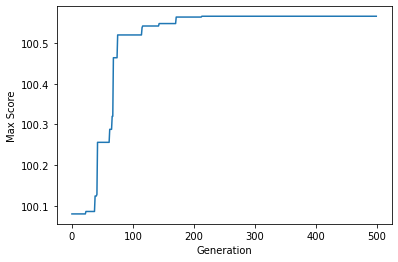

In [59]:
x = []
y = []
for i in range(500):
    x.append(i)
for score in allScores:
    y.append(score[1])
plt.xlabel('Generation')
plt.ylabel('Max Score')
plt.plot(x, y)
plt.show()

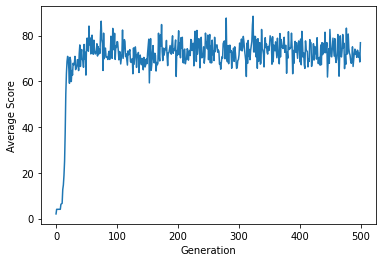

In [60]:
x = []
y = []
for i in range(500):
    x.append(i)

for score in allScores:
    y.append(score[2])
plt.xlabel('Generation')
plt.ylabel('Average Score')
plt.plot(x, y)
plt.show()